# Final Project Submission

Please fill out:
* Student name: Marco Giuseppe Nasuto
* Student pace: self paced
* Scheduled project review date/time: 
* Instructor name: Jeff Herman
* Blog post URL: https://readymag.com/kosmonauts/realestimate/


You'll clean, explore, and model this dataset with a multivariate linear regression to predict the sale price of houses as accurately as possible.

# Import

## Libraries

In [3]:
import IPython
from statsmodels.stats.outliers_influence import variance_inflation_factor
from geopandas.tools import sjoin
import geopandas as gpd
from shapely.geometry import Point, Polygon
import shapefile as shp
import warnings
from collections import Counter
from sklearn.preprocessing import normalize
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import missingno as msno
%matplotlib inline

In [2]:
def reduce_multicol(df, threshold):
    col_corr = set()  # Set of all the names of deleted columns
    corr_matrix = df.corr()
    for i in range(0, len(corr_matrix.columns)):
        for j in range(0, i):
            if (corr_matrix.iloc[i, j] >= threshold) and (corr_matrix.columns[j] not in col_corr):
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

In [3]:
def logtransform(df):
    '''The function returns a log-transformation of float columns without NaN values
\nParameters
----------
\nx : numerical value'''
    for col in df.select_dtypes('float').columns:
        if (df[col].isna().any() | (df[col] < 0).any()):
            continue
        elif df[col].isin([0]).any():  # case there are 0 in the column, add constant (1)
            df[col].replace(0, 1, inplace=True)
            df['log-{}'.format(col)] = np.log(df[col])
        else:
            df['log-{}'.format(col)] = np.log(df[col])
    return df

In [4]:
def statistics(df, target=None, log=False, check_na=False):
    '''The fucntion returns a set of general statistics and information on a given dataframe df, target variable. When log=True the fucntion applies a log-transfromation to all numerical columns.:
    - .shape: shape of the dataframe
    - .info: dtype objects of each column and number of non-null objects
    - .describe: count, mean, std,  min, max, quartiles
    - .median: median of numerical columns in dataframe
    - nullity matrix: matrix that shows how filled variables are 
    - nullity dendogram: The dendrogram uses a hierarchical clustering algorithm (courtesy of scipy) to bin variables against one another by their nullity correlation (measured in terms of binary distance). At each step of the tree the variables are split up based on which combination minimizes the distance of the remaining clusters. The more monotone the set of variables, the closer their total distance is to zero, and the closer their average distance (the y-axis) is to zero. To interpret this graph, read it from a top-down perspective. Cluster leaves which linked together at a distance of zero fully predict one another's presence—one variable might always be empty when another is filled, or they might always both be filled or both empty, and so on. In this specific example the dendrogram glues together the variables which are required and therefore present in every record. Cluster leaves which split close to zero, but not at it, predict one another very well, but still imperfectly. If your own interpretation of the dataset is that these columns actually are or ought to be match each other in nullity (for example, as CONTRIBUTING FACTOR VEHICLE 2 and VEHICLE TYPE CODE 2 ought to), then the height of the cluster leaf tells you, in absolute terms, how often the records are "mismatched" or incorrectly filed—that is, how many values you would have to fill in or drop, if you are so inclined. As with matrix, only up to 50 labeled columns will comfortably display in this configuration. However the dendrogram more elegantly handles extremely large datasets by simply flipping to a horizontal configuration.
    - (isna.sum, perc_NaN): number of NaN values for each column and percentage of Nan values w.r.t each column total number of rows
    - (.duplicated, index_dupl): tuple with number of rows duplicated and indexes where .duplicated == True
    - .value_counts: Normalized unique values for each column in dataframe
    - .columns: list of columns of the dataframe
    - correlation matrix
    - boxplot: boxplots of numerical columns
    - hist: histograms of numerical columns
    - scatterplot: scatter plot for numerical columns
\nParameters
----------
\ndf : DataFrame object
\ntarget: str, target column
    '''
    duplicated_index = df[df.duplicated()].index
    print('Shape: ', df.shape)
    print('\ndtype objects of each column and number of non-null objects:')
    print('\n')
    print(df.info())
    print('\ncount, mean, std, min, max, quartiles:')
    print('\n{}'.format(df.describe()))
    print('\nMedian values of numerical columns in the dataframe:')
    print('\n{}'.format(df.median()))
    print('\nNumber of NaN values per column:\n')
    print(df.isna().sum(), '\n\nIn terms of percentage (%) for each column\n\n',
          df.apply(lambda x: ((x.isna().sum())/len(x))*100))
    if check_na == True:
        msno.matrix(df)
        msno.dendrogram(df)
    print('\nNormalized unique values for each column in dataframe')
    for col in df.columns:
        if df[col].dtypes == np.number:
            print('\nColumn name: {}\n\n{}'.format(
                col, df[col].value_counts(normalize=True, dropna=False)))
        else:
            print('\nColumn name: {}\n\n{}'.format(
                col, df[col].value_counts(normalize=True, dropna=False)))
    print('Duplicated rows in the dataframe: ', df.duplicated().sum(),
          'Indexes where duplicated', duplicated_index)
    print('List of columns in the dataframe:')
    print(df.columns)
    plt.figure(figsize=(20, 20))
    sns.heatmap(df.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1)
    plt.figure(figsize=(20, 20))
    if log == True:
        logtransform(df)
    df.hist(figsize=(20, 20))
    df.boxplot(figsize=(20, 20))
    for col in df.columns:
        try:
            if target != None:
                g = sns.jointplot(x=col, y=target, data=df)
                #plt.title('Feature: {}'.format(col))
        except:
            print('{} is not a numerical column'.format(col))
    return duplicated_index

In [5]:
# Number of levels per variable
def num_levels(df):
    for col in df.columns:
        print('{}: {} levels'.format(col, len(df[col].value_counts())))

In [6]:
def plot_before_after(df, dftransf, columns, original, transf):
    '''The function returns pairs of plots for comparing data transformations of the same dataframe showing a before-after display.
\nParameters
----------
\ndf : pandas.DataFrame obj, DataFrame
\original : str, title for the "before" transformation - i.e. Original, Log-Transformation ecc.
\ntransform : str, title for the "after" transformation - i.e. Scaled, Normalised ec..
\ncolumns : list of strings, list of columns to plot before-after'''
    # store columns df, dftransft
    columns_dftransf = dftransf.columns
    columns_df = df.columns

    # check if they have same columns
    if set(columns_dftransf) != set(columns_df):
        # check which has more columns
        if len(columns_dftransf) > len(columns_df):
            # store which columns are not in the one with lower length
            columns_difference = list(
                (Counter(columns_dftransf) - Counter(list(columns_df))).keys())
            # store which columns are in common
            commoncolumns = list(
                (Counter(columns) - Counter(list(columns_difference))).keys())
            # since columns in dftrasnf not in df are in the format '{transformation}-originalcolumnname',
            # take only 'originalcolumnname' as this will allow you to compare the transformed column with
            # the transformed version of it in dftransf
            columns_forcomparison = [[col for col in columns_df if col.endswith(
                col_difference.split('-')[1])][0] for col_difference in columns_difference]

            for col in commoncolumns:
                fig, ax = plt.subplots(2, 2, figsize=(12, 12))
                sns.distplot(df[col], ax=ax[0][0], color='r')
                ax[0][0].set_title("{} - {} Data".format(col, original))
                sns.distplot(dftransf[col], ax=ax[0][1], color='b')
                ax[0][1].set_title("{} - {} Data".format(col, transf))
                stats.probplot(df[col], plot=ax[1][0], dist='norm')
                ax[1][0].set_title(
                    "qq-plot {} - {} Data".format(col, original))
                stats.probplot(dftransf[col], plot=ax[1][1], dist='norm')
                ax[1][1].set_title("qq-plot {} - {} Data".format(col, transf))

            for col, comparison in zip(columns_difference, columns_forcomparison):
                fig, ax = plt.subplots(2, 2, figsize=(12, 12))
                sns.distplot(df[comparison], ax=ax[0][0], color='r')
                ax[0][0].set_title("{} - {} Data".format(comparison, original))
                sns.distplot(dftransf[col], ax=ax[0][1], color='b')
                ax[0][1].set_title("{} - {} Data".format(col, transf))
                stats.probplot(df[comparison], plot=ax[1][0], dist='norm')
                ax[1][0].set_title(
                    "qq-plot {} - {} Data".format(comparison, original))
                stats.probplot(dftransf[col], plot=ax[1][1], dist='norm')
                ax[1][1].set_title("qq-plot {} - {} Data".format(col, transf))

        else:
            columns_difference = list(
                (Counter(columns_df) - Counter(list(columns_dftransf))).keys())
            columns_forcomparison = [[col for col in columns_df if col.endswith(
                col_difference.split('-')[1])][0] for col_difference in columns_difference]
            commoncolumns = list(
                (Counter(columns) - Counter(list(columns_difference))).keys())

            for col in columns_difference:
                fig, ax = plt.subplots(2, 2, figsize=(12, 12))
                sns.distplot(df[comparison], ax=ax[0][0], color='r')
                ax[0][0].set_title("{} - {} Data".format(comparison, original))
                sns.distplot(dftransf[col], ax=ax[0][1], color='b')
                ax[0][1].set_title("{} - {} Data".format(col, transf))
                stats.probplot(df[comparison], plot=ax[1][0], dist='norm')
                ax[1][0].set_title(
                    "qq-plot {} - {} Data".format(comparison, original))
                stats.probplot(dftransf[col], plot=ax[1][1], dist='norm')
                ax[1][1].set_title("qq-plot {} - {} Data".format(col, transf))
    else:
        for col in columns:
            fig, ax = plt.subplots(2, 2, figsize=(12, 12))
            sns.distplot(df[col], ax=ax[0][0], color='r')
            ax[0][0].set_title("{} - {} Data".format(col, original))
            sns.distplot(dftransf[col], ax=ax[0][1], color='b')
            ax[0][1].set_title("{} - {} Data".format(col, transf))
            stats.probplot(df[col], plot=ax[1][0], dist='norm')
            ax[1][0].set_title("qq-plot {} - {} Data".format(col, original))
            stats.probplot(dftransf[col], plot=ax[1][1], dist='norm')
            ax[1][1].set_title("qq-plot {} - {} Data".format(col, transf))

# Methodology

1. For this project we first focused on Business Understanding. During this phase we:

    - Got some domain knowledge on the real-estate business

    - Formulated some questions of business relevance that we want to address with our regression analysis

 

2. For the regression analysis we followed the well-known methodology called Obtain Scrub Explore Model iNterpret - OSEMN.

# Business understanding

Very briefly: we know that the evaluation of a house when selling or buying it, depends on:

- The geographical feature (location) of the house

- Its physical features (square foot, number of bedrooms, bathrooms, floors etc.)

- Its grading

 

However, we don't know effectively how these features affect house prices analytically. We see this regression analysis as an opportunity to come up with recommendations for different stakeholders:

- Buyers

- Sellers

- Realestimate as a startup 

 

Four main stakeholders, 6 questions to address:

 

Seller/Prediction

**1. “The agency gave me an estimate on that house I want to sell, but I’d love a second opinion. Where can I find it?”**


 

Buyer/Inference

**2. "I want to invest buying a new house. What are the features that matter the most to maximise my investment?"**

 


Realestimate as a startup

**3. “I want to do an MVP of a real-estate price predictor. Is it possible to reach an accuracy close to industry standards with just an MVP?“**





Urban developer

**4.1. Where and if is it affordable for a lower income class member (median lower income) to buy a house in King County?**

**4.2. What about for a middle income class member (median middle income)?**

**4.3. What about for an upper income class member (median upper income)?”**

# Data requirements

The business understanding phase sets our data requirements, in other words what data (features) we need in order to try to address our business questions?

 
We essentially need:

1. A dataset with main houses features and prices (King County Housing dataset, which was given)

2. A dataset with median household income values for each tract in King County (King County Census data, that can be found here: https://gis-kingcounty.opendata.arcgis.com/datasets/acs-median-family-income-in-the-past-12-months-in-inflation-adjusted-dollars-acs-b19113-medianfamilyincome?geometry=-122.758%252C47.550%252C-121.781%252C47.712).

## Load data

In [5]:
# modifying the default directory
os.chdir("../data")

In [23]:
# path for exporting csv
path = './processed/'

In [8]:
ls

external/     images/       pickle-files/ processed/    raw/


**King County Houses Data**

In [9]:
# load data
original_df = pd.read_csv('./raw/kc_house_data.csv')
original_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,...,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,...,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


In [25]:
# make copy for operational purposes
df = original_df.copy()

**King County Census Data**

Metadata description: https://www.arcgis.com/sharing/rest/content/items/8fbffa70eb8746fa99d1dab0f3ae1747/info/metadata/metadata.xml?format=default&output=html

In [22]:
census_gpd = gpd.read_file(
    './external/_acs_b19113_medianfamilyincome-shp/ac066117-96a7-46cd-8211-9a56a3ce1d82202049-1-1v6va0a.6v0j.shp')

In [20]:
census = census_gpd.copy()

In [21]:
census

,OBJECTID,GEO_ID_TRT,TRACT_LBL,E19113069,M19113069,geometry
0,1,53033000100,Tract 000100,83222.0,12066.0,"POLYGON ((-122.28580 47.73368, -122.28559 47.7..."
1,2,53033000200,Tract 000200,74818.0,12715.0,"POLYGON ((-122.32359 47.73405, -122.32348 47.7..."
2,3,53033000300,Tract 000300,100263.0,7691.0,"POLYGON ((-122.32555 47.73407, -122.32532 47.7..."
3,4,53033000401,Tract 000401,44810.0,23592.0,"POLYGON ((-122.34501 47.72633, -122.34498 47.7..."
4,5,53033000402,Tract 000402,92266.0,17875.0,"POLYGON ((-122.34737 47.72322, -122.34655 47.7..."
...,...,...,...,...,...,...
393,394,53033032702,Tract 032702,105469.0,6268.0,"POLYGON ((-121.53590 47.54667, -121.53565 47.5..."
394,395,53033032703,Tract 032703,103417.0,17296.0,"POLYGON ((-121.83219 47.53884, -121.83218 47.5..."
395,396,53033032704,Tract 032704,111186.0,14401.0,"POLYGON ((-121.78176 47.52230, -121.78122 47.5..."
396,397,53033032800,Tract 032800,110500.0,21408.0,"POLYGON ((-121.43171 47.78048, -121.41064 47.7..."


## Descriptive statistics

Shape:  (21597, 21)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
id               21597 non-null int64
date             21597 non-null object
price            21597 non-null float64
bedrooms         21597 non-null int64
bathrooms        21597 non-null float64
sqft_living      21597 non-null int64
sqft_lot         21597 non-null int64
floors           21597 non-null float64
waterfront       19221 non-null float64
view             21534 non-null float64
condition        21597 non-null int64
grade            21597 non-null int64
sqft_above       21597 non-null int64
sqft_basement    21597 non-null object
yr_built         21597 non-null int64
yr_renovated     17755 non-null float64
zipcode          21597 non-null int64
lat              21597 non-null float64
long             21597 non-null float64
sqft_living15    21597 non-null int64
sqft_lot15       21597 non-nu

date is not a numerical column
sqft_basement is not a numerical column


/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/seaborn/axisgrid.py:1675: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


Int64Index([], dtype='int64')

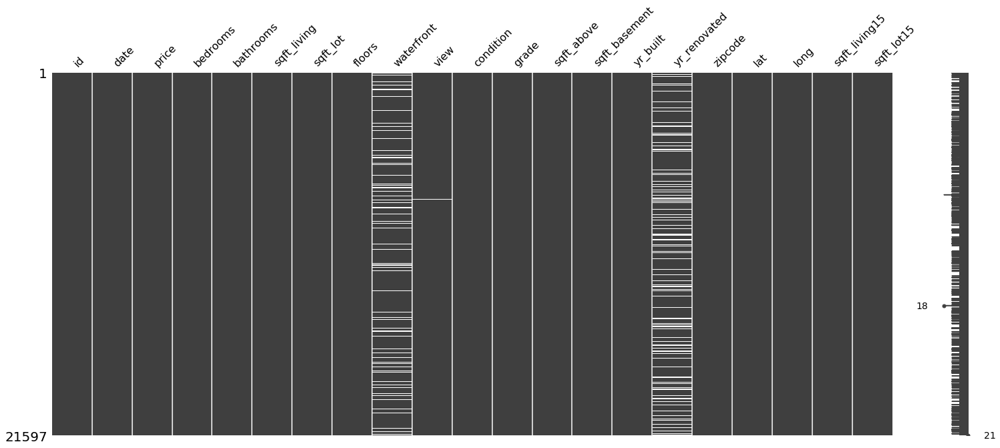

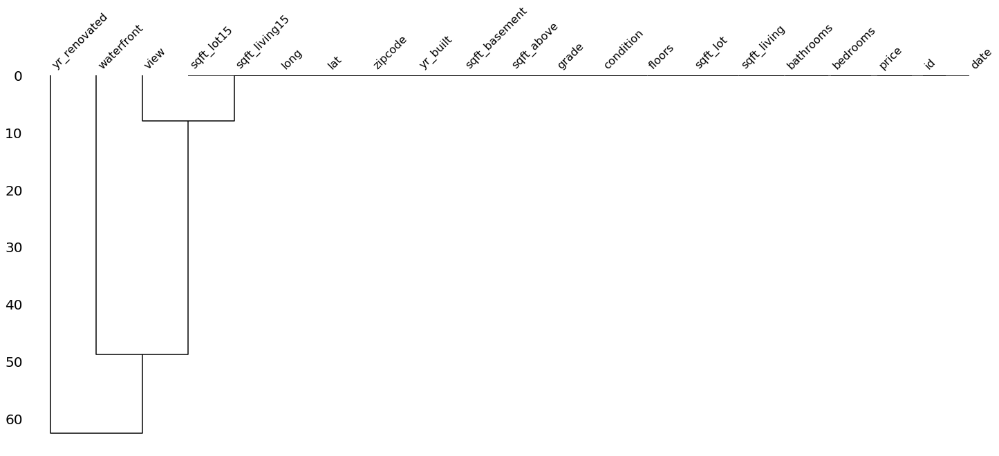

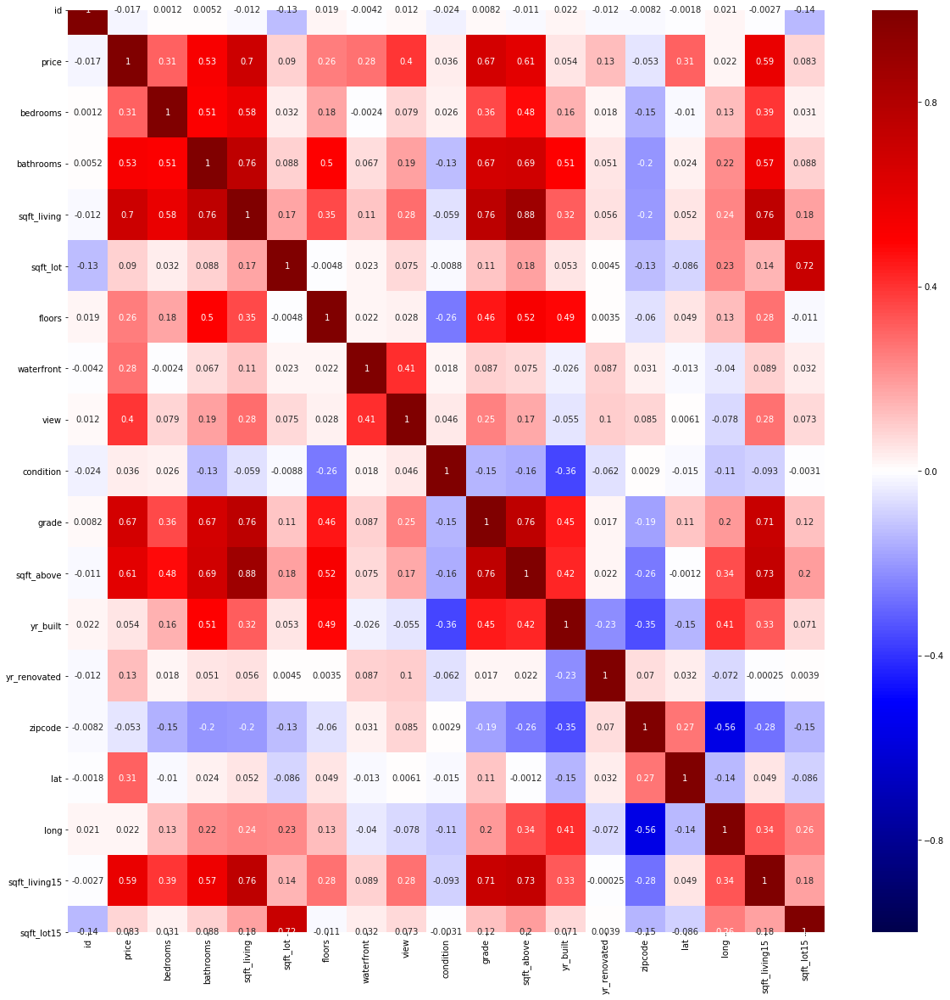

<Figure size 1440x1440 with 0 Axes>

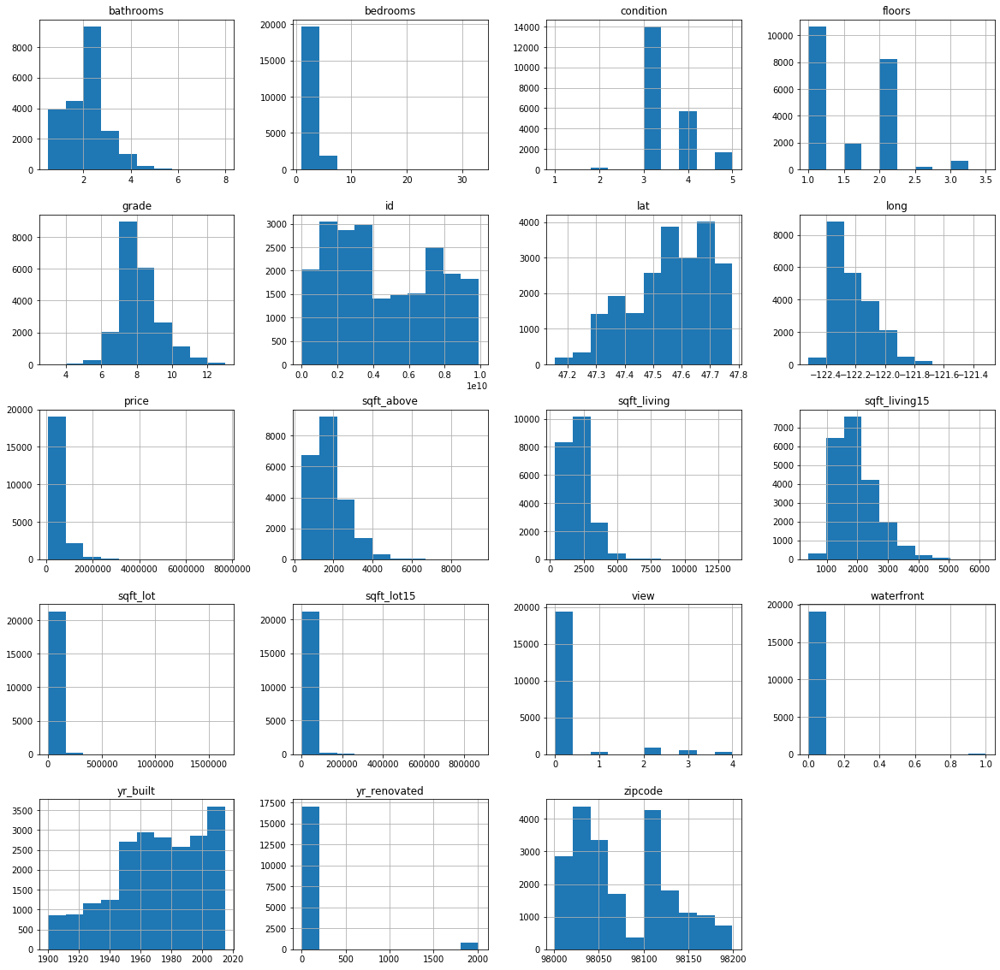

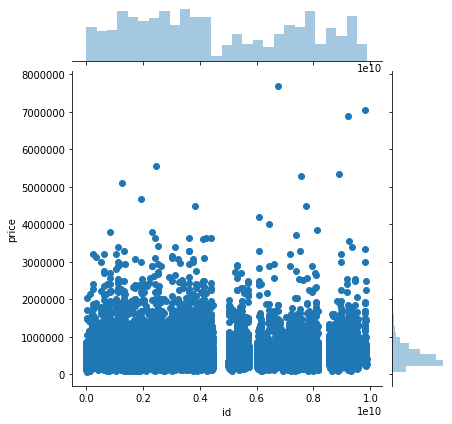

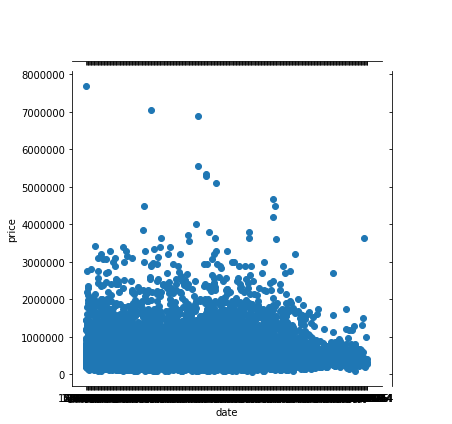

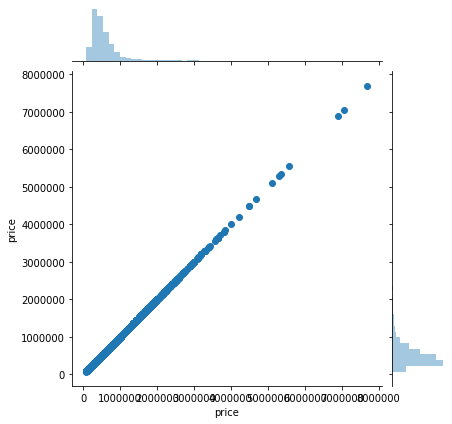

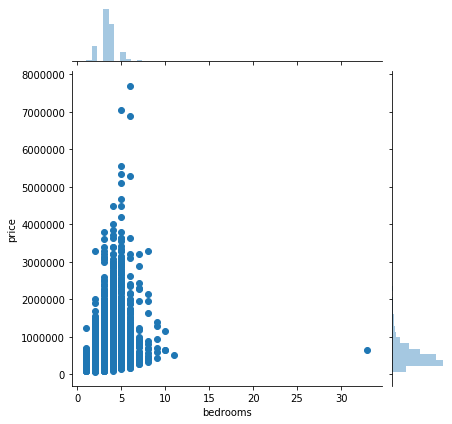

...

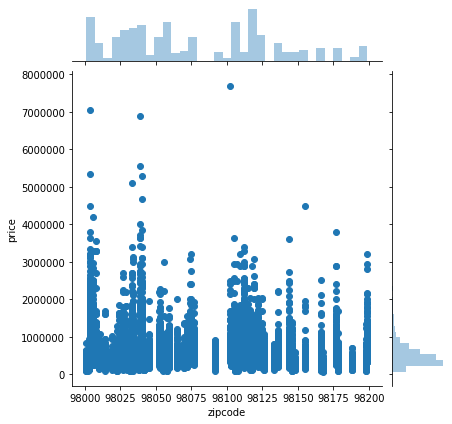

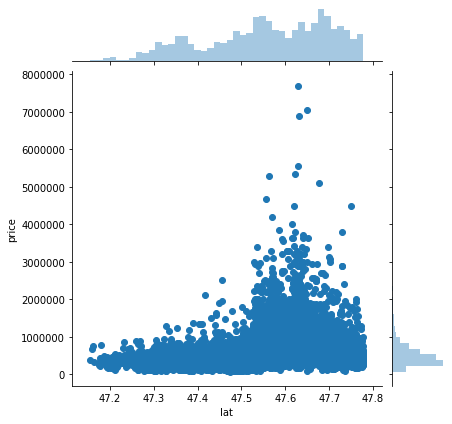

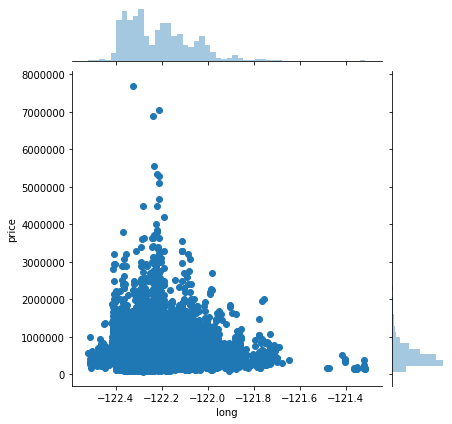

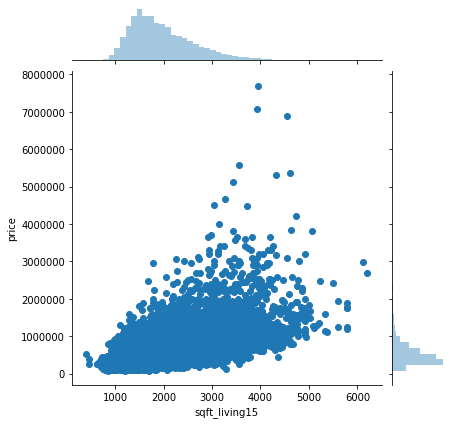

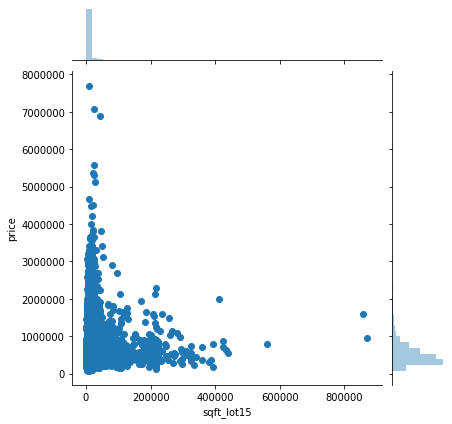

In [13]:
statistics(df, target='price', check_na=True)

## Export datasets to csv

In [26]:
# export for loading dataset on CARTOdb
df.to_csv(os.path.join(path, r'KC_housing_processed.csv'), index=False)

In [15]:
# census data to csv
census.to_csv(os.path.join(path, r'KC_MHI_census.csv'), index=False)

## Plotting with CARTODB

In [136]:
iframe = '<iframe width="100%" height="520" frameborder="0" src="https://andreanasuto.carto.com/builder/8a296e60-38d8-4fb2-b4e1-418884819758/embed" allowfullscreen webkitallowfullscreen mozallowfullscreen oallowfullscreen msallowfullscreen></iframe>'
IPython.display.HTML(iframe)

# Models and datasets

We need several datasets for several models.

## Target Variable

Target variable 'y': price


## Models

For learning reasons, we tried to map dozens of models in order to:

1. See the effect of certain techqniques and design choices 

2. Try to describe the phenomenon with models not the other way round (in other words, trying to be as agnostic as possible towards the phenomenon):  there are a lot of examples online of multilinear regression on predicting the price in King County using the same dataset we worked on. Since there are clear issues, as we will see, with outliers and non-linearity of pricing, the typical approach that we've seen, which we tried to avoid (although with limitations due to knowledge), is to linearise the problem, manipulating the dataset so that a multilinear regression "turns to be" adequate enough.

3. Select the best model based also on a good interpretrability (rather than just evaluating on standard metrics to assess regression models)

4. Select the best model based on accuracy

 

Metrics used to assess models:

 

- Adj. R^2

- Train and test RMSE

- 10-fold cross validation mean R^2

- AIC

- Residual standard error (RSE): the average amount that the response will deviate from the true regression line

 

On the other hand we wanted to go beyond the metrics and measure the linearity of the model with:

 

- qq-plots and residuals histograms (normality)

- Train and test residuals plots (heteroskedasticity)

- Partial-residual plots 

- Influence plots (outliers)

- Prediction intervals plots

 

When looking at qq-plots and heteroskedasticity, it is clear that the models show issues with linearity as we have:

- Heavy tails qq-plots

- Funnel-shaped heteroskedasticity

 

We adopted design patterns in order to "map" several models according to conditions. The hierarchy used is:

 

    1. First split: 

        1.1. Dataset with outliers

        1.2 Dataset without ouliers



        2. Second split: for each dataset in 1)

            2.1. Dataset without multicolinearity removed

            2.2. Dataset with multicolinearity removed using correlation matrix

            2.3 Dataset with multicolinearity removed using VIF



            3. Third split: for each dataset in 2)

                3.1. Categorical-level-threshold < 29

                3.2 Categorical-level-threshold < 6
                
                
                4. Fourth split: for each dataset in 3) 

                    4.1. Log-transformed continous variables

                    4.2. Log-transformed + MinMax scaling

                    4.3. Log-transformed + Robust Scaling

                    4.4. Log-transfomred + Standard Scaling

# Data wrangling

**Column Names and descriptions for Kings County Data Set**
* **id** - unique identified for a house
* **dateDate** - house was sold
* **pricePrice** -  is prediction target
* **bedroomsNumber** -  of Bedrooms/House
* **bathroomsNumber** -  of bathrooms/bedrooms
* **sqft_livingsquare** -  footage of the home
* **sqft_lotsquare** -  footage of the lot
* **floorsTotal** -  floors (levels) in house
* **waterfront** - House which has a view to a waterfront
* **view** - Has been viewed
* **condition** - How good the condition is ( Overall )
* **grade** - overall grade given to the housing unit, based on King County grading system
* **sqft_above** - square footage of house apart from basement
* **sqft_basement** - square footage of the basement
* **yr_built** - Built Year
* **yr_renovated** - Year when house was renovated
* **zipcode** - zip
* **lat** - Latitude coordinate
* **long** - Longitude coordinate
* **sqft_living15** - The square footage of interior housing living space for the nearest 15 neighbors
* **sqft_lot15** - The square footage of the land lots of the nearest 15 neighbors

## Drop columns

Let's start from dropping those columns that are not related with price prediction. 

These are:

**- id**

In [26]:
# drop ID
df.drop(['id', 'date'], axis=1, inplace=True)

## Duplicates

1- Check for duplicates

2- Remove duplicates

In [30]:
# check for duplicates
df.duplicated().sum()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
4348,259950.0,2,2.00,1070,649,2.0,0.0,0.0,3,9,720,350.0,2008,0.0,98106,47.5213,-122.357,1070,928
14969,585000.0,3,2.50,2290,5089,2.0,0.0,0.0,3,9,2290,0.0,2001,0.0,98006,47.5443,-122.172,2290,7984
20038,555000.0,3,2.50,1940,3211,2.0,0.0,0.0,3,8,1940,0.0,2009,0.0,98027,47.5644,-122.093,1880,3078
20508,529500.0,3,2.25,1410,905,3.0,0.0,0.0,3,9,1410,0.0,2014,0.0,98116,47.5818,-122.402,1510,1352


In [31]:
df[df.duplicated()]

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
4348,259950.0,2,2.00,1070,649,2.0,0.0,0.0,3,9,720,350.0,2008,0.0,98106,47.5213,-122.357,1070,928
14969,585000.0,3,2.50,2290,5089,2.0,0.0,0.0,3,9,2290,0.0,2001,0.0,98006,47.5443,-122.172,2290,7984
20038,555000.0,3,2.50,1940,3211,2.0,0.0,0.0,3,8,1940,0.0,2009,0.0,98027,47.5644,-122.093,1880,3078
20508,529500.0,3,2.25,1410,905,3.0,0.0,0.0,3,9,1410,0.0,2014,0.0,98116,47.5818,-122.402,1510,1352


The duplicated rows detected seem to be different proprieties. We will keep them

## Split variables into categorical, discrete and continous

### Criterion

If you have a discrete variable and you want to include it in a Regression model, you can decide whether to treat it as a continuous predictor or categorical predictor. 

If the **discrete variable** has **many levels**:

- If it's **ordered**, then it may be best to treat it as a **continuous** variable
- Otherwise, it should be **binned** first, then treated as **categorical**

Treating a **predictor** as a **continuous** variable implies that a simple **linear** or polynomial function can adequately describe the relationship **between** the **response and the predictor**. 

When you treat a **predictor** as a **categorical** variable, a distinct response value is **fit** to **each level** of the variable **without regard** to the **order** of the predictor **levels**. 

We will use this information, in addition to the purpose of our analysis to decide what is best for our situation.

In [19]:
# number of levels
num_levels(df)

price: 3622 levels
bedrooms: 12 levels
bathrooms: 29 levels
sqft_living: 1034 levels
sqft_lot: 9776 levels
floors: 6 levels
waterfront: 2 levels
view: 5 levels
condition: 5 levels
grade: 11 levels
sqft_above: 942 levels
sqft_basement: 304 levels
yr_built: 116 levels
yr_renovated: 70 levels
zipcode: 70 levels
lat: 5033 levels
long: 751 levels
sqft_living15: 777 levels
sqft_lot15: 8682 levels


### Identify categorical, discrete, continous variables

#### Native Categorical

- Waterfront:  2 levels

#### Variables to use for feature engineering

- Lat, long: distance from rich quarter
- date: to do weighted regression

#### Discrete variables continous classified as categorical

- zipcode: 70 levels

#### Categorical: threshold < 29 levels

###### Discrete, Non-Ordered, Variables to be classified as categorical

- Bedrooms: 12 levels
- Floors: 6 levels
- View: 5 levels

###### Discrete variables to be classified as continous

- Bathrooms: 29 levels
- Grade: **ordered factor variable**, 11 levels
- Condition: **ordered factor variable**, 5 levels

In [20]:
cat = ['bedrooms', 'floors', 'view']
cont = list((Counter(list(df.columns)) - Counter(cat)).keys())

In [21]:
cont.remove('price')

In [22]:
cont.remove('waterfront')

In [23]:
cat.append('zipcode')

In [24]:
cat

['bedrooms', 'floors', 'view', 'zipcode']

In [25]:
cont.remove('zipcode')

#### Categorical: threshold < 6 levels

##### Discrete, Non-Ordered Variables to be classified as categorical

- View: 5 levels

##### Discrete variables to be classified as continous

- Condition: ordered factor variable, 5 levels
- Bathrooms: 29 levels
- Grade: ordered factor variable, 11 levels
- Bedrooms: 12 levels
- Floors: 6 levels

In [26]:
cat6 = ['view']
cont6 = list((Counter(list(df.columns)) - Counter(cat6)).keys())

In [27]:
cont6.remove('price')

In [28]:
cont6.remove('waterfront')

In [29]:
cat6.append('zipcode')

In [30]:
cat6

['view', 'zipcode']

In [31]:
cont6.remove('zipcode')

## Mispelled/Not numeric values

### *sqft_basement*

*sqft_basement* has mispelled values. When we try to:

In [32]:
#df['sqft_basement'].apply(lambda x: float(x))

In [33]:
(df['sqft_basement'] == '?').sum()

454

In [34]:
print((df['sqft_basement'] == '?').sum() / len(df['sqft_basement']))

0.021021438162707785


We have 454 values, 2% of the total length of the column. Let's check for which rows this happens.

Shape:  (454, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 454 entries, 6 to 21581
Data columns (total 19 columns):
price            454 non-null float64
bedrooms         454 non-null int64
bathrooms        454 non-null float64
sqft_living      454 non-null int64
sqft_lot         454 non-null int64
floors           454 non-null float64
waterfront       417 non-null float64
view             452 non-null float64
condition        454 non-null int64
grade            454 non-null int64
sqft_above       454 non-null int64
sqft_basement    454 non-null object
yr_built         454 non-null int64
yr_renovated     366 non-null float64
zipcode          454 non-null int64
lat              454 non-null float64
long             454 non-null float64
sqft_living15    454 non-null int64
sqft_lot15       454 non-null int64
dtypes: float64(8), int64(10), object(1)
memory usage: 70.9+ KB
None

count, mean, std, min, max, quartiles:



Int64Index([], dtype='int64')

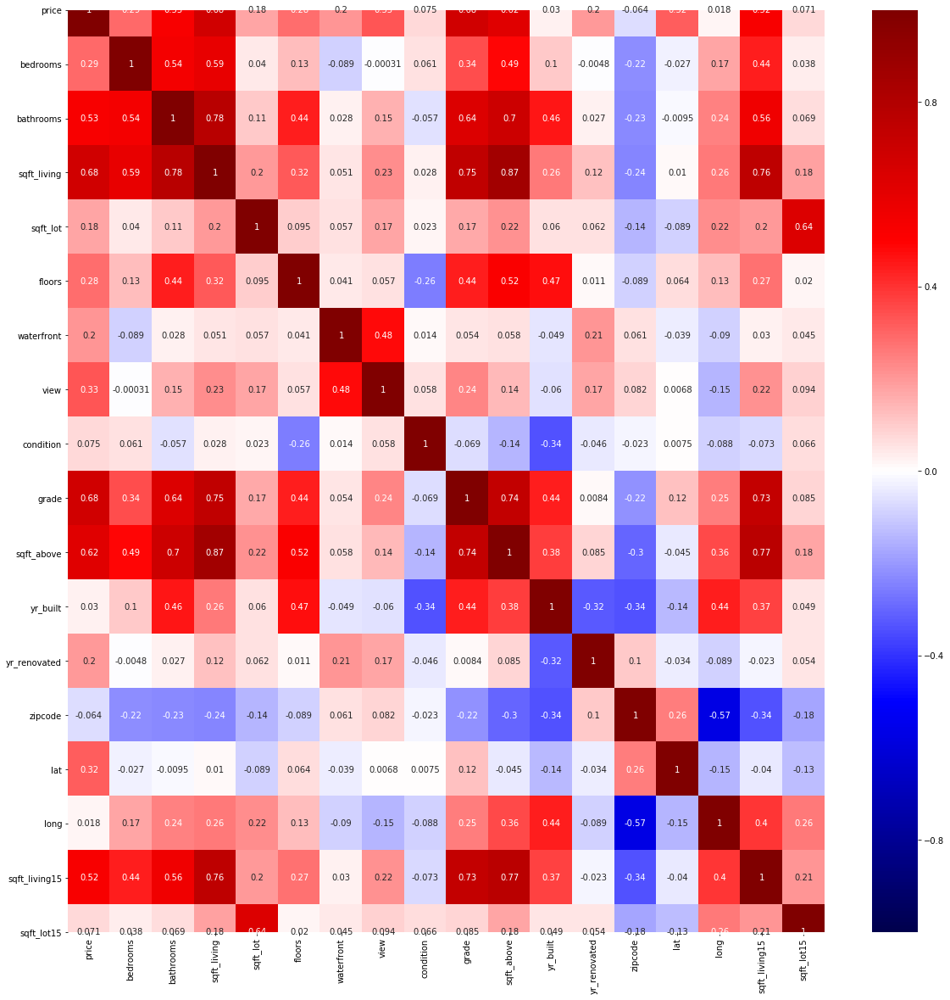

<Figure size 1440x1440 with 0 Axes>

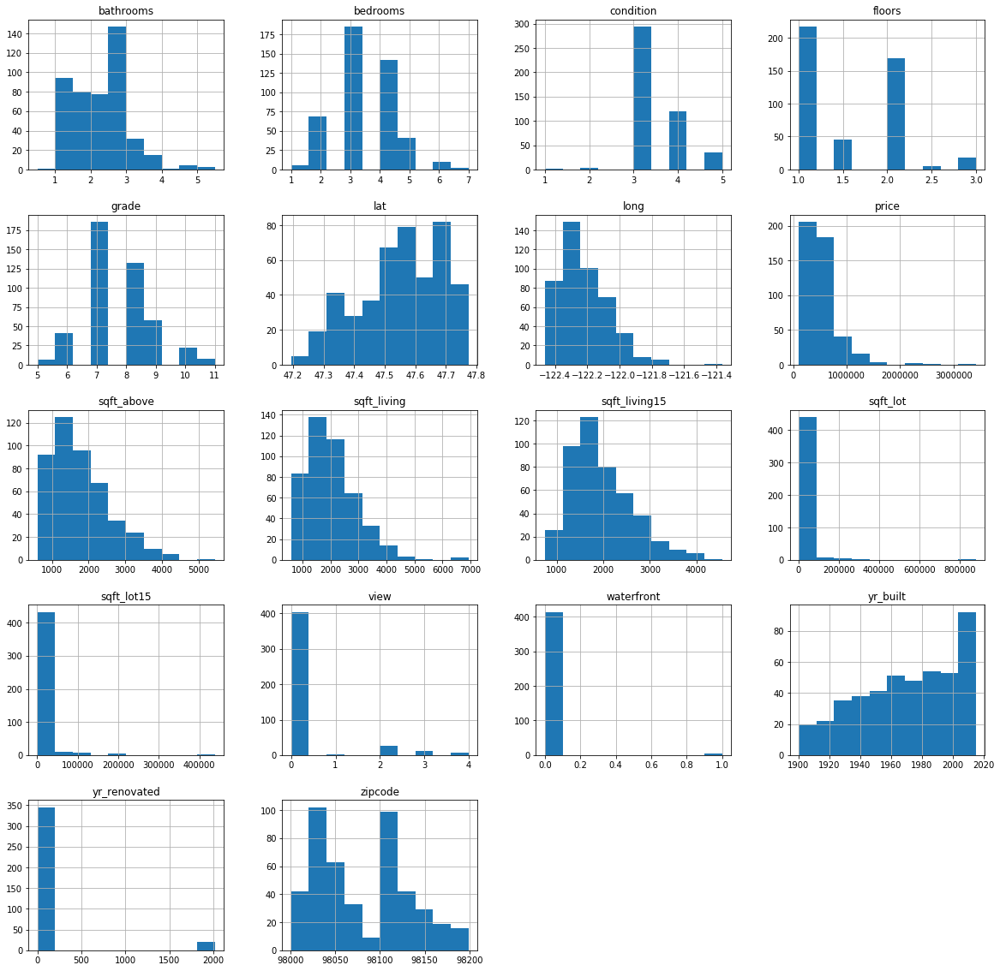

In [35]:
statistics(df[df['sqft_basement'] == '?'])

Let's confront the distributions of our dataset for all those rows where *sqft_basement* is not '?'

Shape:  (21143, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 21143 entries, 0 to 21596
Data columns (total 19 columns):
price            21143 non-null float64
bedrooms         21143 non-null int64
bathrooms        21143 non-null float64
sqft_living      21143 non-null int64
sqft_lot         21143 non-null int64
floors           21143 non-null float64
waterfront       18804 non-null float64
view             21082 non-null float64
condition        21143 non-null int64
grade            21143 non-null int64
sqft_above       21143 non-null int64
sqft_basement    21143 non-null object
yr_built         21143 non-null int64
yr_renovated     17389 non-null float64
zipcode          21143 non-null int64
lat              21143 non-null float64
long             21143 non-null float64
sqft_living15    21143 non-null int64
sqft_lot15       21143 non-null int64
dtypes: float64(8), int64(10), object(1)
memory usage: 3.2+ MB
None


Int64Index([4348, 14969, 20038, 20508], dtype='int64')

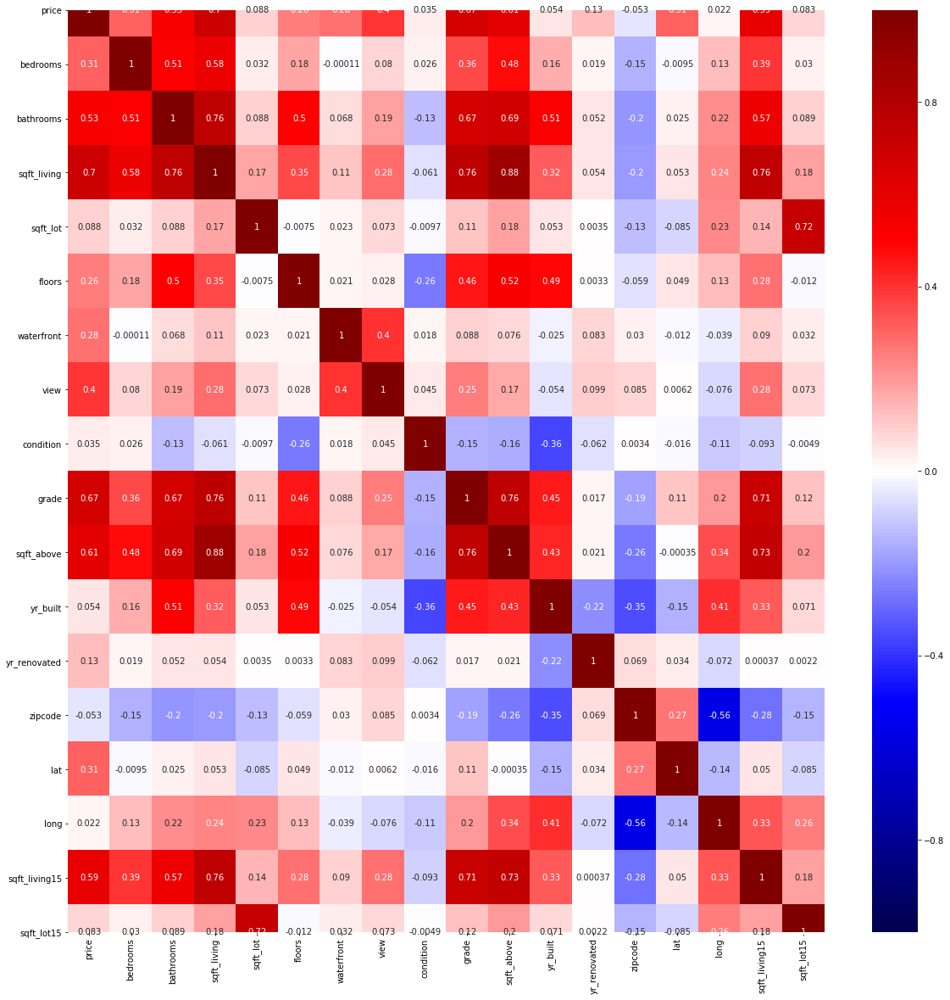

<Figure size 1440x1440 with 0 Axes>

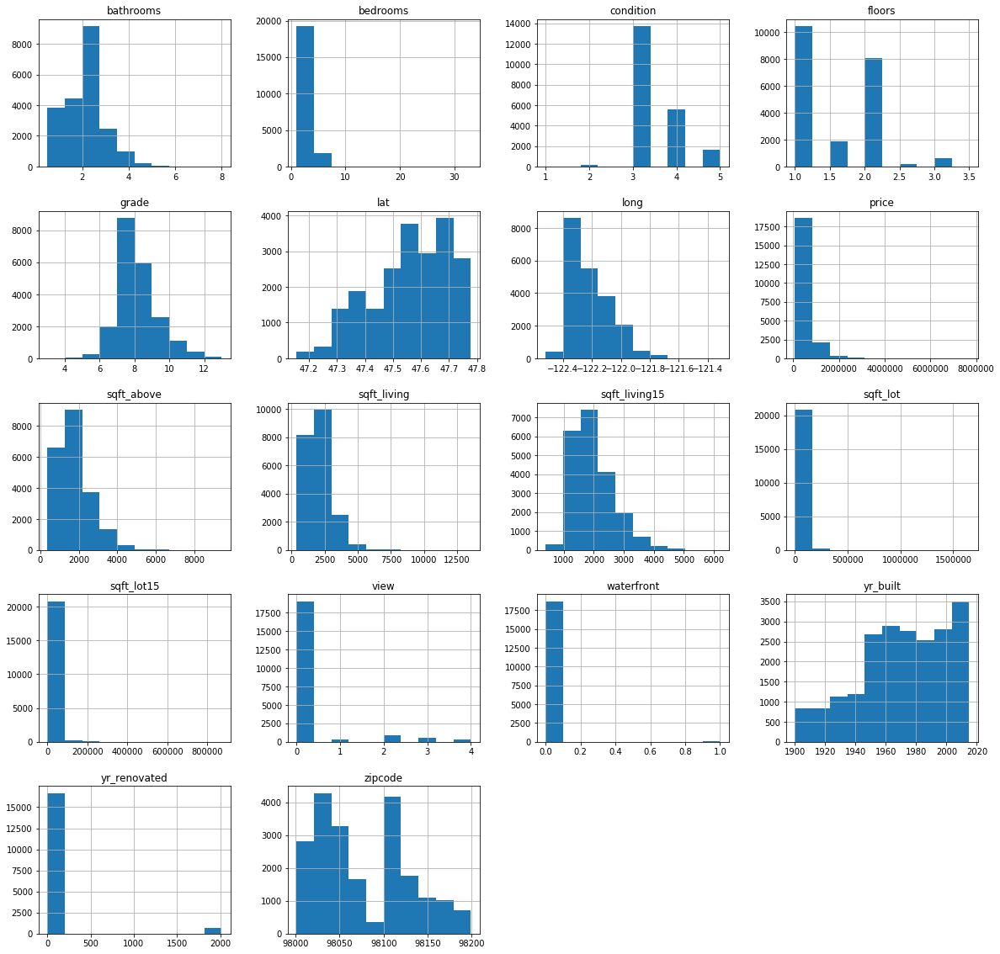

In [36]:
statistics(df[df['sqft_basement'] != '?'])

The two distributions look very similar.

We're going to fill '?' with the median of sqft_basement.

In [32]:
median_basement = df[df['sqft_basement'] != '?']['sqft_basement'].median()
df['sqft_basement'] = df['sqft_basement'].replace('?', median_basement)

In [33]:
# check replacement
(df['sqft_basement'] == '?').sum()

0

## Edit Dtypes

*sqft_basement, sqft_living, sqft_living15, sqft_above, sqft_lot15, sqft_lot, bedrooms* are not float. Let's change it to *float*

In [34]:
df['sqft_basement'] = df['sqft_basement'].apply(lambda x: np.float(x))

In [35]:
df['sqft_living'] = df['sqft_living'].apply(lambda x: np.float(x))

In [36]:
df['sqft_living15'] = df['sqft_living15'].apply(lambda x: np.float(x))

In [37]:
df['sqft_above'] = df['sqft_above'].apply(lambda x: np.float(x))

In [38]:
df['sqft_lot15'] = df['sqft_lot15'].apply(lambda x: np.float(x))

In [39]:
df['sqft_lot'] = df['sqft_lot'].apply(lambda x: np.float(x))

In [40]:
df['bedrooms'] = df['bedrooms'].apply(lambda x: np.float(x))

## NaN values

*waterfront*, *view*, *yr_renovated* have NaN values.

NaN values per column
- *watefront*: ~ 11% of the total
- *yr_renovated*: ~ 18% of the total
- *view*: ~ 0.29% of the total

### *waterfront*

Let's confront the distributions when *waterfront* == NaN, *waterfront* == 1 and when *waterfront* == 0.

Shape:  (2376, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2376 entries, 0 to 21595
Data columns (total 19 columns):
price            2376 non-null float64
bedrooms         2376 non-null float64
bathrooms        2376 non-null float64
sqft_living      2376 non-null float64
sqft_lot         2376 non-null float64
floors           2376 non-null float64
waterfront       0 non-null float64
view             2370 non-null float64
condition        2376 non-null int64
grade            2376 non-null int64
sqft_above       2376 non-null float64
sqft_basement    2376 non-null float64
yr_built         2376 non-null int64
yr_renovated     1946 non-null float64
zipcode          2376 non-null int64
lat              2376 non-null float64
long             2376 non-null float64
sqft_living15    2376 non-null float64
sqft_lot15       2376 non-null float64
dtypes: float64(15), int64(4)
memory usage: 371.2 KB
None

count, mean, std, mi

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:959: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


price               0
bedrooms            0
bathrooms           0
sqft_living         0
sqft_lot            0
floors              0
waterfront       2376
view                6
condition           0
grade               0
sqft_above          0
sqft_basement       0
yr_built            0
yr_renovated      430
zipcode             0
lat                 0
long                0
sqft_living15       0
sqft_lot15          0
dtype: int64 

In terms of percentage (%) for each column

 price              0.000000
bedrooms           0.000000
bathrooms          0.000000
sqft_living        0.000000
sqft_lot           0.000000
floors             0.000000
waterfront       100.000000
view               0.252525
condition          0.000000
grade              0.000000
sqft_above         0.000000
sqft_basement      0.000000
yr_built           0.000000
yr_renovated      18.097643
zipcode            0.000000
lat                0.000000
long               0.000000
sqft_living15      0.000000
sqft_lot15        

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/seaborn/axisgrid.py:1675: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


Int64Index([], dtype='int64')

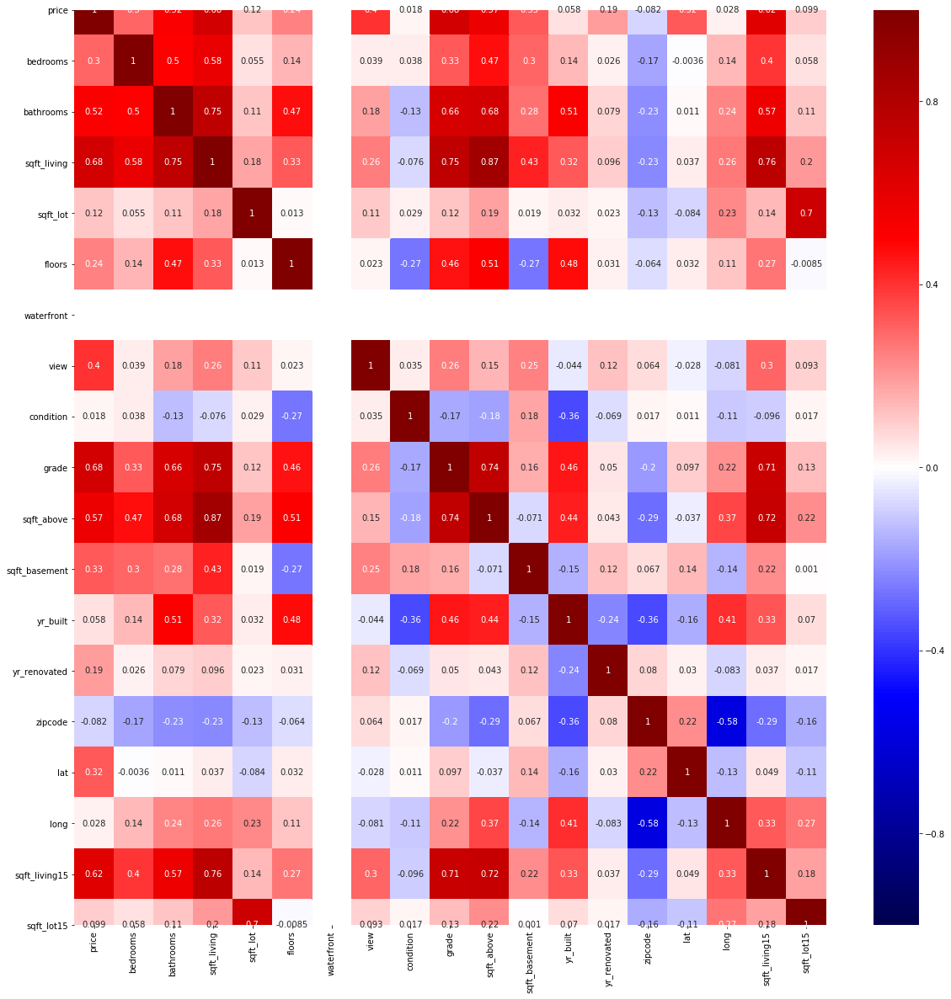

<Figure size 1440x1440 with 0 Axes>

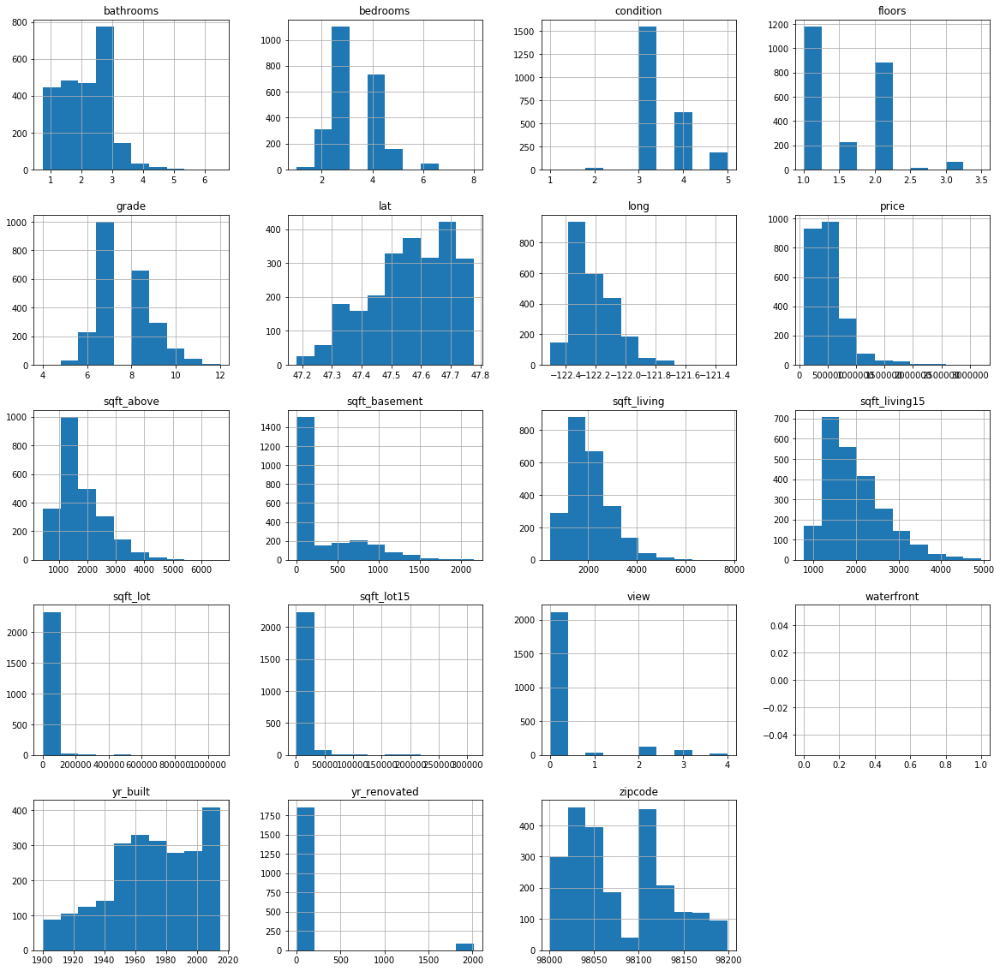

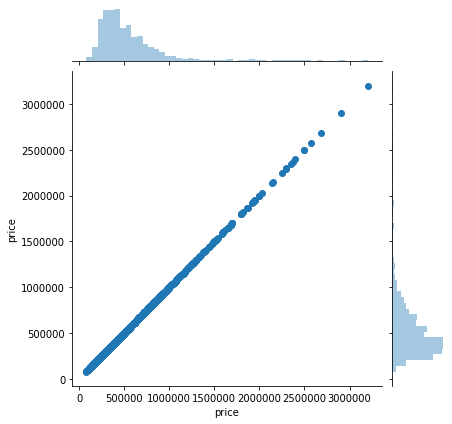

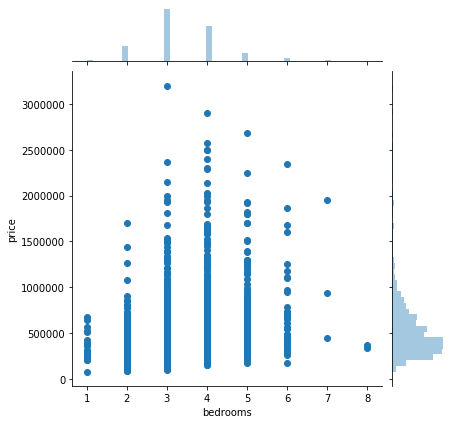

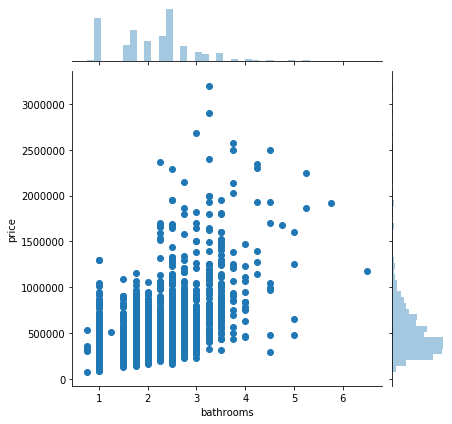

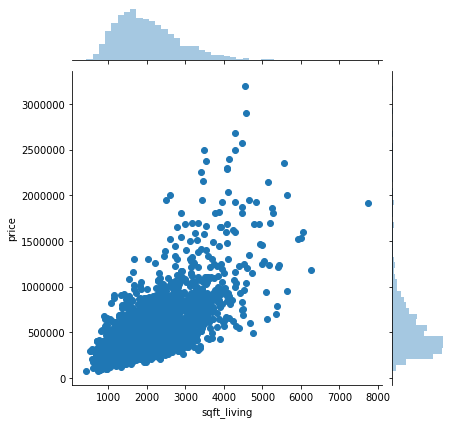

...

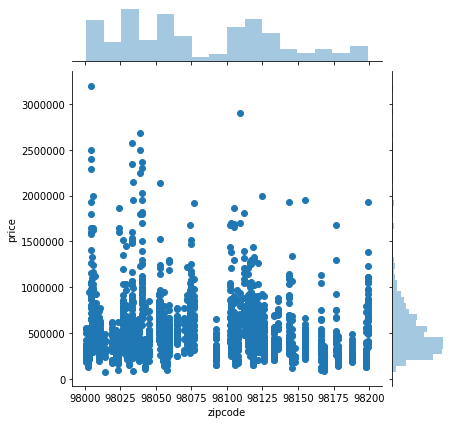

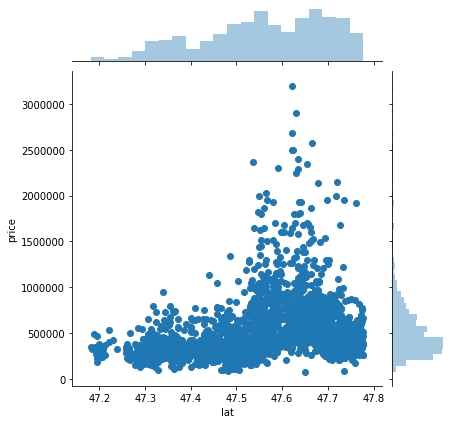

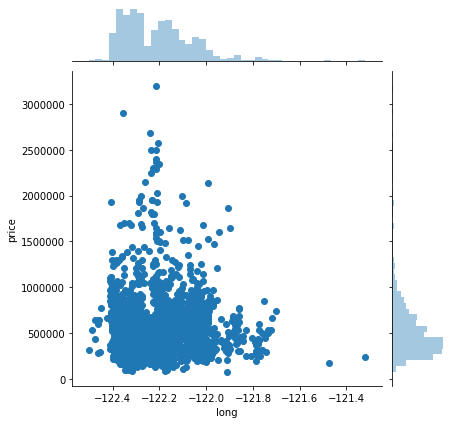

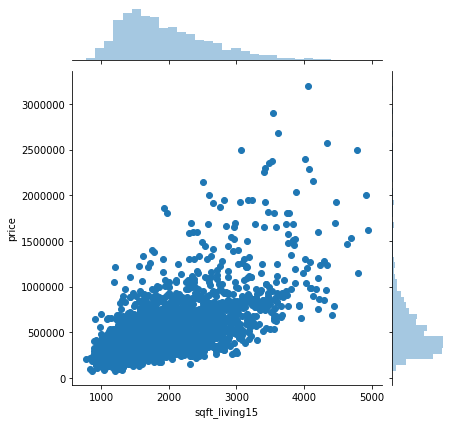

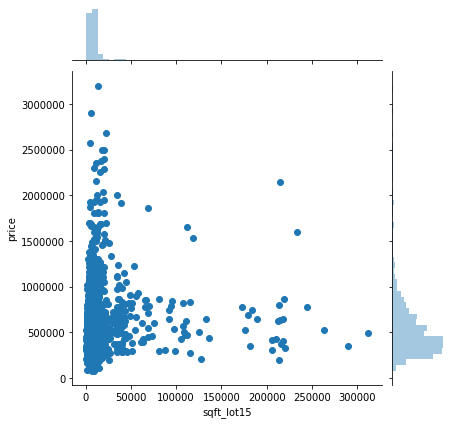

In [46]:
#waterfront == NaN
statistics(df[df['waterfront'].isna()], target='price')

Shape:  (146, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 146 entries, 49 to 21560
Data columns (total 19 columns):
price            146 non-null float64
bedrooms         146 non-null float64
bathrooms        146 non-null float64
sqft_living      146 non-null float64
sqft_lot         146 non-null float64
floors           146 non-null float64
waterfront       146 non-null float64
view             145 non-null float64
condition        146 non-null int64
grade            146 non-null int64
sqft_above       146 non-null float64
sqft_basement    146 non-null float64
yr_built         146 non-null int64
yr_renovated     121 non-null float64
zipcode          146 non-null int64
lat              146 non-null float64
long             146 non-null float64
sqft_living15    146 non-null float64
sqft_lot15       146 non-null float64
dtypes: float64(15), int64(4)
memory usage: 22.8 KB
None

count, mean, std, min, max, quartiles:

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/seaborn/axisgrid.py:1675: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


Int64Index([], dtype='int64')

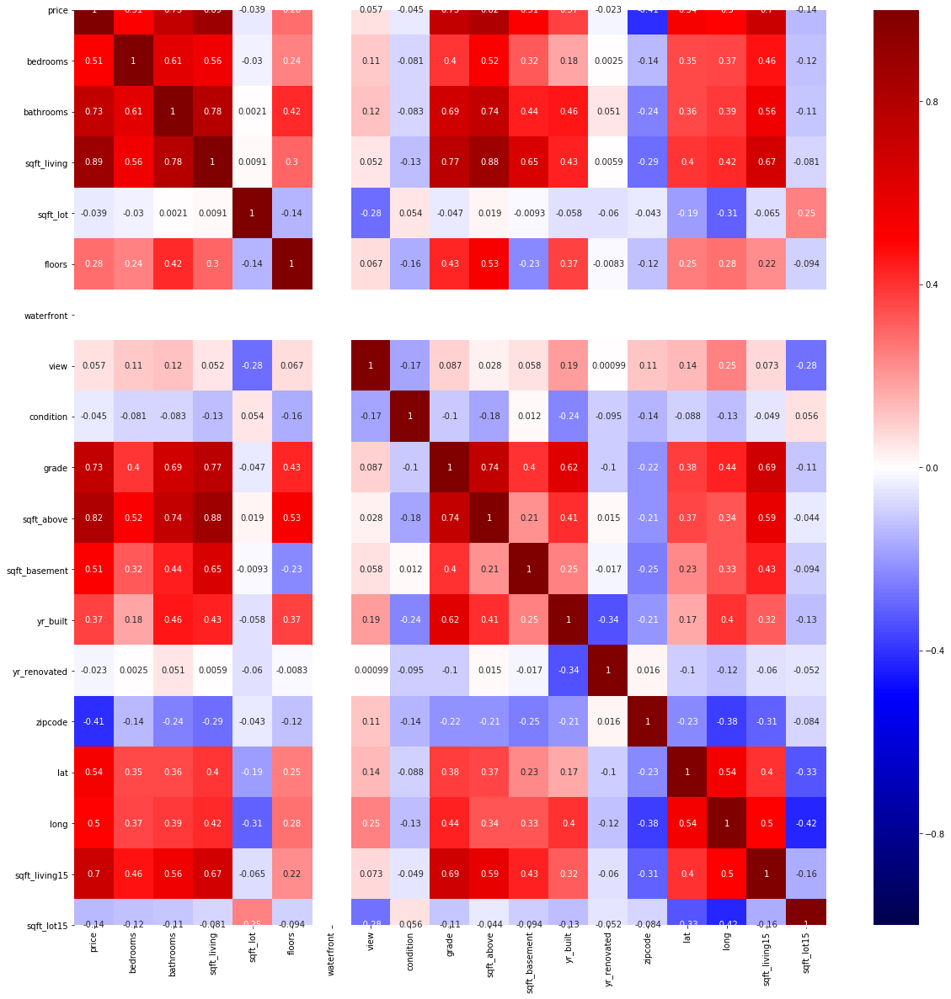

<Figure size 1440x1440 with 0 Axes>

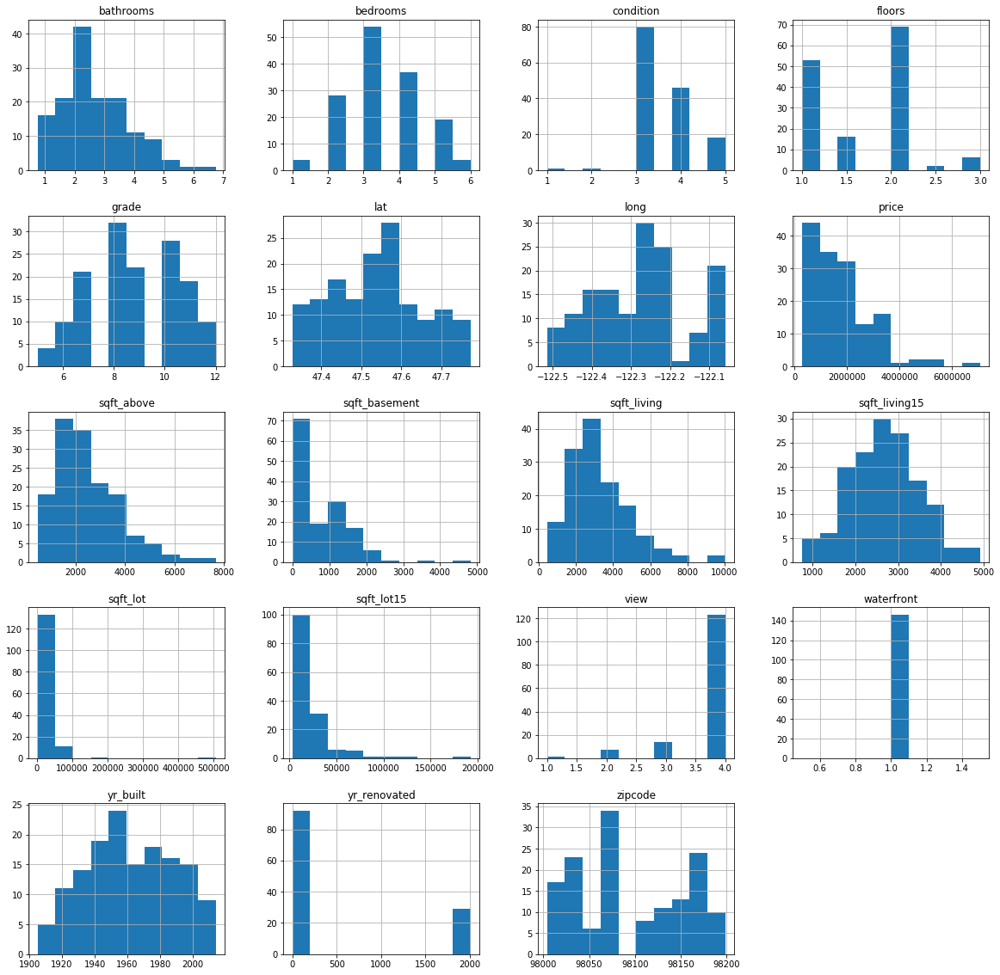

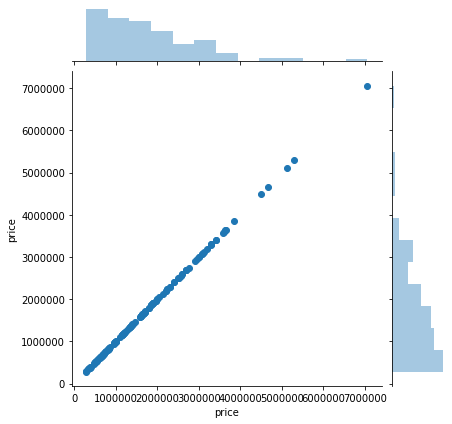

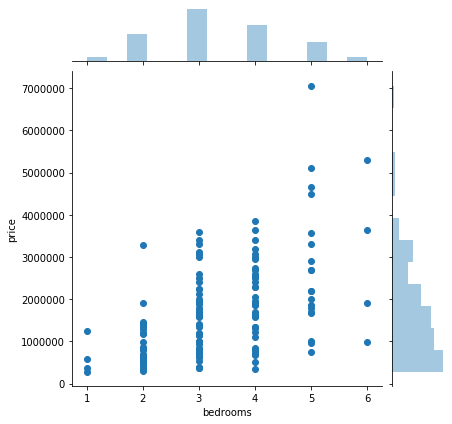

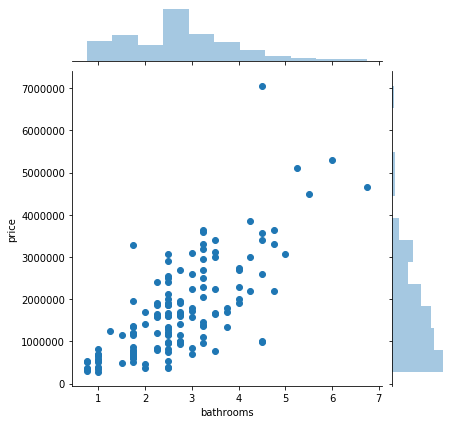

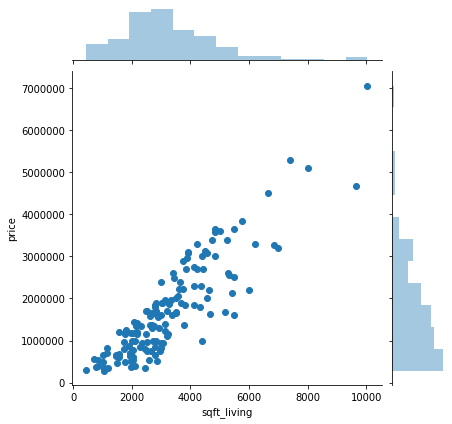

...

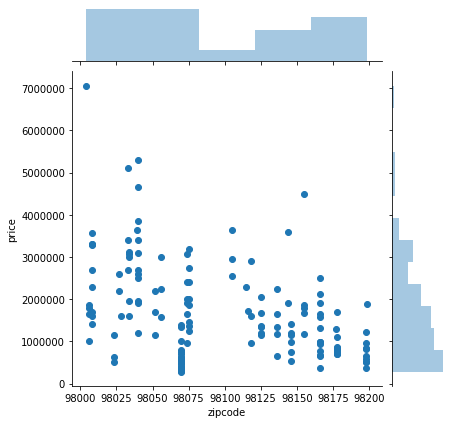

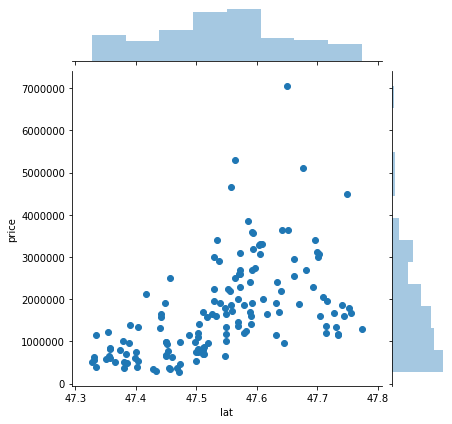

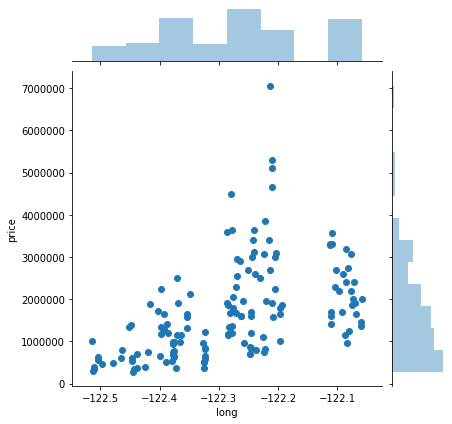

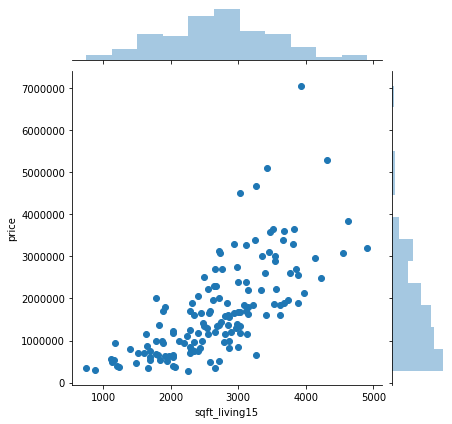

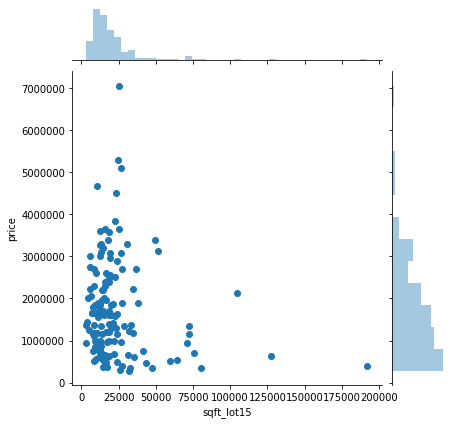

In [47]:
#waterfront == 1
statistics(df[~df['waterfront'].isna() &
              df['waterfront'] == 1], target='price')

Shape:  (21451, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 21451 entries, 0 to 21596
Data columns (total 19 columns):
price            21451 non-null float64
bedrooms         21451 non-null float64
bathrooms        21451 non-null float64
sqft_living      21451 non-null float64
sqft_lot         21451 non-null float64
floors           21451 non-null float64
waterfront       19075 non-null float64
view             21389 non-null float64
condition        21451 non-null int64
grade            21451 non-null int64
sqft_above       21451 non-null float64
sqft_basement    21451 non-null float64
yr_built         21451 non-null int64
yr_renovated     17634 non-null float64
zipcode          21451 non-null int64
lat              21451 non-null float64
long             21451 non-null float64
sqft_living15    21451 non-null float64
sqft_lot15       21451 non-null float64
dtypes: float64(15), int64(4)
memory usage: 3.3 MB
None

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/seaborn/axisgrid.py:1675: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


Int64Index([4348, 14969, 20038, 20508], dtype='int64')

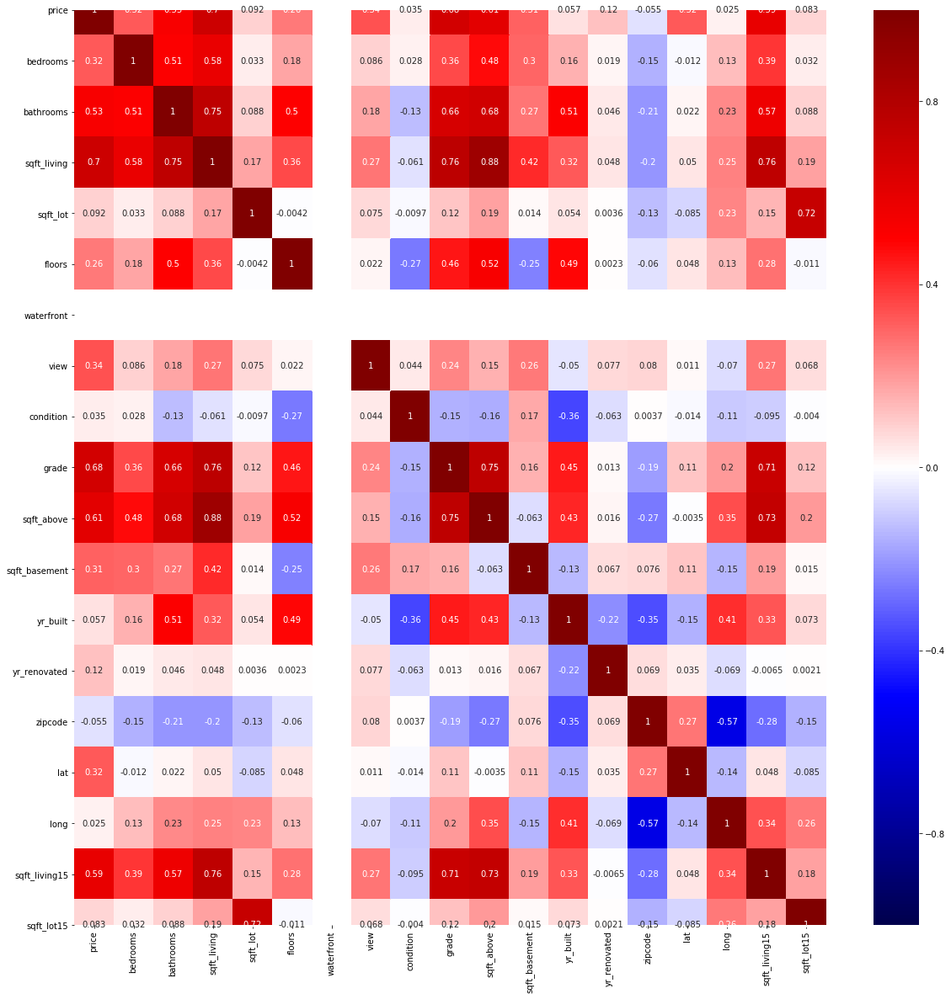

<Figure size 1440x1440 with 0 Axes>

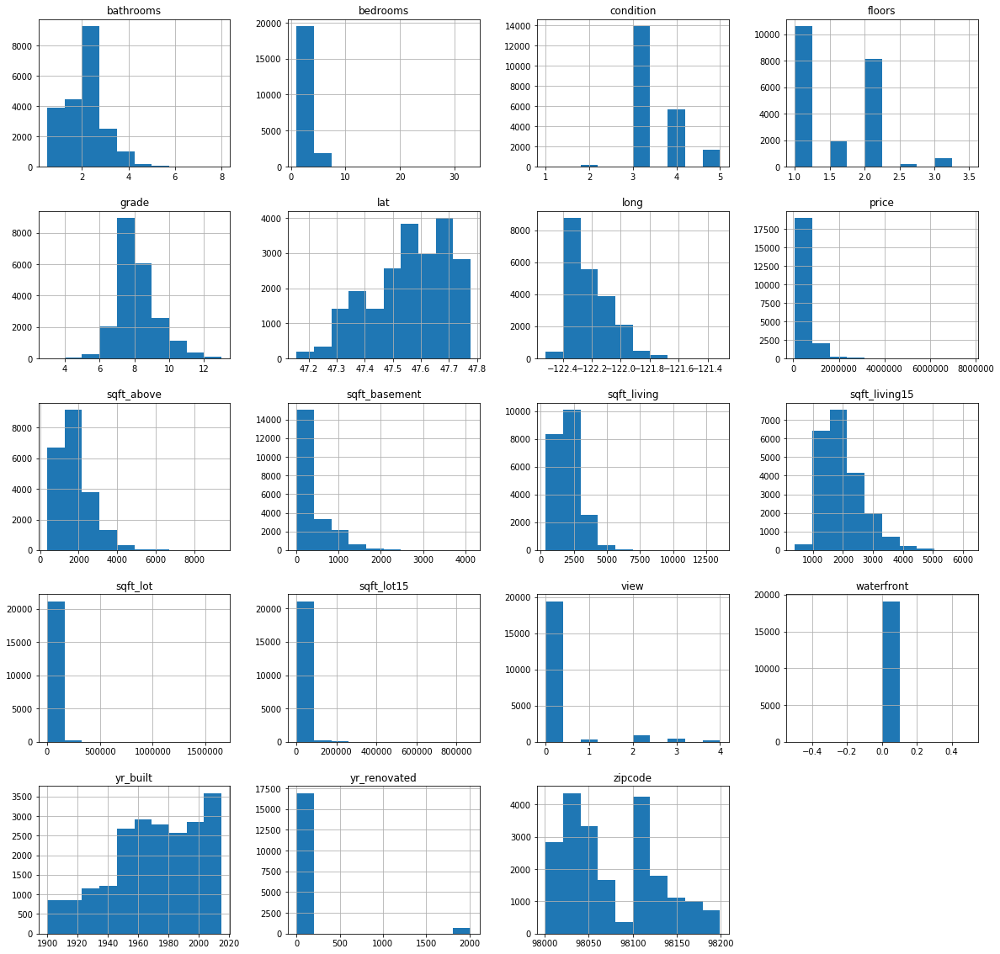

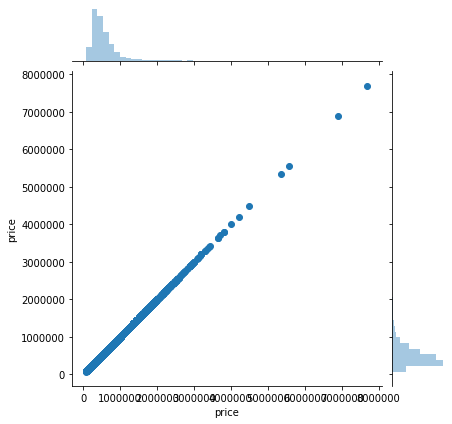

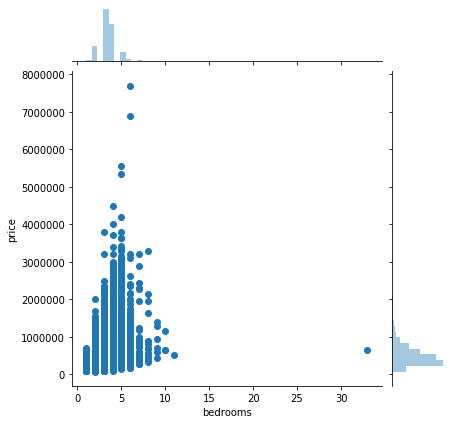

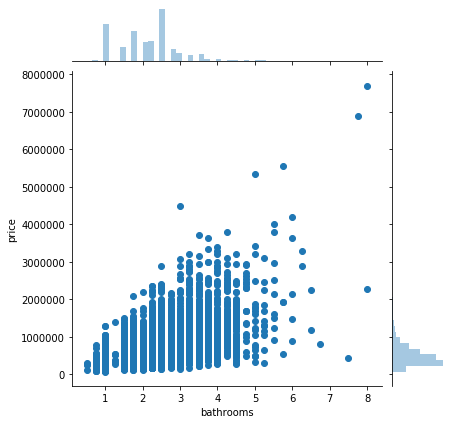

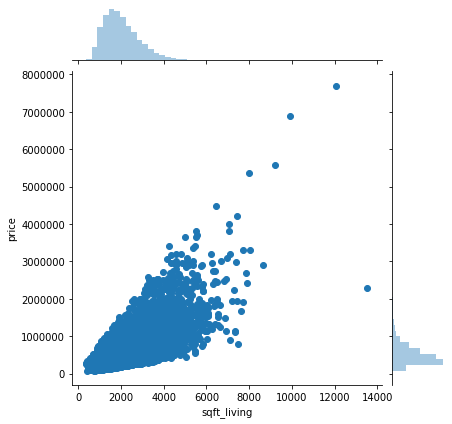

...

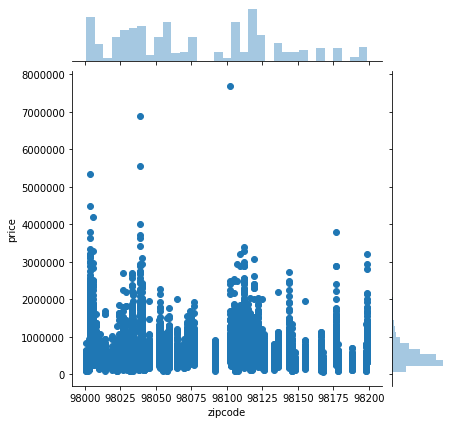

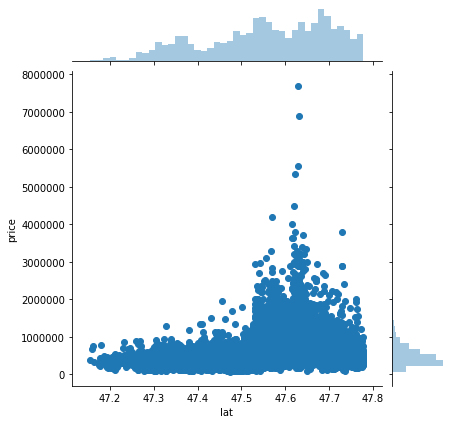

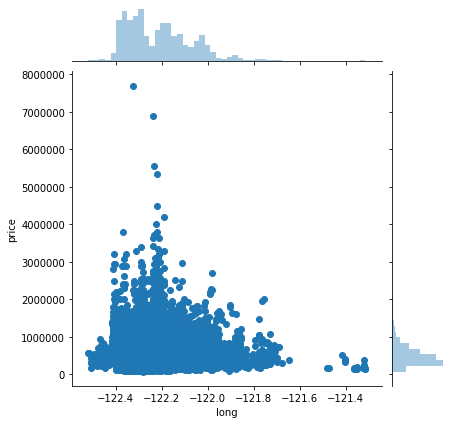

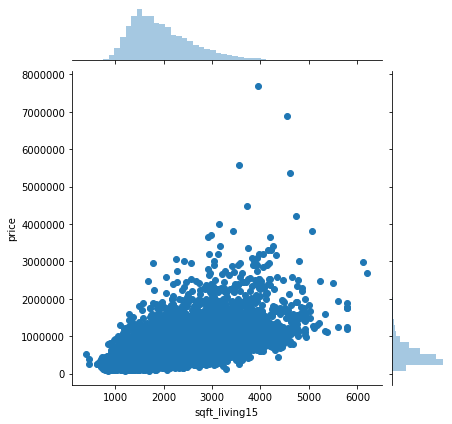

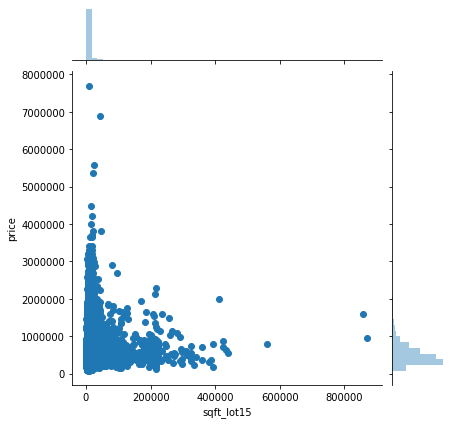

In [48]:
#waterfront == 0
statistics(df[~df['waterfront'].isna() &
              df['waterfront'] == 0], target='price')

The *waterfront* == NaN distributions appear very similar to *watefront* == 0. We choose to substitute NaN values with the median value for *waterfront* == 0, which is 0.

In [53]:
df['waterfront'] = df['waterfront'].fillna(df['waterfront'].median())

### *yr_renovated*

We're going to adopt the same approach we used for *waterfront*.

Shape:  (3842, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 3842 entries, 2 to 21583
Data columns (total 19 columns):
price            3842 non-null float64
bedrooms         3842 non-null float64
bathrooms        3842 non-null float64
sqft_living      3842 non-null float64
sqft_lot         3842 non-null float64
floors           3842 non-null float64
waterfront       3842 non-null float64
view             3830 non-null float64
condition        3842 non-null int64
grade            3842 non-null int64
sqft_above       3842 non-null float64
sqft_basement    3842 non-null float64
yr_built         3842 non-null int64
yr_renovated     0 non-null float64
zipcode          3842 non-null int64
lat              3842 non-null float64
long             3842 non-null float64
sqft_living15    3842 non-null float64
sqft_lot15       3842 non-null float64
dtypes: float64(15), int64(4)
memory usage: 600.3 KB
None

count, mean, std, mi

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:959: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)


Int64Index([], dtype='int64')

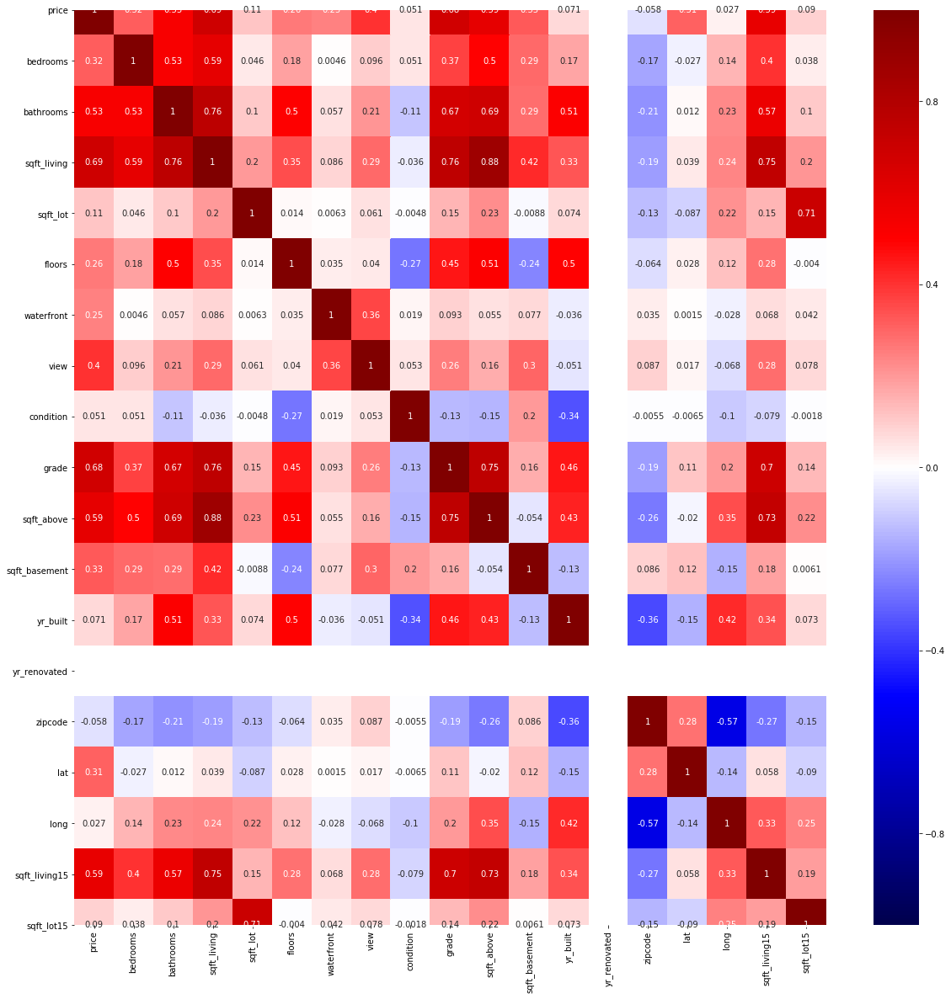

<Figure size 1440x1440 with 0 Axes>

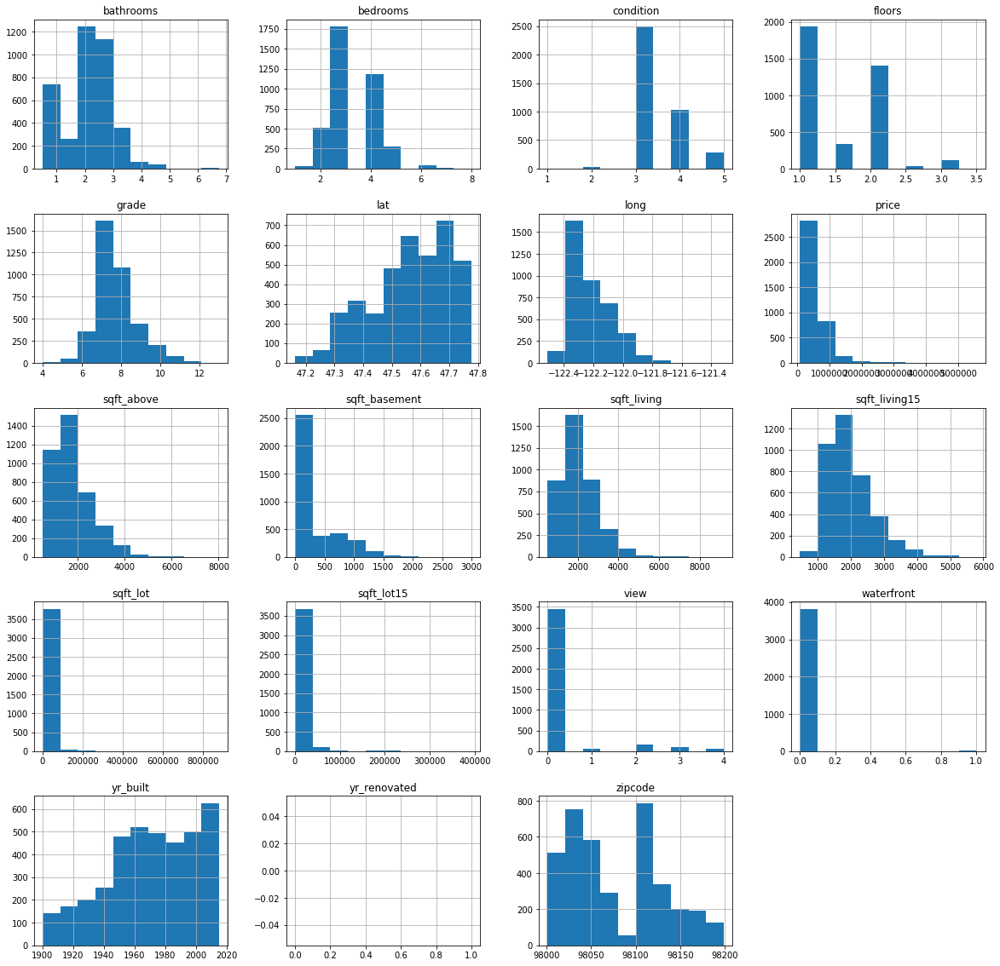

In [50]:
statistics(df[df['yr_renovated'].isna()])

Shape:  (744, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 744 entries, 1 to 20946
Data columns (total 19 columns):
price            744 non-null float64
bedrooms         744 non-null float64
bathrooms        744 non-null float64
sqft_living      744 non-null float64
sqft_lot         744 non-null float64
floors           744 non-null float64
waterfront       744 non-null float64
view             743 non-null float64
condition        744 non-null int64
grade            744 non-null int64
sqft_above       744 non-null float64
sqft_basement    744 non-null float64
yr_built         744 non-null int64
yr_renovated     744 non-null float64
zipcode          744 non-null int64
lat              744 non-null float64
long             744 non-null float64
sqft_living15    744 non-null float64
sqft_lot15       744 non-null float64
dtypes: float64(15), int64(4)
memory usage: 116.2 KB
None

count, mean, std, min, max, quartiles:

Int64Index([3947], dtype='int64')

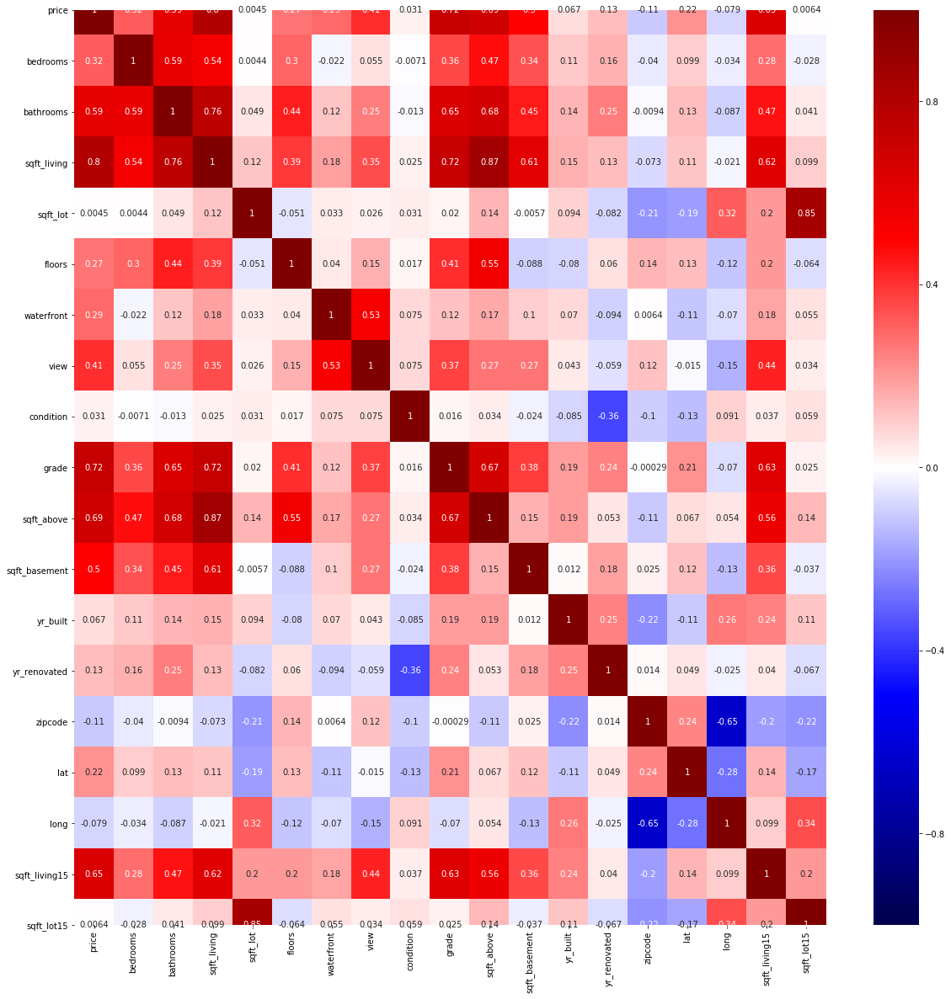

<Figure size 1440x1440 with 0 Axes>

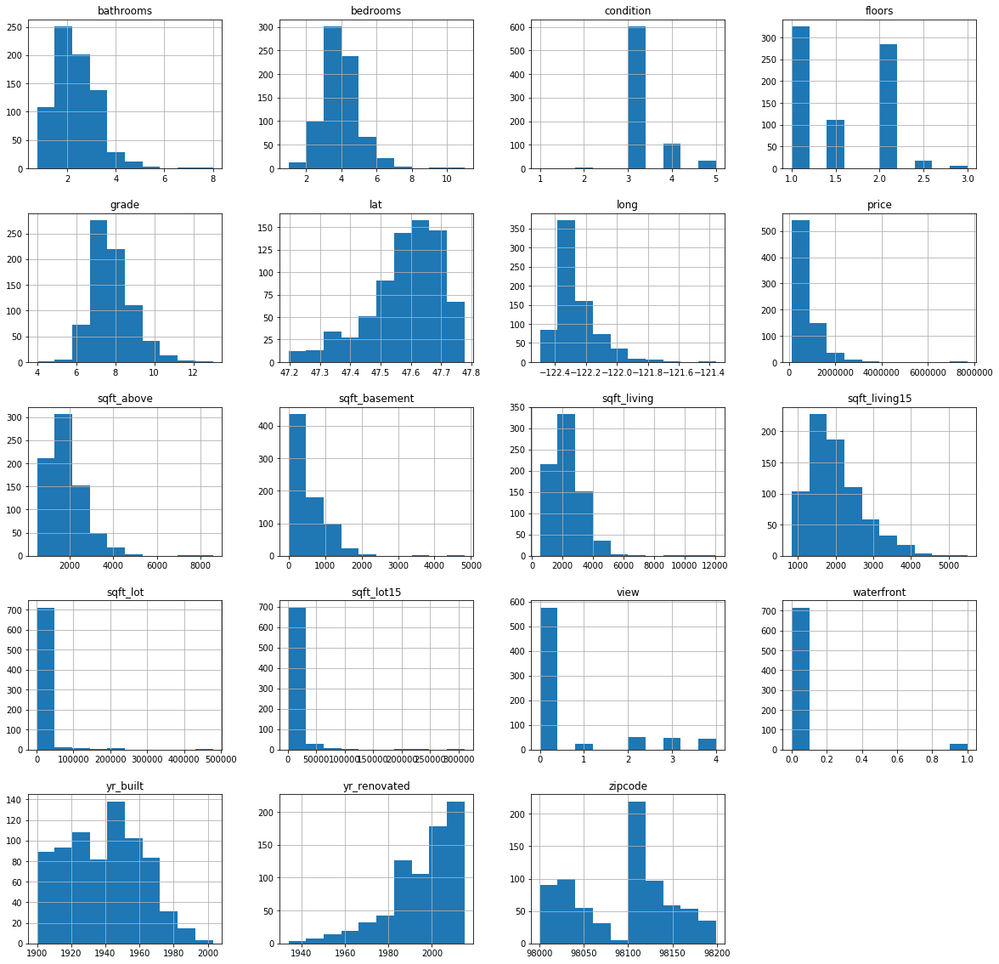

In [51]:
#yr_renovated != 0
statistics(df[~df['yr_renovated'].isna() & df['yr_renovated'] != 0])

Shape:  (20853, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 20853 entries, 0 to 21596
Data columns (total 19 columns):
price            20853 non-null float64
bedrooms         20853 non-null float64
bathrooms        20853 non-null float64
sqft_living      20853 non-null float64
sqft_lot         20853 non-null float64
floors           20853 non-null float64
waterfront       20853 non-null float64
view             20791 non-null float64
condition        20853 non-null int64
grade            20853 non-null int64
sqft_above       20853 non-null float64
sqft_basement    20853 non-null float64
yr_built         20853 non-null int64
yr_renovated     17011 non-null float64
zipcode          20853 non-null int64
lat              20853 non-null float64
long             20853 non-null float64
sqft_living15    20853 non-null float64
sqft_lot15       20853 non-null float64
dtypes: float64(15), int64(4)
memory usage: 3.2 MB
None

Int64Index([4348, 14969, 20038, 20508], dtype='int64')

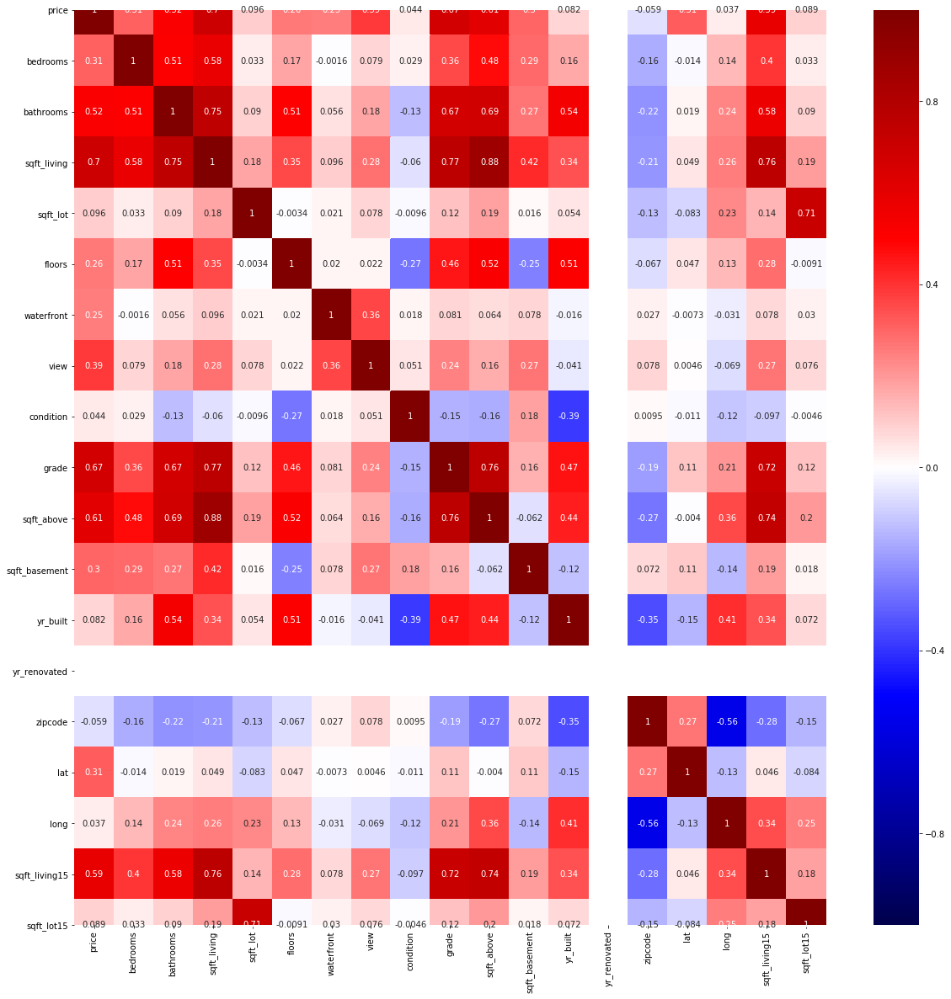

<Figure size 1440x1440 with 0 Axes>

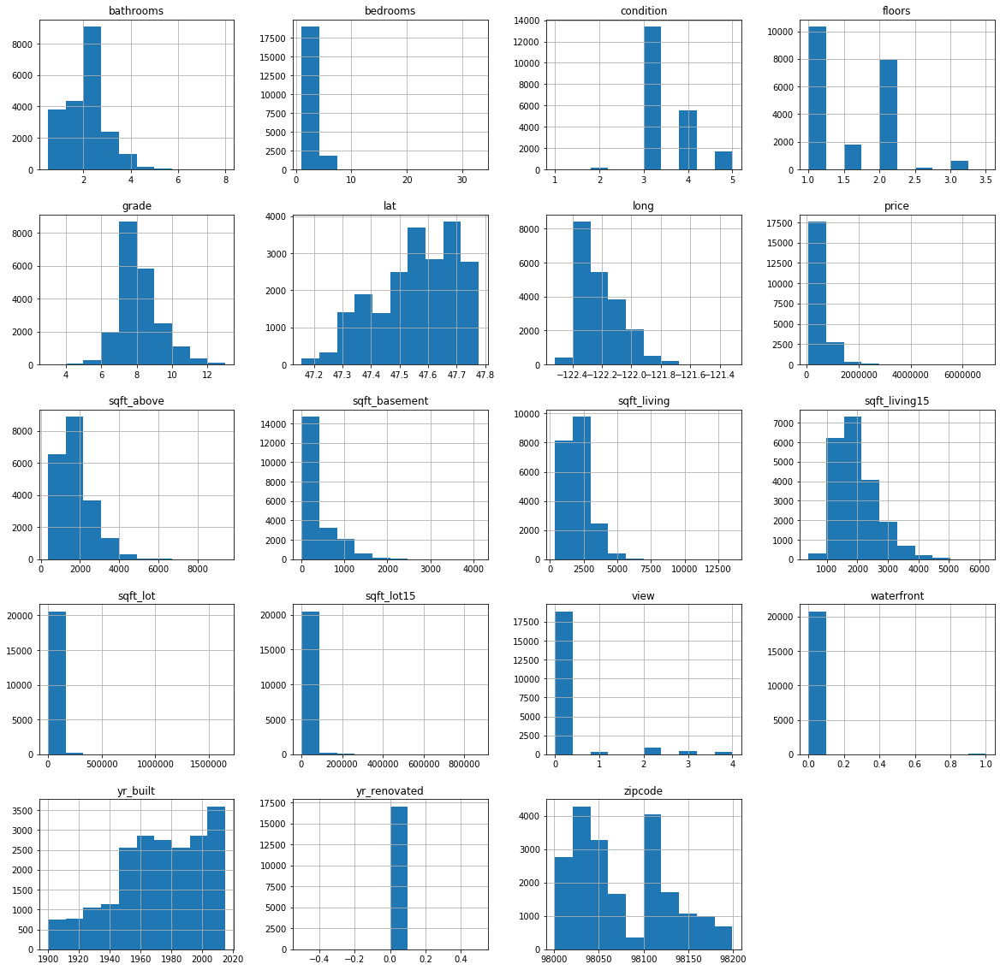

In [52]:
#yr_renovated == 0
statistics(df[~df['yr_renovated'].isna() & df['yr_renovated'] == 0])

The distributions for *yr_renovated* == NaN and *yr_renovated* == 0 appear very similar. We choose to substitute NaN values with 0 (median value)

In [41]:
df['yr_renovated'] = df['yr_renovated'].fillna(df['yr_renovated'].median())

### *view*

Shape:  (63, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 63 entries, 7 to 21589
Data columns (total 19 columns):
price            63 non-null float64
bedrooms         63 non-null float64
bathrooms        63 non-null float64
sqft_living      63 non-null float64
sqft_lot         63 non-null float64
floors           63 non-null float64
waterfront       63 non-null float64
view             0 non-null float64
condition        63 non-null int64
grade            63 non-null int64
sqft_above       63 non-null float64
sqft_basement    63 non-null float64
yr_built         63 non-null int64
yr_renovated     63 non-null float64
zipcode          63 non-null int64
lat              63 non-null float64
long             63 non-null float64
sqft_living15    63 non-null float64
sqft_lot15       63 non-null float64
dtypes: float64(15), int64(4)
memory usage: 9.8 KB
None

count, mean, std, min, max, quartiles:

              price   

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/lib/function_base.py:3405: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


Int64Index([], dtype='int64')

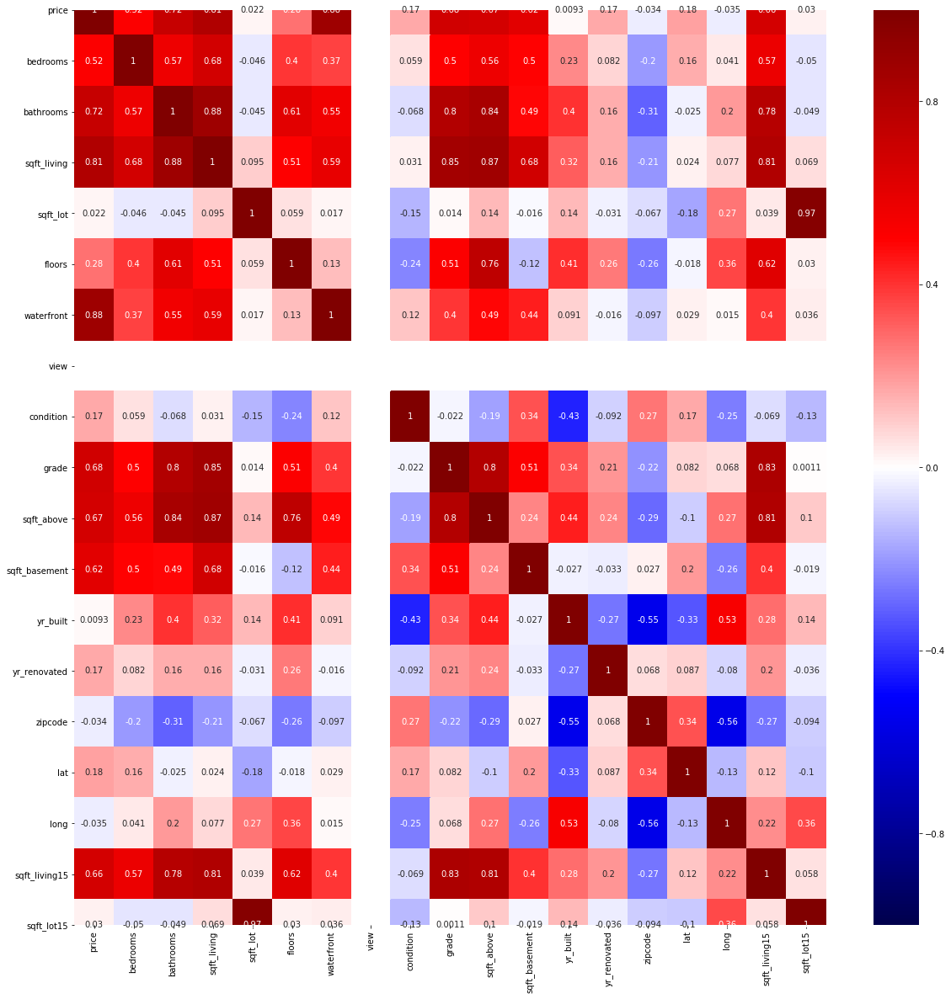

<Figure size 1440x1440 with 0 Axes>

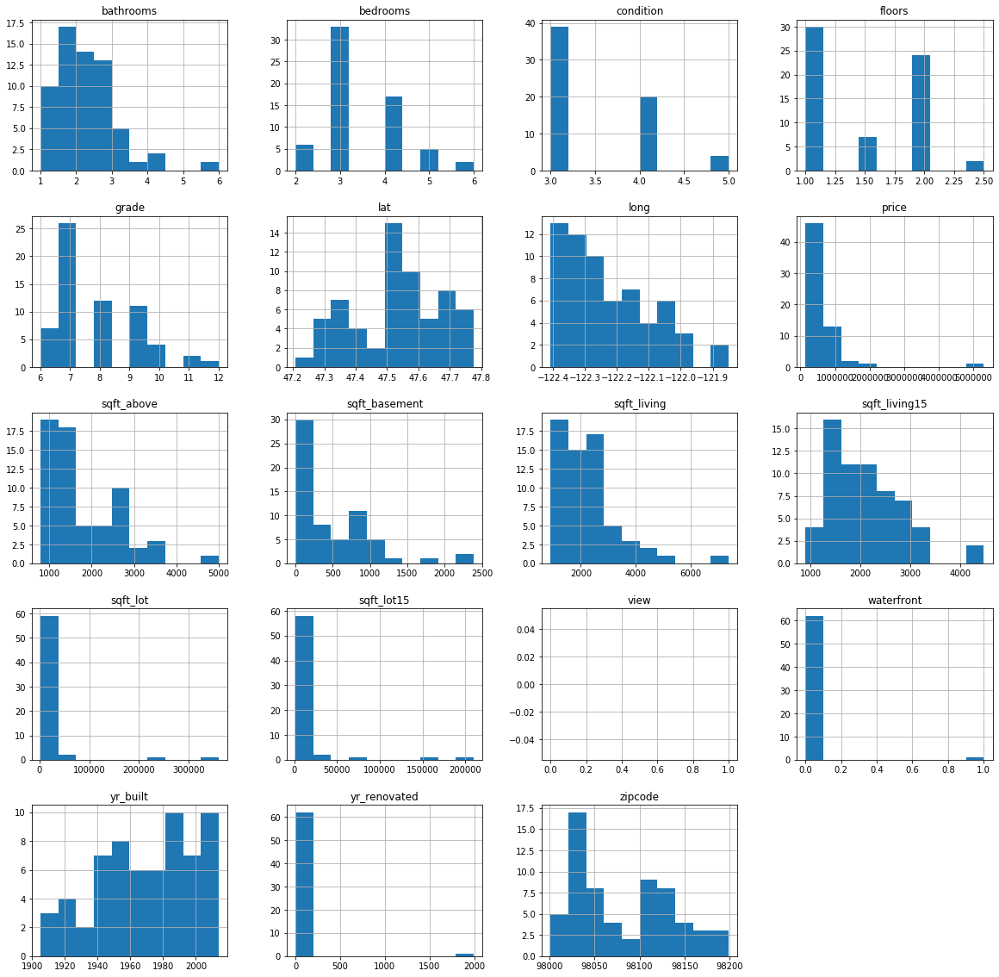

In [54]:
statistics(df[df['view'].isna()])

Shape:  (19485, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 19485 entries, 0 to 21596
Data columns (total 19 columns):
price            19485 non-null float64
bedrooms         19485 non-null float64
bathrooms        19485 non-null float64
sqft_living      19485 non-null float64
sqft_lot         19485 non-null float64
floors           19485 non-null float64
waterfront       19485 non-null float64
view             19422 non-null float64
condition        19485 non-null int64
grade            19485 non-null int64
sqft_above       19485 non-null float64
sqft_basement    19485 non-null float64
yr_built         19485 non-null int64
yr_renovated     19485 non-null float64
zipcode          19485 non-null int64
lat              19485 non-null float64
long             19485 non-null float64
sqft_living15    19485 non-null float64
sqft_lot15       19485 non-null float64
dtypes: float64(15), int64(4)
memory usage: 3.0 MB
None

Int64Index([4348, 14969, 20038, 20508], dtype='int64')

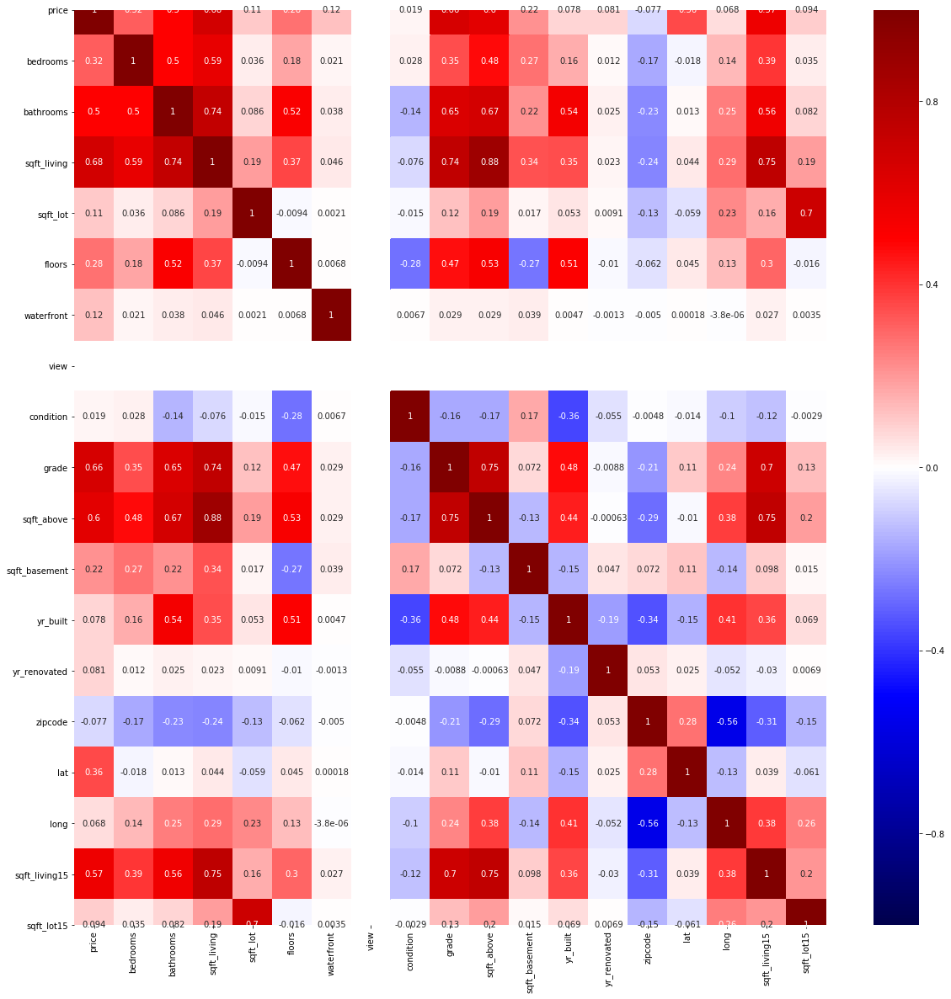

<Figure size 1440x1440 with 0 Axes>

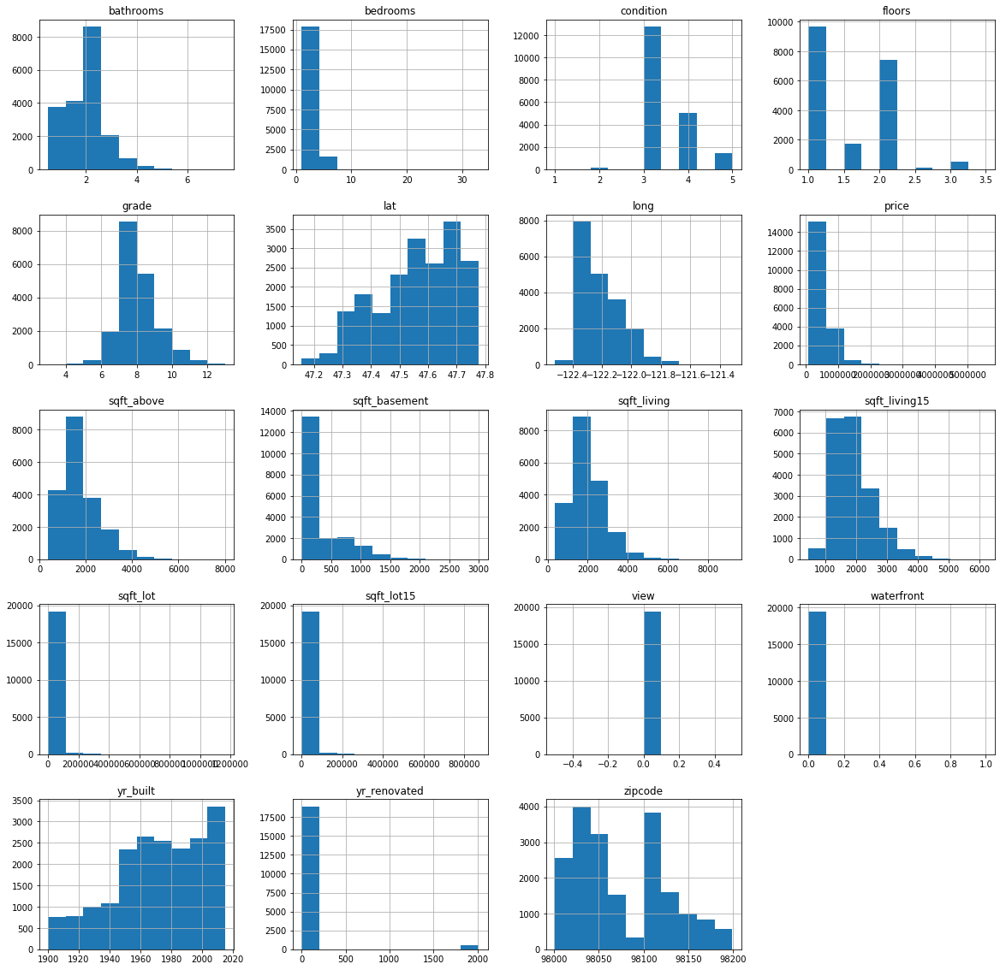

In [55]:
#view == 0
statistics(df[~df['view'].isna() & df['view'] == 0])

Shape:  (2112, 19)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2112 entries, 15 to 21582
Data columns (total 19 columns):
price            2112 non-null float64
bedrooms         2112 non-null float64
bathrooms        2112 non-null float64
sqft_living      2112 non-null float64
sqft_lot         2112 non-null float64
floors           2112 non-null float64
waterfront       2112 non-null float64
view             2112 non-null float64
condition        2112 non-null int64
grade            2112 non-null int64
sqft_above       2112 non-null float64
sqft_basement    2112 non-null float64
yr_built         2112 non-null int64
yr_renovated     2112 non-null float64
zipcode          2112 non-null int64
lat              2112 non-null float64
long             2112 non-null float64
sqft_living15    2112 non-null float64
sqft_lot15       2112 non-null float64
dtypes: float64(15), int64(4)
memory usage: 330.0 KB
None

count, mean, std

Int64Index([3947], dtype='int64')

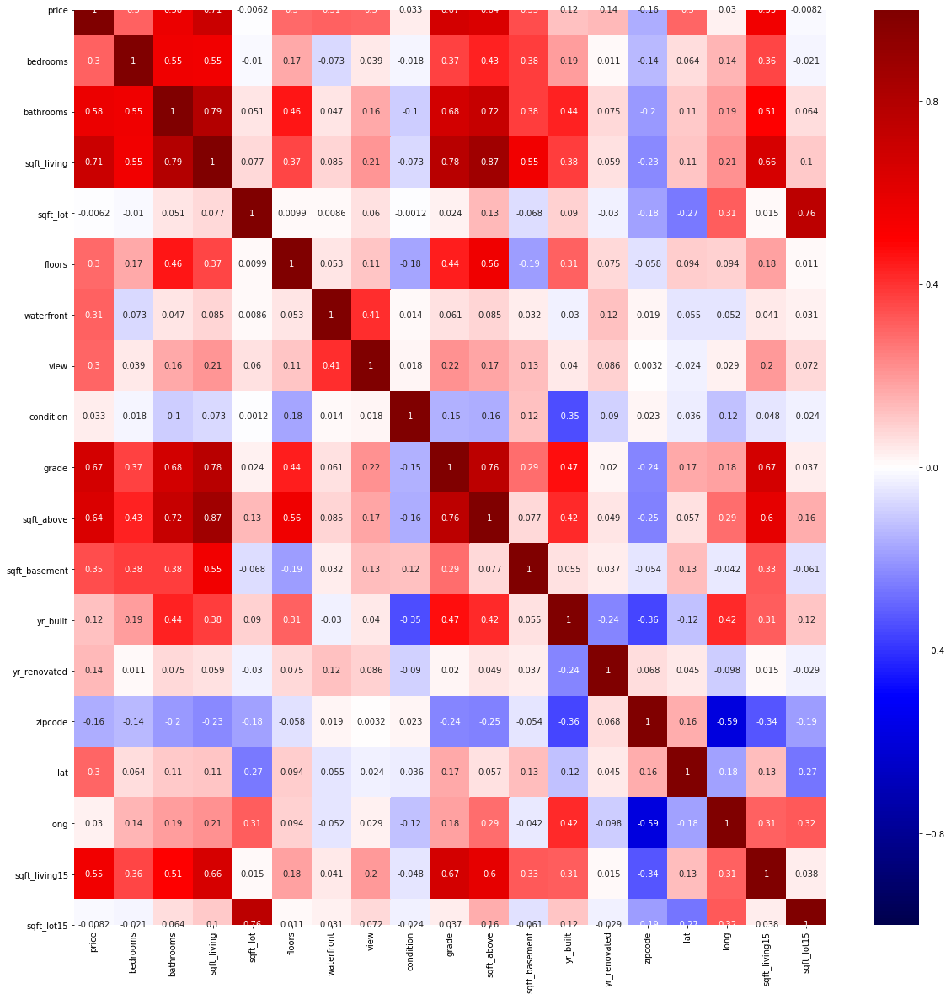

<Figure size 1440x1440 with 0 Axes>

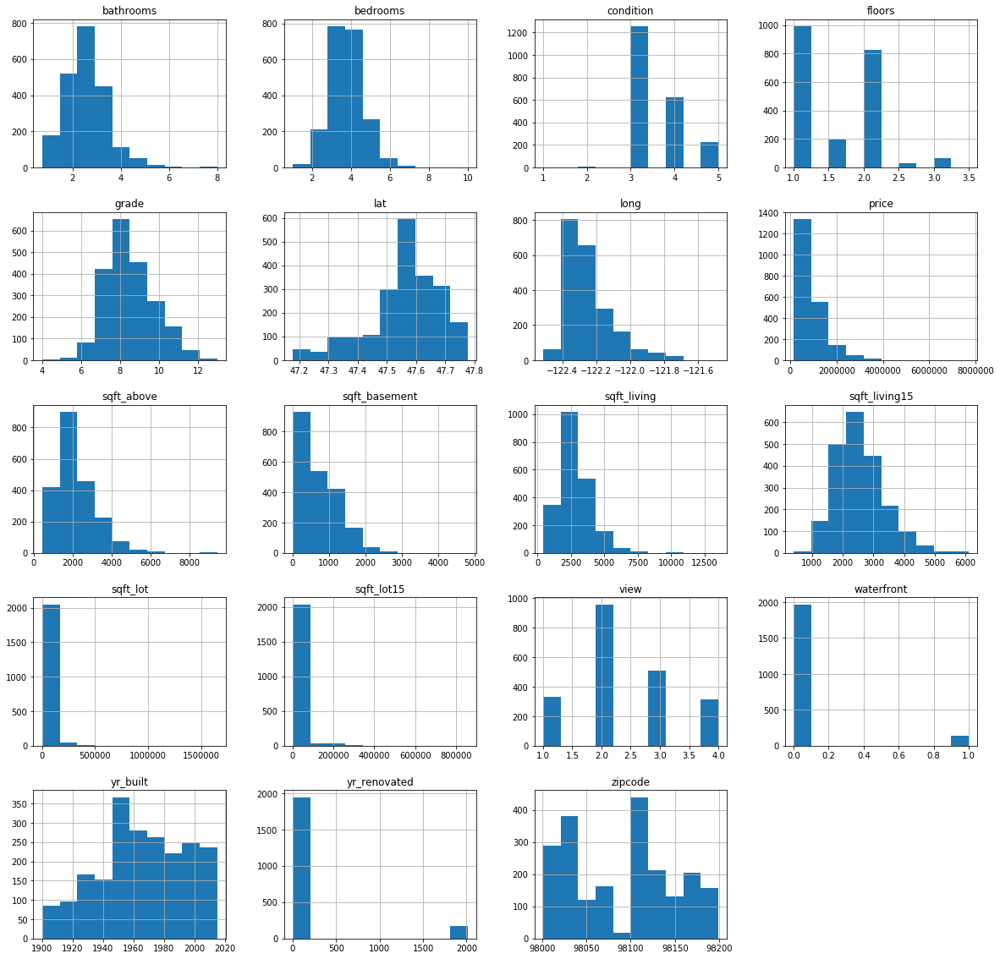

In [56]:
#view != 0
statistics(df[~df['view'].isna() & df['view'] != 0])

The distributions for *view* == NaN are similar to the distributions to when *view* == 0. Therefore fill NaN values with 0.

In [54]:
df['view'] = df['view'].fillna(0)

## Feature engineering

### Transforming *yr_renovated* into binary

In [43]:
df['renovated'] = df['yr_renovated'].apply(lambda x: 1 if x != 0 else 0)

In [44]:
df.drop('yr_renovated', inplace=True, axis=1)

In [60]:
cont.remove('yr_renovated'), cont6.remove('yr_renovated')

(None, None)

### Classifying each property by Median Household Income

Determine to which tract each property belongs to, get for each property its median houshold income given by the tract.

In [56]:
gdf = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.long, df.lat))

In [60]:
# map houses by Median Household Income per tract
gdf['MHI'] = 0
for x in gdf.iterrows():
    if (census['geometry'].contains(x[1]['geometry']).any()) | (census['geometry'].intersects(x[1]['geometry']).any()):
        gdf['MHI'][x[0]] = census[census['geometry'].contains(
            x[1]['geometry'])]['E19113069']
    else:
        gdf['MHI'][x[0]] = None

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [61]:
# drop NaN
gdf = gdf[~gdf['MHI'].isna()]

In [65]:
# convert geodataframe into dataframe
df = pd.DataFrame(gdf.drop(columns='geometry'))

In [66]:
# update continous variables lists
cont.append('MHI')
cont6.append('MHI')

## Export dataset before transformations to csv

In [62]:
gdf.to_csv(os.path.join(
    path, r'geodataframe_cleaned_not_processed.csv'), index=False)

In [67]:
dfout = df.copy(deep=True)

In [68]:
target = df['price']

In [69]:
target.to_csv(os.path.join(path, r'target.csv'), header='price', index=False)

In [70]:
df.drop(os.path.join(path, r'price'), axis=1, inplace=True)

In [71]:
df.to_csv(os.path.join(path, r'baseline_cleaned_not_processed.csv'), index=False)

## Without removing outliers


### Log-transform positive skewed variables

#### Dataset with category levels threshold < 29

Let's recall our continous variables:

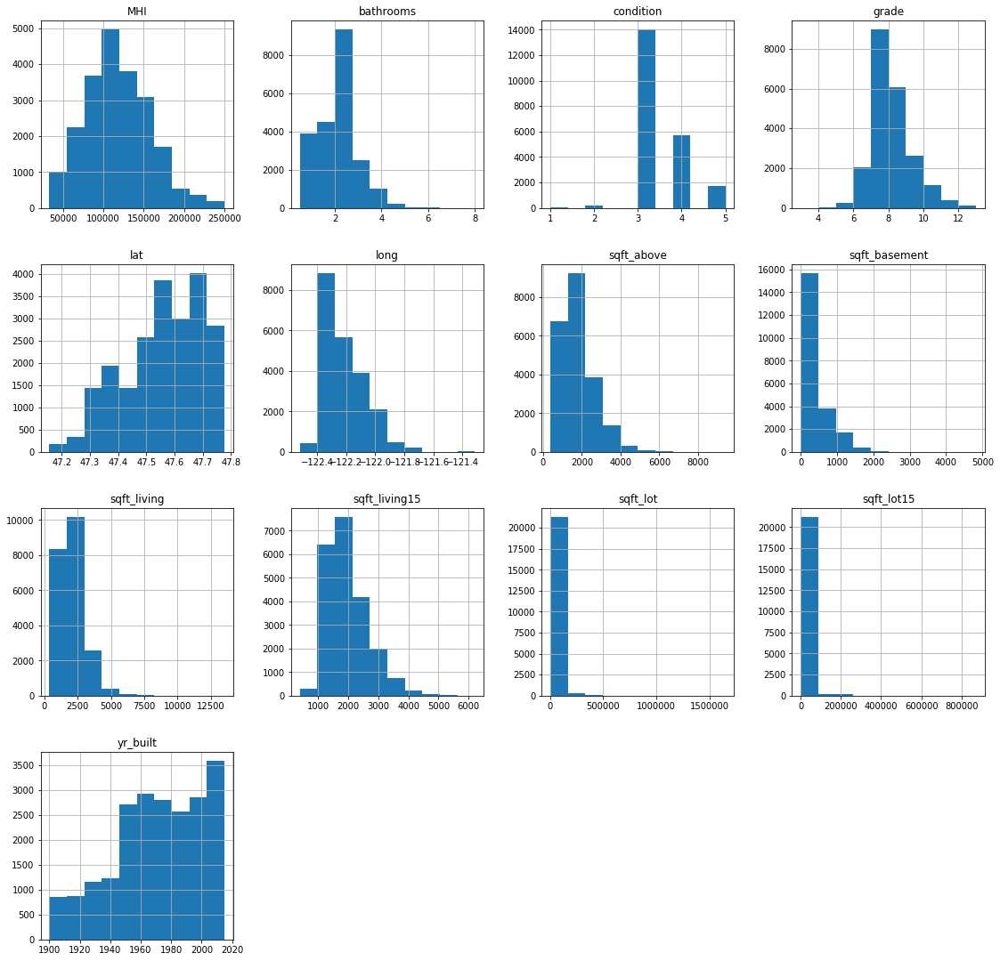

In [72]:
df[cont].hist(figsize=(19, 19))

In [73]:
dflog = df.copy()

In [74]:
# select only positively skewed columns to log-transform
nonlog = ['lat', 'long', 'yr_built', 'grade',
          'condition', 'zipcode', 'renovated']
log = list((Counter(list(dflog[cont].columns)) - Counter(nonlog)).keys())

In [75]:
logtransform(dflog)

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,...,log-sqft_lot,log-floors,log-waterfront,log-view,log-sqft_above,log-sqft_basement,log-lat,log-sqft_living15,log-sqft_lot15,log-MHI
0,3.0,1.00,1180.0,5650.0,1.0,1.0,1.0,3,7,1180.0,...,8.639411,0.000000,0.0,0.0,7.073270,0.000000,3.860965,7.200425,8.639411,11.526167
1,3.0,2.25,2570.0,7242.0,2.0,1.0,1.0,3,7,2170.0,...,8.887653,0.693147,0.0,0.0,7.682482,5.991465,3.865372,7.432484,8.941022,11.222814
2,2.0,1.00,770.0,10000.0,1.0,1.0,1.0,3,6,770.0,...,9.210340,0.000000,0.0,0.0,6.646391,0.000000,3.865726,7.908387,8.994917,11.776358
3,4.0,3.00,1960.0,5000.0,1.0,1.0,1.0,5,7,1050.0,...,8.517193,0.000000,0.0,0.0,6.956545,6.813445,3.861168,7.215240,8.517193,11.884641
4,3.0,2.00,1680.0,8080.0,1.0,1.0,1.0,3,8,1680.0,...,8.997147,0.000000,0.0,0.0,7.426549,0.000000,3.863186,7.495542,8.923058,12.083622
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,3.0,2.50,1530.0,1131.0,3.0,1.0,1.0,3,8,1530.0,...,7.030857,1.098612,0.0,0.0,7.333023,0.000000,3.864917,7.333023,7.319202,11.607499
21593,4.0,2.50,2310.0,5813.0,2.0,1.0,1.0,3,8,2310.0,...,8.667852,0.693147,0.0,0.0,7.745003,0.000000,3.860955,7.512071,8.881836,11.213576
21594,2.0,0.75,1020.0,1350.0,2.0,1.0,1.0,3,7,1020.0,...,7.207860,0.693147,0.0,0.0,6.927558,0.000000,3.862715,6.927558,7.604396,11.566096
21595,3.0,2.50,1600.0,2388.0,2.0,1.0,1.0,3,8,1600.0,...,7.778211,0.693147,0.0,0.0,7.377759,0.000000,3.861456,7.251345,7.160069,12.116531


Shape:  (21596, 32)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 21596 entries, 0 to 21596
Data columns (total 32 columns):
bedrooms             21596 non-null float64
bathrooms            21596 non-null float64
sqft_living          21596 non-null float64
sqft_lot             21596 non-null float64
floors               21596 non-null float64
waterfront           21596 non-null float64
view                 21596 non-null float64
condition            21596 non-null int64
grade                21596 non-null int64
sqft_above           21596 non-null float64
sqft_basement        21596 non-null float64
yr_built             21596 non-null int64
zipcode              21596 non-null int64
lat                  21596 non-null float64
long                 21596 non-null float64
sqft_living15        21596 non-null float64
sqft_lot15           21596 non-null float64
renovated            21596 non-null int64
MHI                  2159


Column name: sqft_lot

5000.0     0.016577
6000.0     0.013428
4000.0     0.011623
7200.0     0.010187
7500.0     0.005510
             ...   
15235.0    0.000046
47870.0    0.000046
42840.0    0.000046
53696.0    0.000046
11783.0    0.000046
Name: sqft_lot, Length: 9775, dtype: float64

Column name: floors

1.0    0.494166
2.0    0.381321
1.5    0.088442
3.0    0.028292
2.5    0.007455
3.5    0.000324
Name: floors, dtype: float64

Column name: waterfront

1.0    1.0
Name: waterfront, dtype: float64

Column name: view

1.0    0.917485
2.0    0.044314
3.0    0.023523
4.0    0.014679
Name: view, dtype: float64

Column name: condition

3    0.649148
4    0.262873
5    0.078765
2    0.007872
1    0.001343
Name: condition, dtype: float64

Column name: grade

7     0.415494
8     0.280839
9     0.121087
6     0.094369
10    0.052510
11    0.018476
5     0.011206
12    0.004121
4     0.001250
13    0.000602
3     0.000046
Name: grade, dtype: float64

Column name: sqft_above

1300.0    0.0098

Int64Index([   94,   314,   325,   346,   372,   718,   824,   837,  1085,
             1128,
            ...
            20525, 20597, 20654, 20662, 20764, 20809, 20815, 20906, 21093,
            21565],
           dtype='int64', length=185)

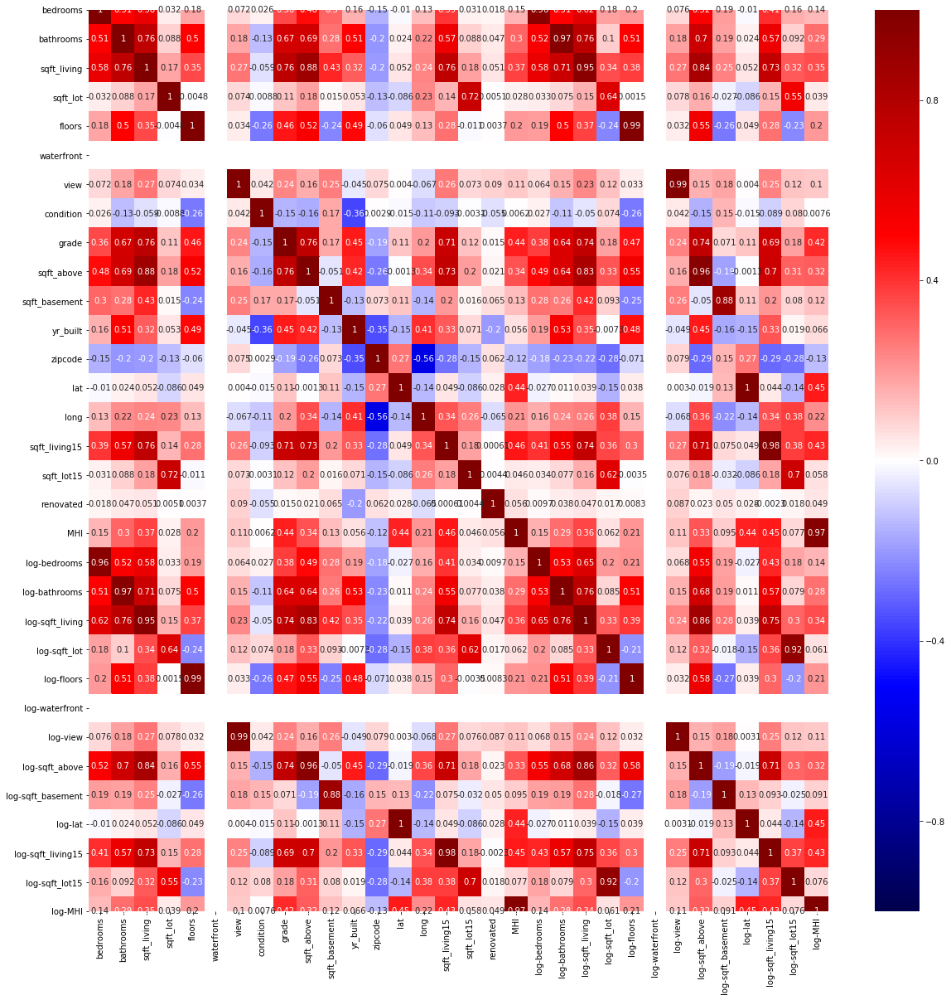

<Figure size 1440x1440 with 0 Axes>

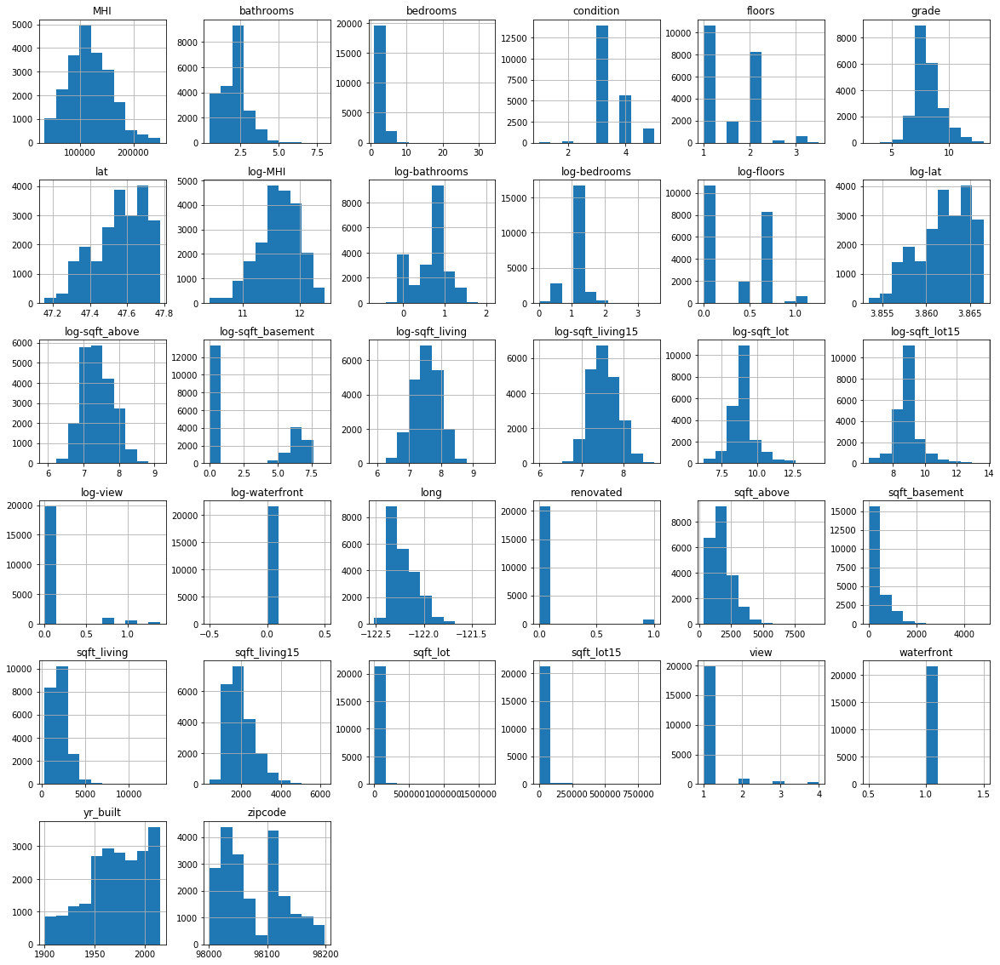

In [76]:
statistics(dflog)

Out of the log-columns, we keep only those that benefit from log-transform.

In [77]:
log_columns = [col for col in dflog.columns if col.startswith('log')]
log_tokeep = ['log-bathrooms', 'log-MHI', 'log-sqft_above', 'log-sqft_lot15',
              'log-sqft_living15', 'log-sqft_living', 'log-sqft_basement', 'log-sqft_lot']
log_todrop = list((Counter(log_columns) - Counter(list(log_tokeep)
                                                  ) + Counter(list(log)) - Counter(list(cat))))
# dflog.drop(nonlog_todrop,axis=1,inplace=True)

In [78]:
log_todrop

['log-bedrooms',
 'log-floors',
 'log-waterfront',
 'log-view',
 'log-lat',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'sqft_above',
 'sqft_basement',
 'sqft_living15',
 'sqft_lot15',
 'MHI']

#### Dataset with category levels threshold < 6

Let's recall our continous variables for category-level-threshold < 6

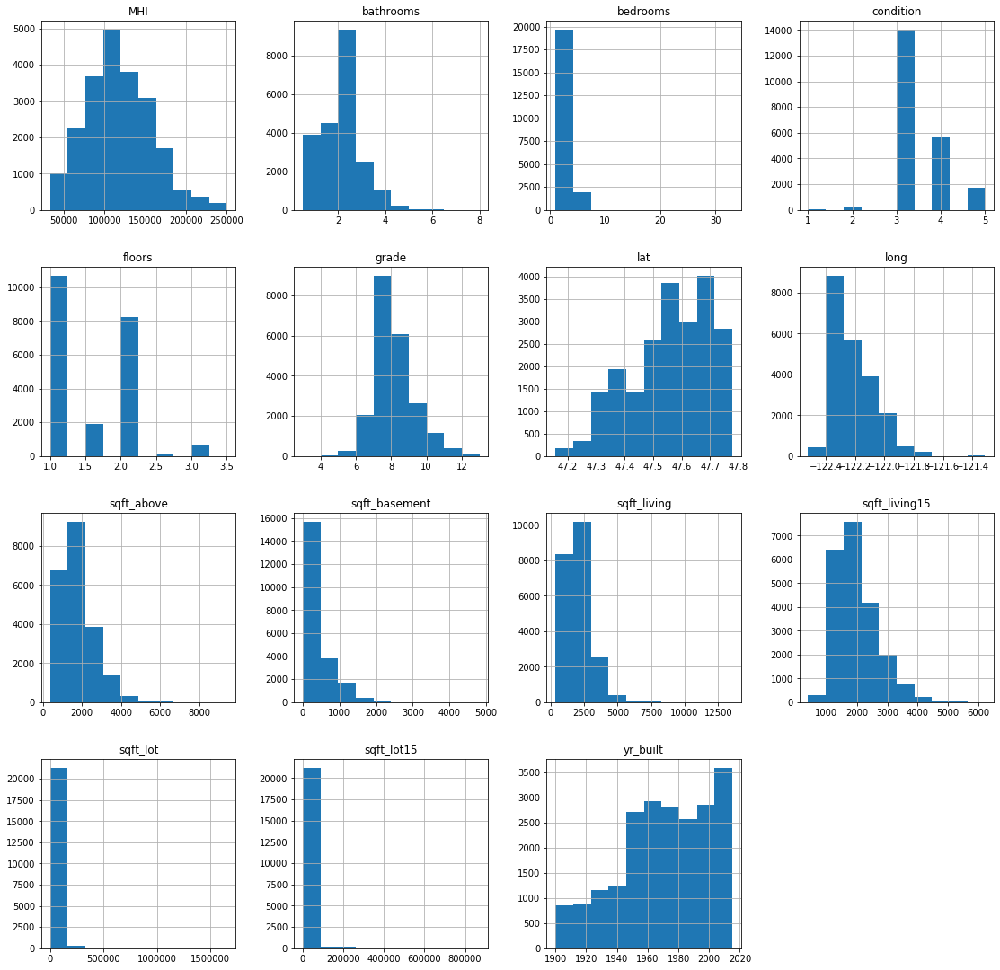

In [79]:
df[cont6].hist(figsize=(19, 19))

In [80]:
dflog6 = df.copy()

In [81]:
# select only positively skewed columns to log-transform
nonlog6 = ['lat', 'long', 'yr_built', 'grade',
           'condition', 'zipcode', 'renovated', 'view', 'floors']
log6 = list((Counter(cont6) - Counter(nonlog6) - Counter(cat6)).keys())

In [82]:
log6

['bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'sqft_above',
 'sqft_basement',
 'sqft_living15',
 'sqft_lot15',
 'MHI']

In [83]:
logtransform(dflog6)

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,...,log-sqft_lot,log-floors,log-waterfront,log-view,log-sqft_above,log-sqft_basement,log-lat,log-sqft_living15,log-sqft_lot15,log-MHI
0,3.0,1.00,1180.0,5650.0,1.0,1.0,1.0,3,7,1180.0,...,8.639411,0.000000,0.0,0.0,7.073270,0.000000,3.860965,7.200425,8.639411,11.526167
1,3.0,2.25,2570.0,7242.0,2.0,1.0,1.0,3,7,2170.0,...,8.887653,0.693147,0.0,0.0,7.682482,5.991465,3.865372,7.432484,8.941022,11.222814
2,2.0,1.00,770.0,10000.0,1.0,1.0,1.0,3,6,770.0,...,9.210340,0.000000,0.0,0.0,6.646391,0.000000,3.865726,7.908387,8.994917,11.776358
3,4.0,3.00,1960.0,5000.0,1.0,1.0,1.0,5,7,1050.0,...,8.517193,0.000000,0.0,0.0,6.956545,6.813445,3.861168,7.215240,8.517193,11.884641
4,3.0,2.00,1680.0,8080.0,1.0,1.0,1.0,3,8,1680.0,...,8.997147,0.000000,0.0,0.0,7.426549,0.000000,3.863186,7.495542,8.923058,12.083622
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,3.0,2.50,1530.0,1131.0,3.0,1.0,1.0,3,8,1530.0,...,7.030857,1.098612,0.0,0.0,7.333023,0.000000,3.864917,7.333023,7.319202,11.607499
21593,4.0,2.50,2310.0,5813.0,2.0,1.0,1.0,3,8,2310.0,...,8.667852,0.693147,0.0,0.0,7.745003,0.000000,3.860955,7.512071,8.881836,11.213576
21594,2.0,0.75,1020.0,1350.0,2.0,1.0,1.0,3,7,1020.0,...,7.207860,0.693147,0.0,0.0,6.927558,0.000000,3.862715,6.927558,7.604396,11.566096
21595,3.0,2.50,1600.0,2388.0,2.0,1.0,1.0,3,8,1600.0,...,7.778211,0.693147,0.0,0.0,7.377759,0.000000,3.861456,7.251345,7.160069,12.116531


Shape:  (21596, 32)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 21596 entries, 0 to 21596
Data columns (total 32 columns):
bedrooms             21596 non-null float64
bathrooms            21596 non-null float64
sqft_living          21596 non-null float64
sqft_lot             21596 non-null float64
floors               21596 non-null float64
waterfront           21596 non-null float64
view                 21596 non-null float64
condition            21596 non-null int64
grade                21596 non-null int64
sqft_above           21596 non-null float64
sqft_basement        21596 non-null float64
yr_built             21596 non-null int64
zipcode              21596 non-null int64
lat                  21596 non-null float64
long                 21596 non-null float64
sqft_living15        21596 non-null float64
sqft_lot15           21596 non-null float64
renovated            21596 non-null int64
MHI                  2159


Column name: sqft_lot

5000.0     0.016577
6000.0     0.013428
4000.0     0.011623
7200.0     0.010187
7500.0     0.005510
             ...   
15235.0    0.000046
47870.0    0.000046
42840.0    0.000046
53696.0    0.000046
11783.0    0.000046
Name: sqft_lot, Length: 9775, dtype: float64

Column name: floors

1.0    0.494166
2.0    0.381321
1.5    0.088442
3.0    0.028292
2.5    0.007455
3.5    0.000324
Name: floors, dtype: float64

Column name: waterfront

1.0    1.0
Name: waterfront, dtype: float64

Column name: view

1.0    0.917485
2.0    0.044314
3.0    0.023523
4.0    0.014679
Name: view, dtype: float64

Column name: condition

3    0.649148
4    0.262873
5    0.078765
2    0.007872
1    0.001343
Name: condition, dtype: float64

Column name: grade

7     0.415494
8     0.280839
9     0.121087
6     0.094369
10    0.052510
11    0.018476
5     0.011206
12    0.004121
4     0.001250
13    0.000602
3     0.000046
Name: grade, dtype: float64

Column name: sqft_above

1300.0    0.0098

Int64Index([   94,   314,   325,   346,   372,   718,   824,   837,  1085,
             1128,
            ...
            20525, 20597, 20654, 20662, 20764, 20809, 20815, 20906, 21093,
            21565],
           dtype='int64', length=185)

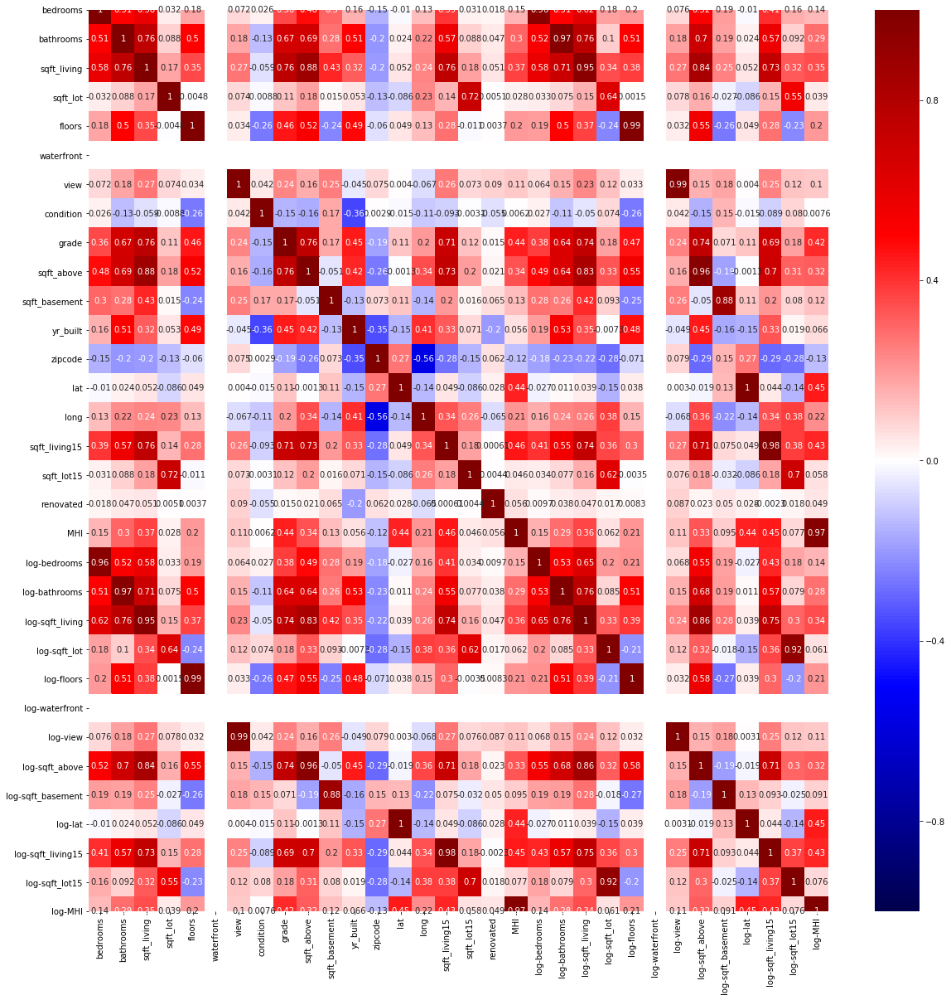

<Figure size 1440x1440 with 0 Axes>

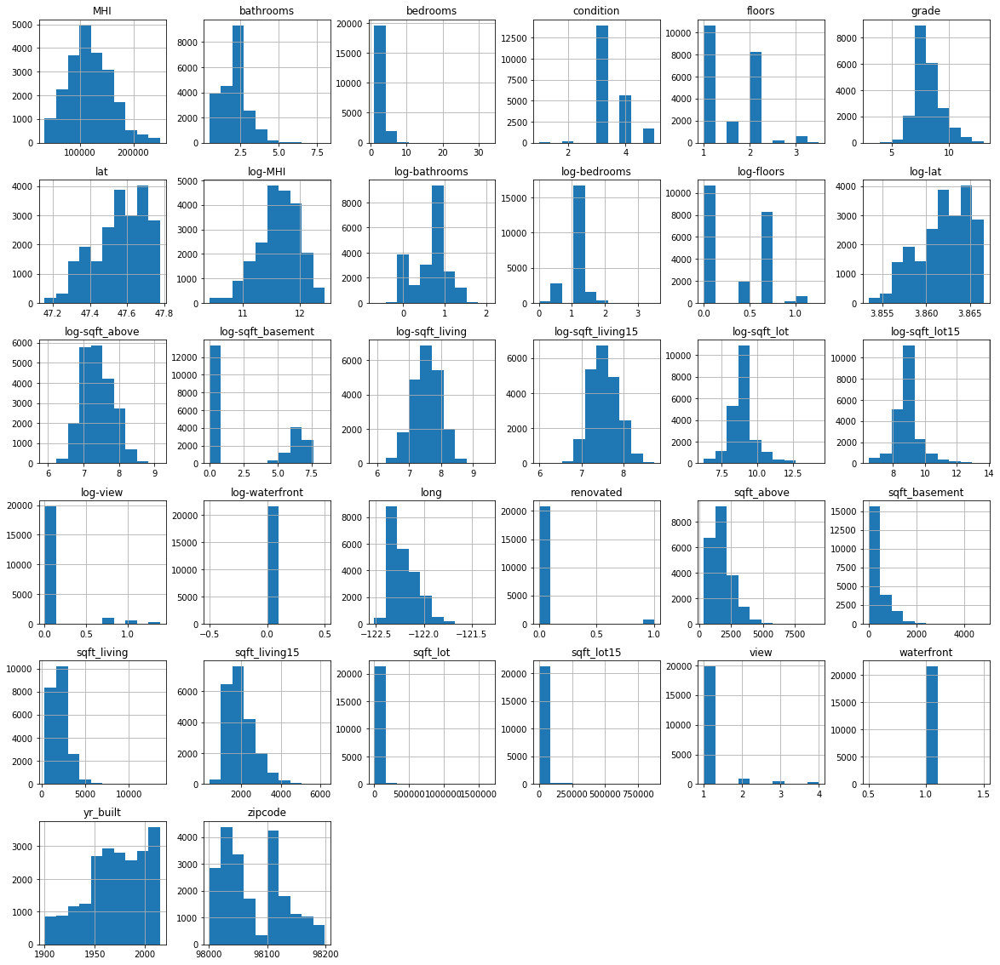

In [84]:
statistics(dflog6)

Out of the log-columns, we keep only 'log-bathrooms' as it's the only column that benefit from log-transform.

In [85]:
log6_columns = [col for col in dflog6.columns if col.startswith('log')]
log6_tokeep = ['log-bathrooms', 'log-bedrooms', 'log-MHI', 'log-sqft_above',
               'log-sqft_lot', 'log-sqft_lot15', 'log-sqft_living15', 'log-sqft_living']
nonlog6_todrop = list((Counter(log6_columns) - Counter(list(log6_tokeep)
                                                       ) + Counter(list(log6)) - Counter(list(cat6))))
# dflog6.drop(nonlog_todrop,axis=1,inplace=True)

In [86]:
nonlog6_todrop

['log-floors',
 'log-waterfront',
 'log-view',
 'log-sqft_basement',
 'log-lat',
 'bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'sqft_above',
 'sqft_basement',
 'sqft_living15',
 'sqft_lot15',
 'MHI']

#### Export log-transformed dataset to csv

In [87]:
dflog.to_csv(os.path.join(path, r'logtransformed.csv'), index=False)

In [88]:
dflog6.to_csv(os.path.join(path, r'logtransformed6.csv'), index=False)

In [89]:
dfMinMax = pd.read_csv(os.path.join(path, r'minmax.csv'))
dfMinMax

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,...,log-sqft_lot,log-floors,log-waterfront,log-view,log-sqft_above,log-sqft_basement,log-lat,log-sqft_living15,log-sqft_lot15,log-MHI
0,3.0,0.066667,0.061503,0.003108,1.0,1.0,1.0,0.5,0.4,0.089602,...,8.639411,0.000000,0.0,0.0,7.073270,0.000000,3.860965,7.200425,8.639411,11.526167
1,3.0,0.233333,0.167046,0.004072,2.0,1.0,1.0,0.5,0.4,0.199115,...,8.887653,0.693147,0.0,0.0,7.682482,5.991465,3.865372,7.432484,8.941022,11.222814
2,2.0,0.066667,0.030372,0.005743,1.0,1.0,1.0,0.5,0.3,0.044248,...,9.210340,0.000000,0.0,0.0,6.646391,0.000000,3.865726,7.908387,8.994917,11.776358
3,4.0,0.333333,0.120729,0.002714,1.0,1.0,1.0,1.0,0.4,0.075221,...,8.517193,0.000000,0.0,0.0,6.956545,6.813445,3.861168,7.215240,8.517193,11.884641
4,3.0,0.200000,0.099468,0.004579,1.0,1.0,1.0,0.5,0.5,0.144912,...,8.997147,0.000000,0.0,0.0,7.426549,0.000000,3.863186,7.495542,8.923058,12.083622
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21591,3.0,0.266667,0.088079,0.000370,3.0,1.0,1.0,0.5,0.5,0.128319,...,7.030857,1.098612,0.0,0.0,7.333023,0.000000,3.864917,7.333023,7.319202,11.607499
21592,4.0,0.266667,0.147304,0.003206,2.0,1.0,1.0,0.5,0.5,0.214602,...,8.667852,0.693147,0.0,0.0,7.745003,0.000000,3.860955,7.512071,8.881836,11.213576
21593,2.0,0.033333,0.049355,0.000503,2.0,1.0,1.0,0.5,0.4,0.071903,...,7.207860,0.693147,0.0,0.0,6.927558,0.000000,3.862715,6.927558,7.604396,11.566096
21594,3.0,0.266667,0.093394,0.001132,2.0,1.0,1.0,0.5,0.5,0.136062,...,7.778211,0.693147,0.0,0.0,7.377759,0.000000,3.861456,7.251345,7.160069,12.116531


In [90]:
list(dfMinMax.columns)

['bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'floors',
 'waterfront',
 'view',
 'condition',
 'grade',
 'sqft_above',
 'sqft_basement',
 'yr_built',
 'zipcode',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15',
 'renovated',
 'MHI',
 'log-bedrooms',
 'log-bathrooms',
 'log-sqft_living',
 'log-sqft_lot',
 'log-floors',
 'log-waterfront',
 'log-view',
 'log-sqft_above',
 'log-sqft_basement',
 'log-lat',
 'log-sqft_living15',
 'log-sqft_lot15',
 'log-MHI']

### Normalisation/standardisation

None of the feature is really normally distributed. We're going to do some scaling first and then standardise.

#### Dataset with category levels threshold < 29

##### Normalising with MinMaxScaler

In [91]:
dfMinMax = dflog.copy()

In [92]:
scaler = MinMaxScaler()
dfMinMax[cont] = scaler.fit_transform(dfMinMax[cont])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


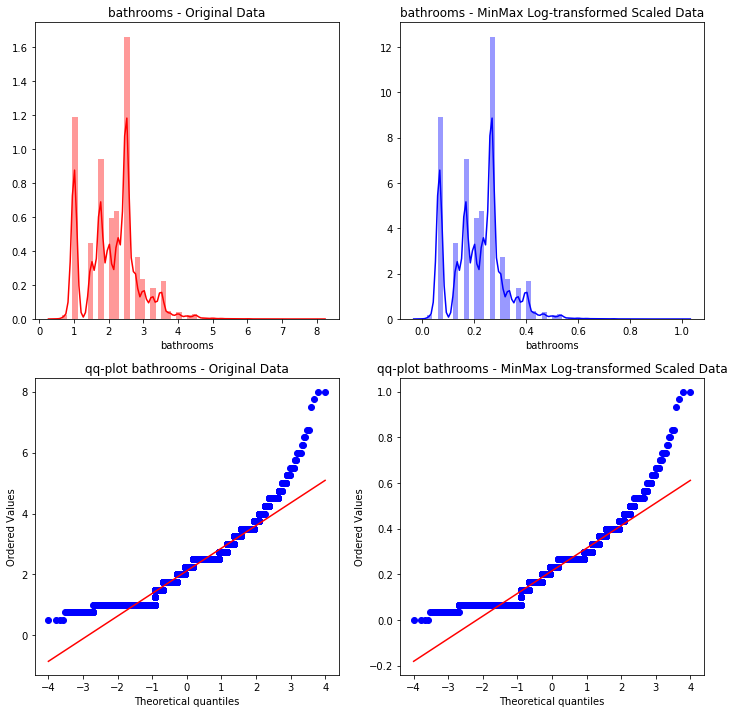

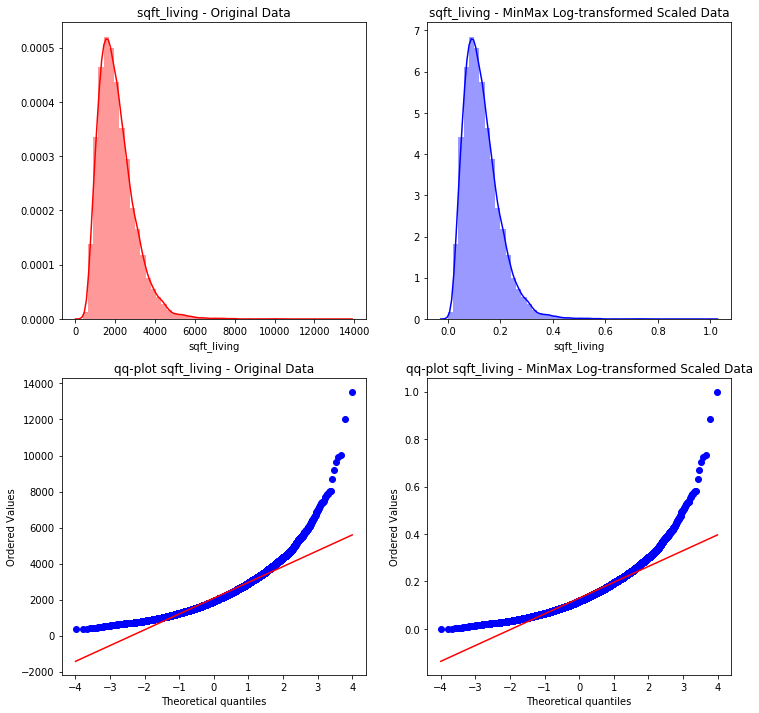

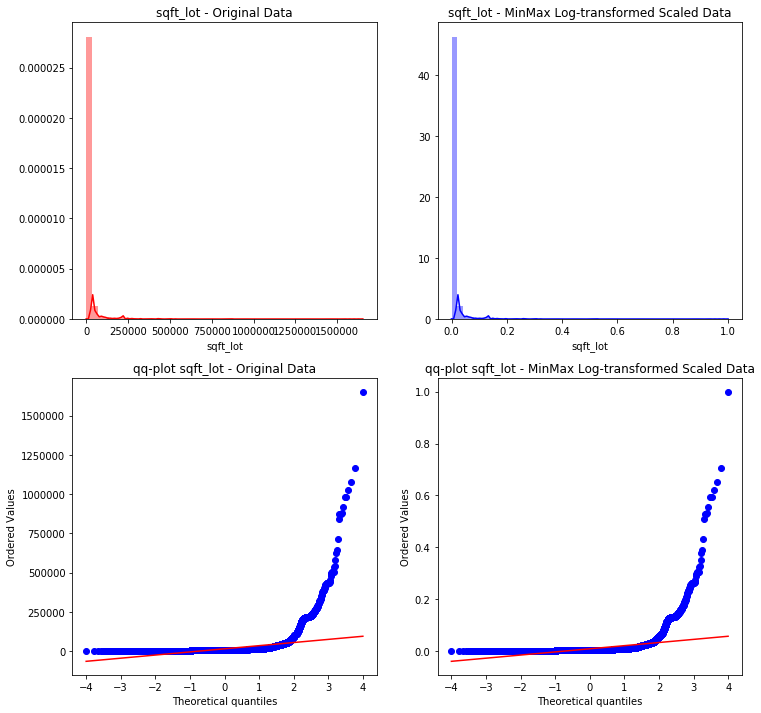

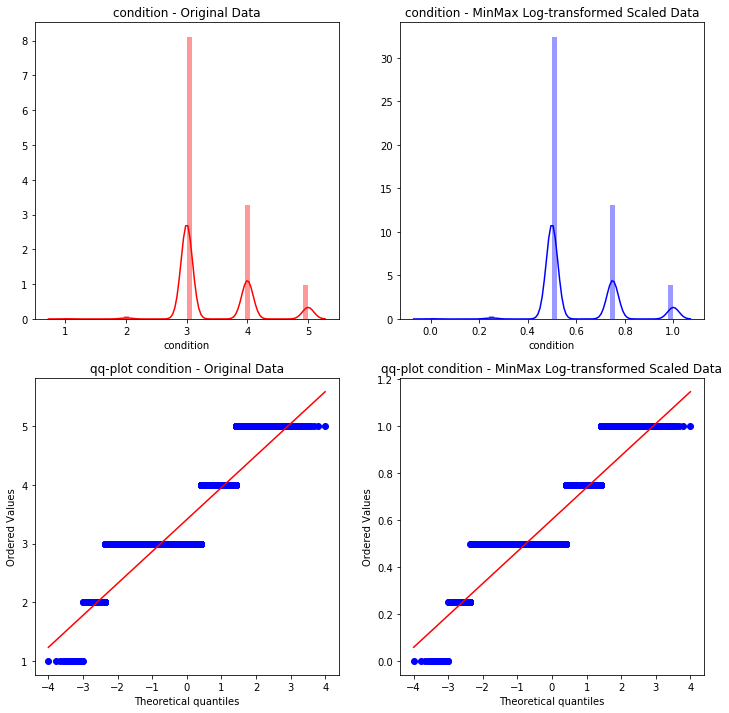

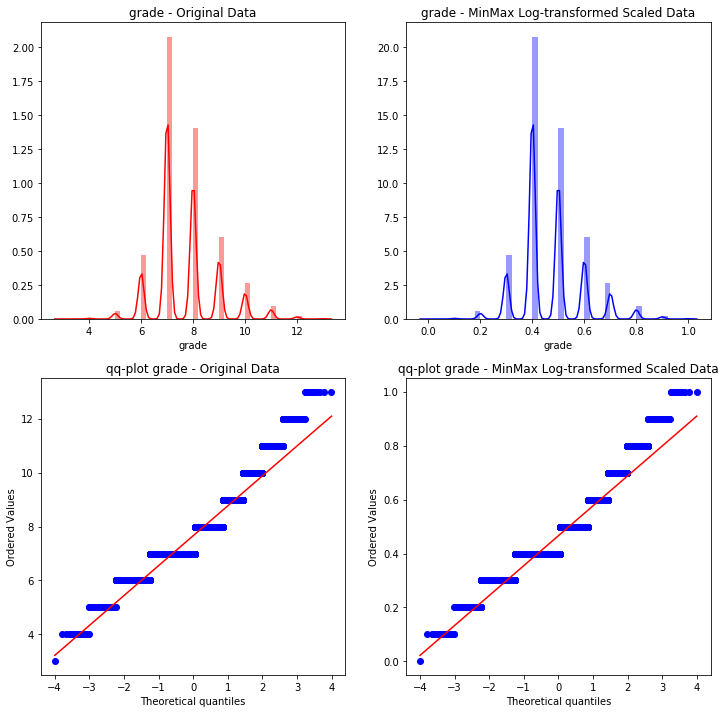

...

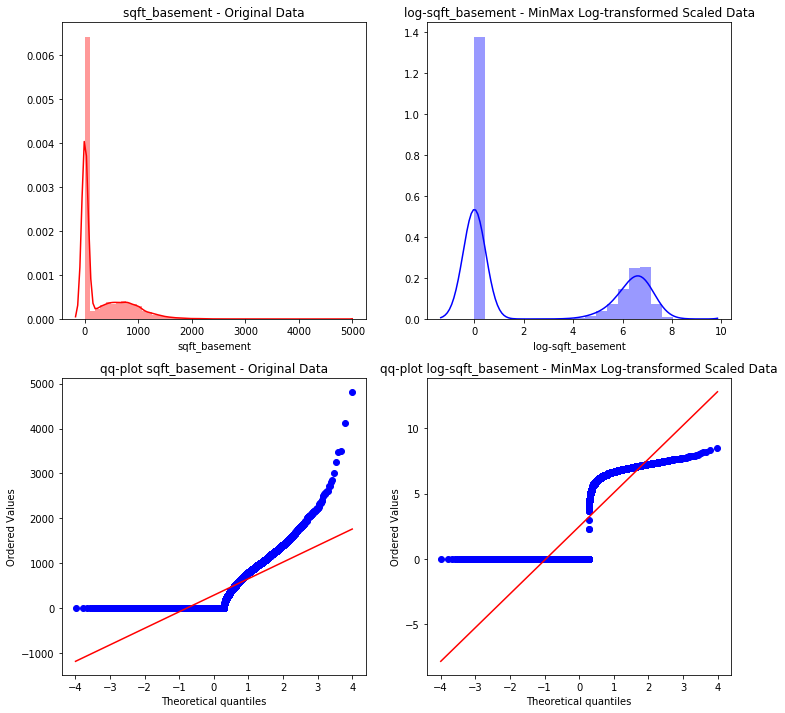

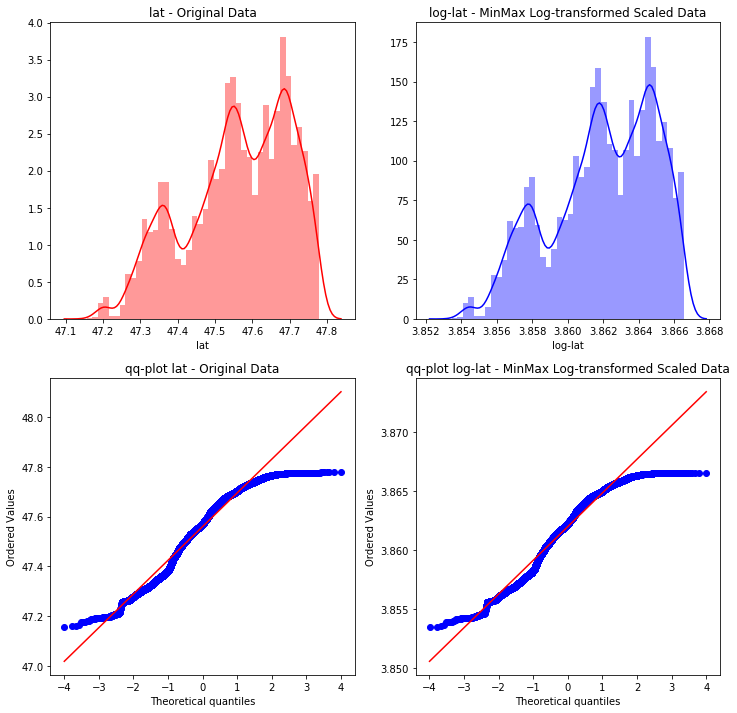

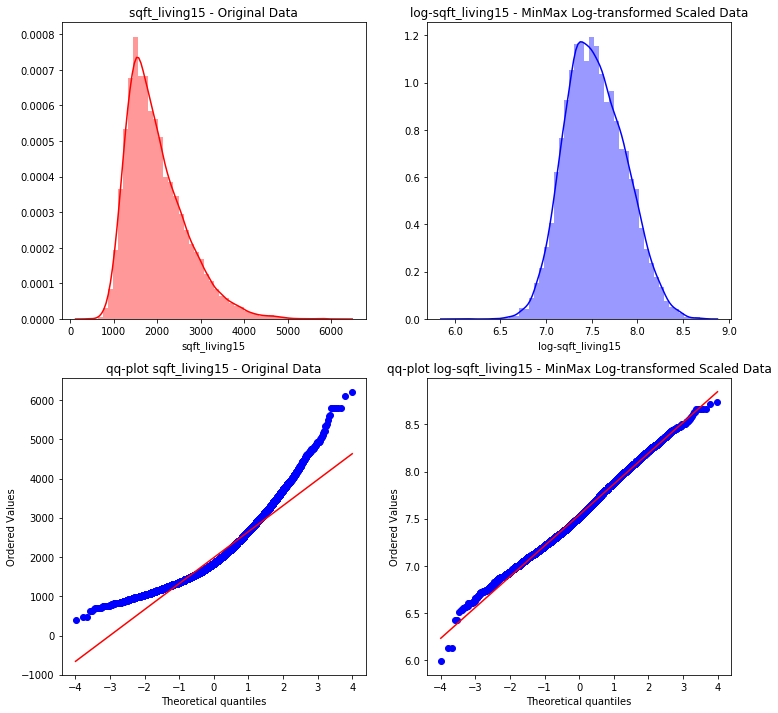

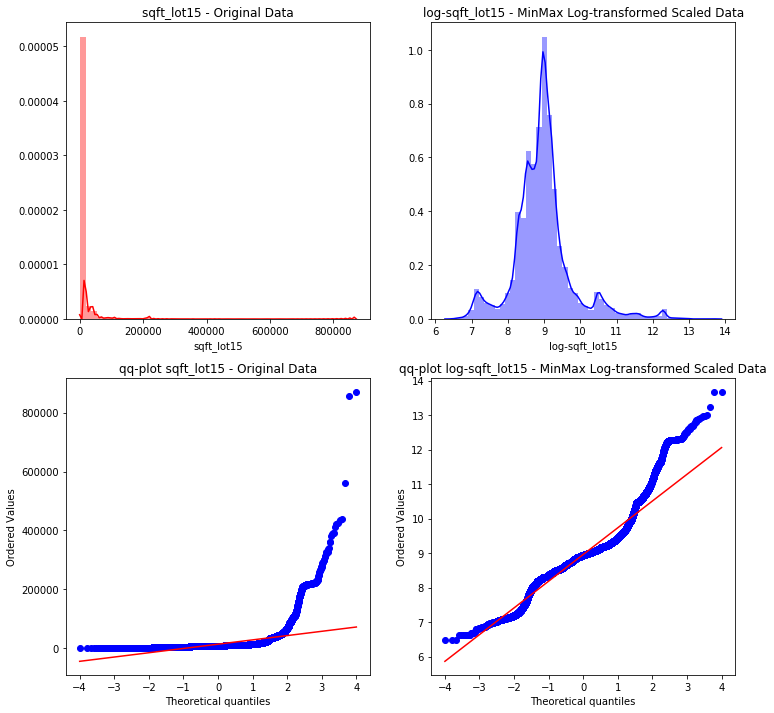

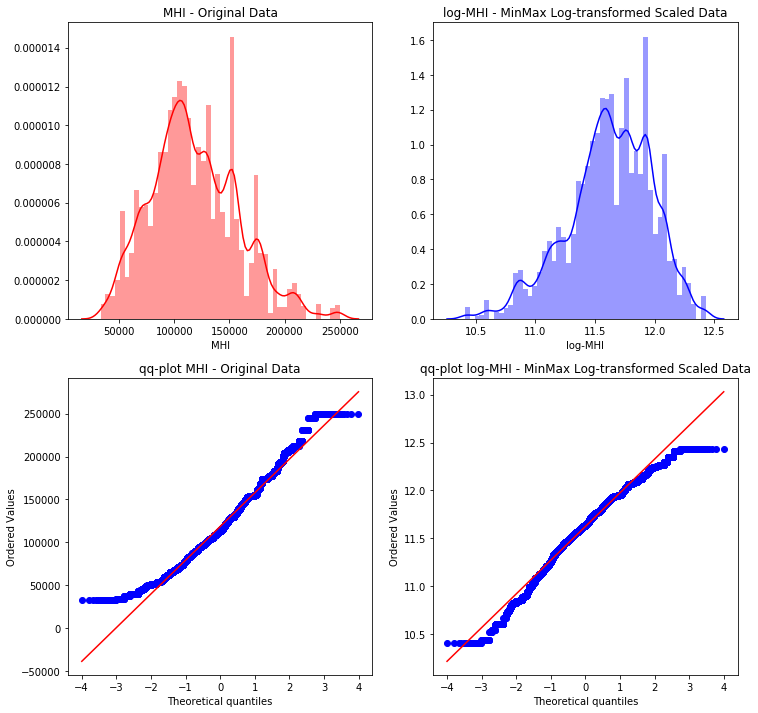

In [93]:
plot_before_after(df, dfMinMax, cont, 'Original',
                  'MinMax Log-transformed Scaled')

##### Normalising with RobustScaler

In [94]:
dfRobScal = dflog.copy()

In [95]:
scaler = RobustScaler()
dfRobScal[cont] = scaler.fit_transform(dfRobScal[cont])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


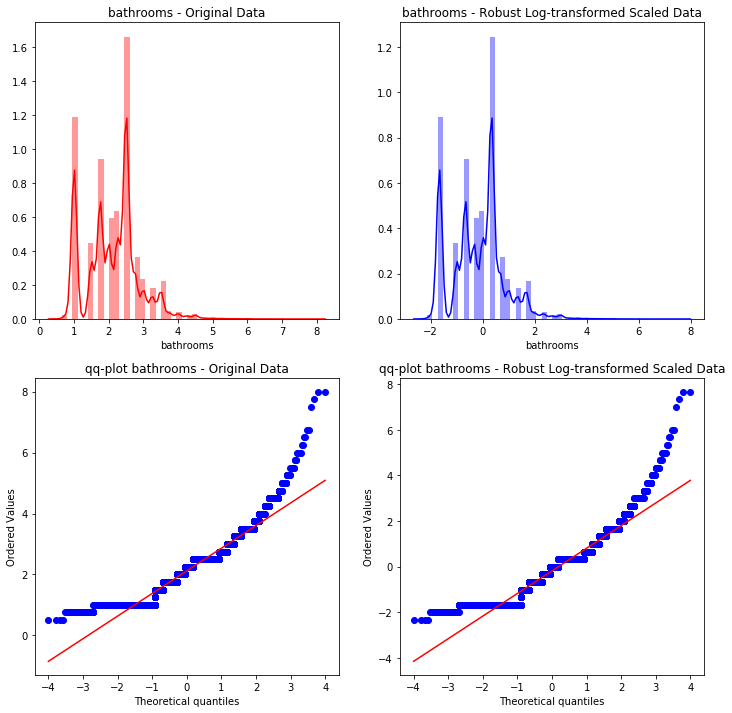

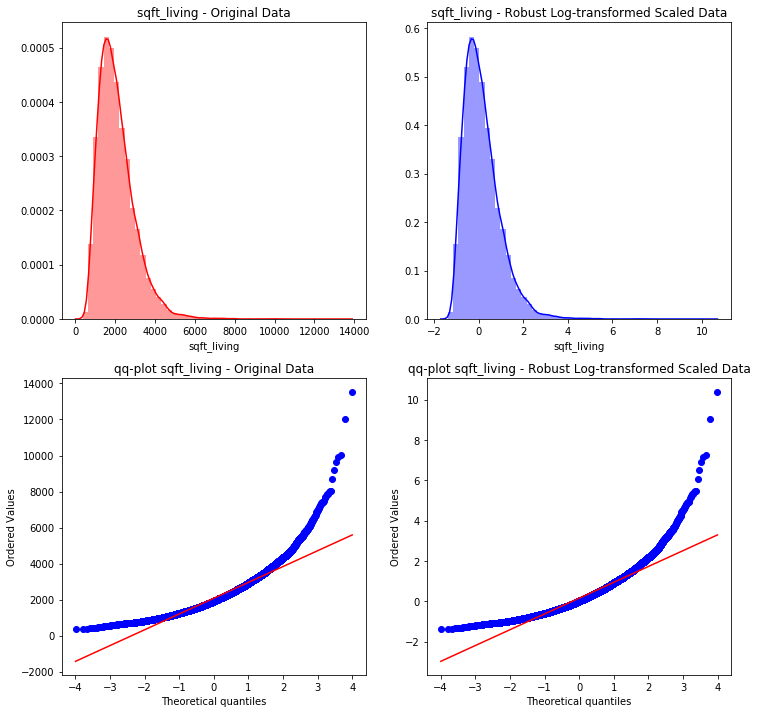

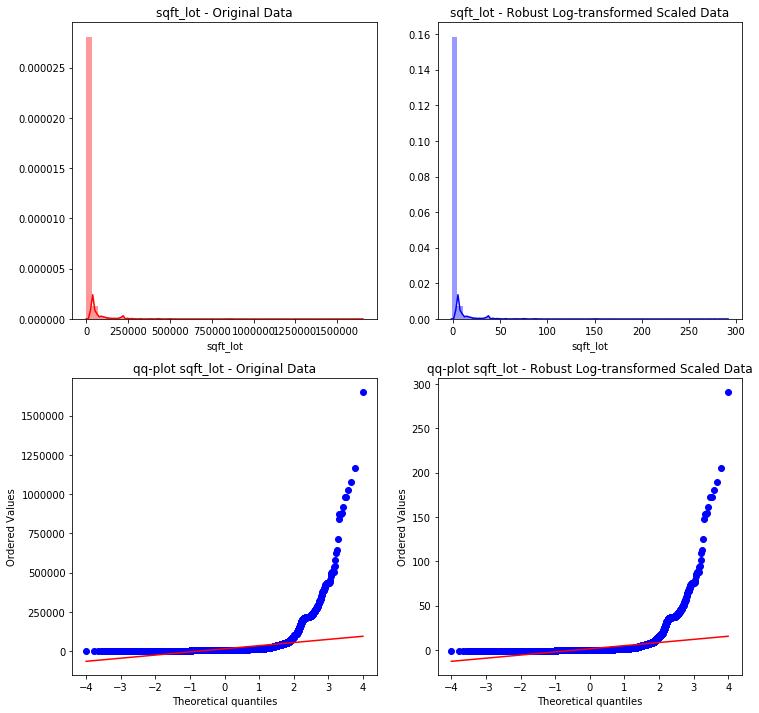

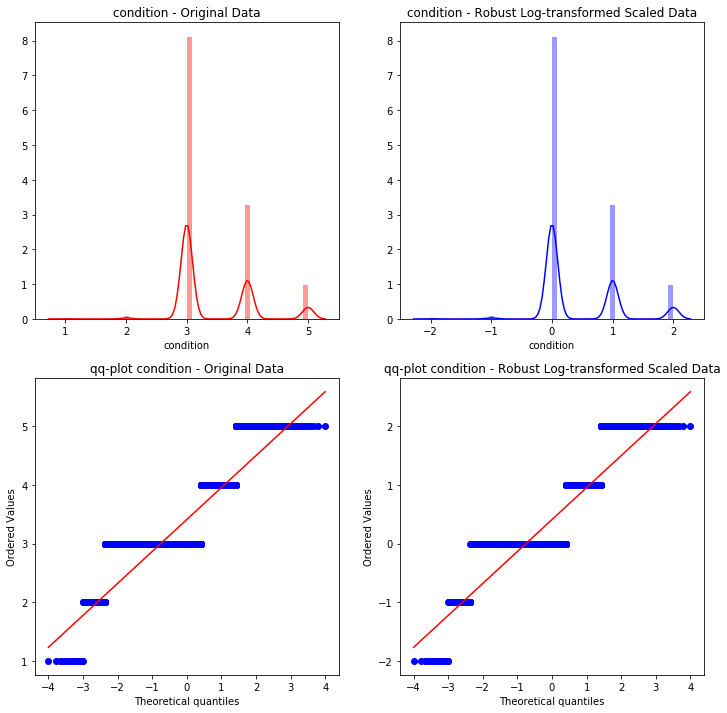

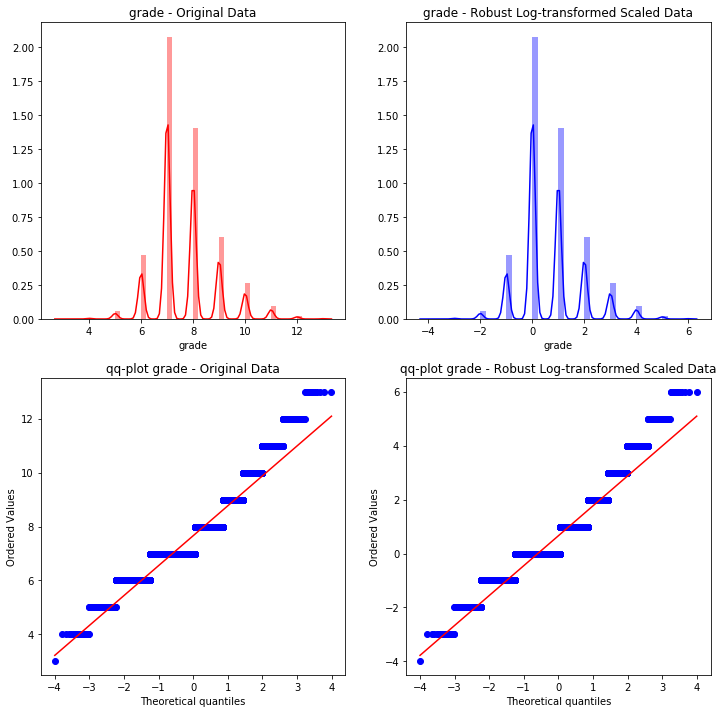

...

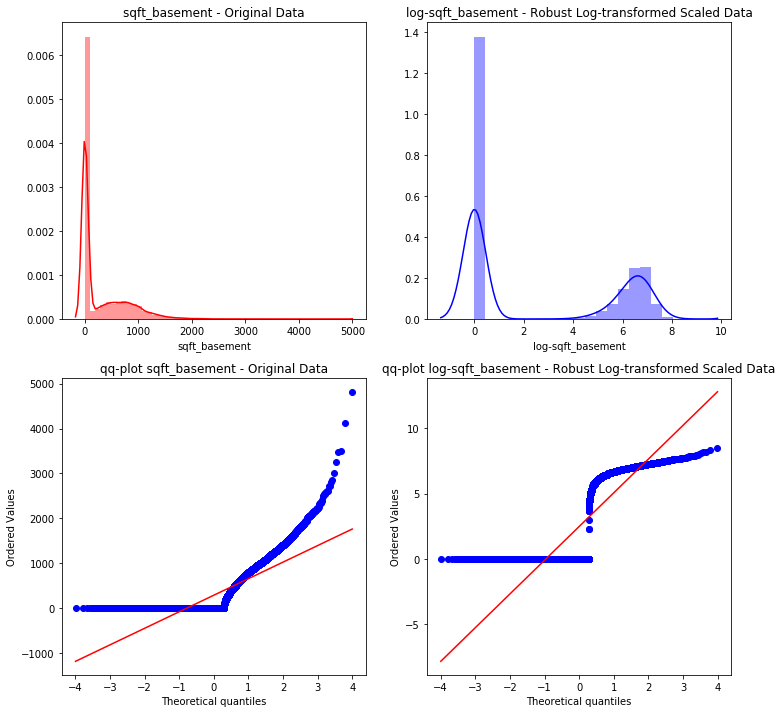

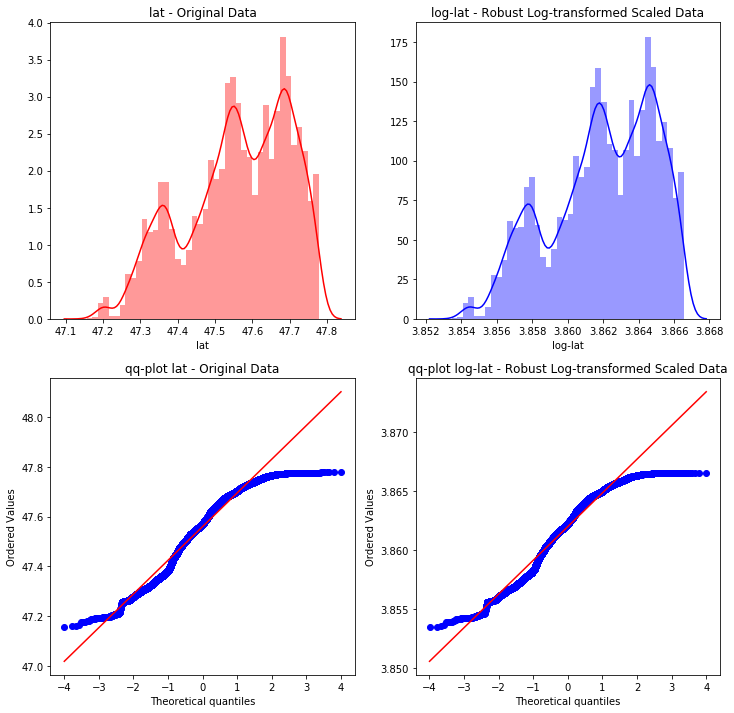

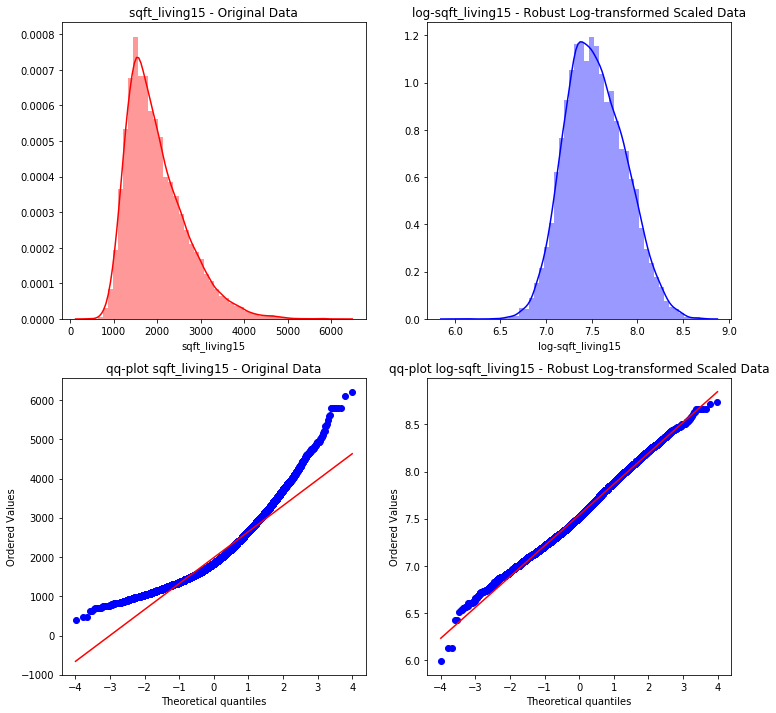

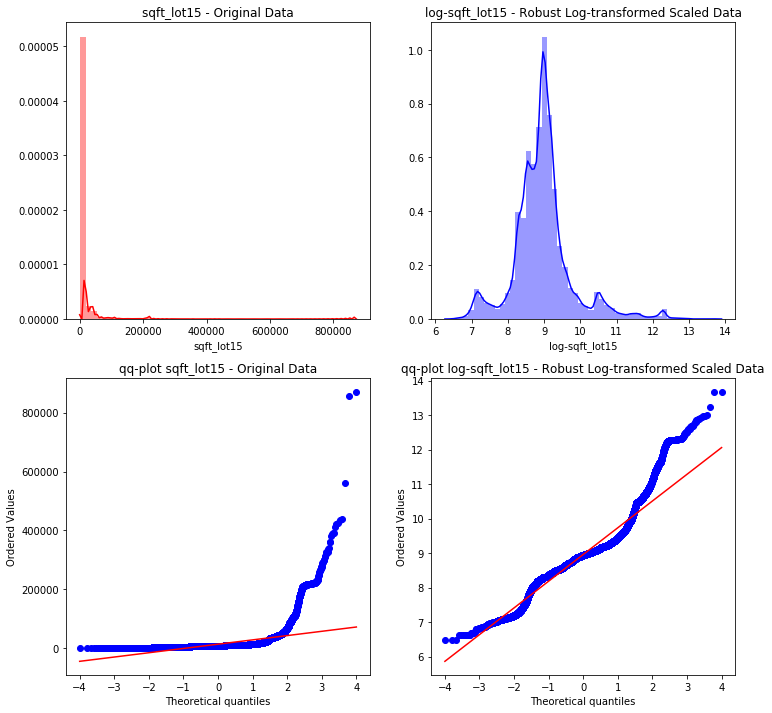

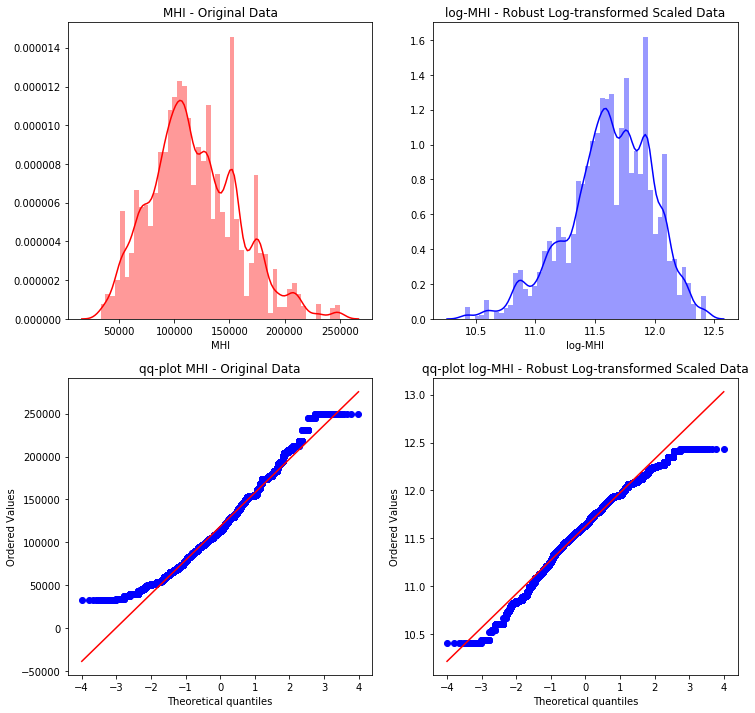

In [96]:
plot_before_after(df, dfRobScal, cont, 'Original',
                  'Robust Log-transformed Scaled')

#### Dataset with category levels threshold < 6

##### Normalising with MinMaxScaler

In [97]:
dfMinMax6 = dflog6.copy()

In [98]:
scaler = MinMaxScaler()
dfMinMax6[cont6] = scaler.fit_transform(dfMinMax6[cont6])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


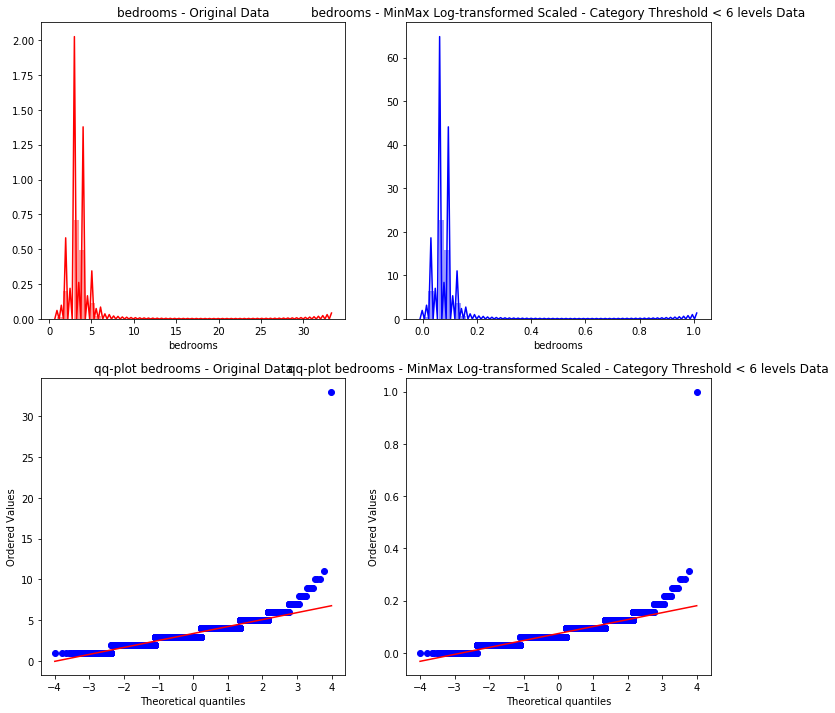

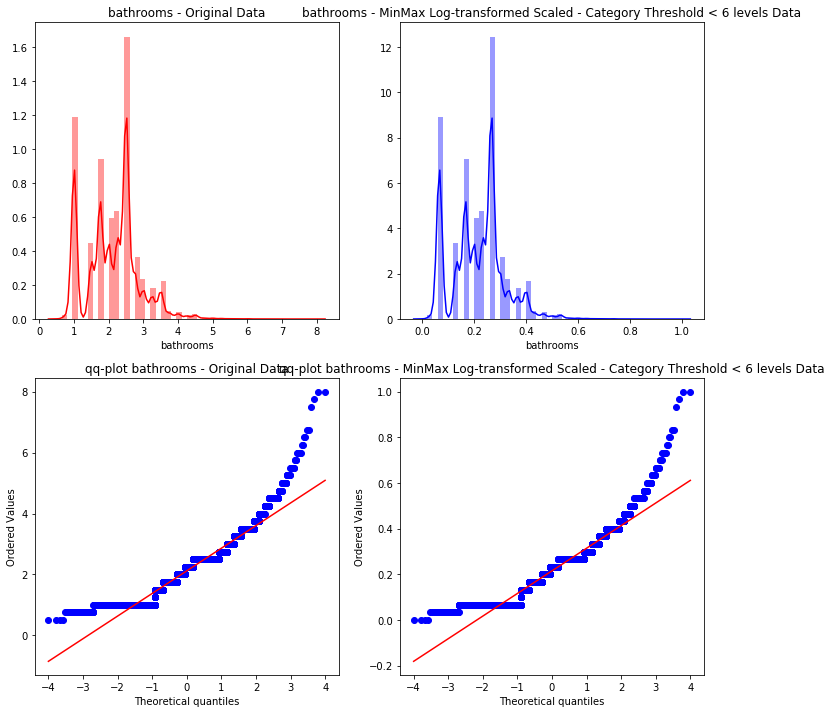

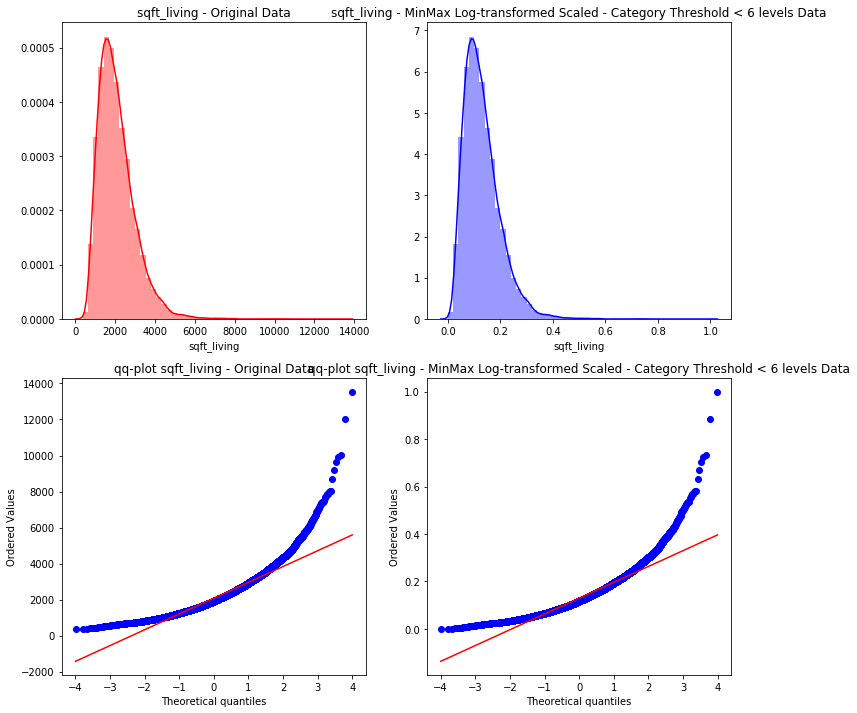

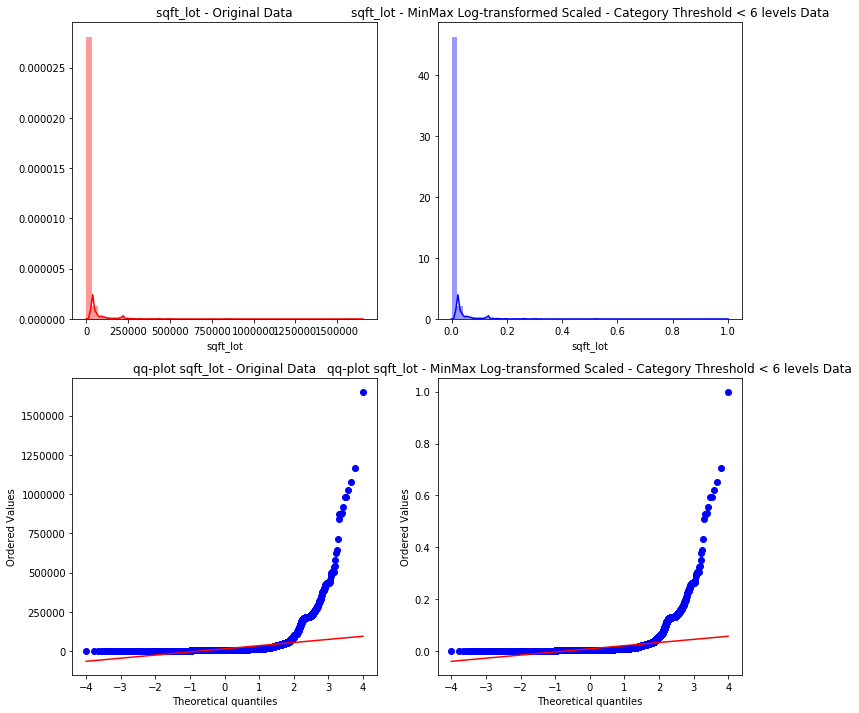

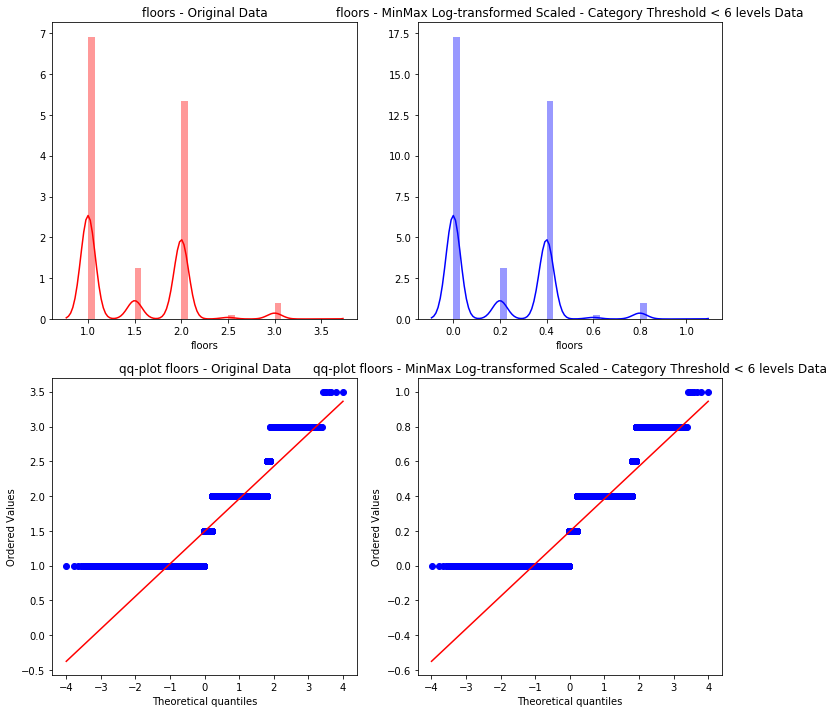

...

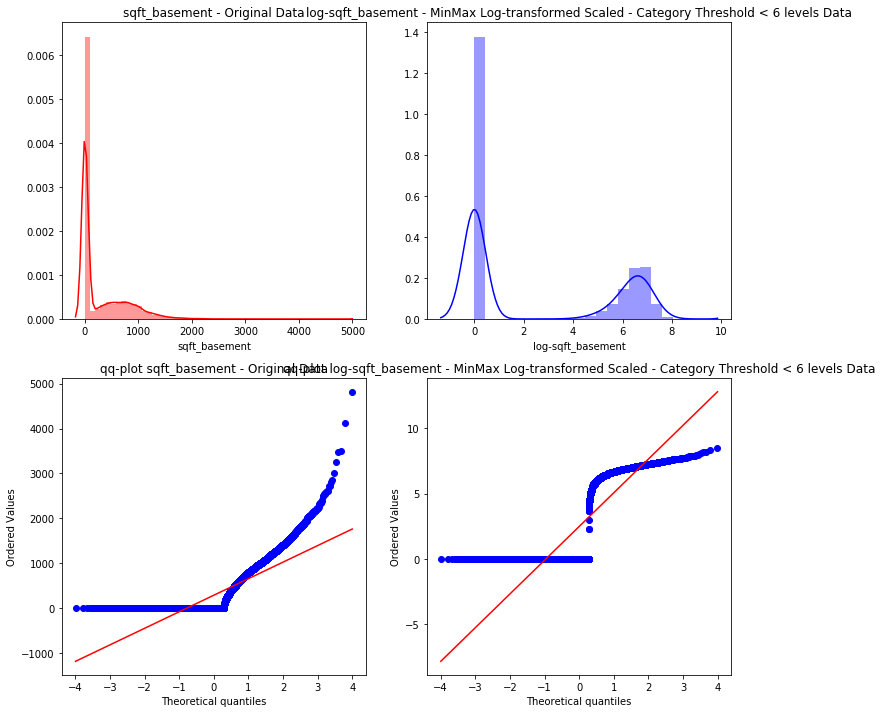

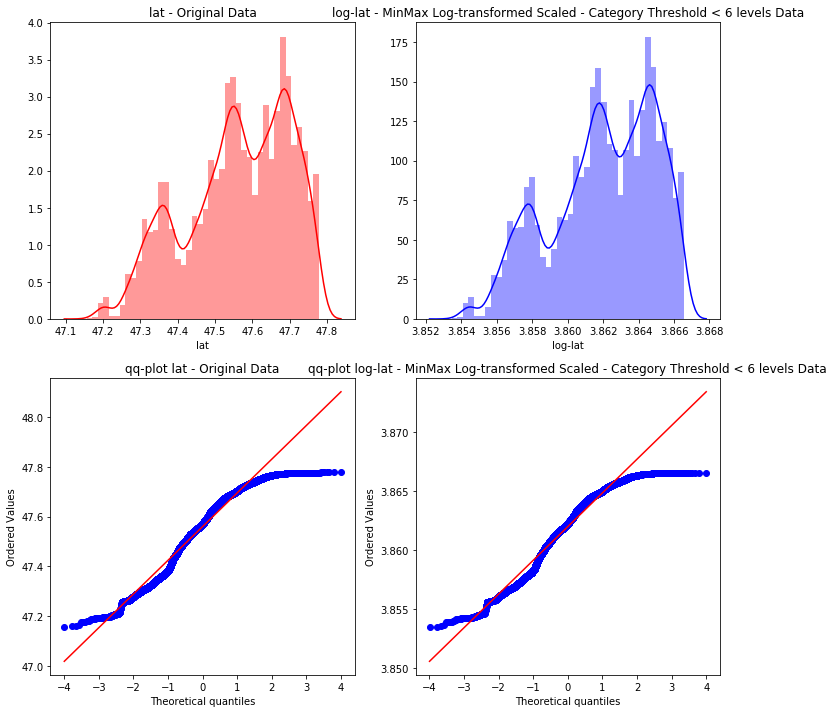

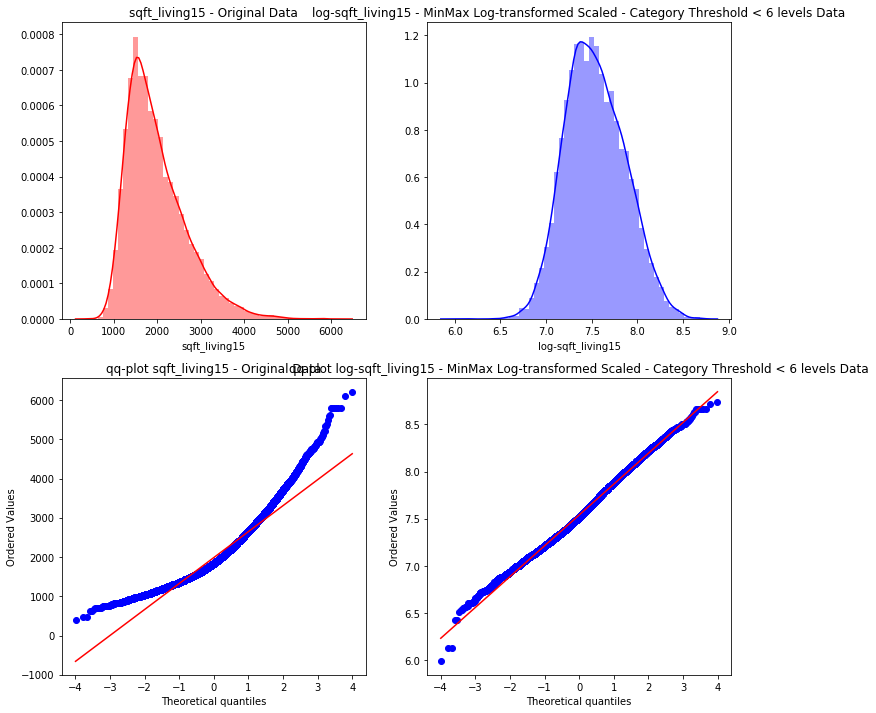

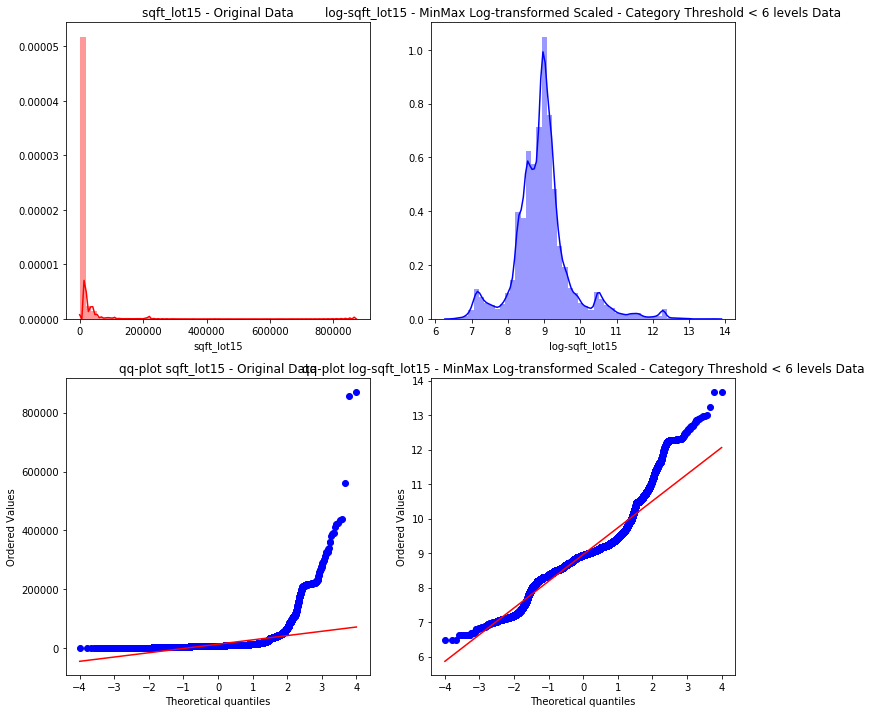

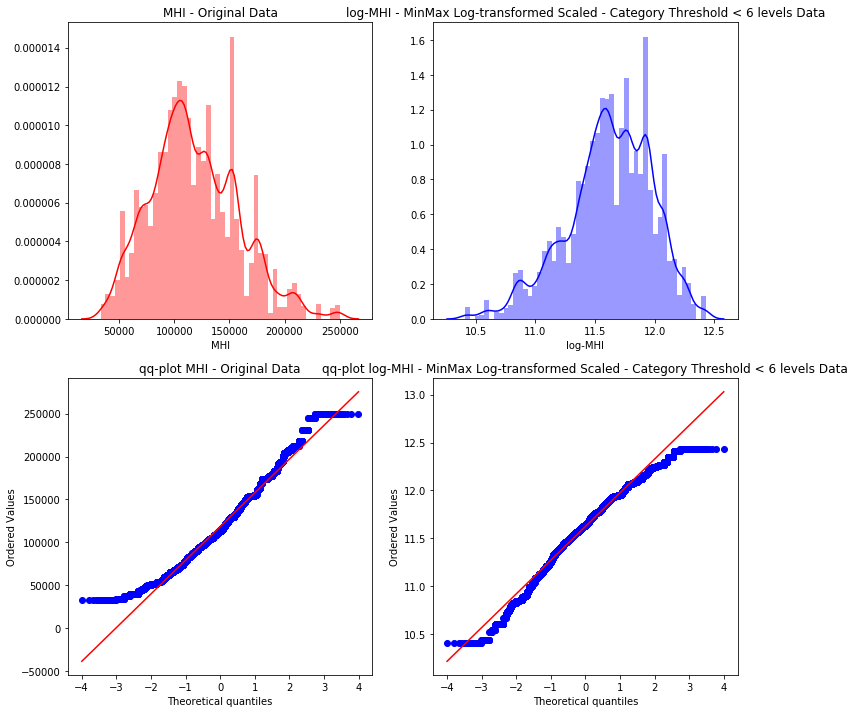

In [99]:
plot_before_after(df, dfMinMax6, cont6, 'Original',
                  'MinMax Log-transformed Scaled - Category Threshold < 6 levels')

##### Normalising with RobustScaler

In [100]:
dfRobScal6 = dflog6.copy()

In [101]:
scaler = RobustScaler()
dfRobScal6[cont6] = scaler.fit_transform(dfRobScal6[cont6])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


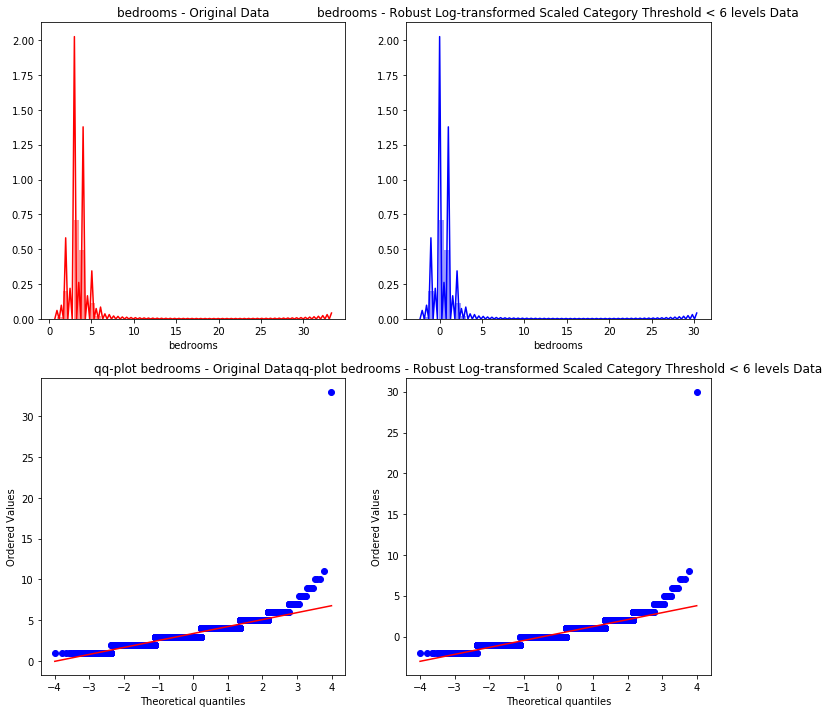

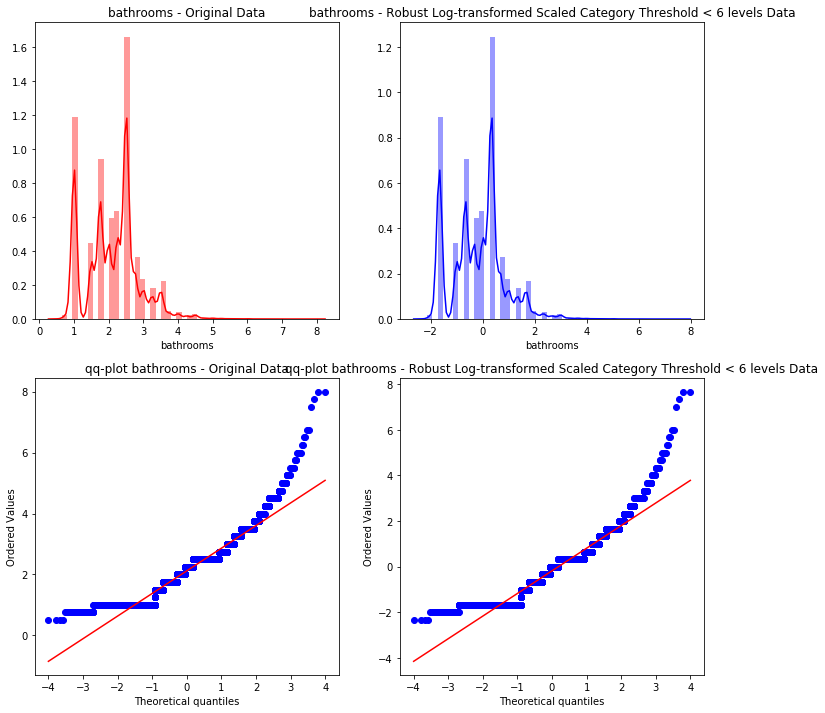

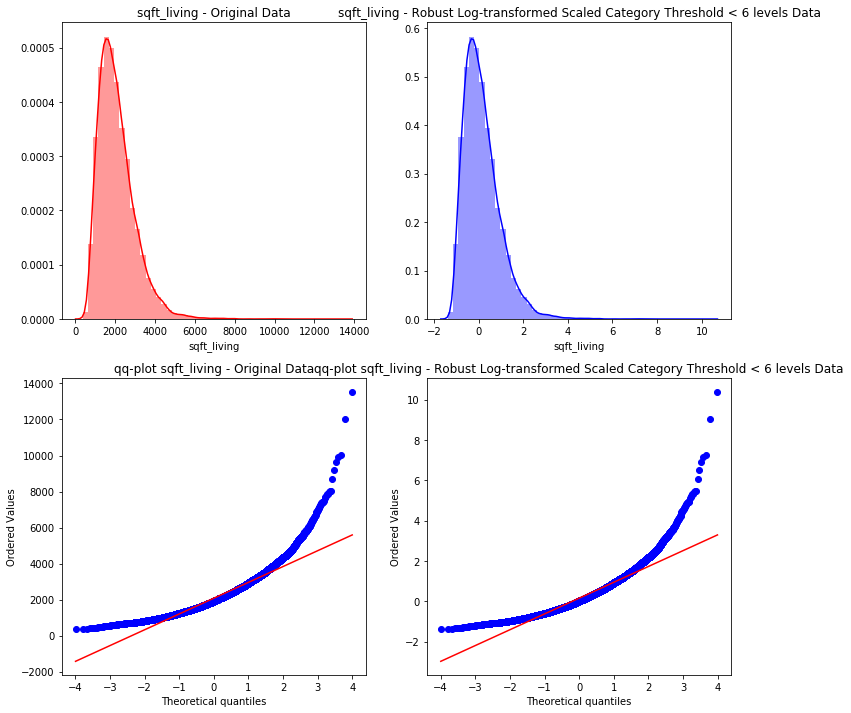

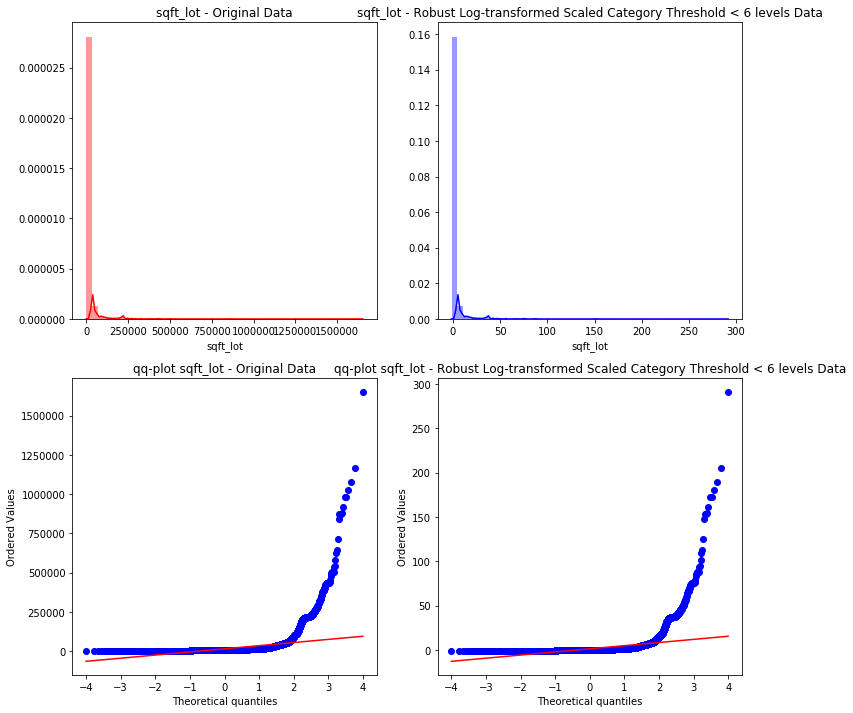

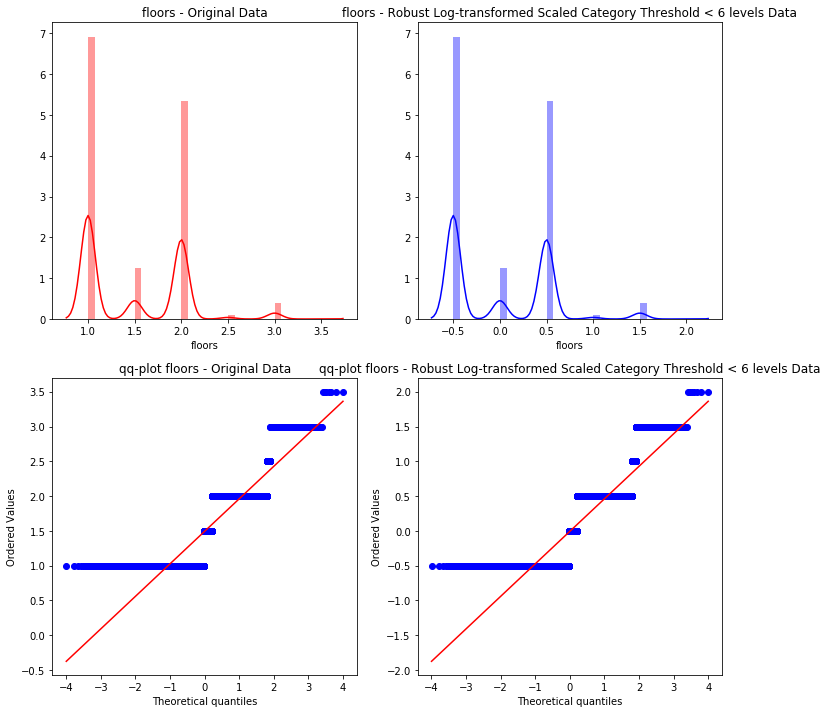

...

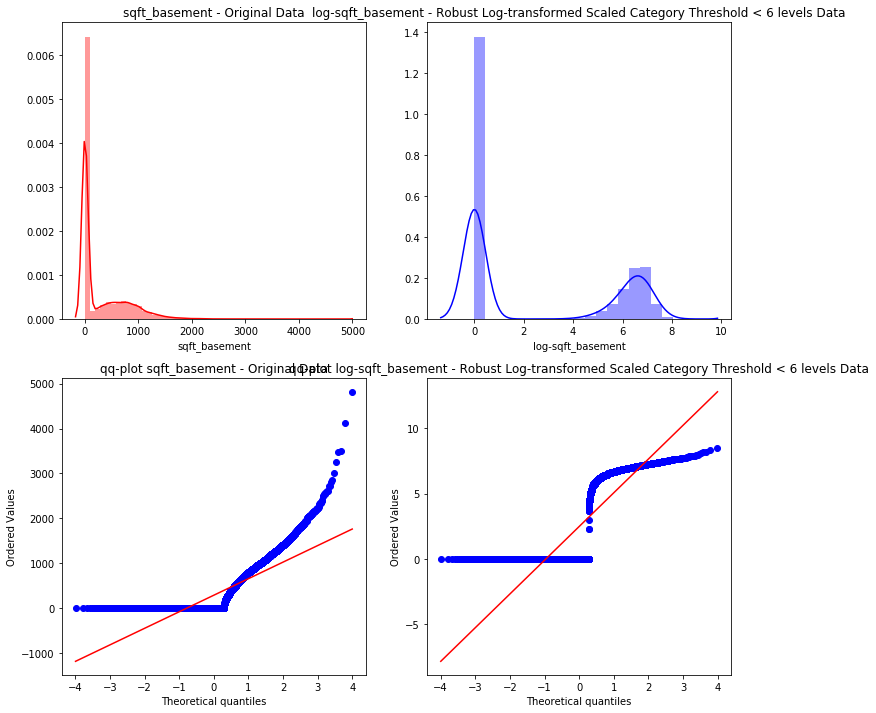

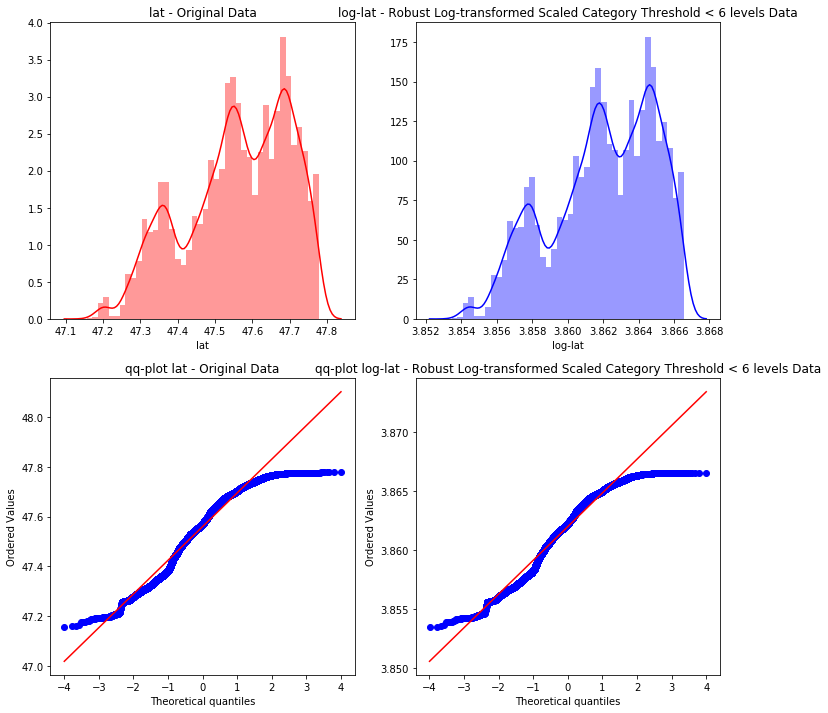

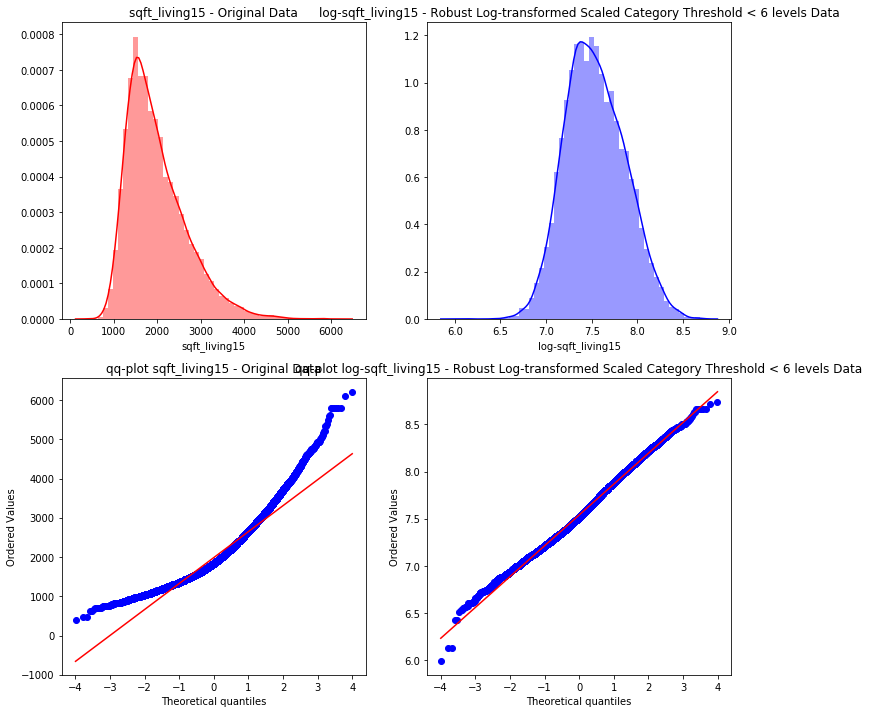

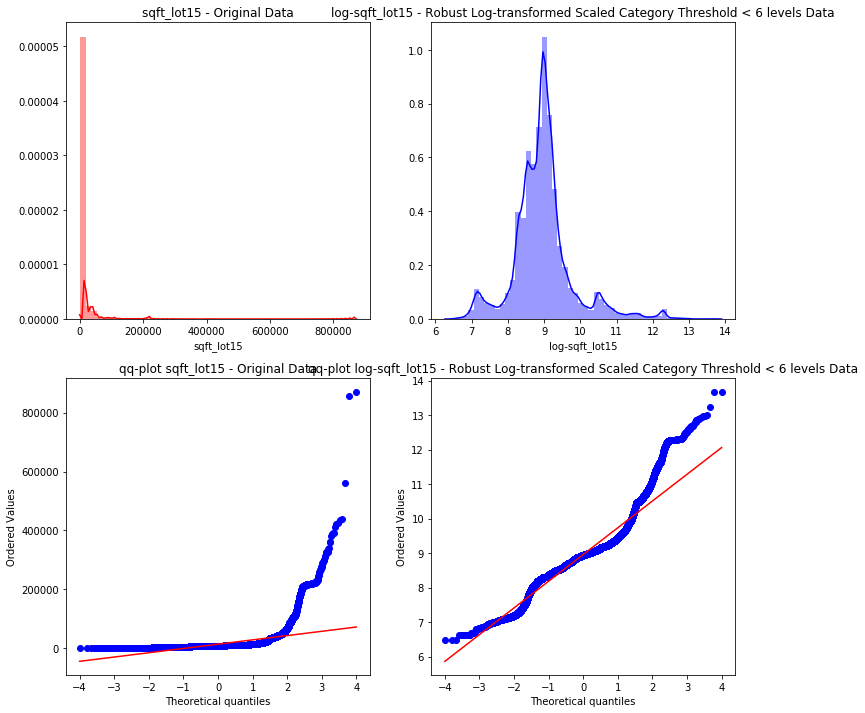

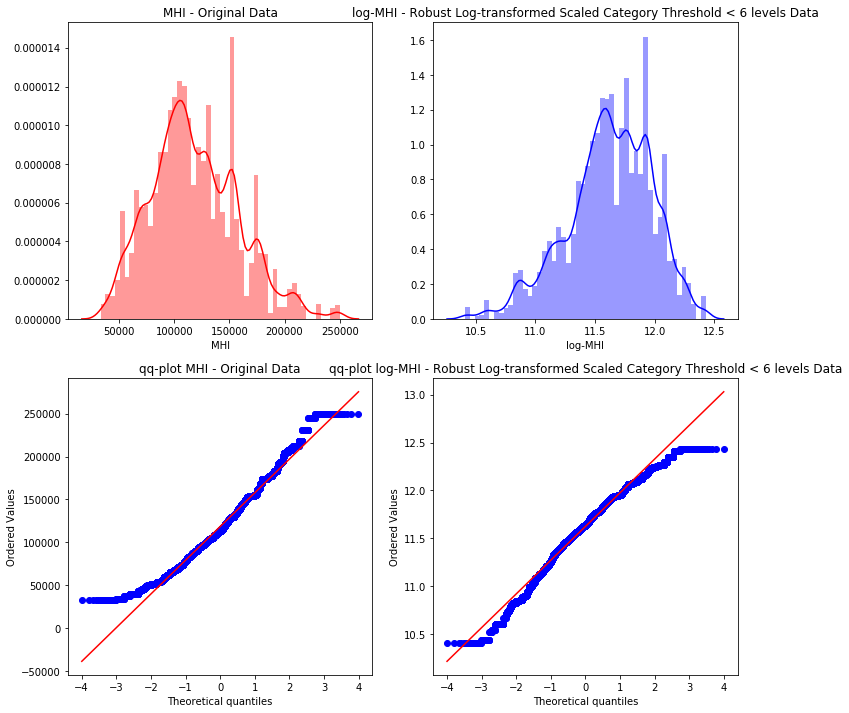

In [102]:
plot_before_after(df, dfRobScal6, cont6, 'Original',
                  'Robust Log-transformed Scaled Category Threshold < 6 levels')

#### Export scaled datasets to csv

In [103]:
dfMinMax.to_csv('minmax.csv', index=False)

In [104]:
dfRobScal.to_csv('robscal.csv', index=False)

In [105]:
dfMinMax6.to_csv('minmax6.csv', index=False)

In [106]:
dfRobScal6.to_csv('robscal6.csv', index=False)

#### Standardisation

Recall that you standardise a dataset by converting each numeric value to it's corresponding z-score for the column, which is obtained by subtracting the column's mean and then dividing by the column's standard deviation for every value.

##### Standardisation dataset with category levels threshold < 29

In [107]:
dfStd = dflog.copy()

In [108]:
standardiser = StandardScaler()
dfStd[cont] = standardiser.fit_transform(dflog[cont])

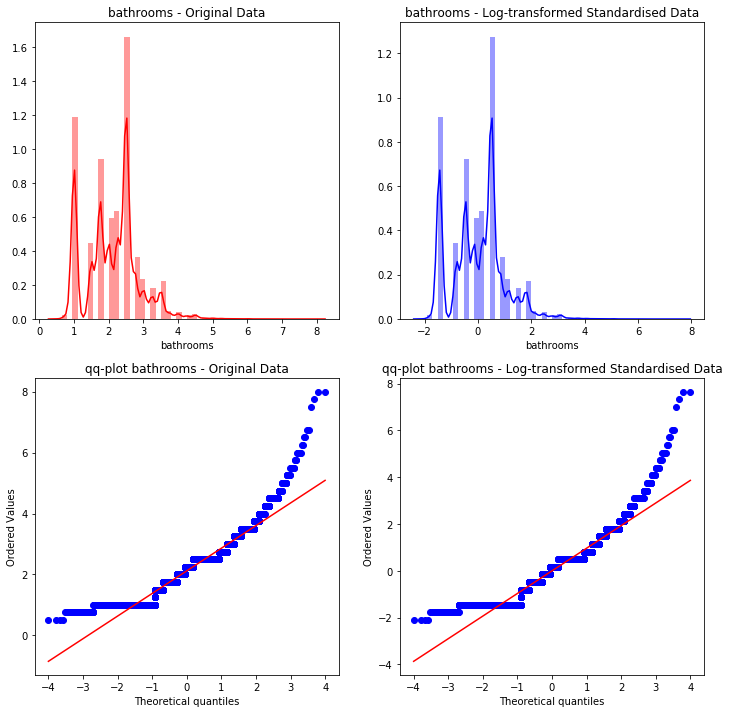

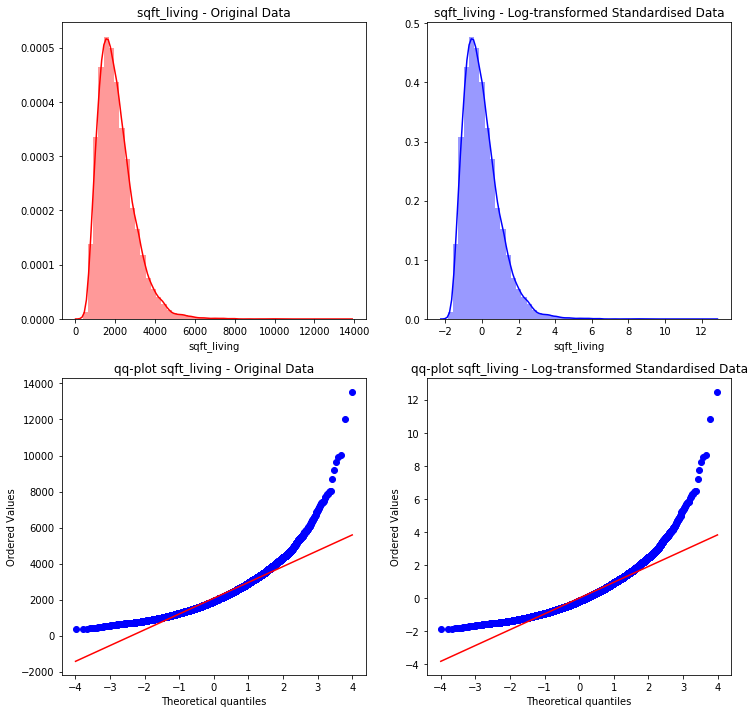

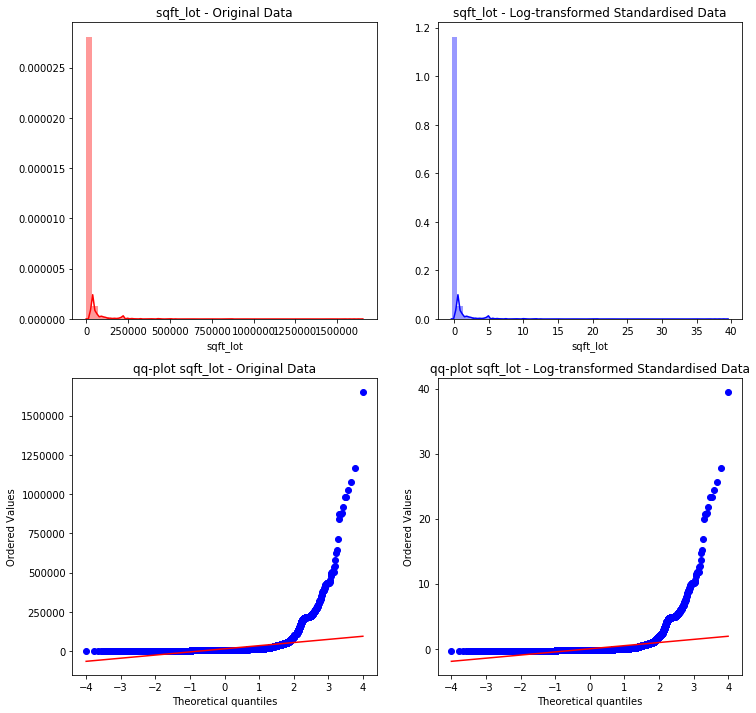

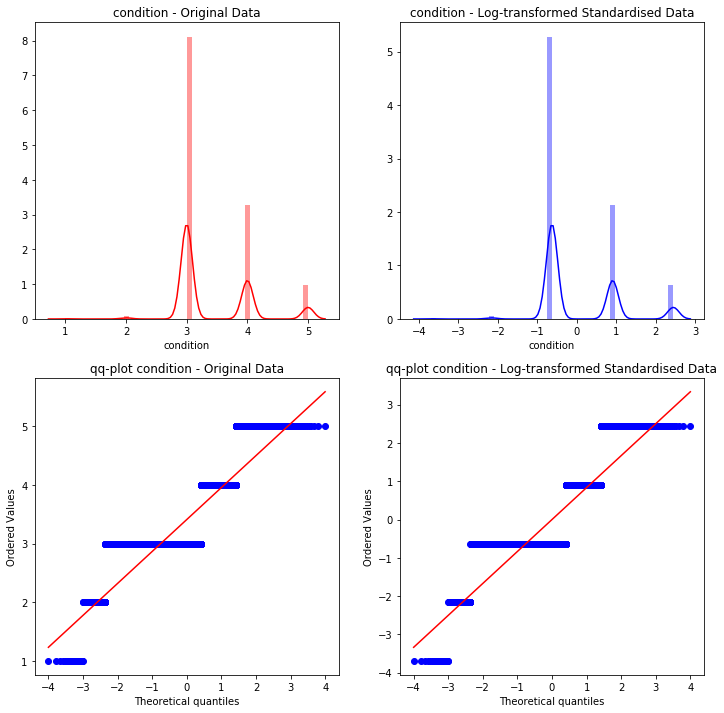

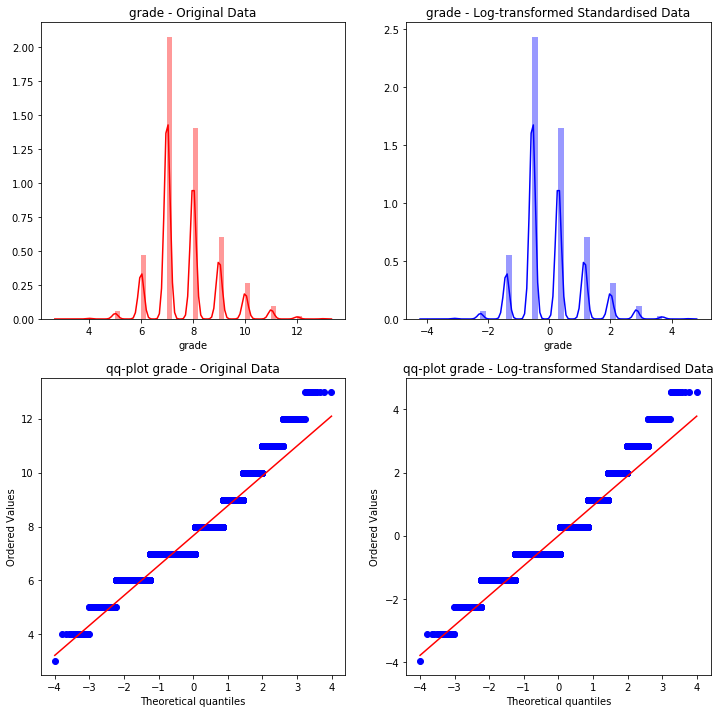

...

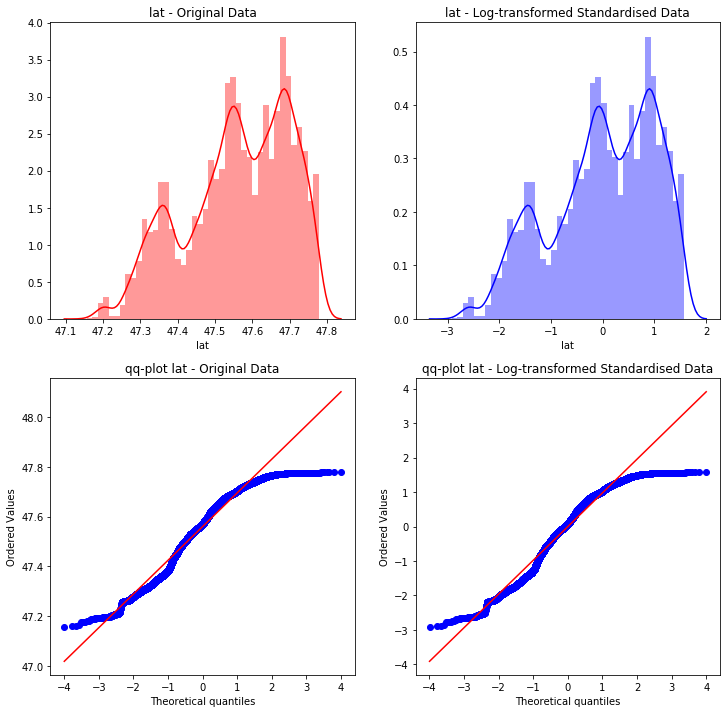

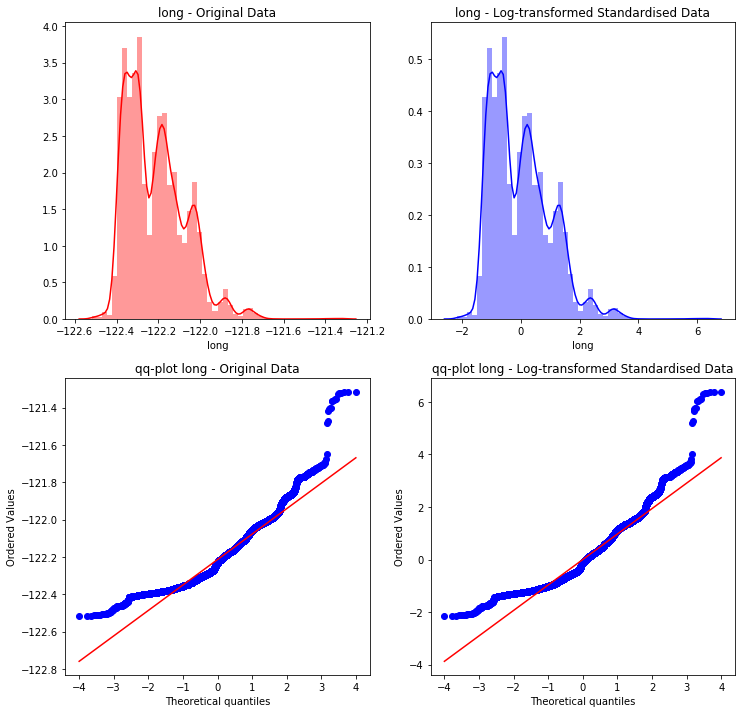

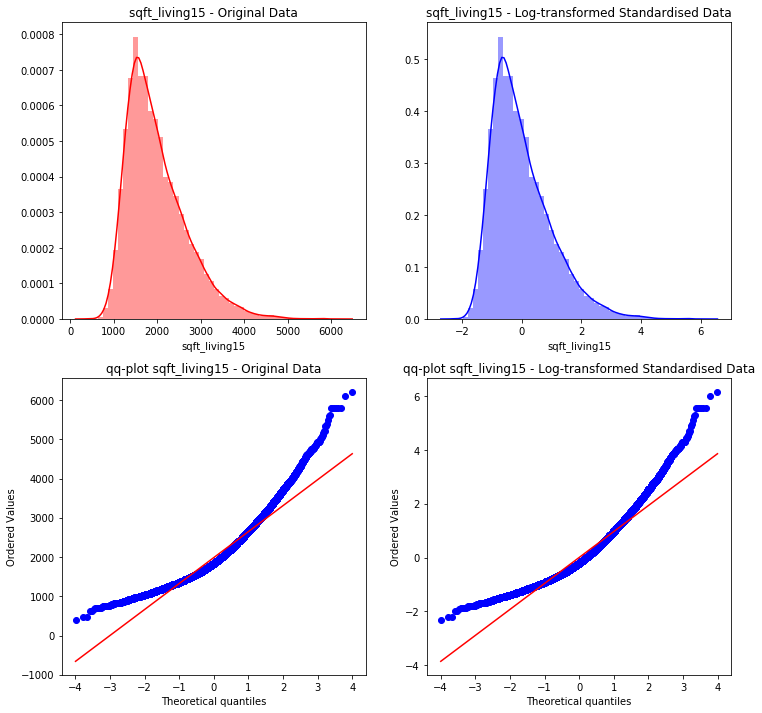

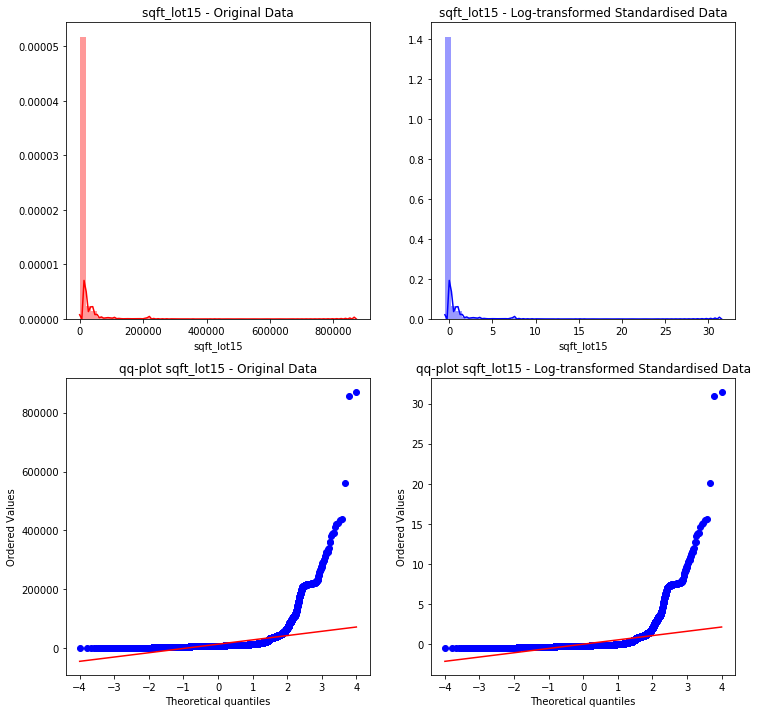

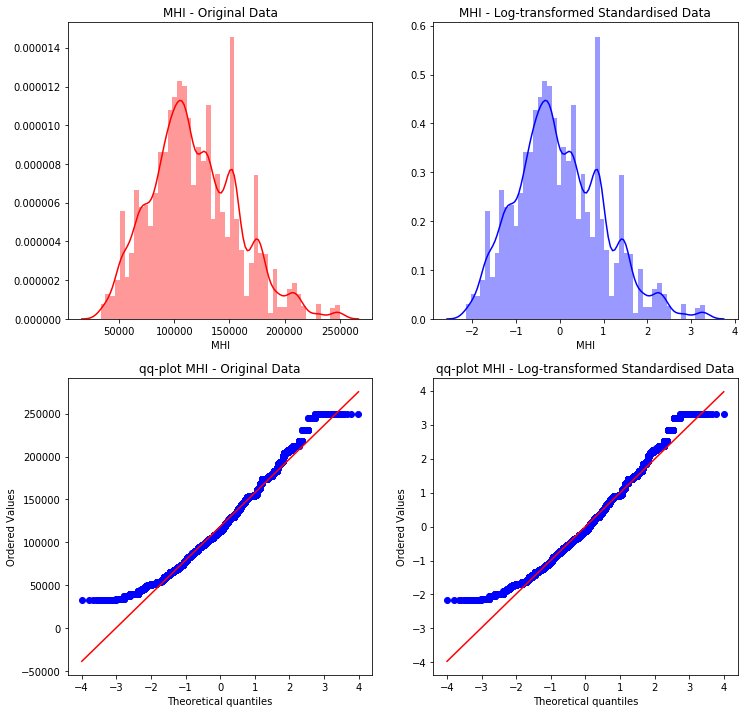

In [109]:
plot_before_after(dflog, dfStd, cont, 'Original',
                  'Log-transformed Standardised')

##### Standardisation dataset with category levels threshold < 6

In [110]:
dfStd6 = dflog6.copy()

In [111]:
standardiser = StandardScaler()
dfStd6[cont6] = standardiser.fit_transform(dflog[cont6])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


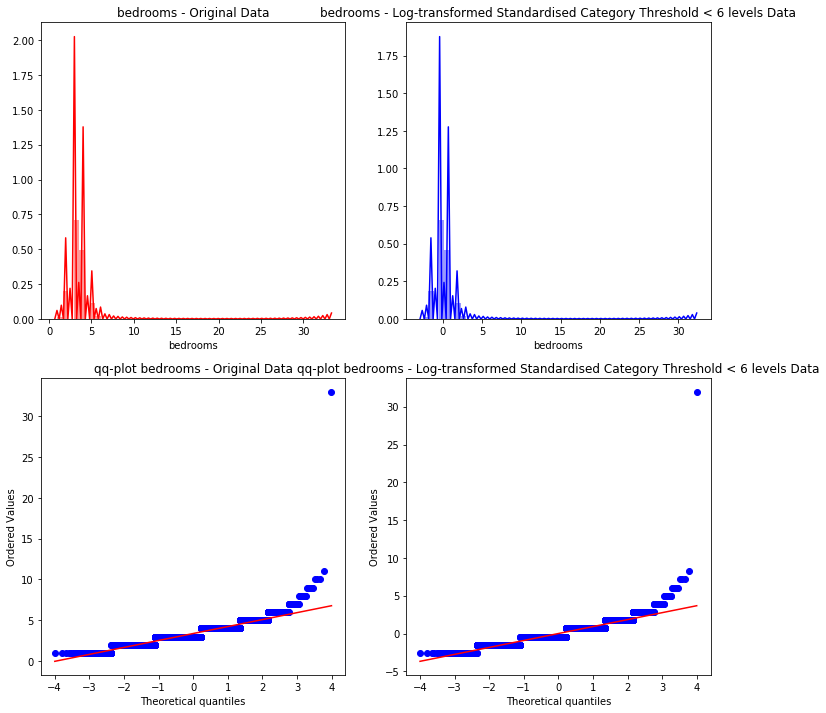

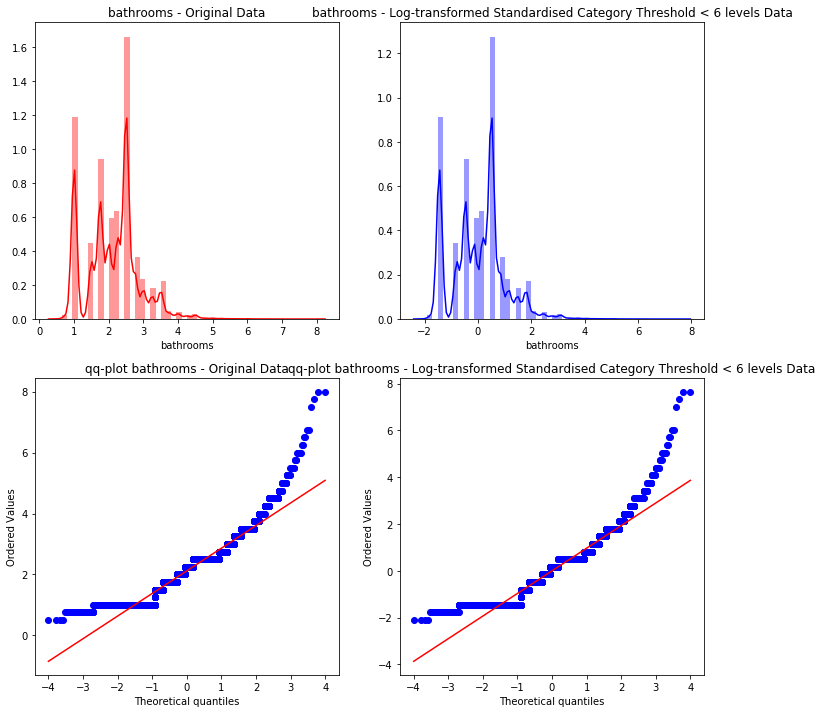

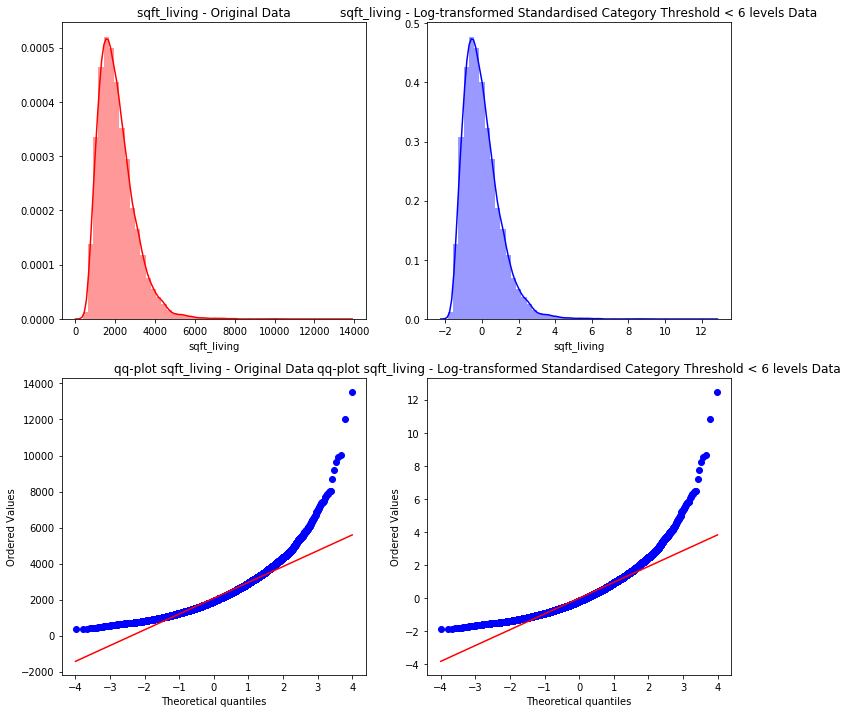

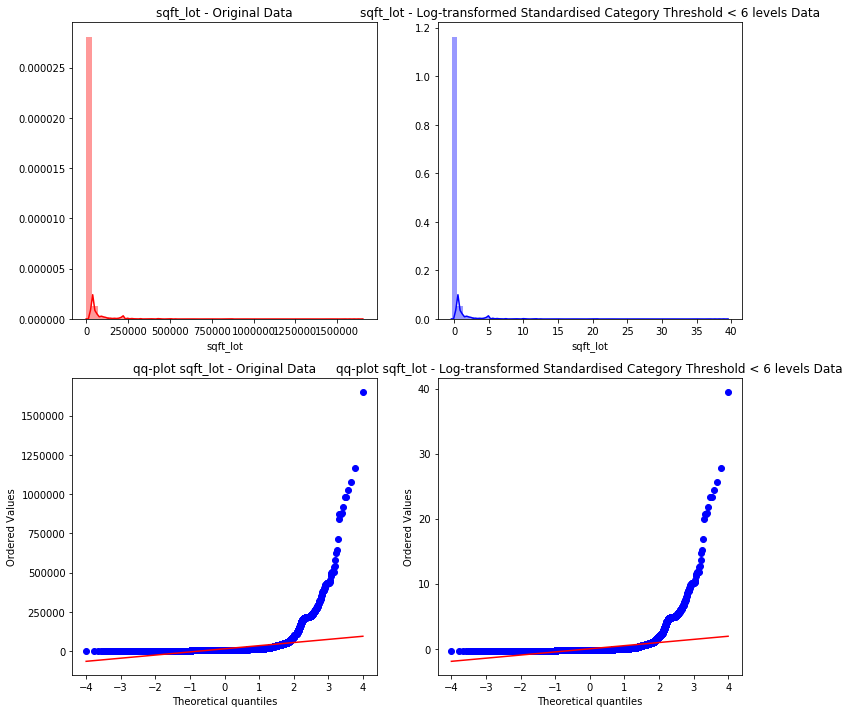

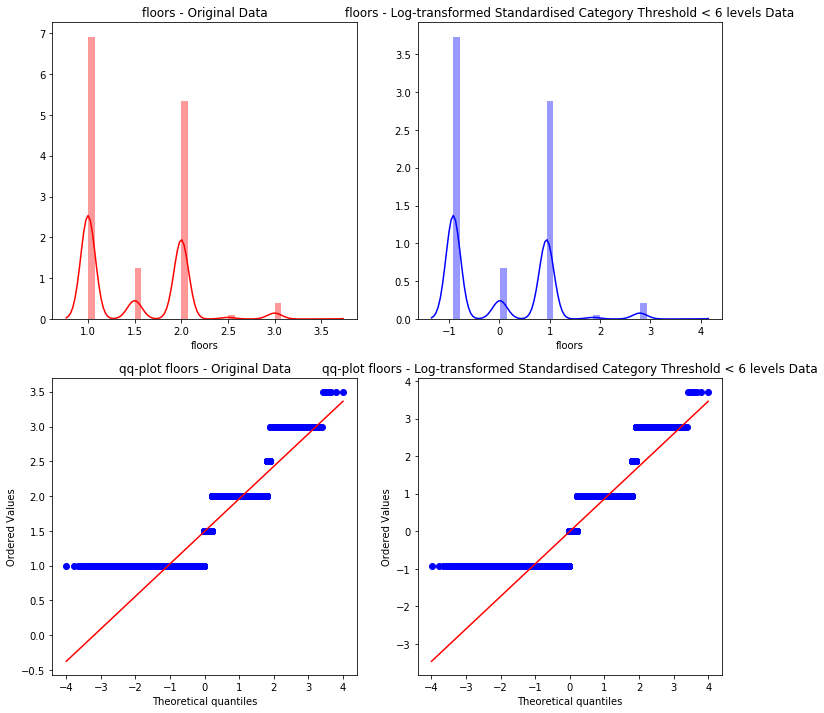

...

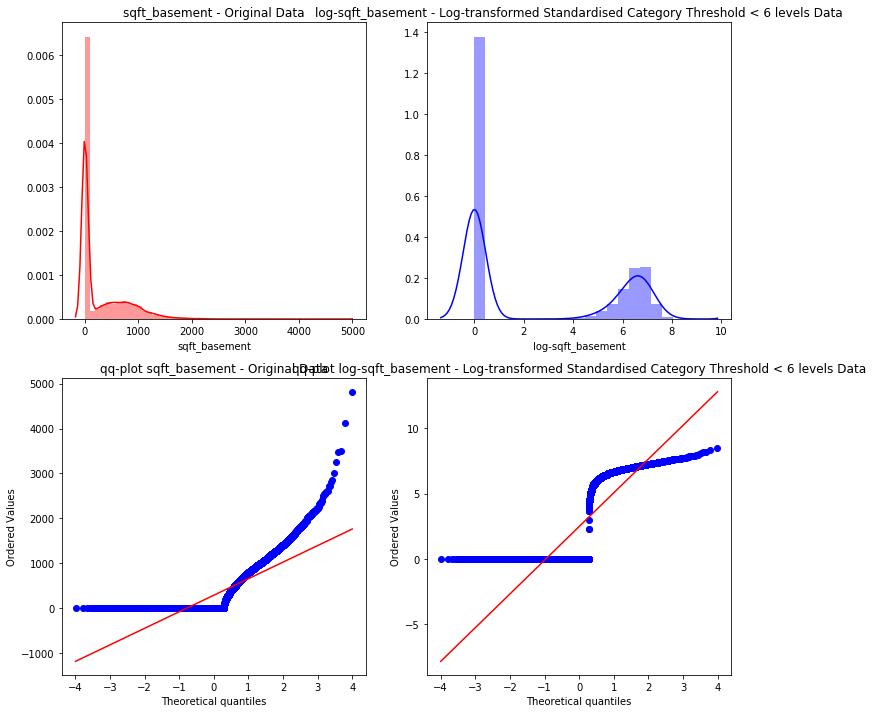

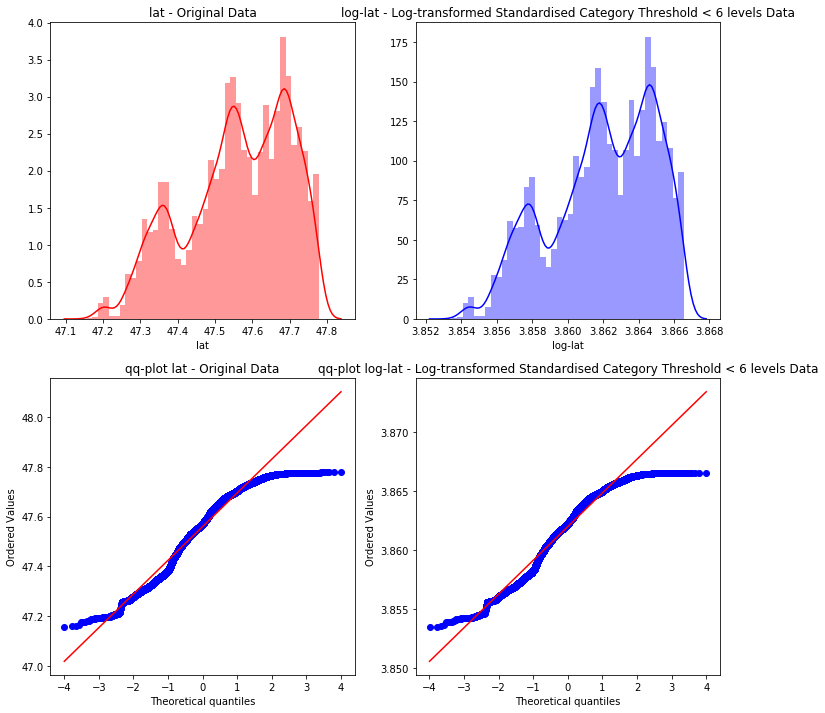

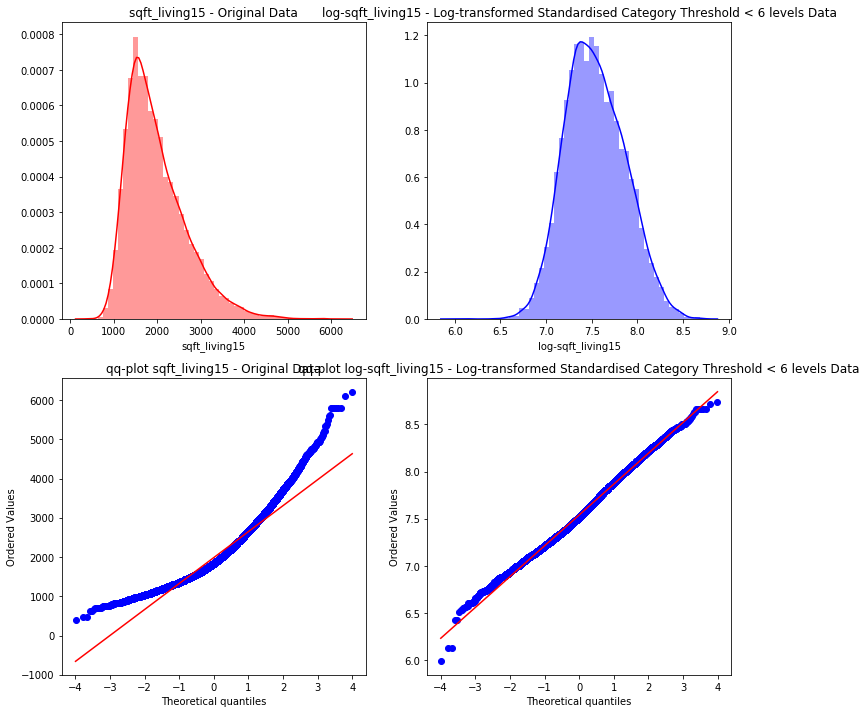

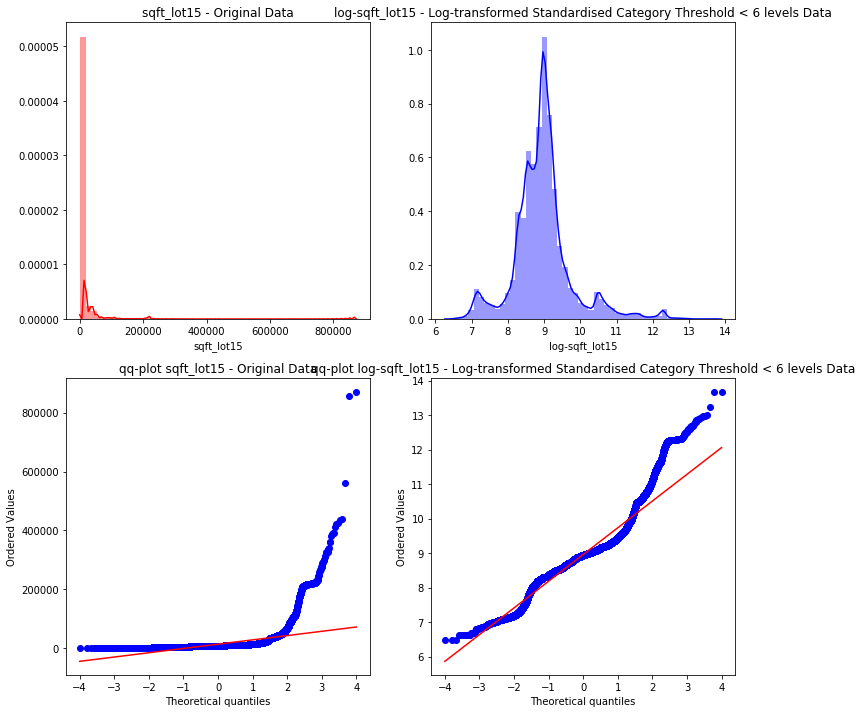

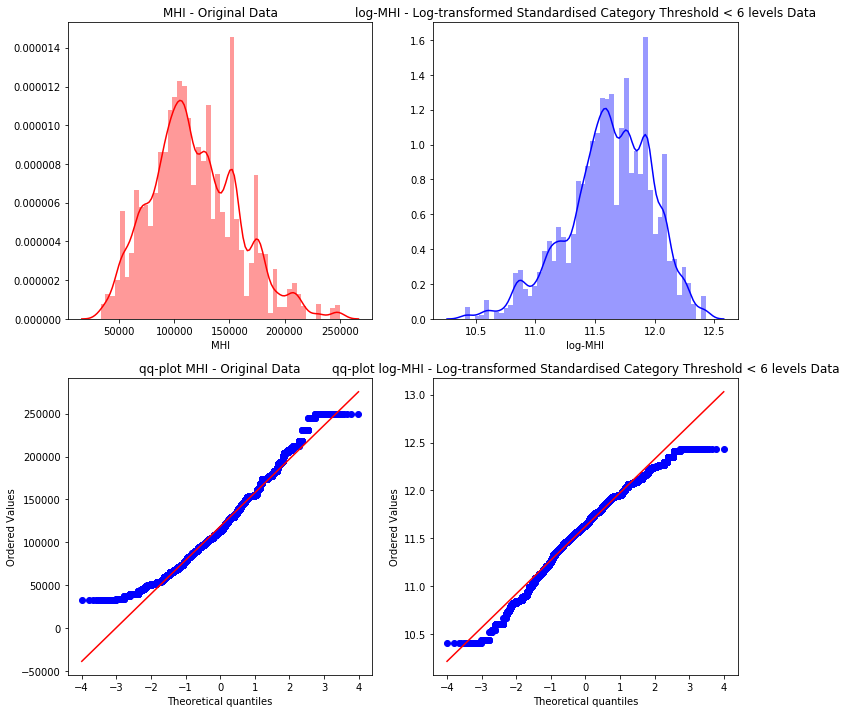

In [112]:
plot_before_after(df, dfStd6, cont6, 'Original',
                  'Log-transformed Standardised Category Threshold < 6 levels')

#### Export standardised and scaled datasets to csv

In [113]:
dfStd.to_csv(os.path.join(path, r'logtransformed_std.csv'), index=False)

In [114]:
dfStd6.to_csv(os.path.join(path, r'logtrasnformed_std6.csv'), index=False)

### Make categorical

As we saw from *statistics* function, all the variables selected as categorical have no NaN values. Before making them as categorical we had to be sure that they do not contain:

- Not valid numbers
- Not valid or mispelled characters
- Not correlated variables

In [115]:
dfcopy = df.copy(deep=True)
dfcopy.to_csv('baselinebackup.csv')

To **avoid** adding **multicolinearity**, we use **reference coding** for **categorical variables** (*drop_first=True*)

#### Baseline dataset

##### Category levels threshold < 29

In [116]:
dfB = df.copy()

In [117]:
dfB[cat] = df[cat].astype('category')

In [118]:
dfB = pd.get_dummies(dfB, drop_first=True)

##### Category levels threshold < 6

In [119]:
dfB6 = df.copy()

In [120]:
cat6

['view', 'zipcode']

In [121]:
dfB6[cat6] = df[cat6].astype('category')

In [122]:
dfB6 = pd.get_dummies(dfB6, drop_first=True)

#### Log-transformed dataset

##### Category levels threshold < 29

In [123]:
dflog[cat] = dflog[cat].astype('category')

In [124]:
dflog = pd.get_dummies(dflog, drop_first=True)

##### Category levels threshold < 6

In [125]:
dflog6[cat6] = dflog6[cat6].astype('category')

In [126]:
dflog6 = pd.get_dummies(dflog6, drop_first=True)

#### MinMax Scaled

##### Category levels threshold < 29

In [127]:
dfMinMax[cat] = dfMinMax[cat].astype('category')

In [128]:
dfMinMax = pd.get_dummies(dfMinMax, drop_first=True)

##### Category levels threshold < 6

In [129]:
dfMinMax6[cat6] = dfMinMax6[cat6].astype('category')

In [130]:
dfMinMax6 = pd.get_dummies(dfMinMax6, drop_first=True)

#### Robust Scaled

##### Category levels threshold < 29

In [131]:
dfRobScal[cat] = dfRobScal[cat].astype('category')

In [132]:
dfRobScal = pd.get_dummies(dfRobScal, drop_first=True)

##### Category levels threshold < 6

In [133]:
dfRobScal6[cat6] = dfRobScal6[cat6].astype('category')

In [134]:
dfRobScal6 = pd.get_dummies(dfRobScal6, drop_first=True)

#### Standardised

##### Category levels threshold < 29

In [135]:
dfStd[cat] = dfStd[cat].astype('category')

In [136]:
dfStd = pd.get_dummies(dfStd, drop_first=True)

##### Category levels threshold < 6

In [137]:
dfStd6[cat6] = dfStd6[cat6].astype('category')

In [138]:
dfStd6 = pd.get_dummies(dfStd6, drop_first=True)


### Export processed datasets to csv

In [139]:
Xb = dfB['sqft_living']
Xb.to_csv(os.path.join(path, r'dfModel_1.csv'),
          index=False, header='sqft_living')

In [140]:
Xb_log = dflog['sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed.csv'), index=False, header='sqft_living')

In [141]:
Xb_logrobscal = dflog['sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed_robscal.csv'), index=False, header='sqft_living')

In [142]:
Xb_logminmax = dfMinMax['sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed_minmax.csv'), index=False, header='sqft_living')

In [143]:
Xb_logstd = dfStd['sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed_std.csv'), index=False, header='sqft_living')

In [144]:
dfB.to_csv(os.path.join(path, r'baseline_processed.csv'), index=False)

In [145]:
dfB6.to_csv(os.path.join(path, r'baseline6_processed.csv'), index=False)

In [146]:
dflog.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_processed.csv'), index=False)

In [147]:
dflog6.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed6_processed.csv'), index=False)

In [148]:
dfMinMax.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_minmax_processed.csv'), index=False)

In [149]:
dfMinMax6.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_minmax6_processed.csv'), index=False)

In [150]:
dfRobScal.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_robscal_processed.csv'), index=False)

In [151]:
dfRobScal6.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_robscal6_processed.csv'), index=False)

In [152]:
dfStd.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_std_processed.csv'), index=False)

In [153]:
dfStd6.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_std6_processed.csv'), index=False)

### Reduce multicolinearity

#### Dropping columns duplicated (log and non-log version)

In [154]:
dflog.drop(log_todrop, inplace=True, axis=1)

In [155]:
dflog6.drop(nonlog6_todrop, inplace=True, axis=1)

In [156]:
dfMinMax.drop(log_todrop, inplace=True, axis=1)

In [157]:
dfMinMax6.drop(nonlog6_todrop, inplace=True, axis=1)

In [158]:
dfRobScal.drop(log_todrop, inplace=True, axis=1)

In [159]:
dfRobScal6.drop(nonlog6_todrop, inplace=True, axis=1)

In [160]:
dfStd.drop(log_todrop, inplace=True, axis=1)

In [161]:
dfStd6.drop(nonlog6_todrop, inplace=True, axis=1)

#### Multicolinearity using *.corr()*

In [276]:
models = [dfB, dfB6, dflog, dflog6, dfMinMax,
          dfMinMax6, dfRobScal, dfRobScal6, dfStd, dfStd6]
model_names = ['baseline', 'baseline-6cat', 'logtransformed', 'logtransformed-6cat', 'logtransformed-MinMax',
               'logtrasnformed-MinMax-6cat', 'logtransformed-RobScal', 'logtransformed-RobScal-6cat', 'logtransformed-std', 'logtransformed-std-6cat']

In [163]:
thresh = 0.8
for model in enumerate(models):
    print('{} - Columns multicolinearity {}'.format(
        model_names[model[0]], reduce_multicol(model[1], thresh)))
    #print('\nColumns: {}'.format(list(model[1].columns)))

baseline - Columns multicolinearity {'sqft_above'}
baseline-6cat - Columns multicolinearity {'sqft_above'}
logtransformed - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-6cat - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-MinMax - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtrasnformed-MinMax-6cat - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-RobScal - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-RobScal-6cat - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-std - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-std-6cat - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}


#### Multicolinearity using Varianfe Inflation Factor (VIF)

**Threshold VIF < 5**

In [277]:
vif_dict = {}
for model in enumerate(models):
    vif = [variance_inflation_factor(model[1].values, i)
           for i in range(model[1].shape[1])]
    templist = list(zip(model[1], vif))
    templistofcolumns = [x[0] for x in templist if x[1] < 5]
    vif_dict[model_names[model[0]]] = templistofcolumns

In [165]:
vif_dict

{'baseline': ['sqft_lot',
  'waterfront',
  'sqft_lot15',
  'renovated',
  'bedrooms_6.0',
  'bedrooms_7.0',
  'bedrooms_8.0',
  'bedrooms_9.0',
  'bedrooms_10.0',
  'bedrooms_11.0',
  'bedrooms_33.0',
  'floors_1.5',
  'floors_2.0',
  'floors_2.5',
  'floors_3.0',
  'floors_3.5',
  'view_1.0',
  'view_2.0',
  'view_3.0',
  'view_4.0',
  'zipcode_98002',
  'zipcode_98003',
  'zipcode_98005',
  'zipcode_98007',
  'zipcode_98010',
  'zipcode_98022',
  'zipcode_98023',
  'zipcode_98024',
  'zipcode_98030',
  'zipcode_98031',
  'zipcode_98032',
  'zipcode_98038',
  'zipcode_98039',
  'zipcode_98040',
  'zipcode_98042',
  'zipcode_98055',
  'zipcode_98058',
  'zipcode_98070',
  'zipcode_98092',
  'zipcode_98102',
  'zipcode_98106',
  'zipcode_98108',
  'zipcode_98109',
  'zipcode_98116',
  'zipcode_98119',
  'zipcode_98126',
  'zipcode_98136',
  'zipcode_98146',
  'zipcode_98148',
  'zipcode_98166',
  'zipcode_98168',
  'zipcode_98178',
  'zipcode_98188',
  'zipcode_98198'],
 'baseline-6cat

### Export processed datasets to csv

We're going to remvoe the columns 'sqft_above' and 'sqft_lot15' to reduce multicolinearity and export to csv all the datasets.

#### Multicolinearity using *.corr()*

In [166]:
dfB.drop(['sqft_above'], axis=1).to_csv(os.path.join(
    path, r'baseline_processed_multicol.csv'), index=False)
dfB6.drop(['sqft_above'], axis=1).to_csv(os.path.join(
    path, r'baseline6_processed_multicol.csv'), index=False)
dflog.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                           r'logtransformed_processed_multicol.csv'), index=False)
dflog6.drop(['log-sqft_above', 'log-sqft_lot15'], axis=1).to_csv(
    os.path.join(path, r'logtransformed6_processed_multicol.csv'), index=False)
dfMinMax.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                              r'logtransformed_minmax_processed_multicol.csv'), index=False)
dfMinMax6.drop(['log-sqft_above', 'log-sqft_lot15'], axis=1).to_csv(
    os.path.join(path, r'logtransformed_minmax6_processed_multicol.csv'), index=False)
dfRobScal.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                               r'logtransformed_robscal_processed_multicol.csv'), index=False)
dfRobScal6.drop(['log-sqft_above', 'log-sqft_lot15'], axis=1).to_csv(
    os.path.join(path, r'logtransformed_robscal6_processed_multicol.csv'), index=False)
dfStd.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                           r'logtransformed_std_processed_multicol.csv'), index=False)
dfStd6.drop(['log-sqft_above', 'log-sqft_lot15'], axis=1).to_csv(
    os.path.join(path, r'logtransformed_std6_processed_multicol.csv'), index=False)

#### Multicolinearity using VIF

In [278]:
vif_dict.keys()

dict_keys(['baseline', 'baseline-6cat', 'logtransformed', 'logtransformed-6cat', 'logtransformed-MinMax', 'logtrasnformed-MinMax-6cat', 'logtransformed-RobScal', 'logtransformed-RobScal-6cat', 'logtransformed-std', 'logtransformed-std-6cat'])

In [275]:
vif_dict.keys()

dict_keys(['baseline_out', 'baseline-6cat_out', 'logtransformed_out', 'logtransformed-6cat_out', 'logtransformed-MinMax_out', 'logtrasnformed-MinMax-6cat_out', 'logtransformed-RobScal_out', 'logtransformed-RobScal-6cat_out', 'logtransformed-std_out', 'logtransformed-std-6cat_out'])

In [168]:
dfB[vif_dict['baseline']].to_csv(os.path.join(
    path, r'baseline_processed_multicol_vif.csv'), index=False)
dfB6[vif_dict['baseline-6cat']
     ].to_csv(os.path.join(path, r'baseline6_processed_multicol_vif.csv'), index=False)
dflog[vif_dict['logtransformed']].to_csv(os.path.join(
    path, r'logtransformed_processed_multicol_vif.csv'), index=False)
dflog6[vif_dict['logtransformed-6cat']].to_csv(os.path.join(
    path, r'logtransformed6_processed_multicol_vif.csv'), index=False)
dfMinMax[vif_dict['logtransformed-MinMax']].to_csv(os.path.join(
    path, r'logtransformed_minmax_processed_multicol_vif.csv'), index=False)
dfMinMax6[vif_dict['logtrasnformed-MinMax-6cat']].to_csv(os.path.join(
    path, r'logtransformed_minmax6_processed_multicol_vif.csv'), index=False)
dfRobScal[vif_dict['logtransformed-RobScal']].to_csv(os.path.join(
    path, r'logtransformed_robscal_processed_multicol_vif.csv'), index=False)
dfRobScal6[vif_dict['logtransformed-RobScal-6cat']].to_csv(os.path.join(
    path, r'logtransformed_robscal6_processed_multicol_vif.csv'), index=False)
dfStd[vif_dict['logtransformed-std']].to_csv(os.path.join(
    path, r'logtransformed_std_processed_multicol_vif.csv'), index=False)
dfStd6[vif_dict['logtransformed-std-6cat']].to_csv(os.path.join(
    path, r'logtransformed_std6_processed_multicol_vif.csv'), index=False)

## Removing outliers

In [169]:
z_scores = stats.zscore(dfout)
# calculate z-scores of `df`

abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
new_df = dfout[filtered_entries]

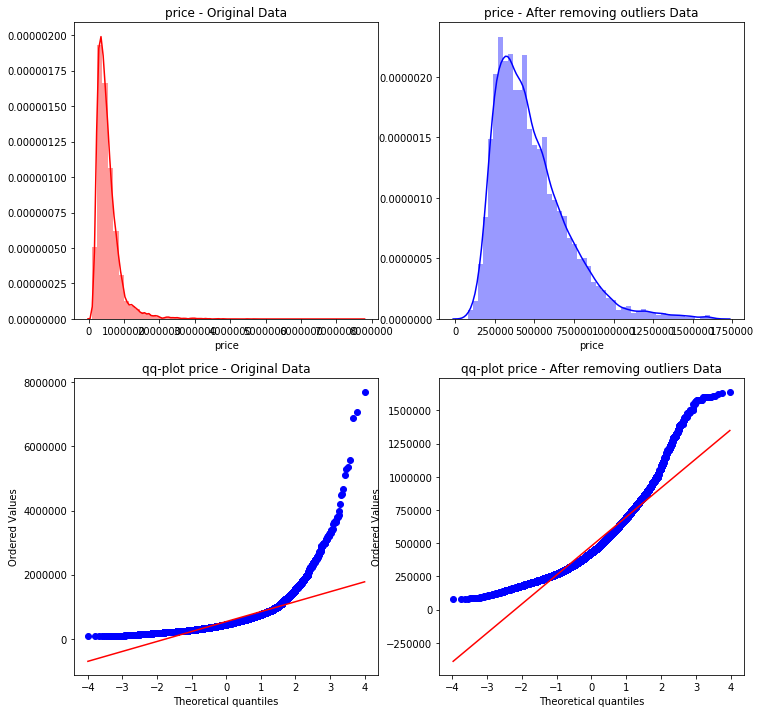

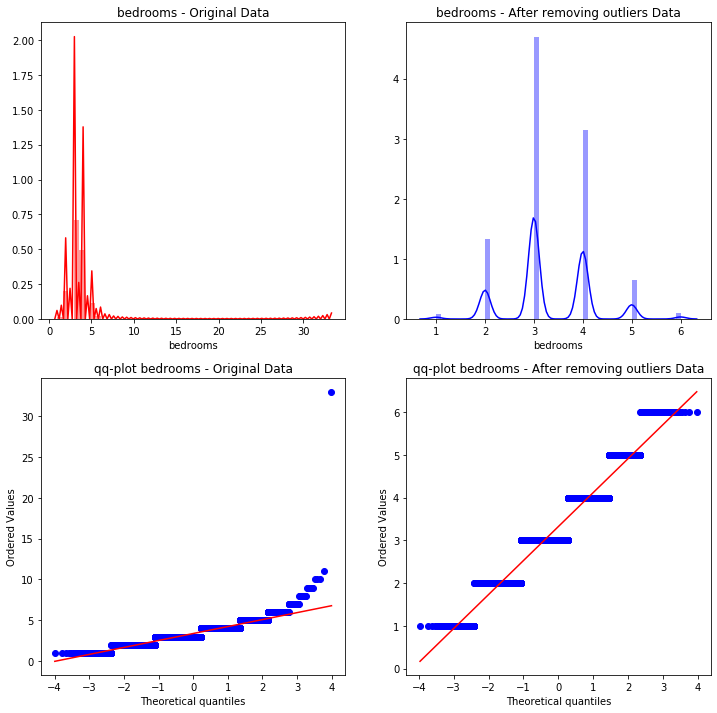

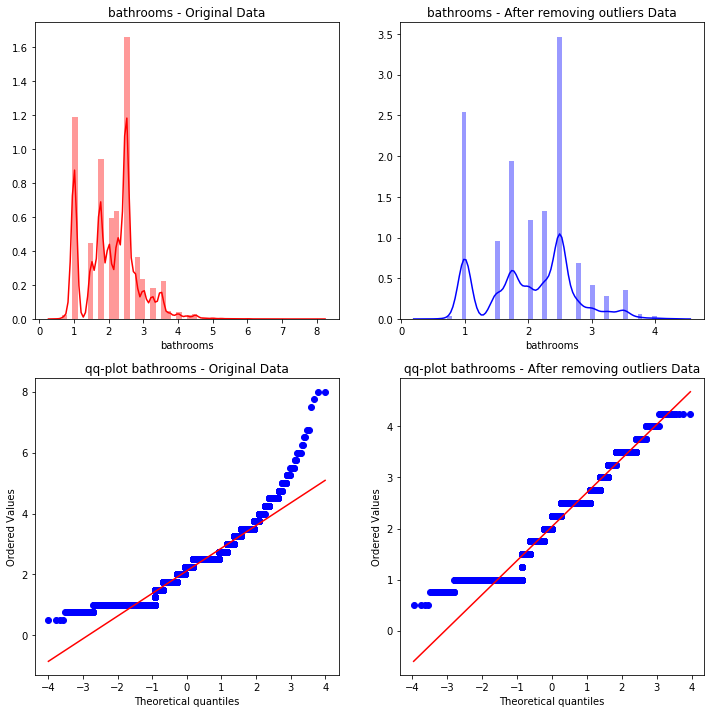

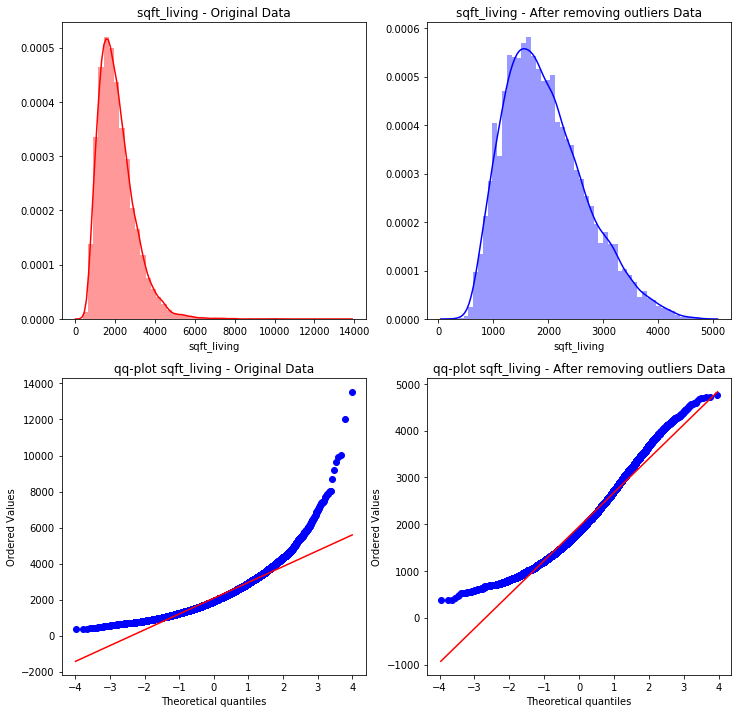

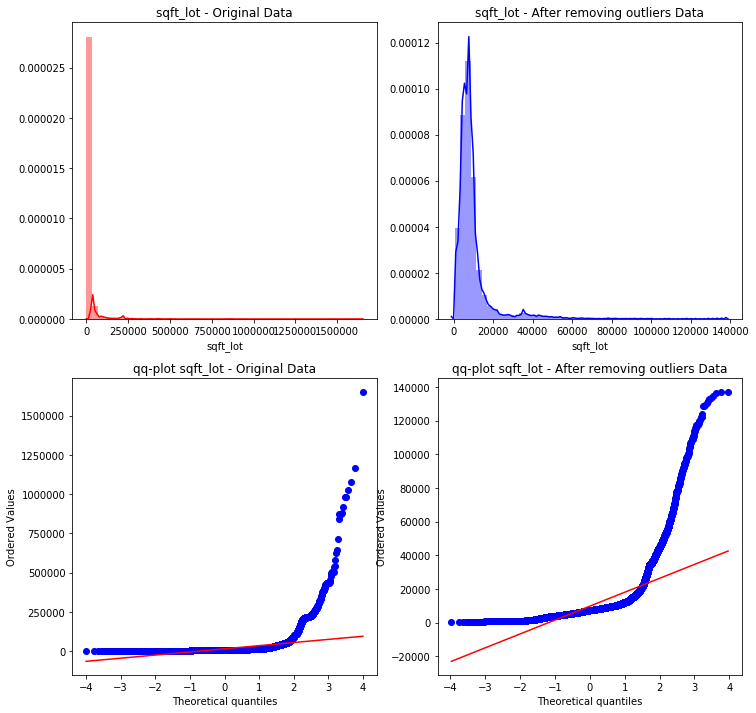

...

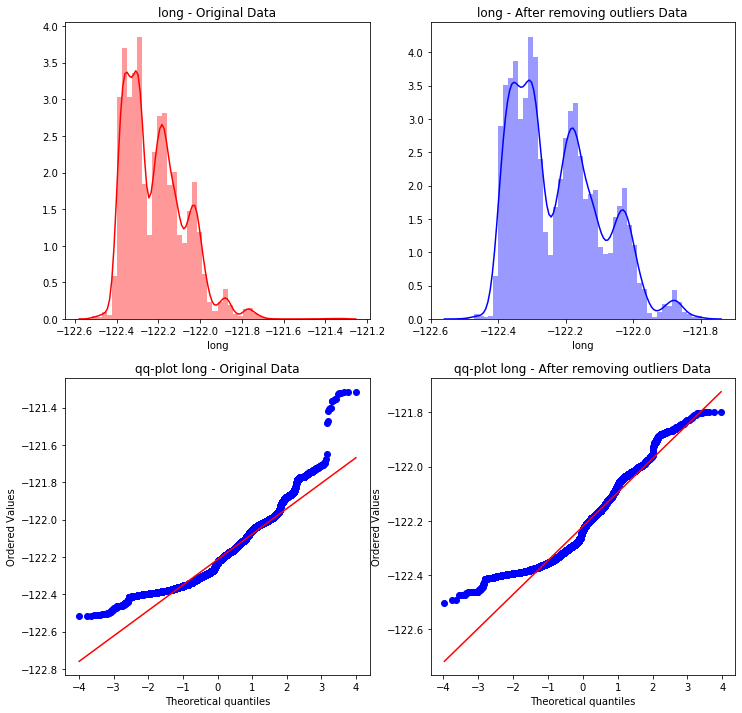

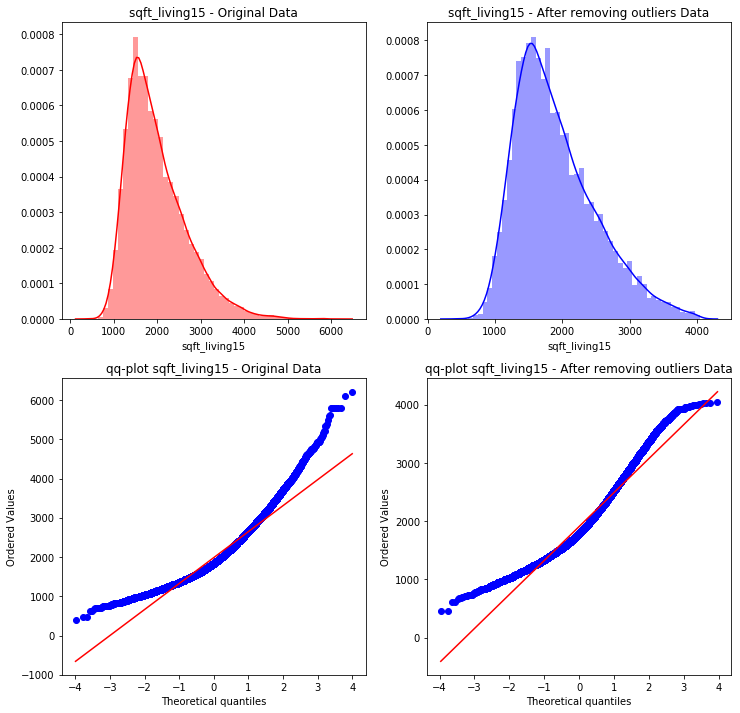

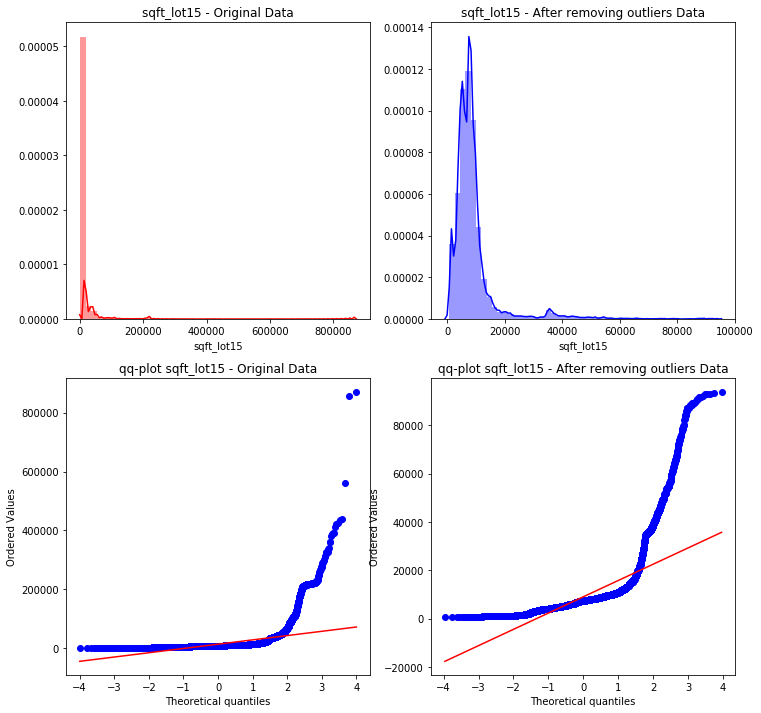

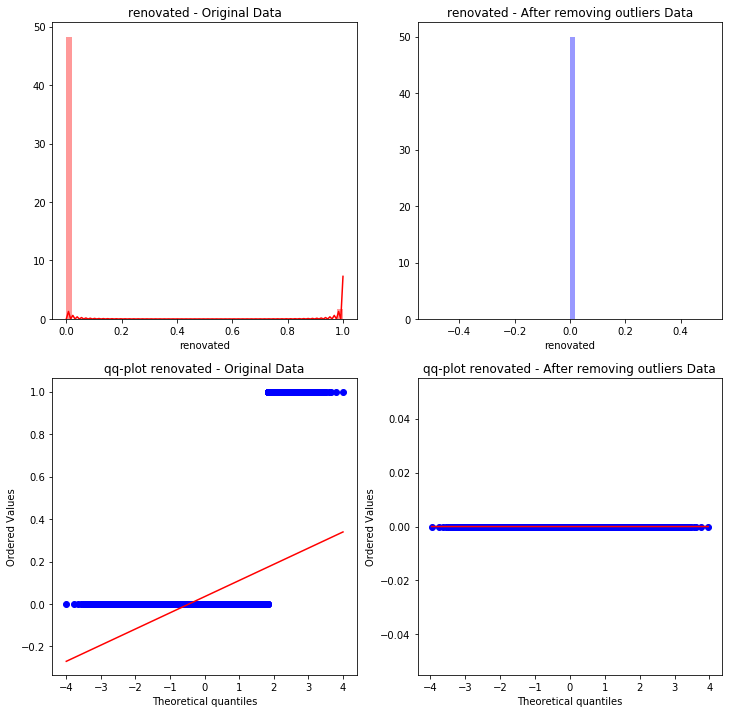

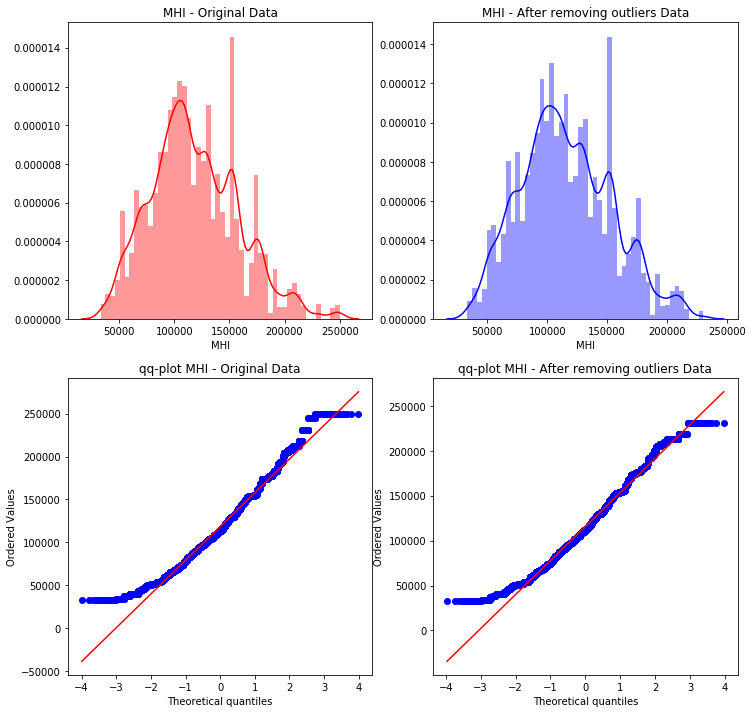

In [170]:
plot_before_after(dfout, new_df, new_df.columns,
                  'Original', 'After removing outliers')

### Export dataset before transformations to csv

In [171]:
new_df['price'].to_csv(os.path.join(
    path, r'target_noout.csv'), header='price', index=False)
new_df.drop('price', axis=1, inplace=True)
new_df.to_csv(os.path.join(
    path, r'baseline_cleaned_noout_not_processed.csv'), index=False)

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/pandas/core/frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


### Log-transform positive skewed variables

#### Dataset with category levels threshold < 29

Let's recall our continous variables:

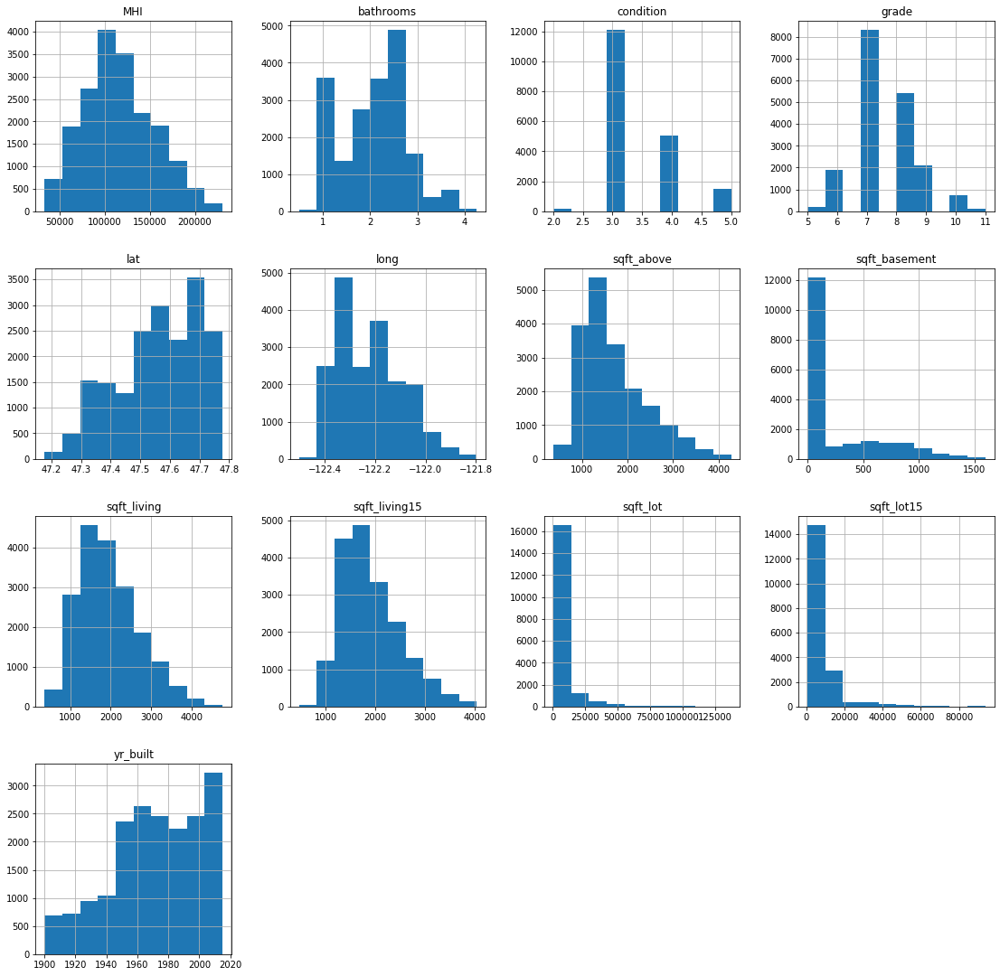

In [172]:
new_df[cont].hist(figsize=(19, 19))

In [173]:
dflog_out = new_df.copy()

In [174]:
# select only positively skewed columns to log-transform
nonlog = ['lat', 'long', 'yr_built', 'grade',
          'condition', 'zipcode', 'renovated']
log = list((Counter(list(dflog_out[cont].columns)) - Counter(nonlog)).keys())

In [175]:
logtransform(dflog_out)

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,...,log-sqft_lot,log-floors,log-waterfront,log-view,log-sqft_above,log-sqft_basement,log-lat,log-sqft_living15,log-sqft_lot15,log-MHI
0,3.0,1.00,1180.0,5650.0,1.0,1.0,1.0,3,7,1180.0,...,8.639411,0.000000,0.0,0.0,7.073270,0.000000,3.860965,7.200425,8.639411,11.526167
2,2.0,1.00,770.0,10000.0,1.0,1.0,1.0,3,6,770.0,...,9.210340,0.000000,0.0,0.0,6.646391,0.000000,3.865726,7.908387,8.994917,11.776358
3,4.0,3.00,1960.0,5000.0,1.0,1.0,1.0,5,7,1050.0,...,8.517193,0.000000,0.0,0.0,6.956545,6.813445,3.861168,7.215240,8.517193,11.884641
4,3.0,2.00,1680.0,8080.0,1.0,1.0,1.0,3,8,1680.0,...,8.997147,0.000000,0.0,0.0,7.426549,0.000000,3.863186,7.495542,8.923058,12.083622
6,3.0,2.25,1715.0,6819.0,2.0,1.0,1.0,3,7,1715.0,...,8.827468,0.693147,0.0,0.0,7.447168,0.000000,3.856715,7.713338,8.827468,11.037016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,3.0,2.50,1530.0,1131.0,3.0,1.0,1.0,3,8,1530.0,...,7.030857,1.098612,0.0,0.0,7.333023,0.000000,3.864917,7.333023,7.319202,11.607499
21593,4.0,2.50,2310.0,5813.0,2.0,1.0,1.0,3,8,2310.0,...,8.667852,0.693147,0.0,0.0,7.745003,0.000000,3.860955,7.512071,8.881836,11.213576
21594,2.0,0.75,1020.0,1350.0,2.0,1.0,1.0,3,7,1020.0,...,7.207860,0.693147,0.0,0.0,6.927558,0.000000,3.862715,6.927558,7.604396,11.566096
21595,3.0,2.50,1600.0,2388.0,2.0,1.0,1.0,3,8,1600.0,...,7.778211,0.693147,0.0,0.0,7.377759,0.000000,3.861456,7.251345,7.160069,12.116531


Shape:  (18793, 32)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 18793 entries, 0 to 21596
Data columns (total 32 columns):
bedrooms             18793 non-null float64
bathrooms            18793 non-null float64
sqft_living          18793 non-null float64
sqft_lot             18793 non-null float64
floors               18793 non-null float64
waterfront           18793 non-null float64
view                 18793 non-null float64
condition            18793 non-null int64
grade                18793 non-null int64
sqft_above           18793 non-null float64
sqft_basement        18793 non-null float64
yr_built             18793 non-null int64
zipcode              18793 non-null int64
lat                  18793 non-null float64
long                 18793 non-null float64
sqft_living15        18793 non-null float64
sqft_lot15           18793 non-null float64
renovated            18793 non-null int64
MHI                  1879


Column name: renovated

0    1.0
Name: renovated, dtype: float64

Column name: MHI

153611.0    0.013303
139094.0    0.011121
90343.0     0.007503
173940.0    0.007290
121696.0    0.006492
              ...   
43088.0     0.000213
105725.0    0.000106
53578.0     0.000106
51607.0     0.000053
37438.0     0.000053
Name: MHI, Length: 372, dtype: float64

Column name: log-bedrooms

1.098612    0.470228
1.386294    0.313893
0.693147    0.132869
1.609438    0.065610
1.791759    0.009365
0.000000    0.008035
Name: log-bedrooms, dtype: float64

Column name: log-bathrooms

 0.916291    0.260097
 0.000000    0.190816
 0.559616    0.145586
 0.810930    0.099452
 0.693147    0.090885
 0.405465    0.072261
 1.011601    0.051881
 1.098612    0.031022
 1.252763    0.026340
 1.178655    0.020806
 1.321756    0.004417
 1.386294    0.002448
-0.287682    0.002341
 1.446919    0.001064
 0.223144    0.000372
-0.693147    0.000213
Name: log-bathrooms, dtype: float64

Column name: log-sqft_living

7.244228

Int64Index([   94,   346,   372,   824,   837,  1085,  1128,  1201,  1233,
             1449,
            ...
            20508, 20525, 20597, 20662, 20764, 20809, 20815, 20906, 21093,
            21565],
           dtype='int64', length=168)

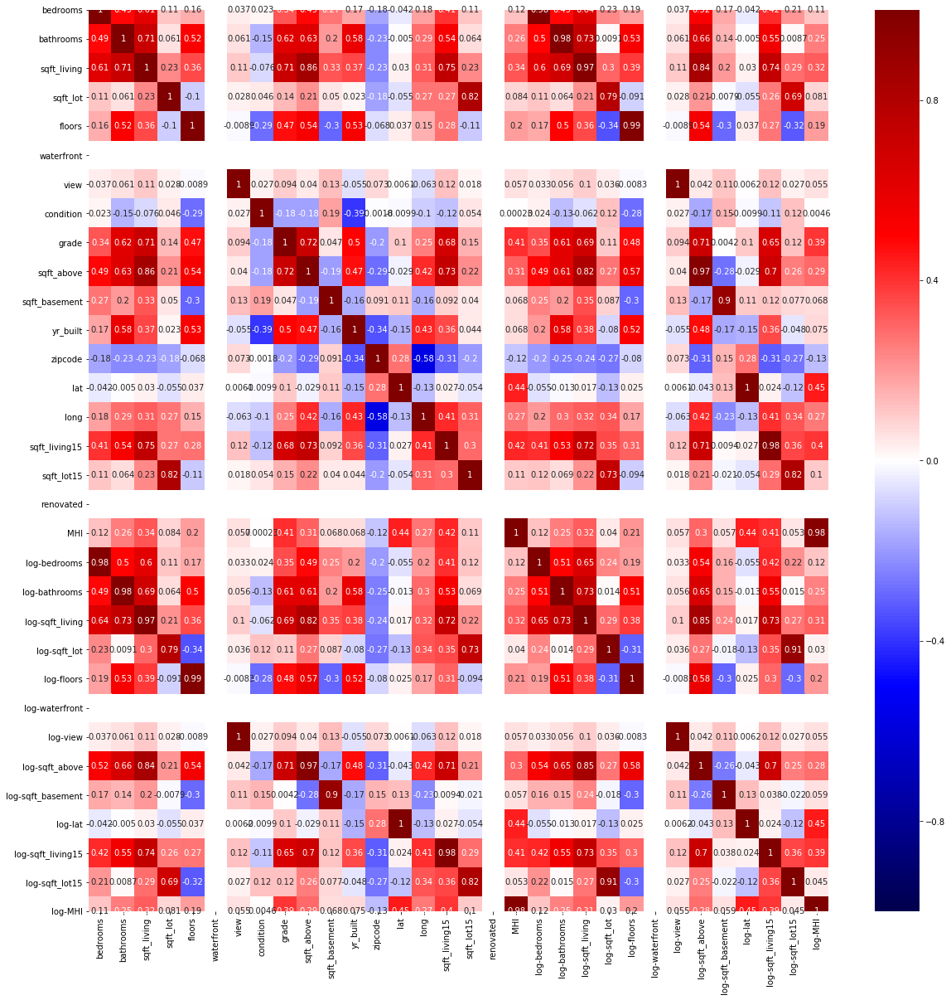

<Figure size 1440x1440 with 0 Axes>

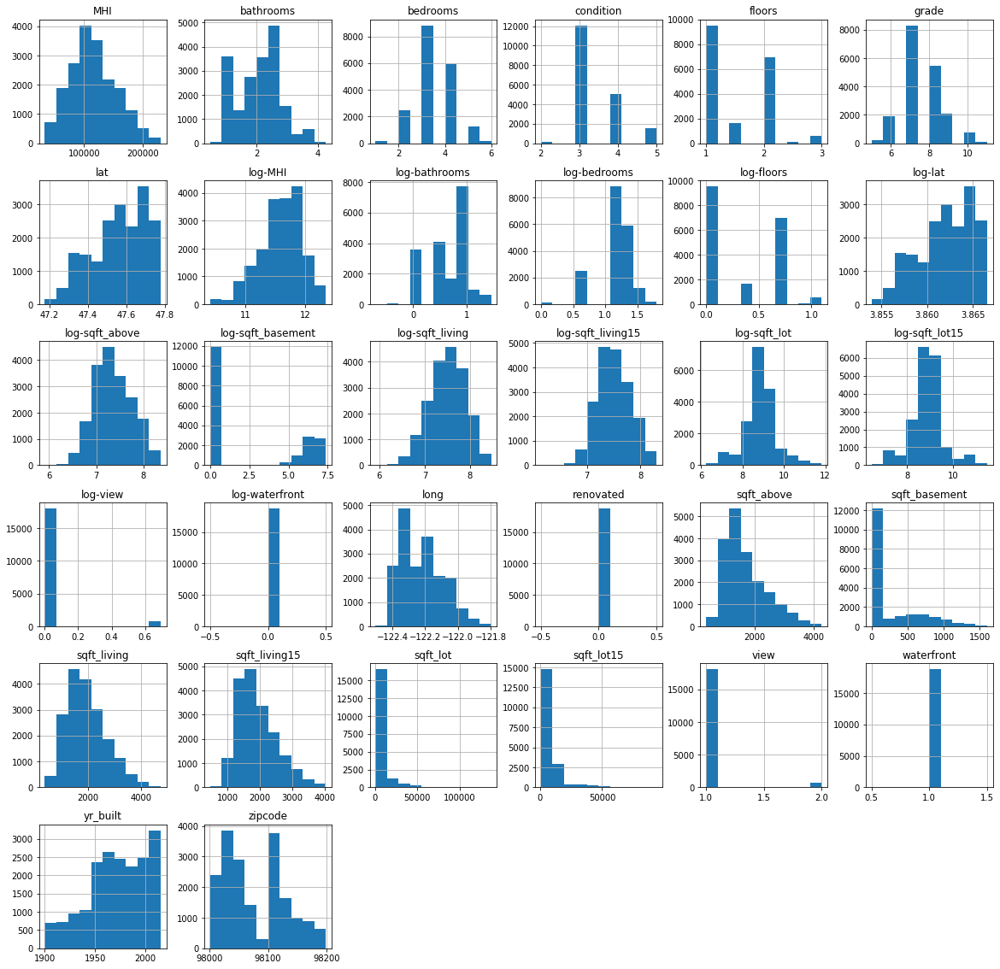

In [176]:
statistics(dflog_out)

Out of the log-columns, we keep only 'log-bathrooms' as it's the only column that benefit from log-transform.

In [177]:
log_columns = [col for col in dflog_out.columns if col.startswith('log')]
log_tokeep = ['log-bathrooms', 'log-MHI', 'log-sqft_above', 'log-sqft_lot15',
              'log-sqft_living15', 'log-sqft_living', 'log-sqft_basement', 'log-sqft_lot']
log_todrop = list((Counter(log_columns) - Counter(list(log_tokeep)
                                                  ) + Counter(list(log)) - Counter(list(cat))))

#### Dataset with category levels threshold < 6

Let's recall our continous variables for category-level-threshold < 6

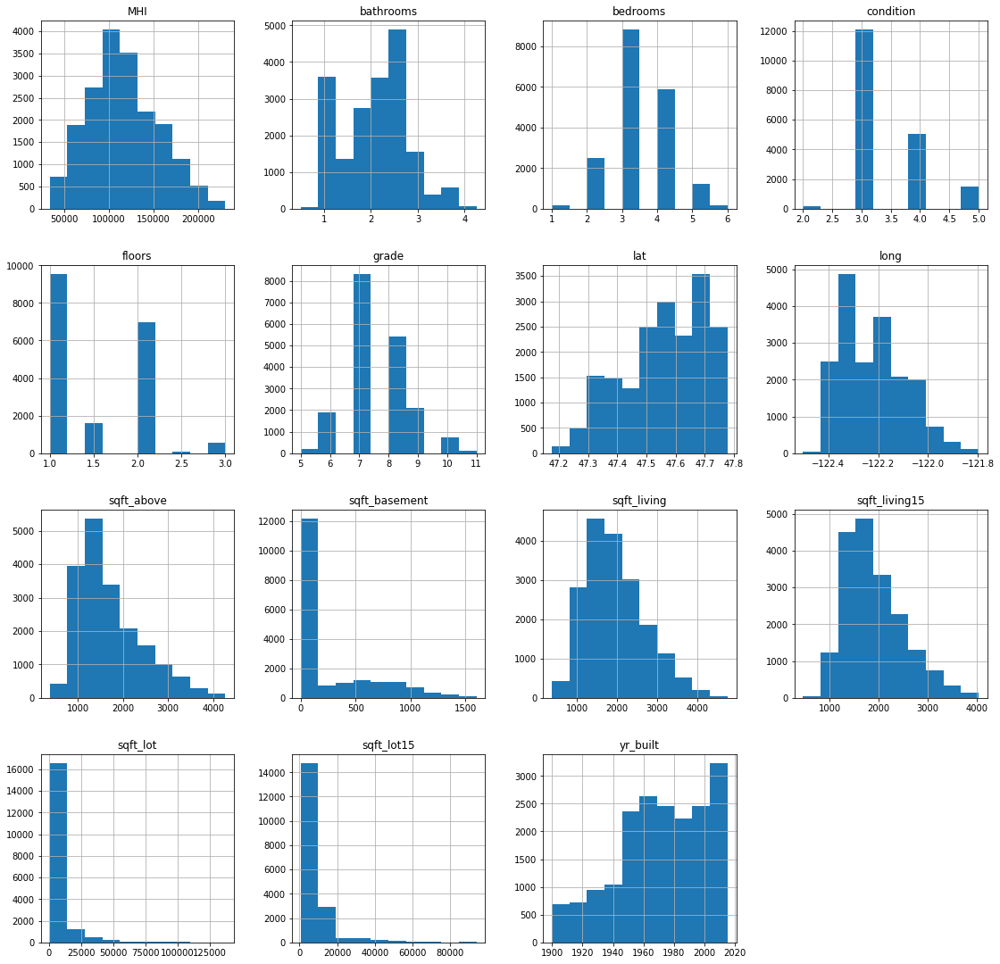

In [178]:
new_df[cont6].hist(figsize=(19, 19))

In [179]:
dflog6_out = new_df.copy()

In [180]:
# select only positively skewed columns to log-transform
nonlog6 = ['lat', 'long', 'yr_built', 'grade',
           'condition', 'zipcode', 'renovated', 'view', 'floors']
log6 = list((Counter(cont6) - Counter(nonlog6) - Counter(cat6)).keys())

In [181]:
logtransform(dflog6_out)

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,...,log-sqft_lot,log-floors,log-waterfront,log-view,log-sqft_above,log-sqft_basement,log-lat,log-sqft_living15,log-sqft_lot15,log-MHI
0,3.0,1.00,1180.0,5650.0,1.0,1.0,1.0,3,7,1180.0,...,8.639411,0.000000,0.0,0.0,7.073270,0.000000,3.860965,7.200425,8.639411,11.526167
2,2.0,1.00,770.0,10000.0,1.0,1.0,1.0,3,6,770.0,...,9.210340,0.000000,0.0,0.0,6.646391,0.000000,3.865726,7.908387,8.994917,11.776358
3,4.0,3.00,1960.0,5000.0,1.0,1.0,1.0,5,7,1050.0,...,8.517193,0.000000,0.0,0.0,6.956545,6.813445,3.861168,7.215240,8.517193,11.884641
4,3.0,2.00,1680.0,8080.0,1.0,1.0,1.0,3,8,1680.0,...,8.997147,0.000000,0.0,0.0,7.426549,0.000000,3.863186,7.495542,8.923058,12.083622
6,3.0,2.25,1715.0,6819.0,2.0,1.0,1.0,3,7,1715.0,...,8.827468,0.693147,0.0,0.0,7.447168,0.000000,3.856715,7.713338,8.827468,11.037016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,3.0,2.50,1530.0,1131.0,3.0,1.0,1.0,3,8,1530.0,...,7.030857,1.098612,0.0,0.0,7.333023,0.000000,3.864917,7.333023,7.319202,11.607499
21593,4.0,2.50,2310.0,5813.0,2.0,1.0,1.0,3,8,2310.0,...,8.667852,0.693147,0.0,0.0,7.745003,0.000000,3.860955,7.512071,8.881836,11.213576
21594,2.0,0.75,1020.0,1350.0,2.0,1.0,1.0,3,7,1020.0,...,7.207860,0.693147,0.0,0.0,6.927558,0.000000,3.862715,6.927558,7.604396,11.566096
21595,3.0,2.50,1600.0,2388.0,2.0,1.0,1.0,3,8,1600.0,...,7.778211,0.693147,0.0,0.0,7.377759,0.000000,3.861456,7.251345,7.160069,12.116531


Shape:  (18793, 32)

dtype objects of each column and number of non-null objects:


<class 'pandas.core.frame.DataFrame'>
Int64Index: 18793 entries, 0 to 21596
Data columns (total 32 columns):
bedrooms             18793 non-null float64
bathrooms            18793 non-null float64
sqft_living          18793 non-null float64
sqft_lot             18793 non-null float64
floors               18793 non-null float64
waterfront           18793 non-null float64
view                 18793 non-null float64
condition            18793 non-null int64
grade                18793 non-null int64
sqft_above           18793 non-null float64
sqft_basement        18793 non-null float64
yr_built             18793 non-null int64
zipcode              18793 non-null int64
lat                  18793 non-null float64
long                 18793 non-null float64
sqft_living15        18793 non-null float64
sqft_lot15           18793 non-null float64
renovated            18793 non-null int64
MHI                  1879


Column name: log-view

0.000000    0.960996
0.693147    0.039004
Name: log-view, dtype: float64

Column name: log-sqft_above

7.170120    0.010589
7.090077    0.010429
6.917706    0.010376
7.106606    0.009631
7.200425    0.008939
              ...   
7.798523    0.000053
7.934872    0.000053
8.209036    0.000053
8.255828    0.000053
8.093768    0.000053
Name: log-sqft_above, Length: 752, dtype: float64

Column name: log-sqft_basement

0.000000    0.630767
6.396930    0.010217
6.214608    0.010110
6.551080    0.010004
6.684612    0.009312
              ...   
5.332719    0.000053
6.758095    0.000053
6.028279    0.000053
6.033086    0.000053
6.230481    0.000053
Name: log-sqft_basement, Length: 204, dtype: float64

Column name: log-lat

3.861407    0.000905
3.864608    0.000851
3.864692    0.000798
3.864837    0.000798
3.864600    0.000798
              ...   
3.865367    0.000053
3.861258    0.000053
3.862763    0.000053
3.854451    0.000053
3.856963    0.000053
Name: log-lat, Length

Int64Index([   94,   346,   372,   824,   837,  1085,  1128,  1201,  1233,
             1449,
            ...
            20508, 20525, 20597, 20662, 20764, 20809, 20815, 20906, 21093,
            21565],
           dtype='int64', length=168)

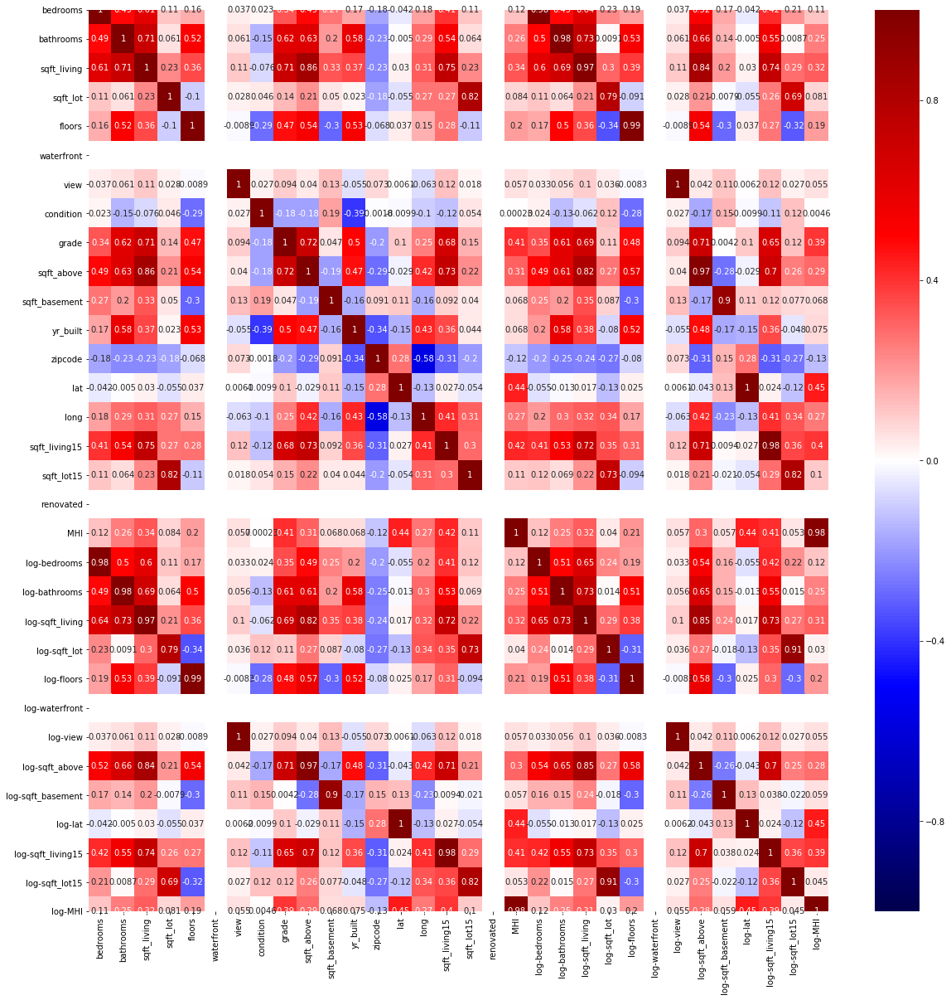

<Figure size 1440x1440 with 0 Axes>

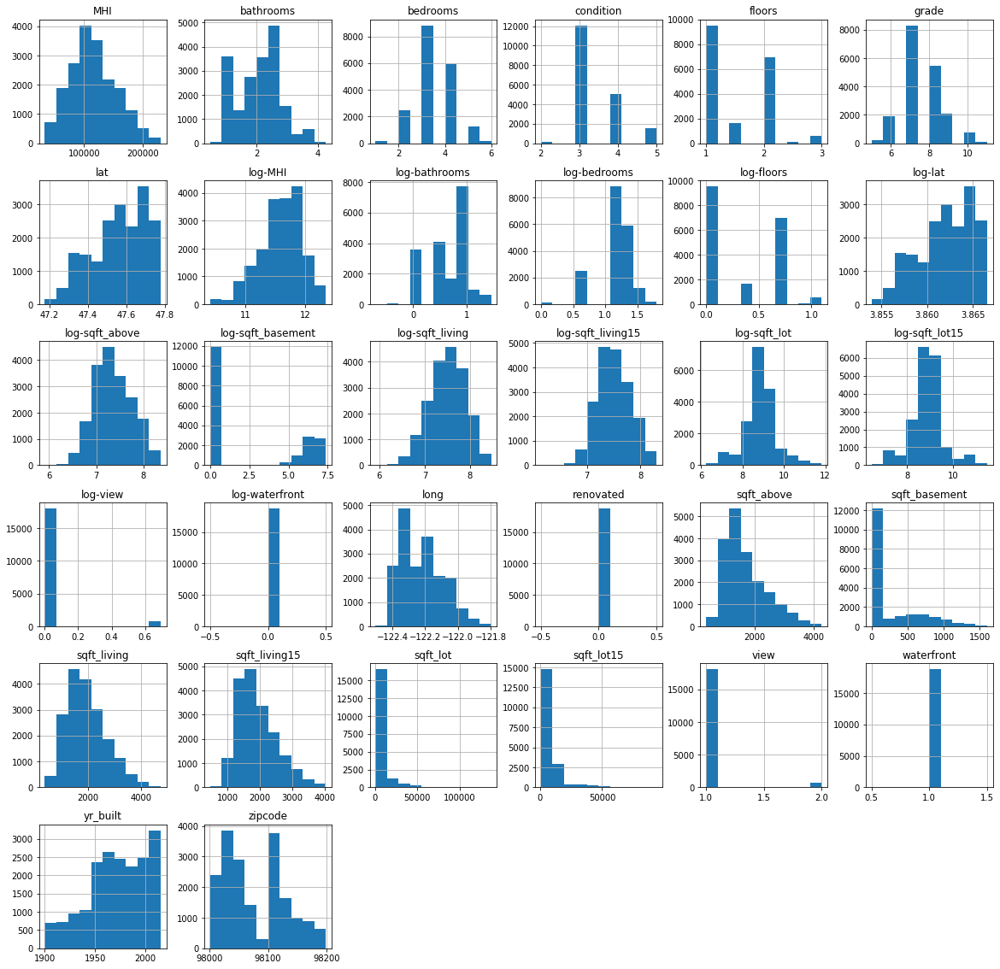

In [182]:
statistics(dflog6_out)

Out of the log-columns, we keep only 'log-bathrooms' as it's the only column that benefit from log-transform.

In [183]:
log6_columns = [col for col in dflog6_out.columns if col.startswith('log')]
log6_tokeep = ['log-bathrooms', 'log-bedrooms', 'log-MHI', 'log-sqft_above',
               'log-sqft_lot', 'log-sqft_lot15', 'log-sqft_living15', 'log-sqft_living']
nonlog6_todrop = list((Counter(log6_columns) - Counter(list(log6_tokeep)
                                                       ) + Counter(list(log6)) - Counter(list(cat6))))

We also updated our list of continous columns

#### Export log-transformed dataset to csv

In [184]:
dflog_out.to_csv(os.path.join(
    path, r'logtransformed_nooutliers.csv'), index=False)

In [185]:
dflog6_out.to_csv(os.path.join(
    path, r'logtransformed6_nooutliers.csv'), index=False)

### Normalisation/standardisation

None of the feature is really normally distributed. We're going to do some scaling first and then standardise.

#### Dataset with category levels threshold < 29

##### Normalising with MinMaxScaler

In [186]:
dfMinMax_out = dflog_out.copy()

In [187]:
scaler = MinMaxScaler()
dfMinMax_out[cont] = scaler.fit_transform(dfMinMax_out[cont])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


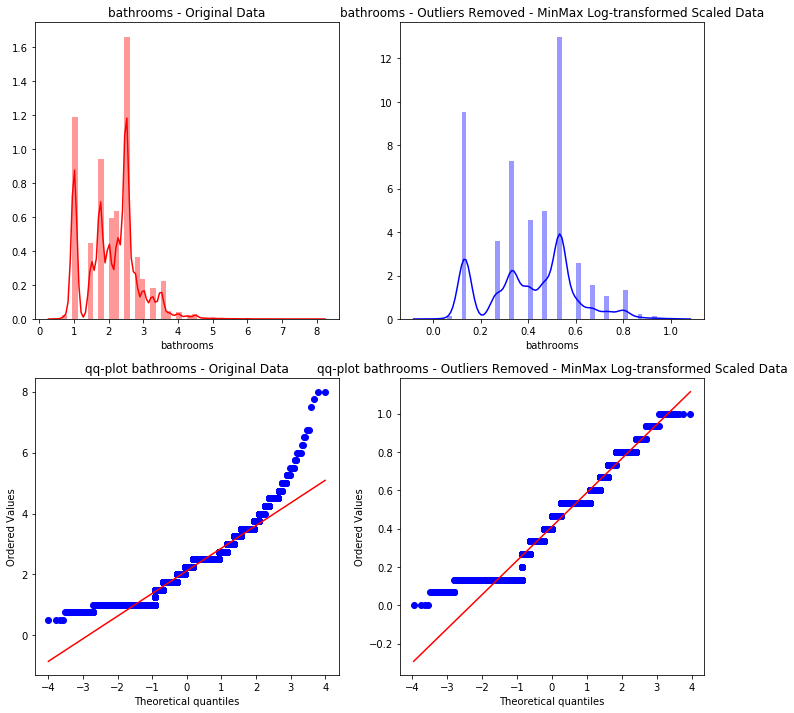

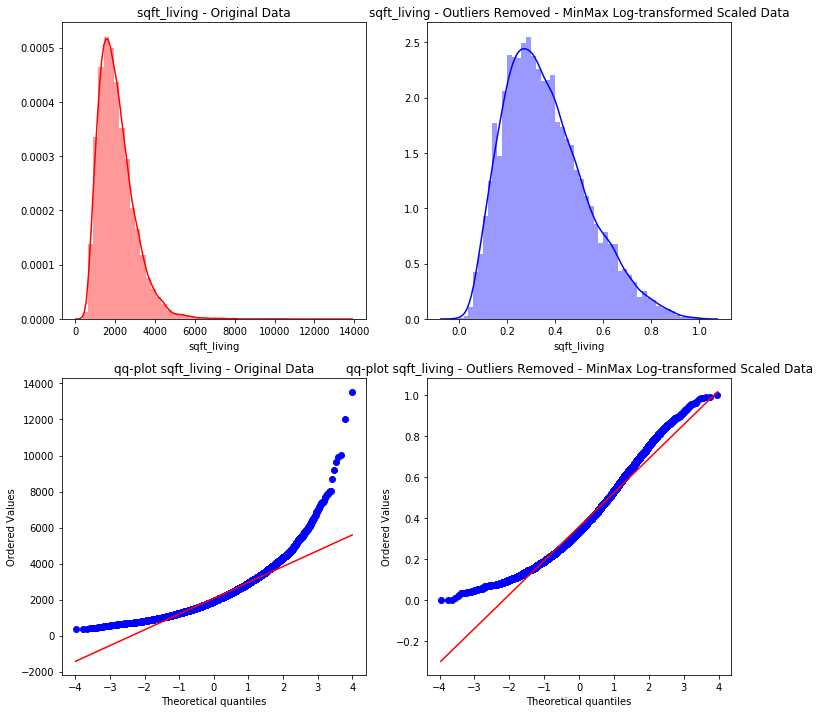

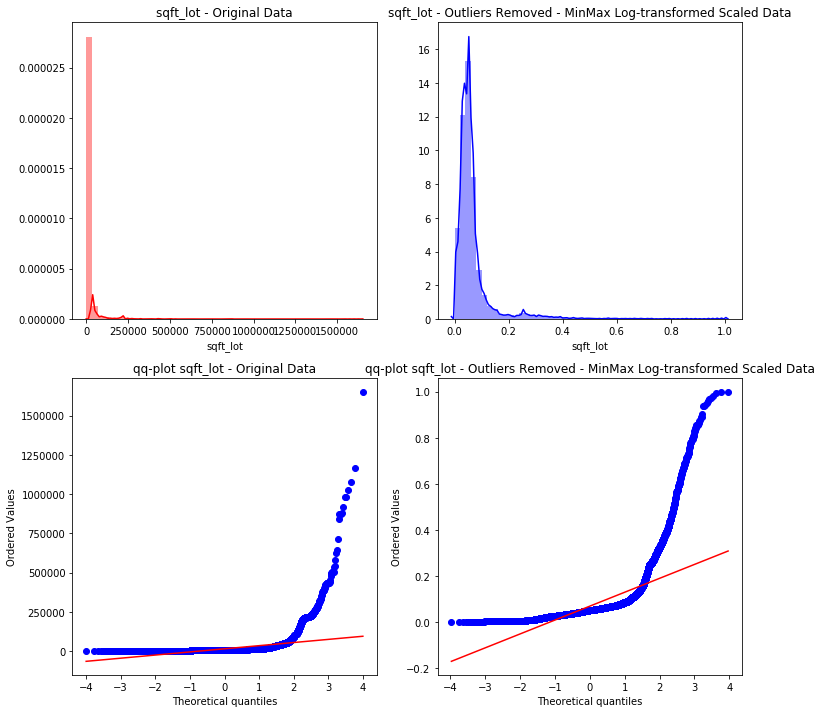

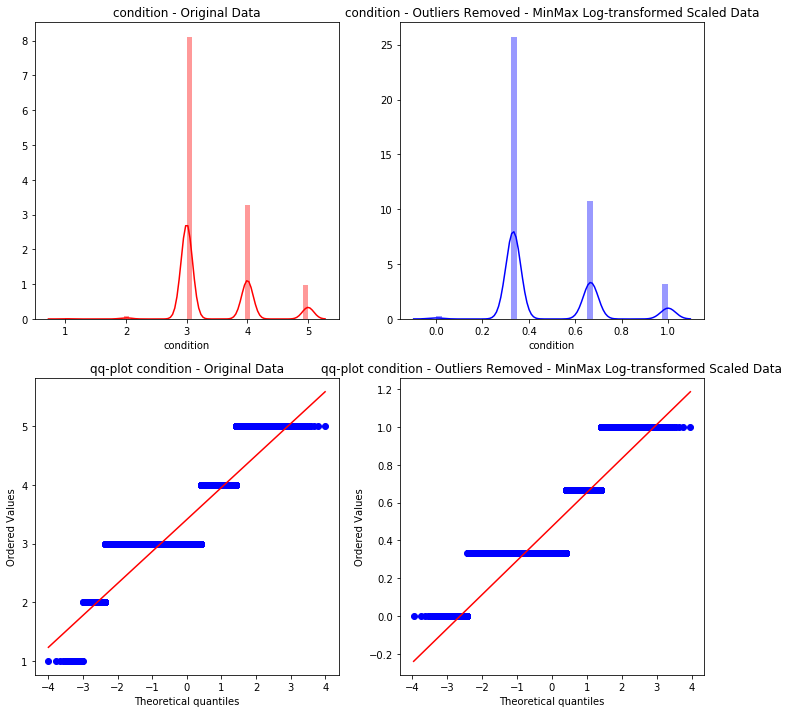

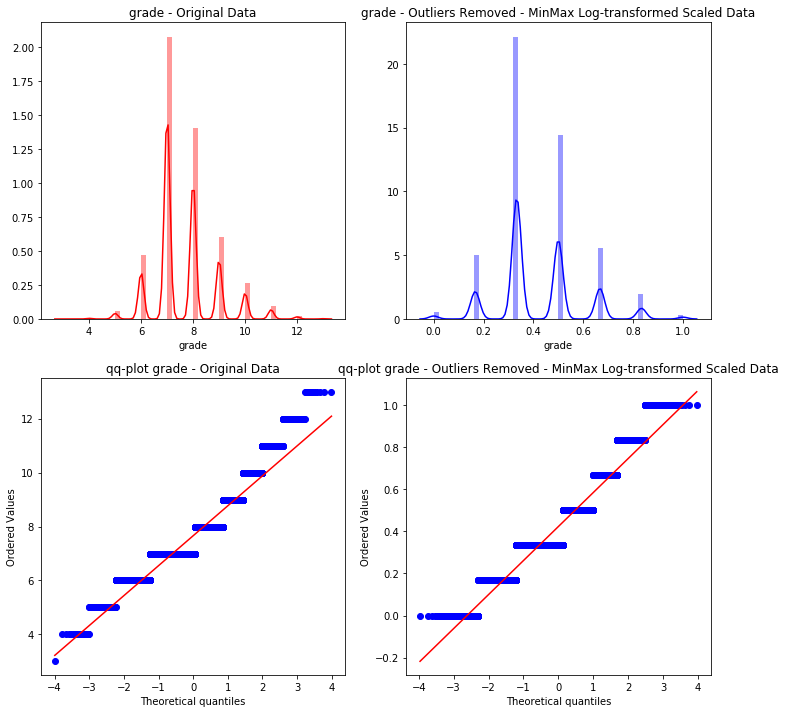

...

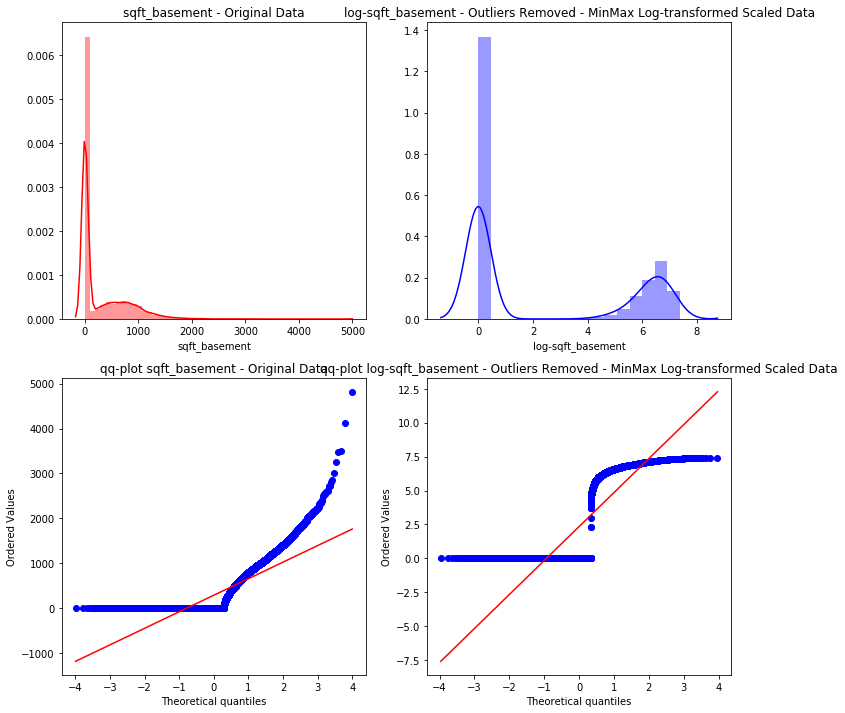

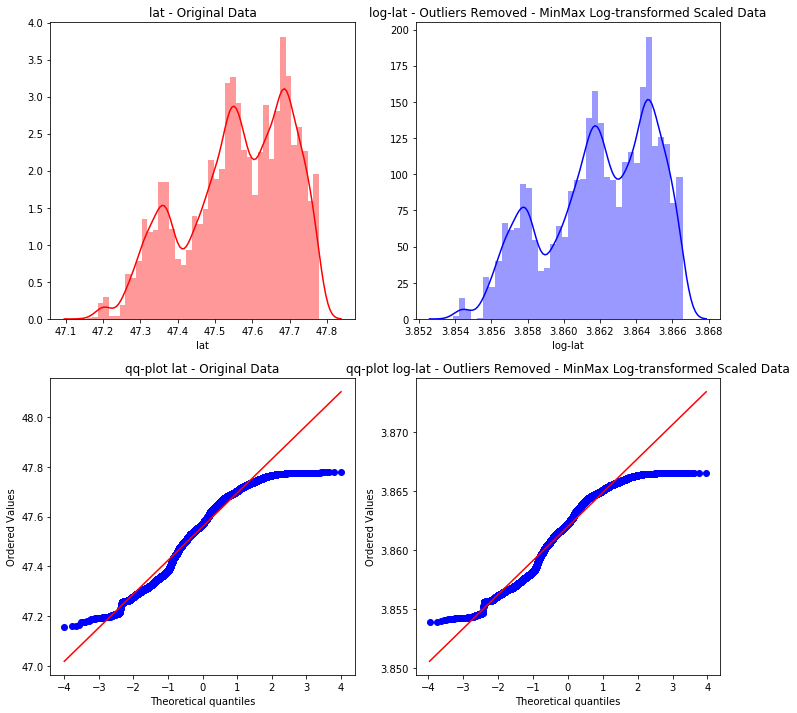

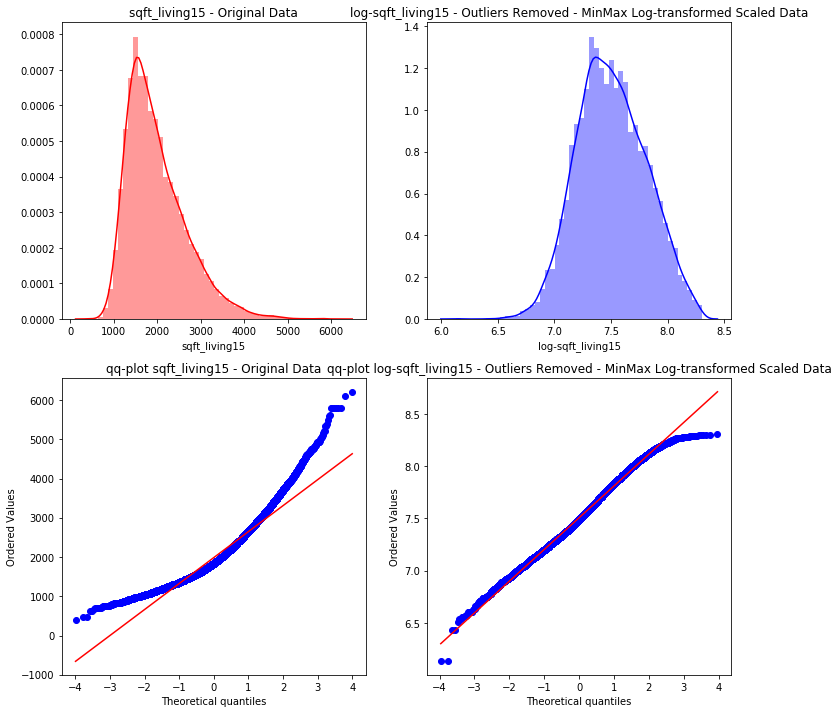

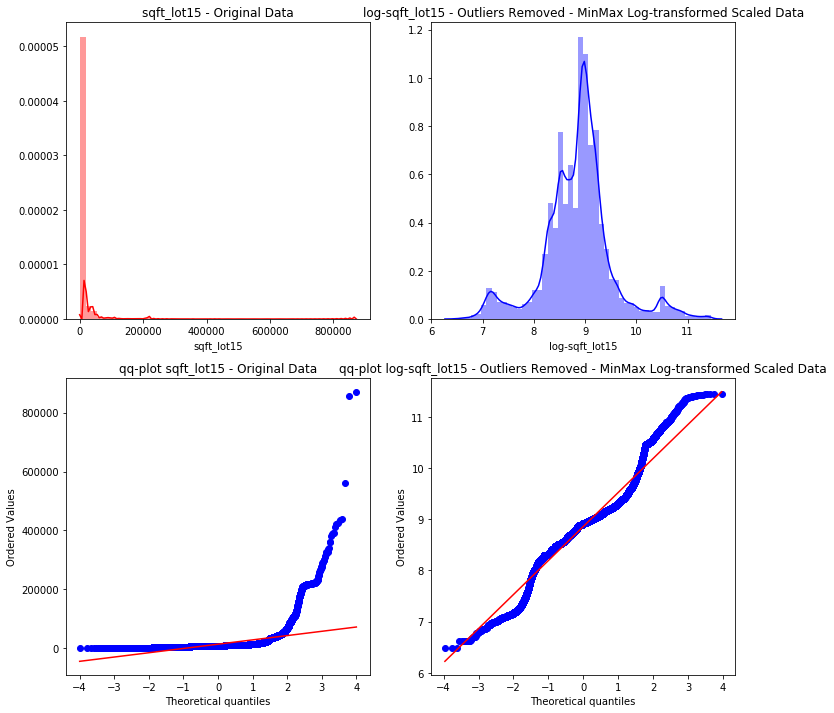

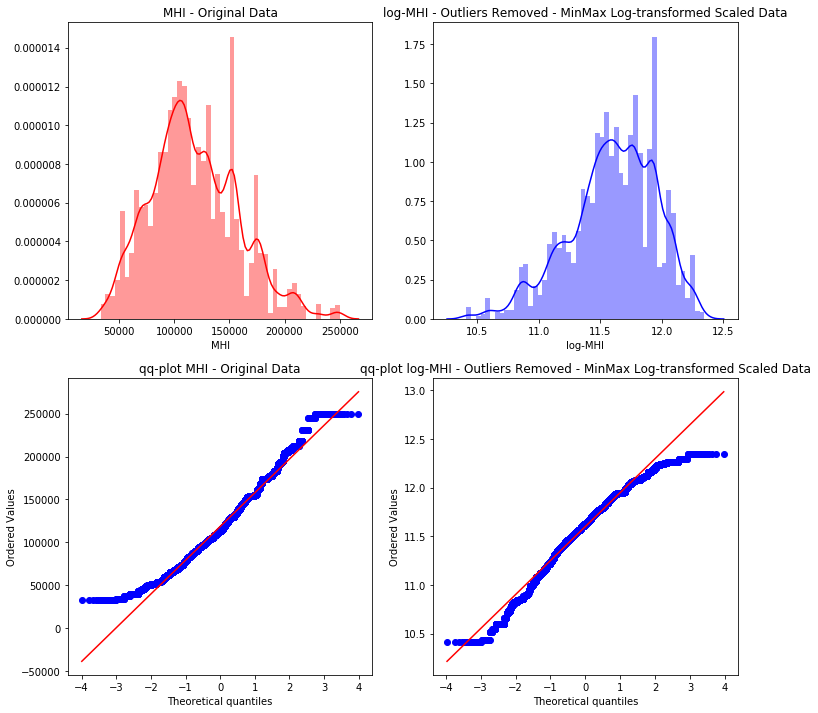

In [188]:
plot_before_after(df, dfMinMax_out, cont, 'Original',
                  'Outliers Removed - MinMax Log-transformed Scaled')

##### Normalising with RobustScaler

In [189]:
dfRobScal_out = dflog_out.copy()

In [190]:
scaler = RobustScaler()
dfRobScal_out[cont] = scaler.fit_transform(dfRobScal_out[cont])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


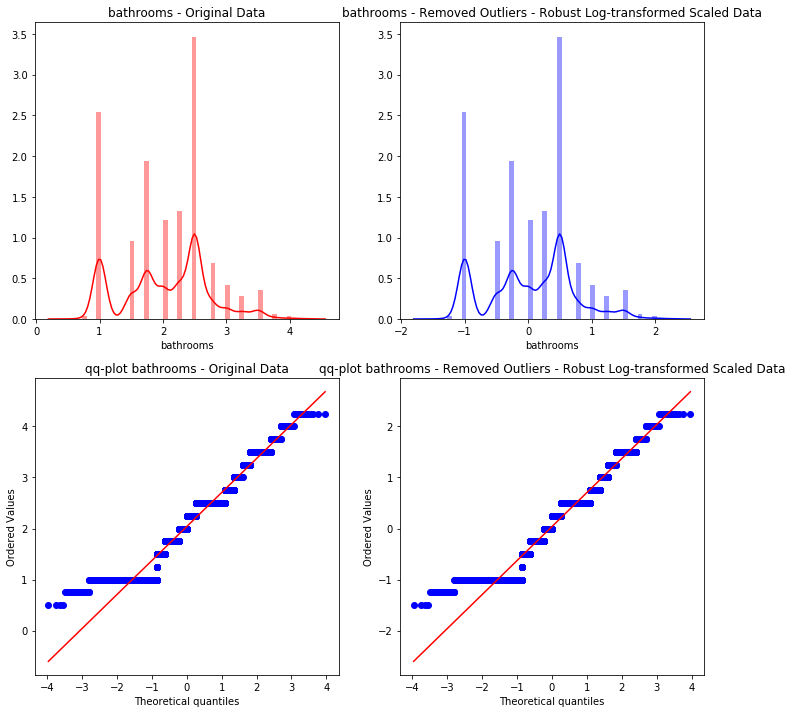

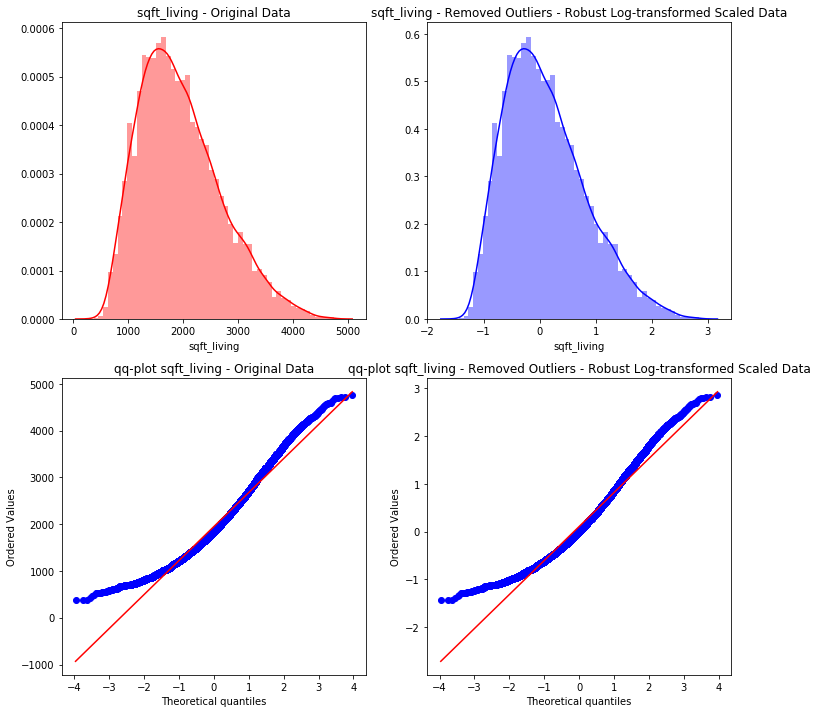

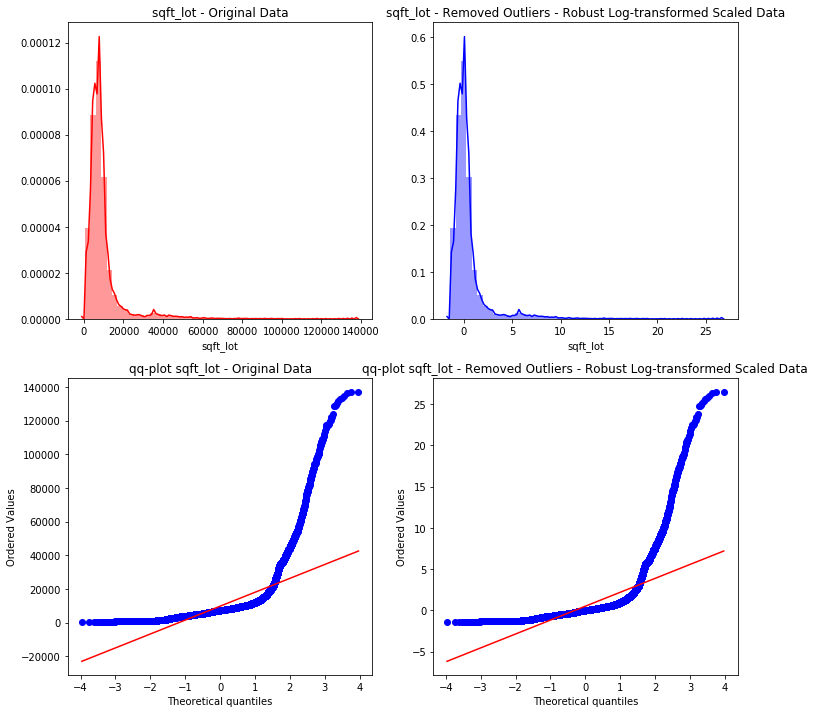

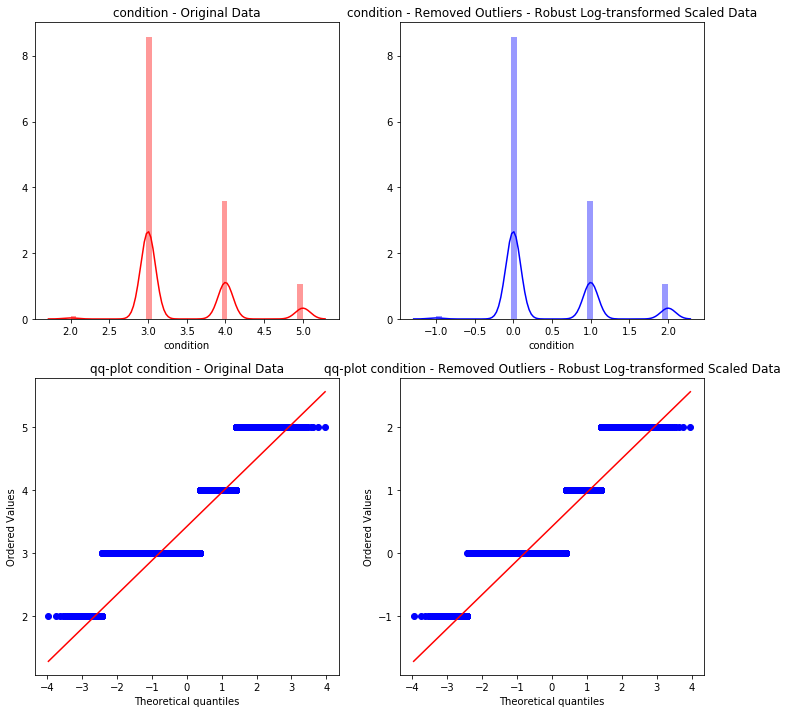

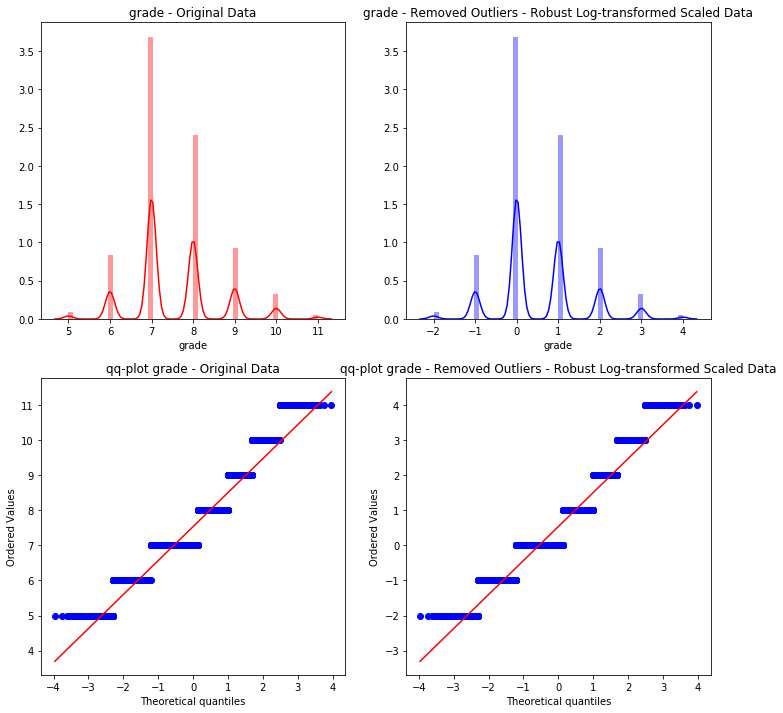

...

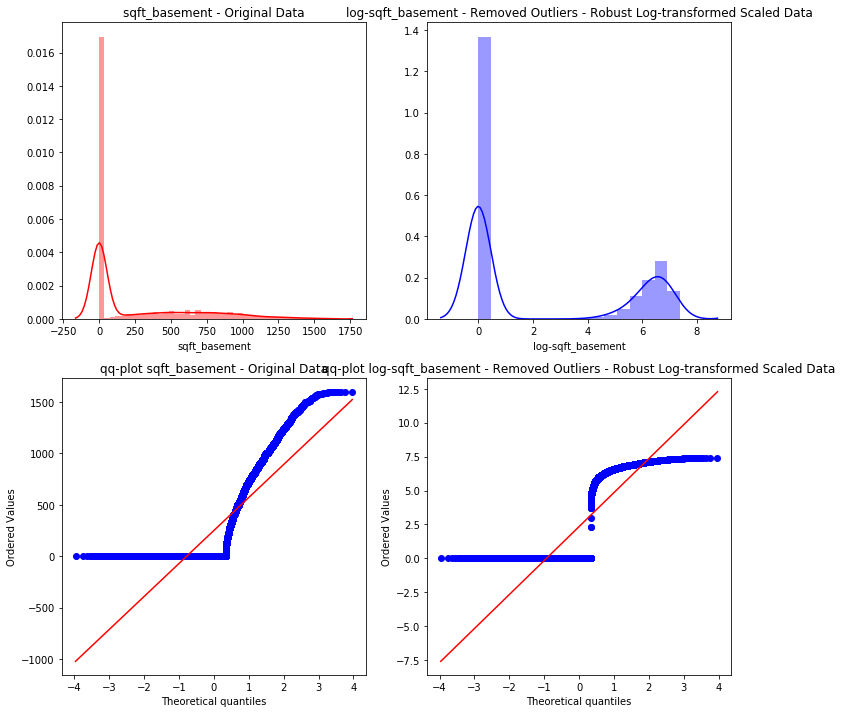

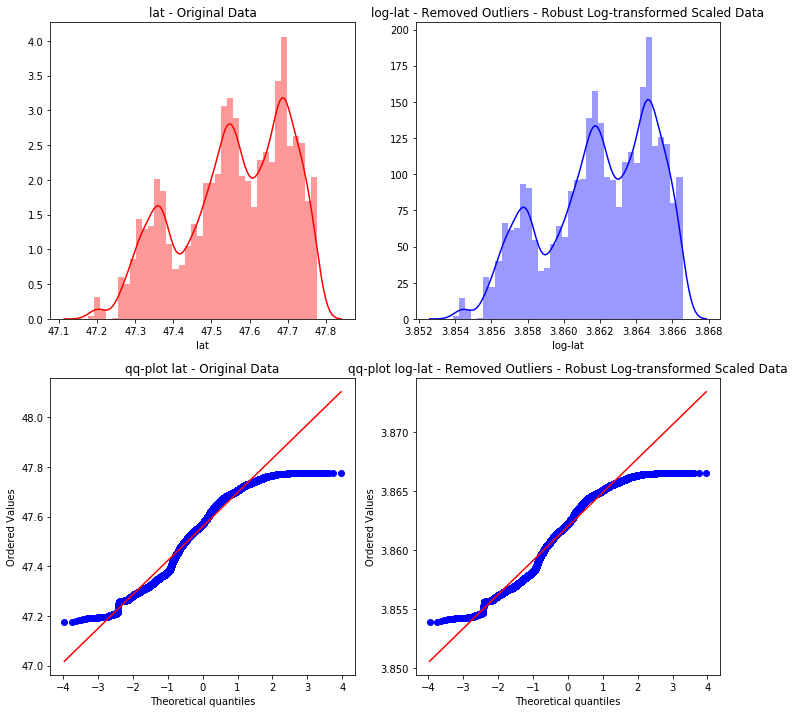

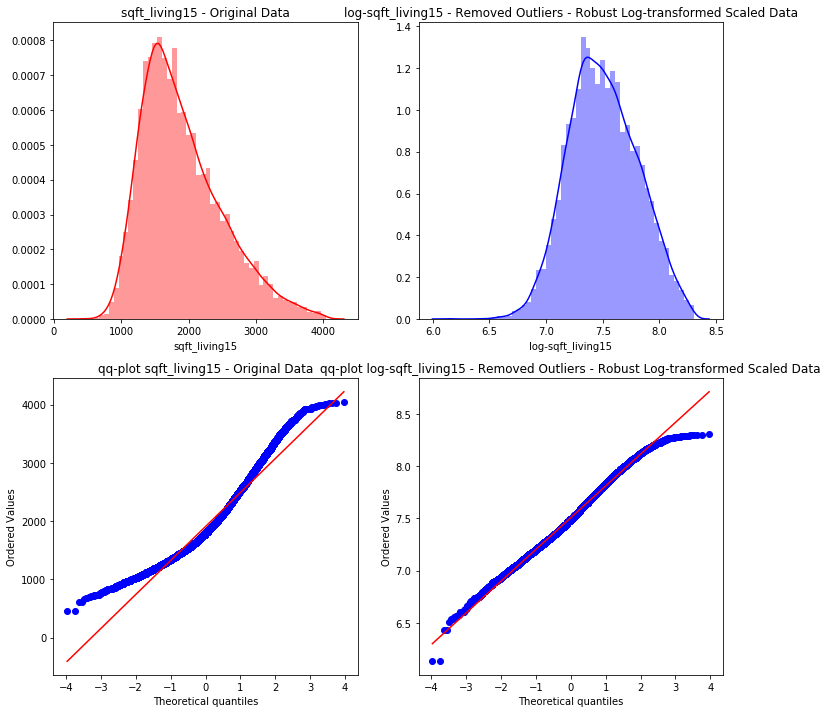

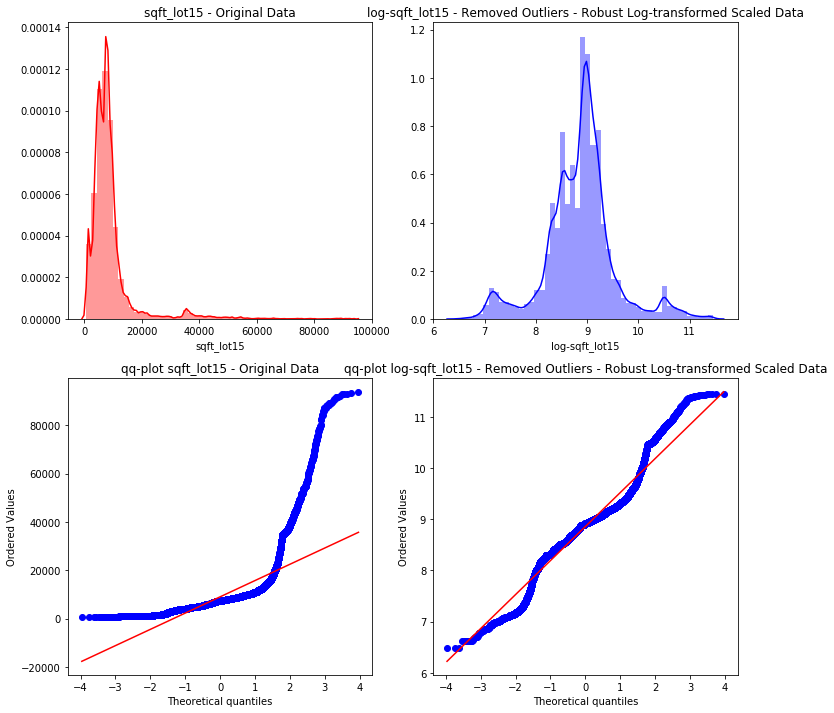

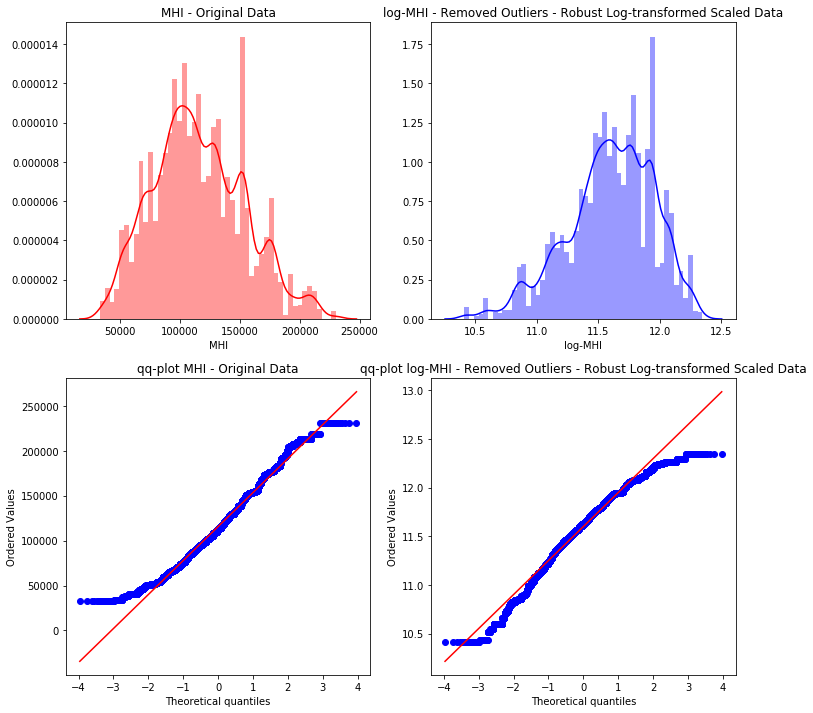

In [191]:
plot_before_after(new_df, dfRobScal_out, cont, 'Original',
                  'Removed Outliers - Robust Log-transformed Scaled')

#### Dataset with category levels threshold < 6

##### Normalising with MinMaxScaler

In [192]:
dfMinMax6_out = dflog6_out.copy()

In [193]:
scaler = MinMaxScaler()
dfMinMax6_out[cont6] = scaler.fit_transform(dfMinMax6_out[cont6])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


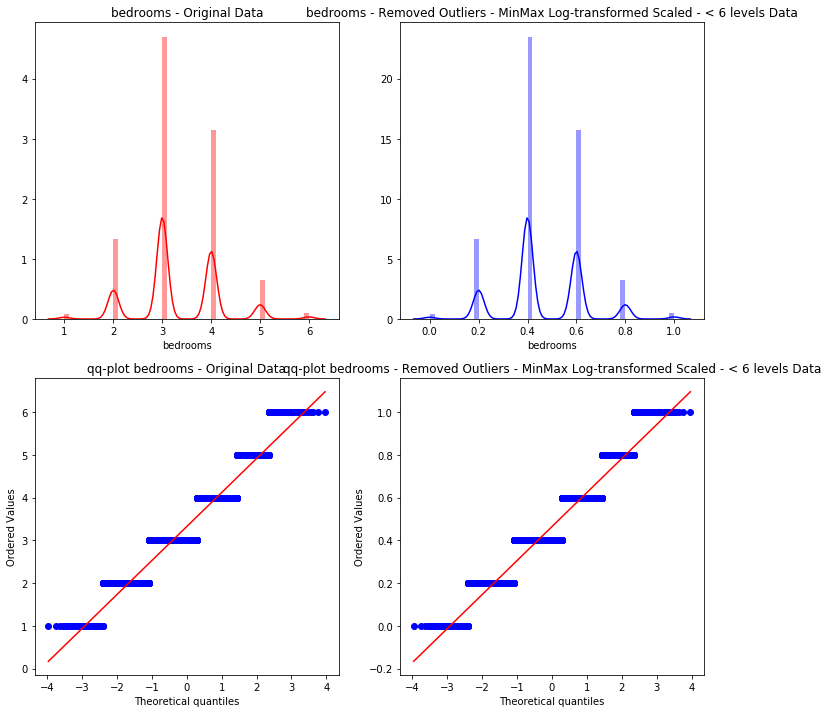

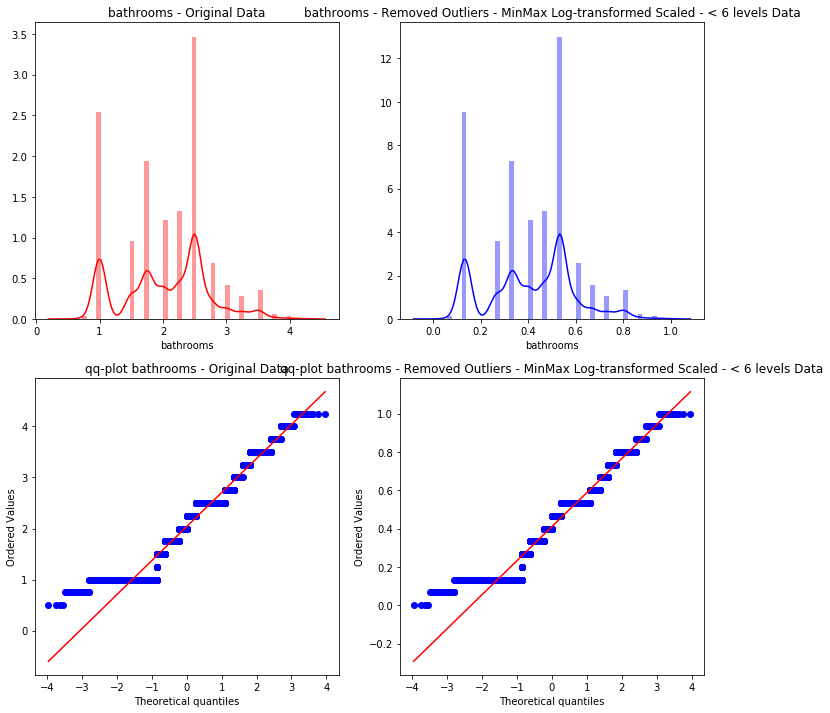

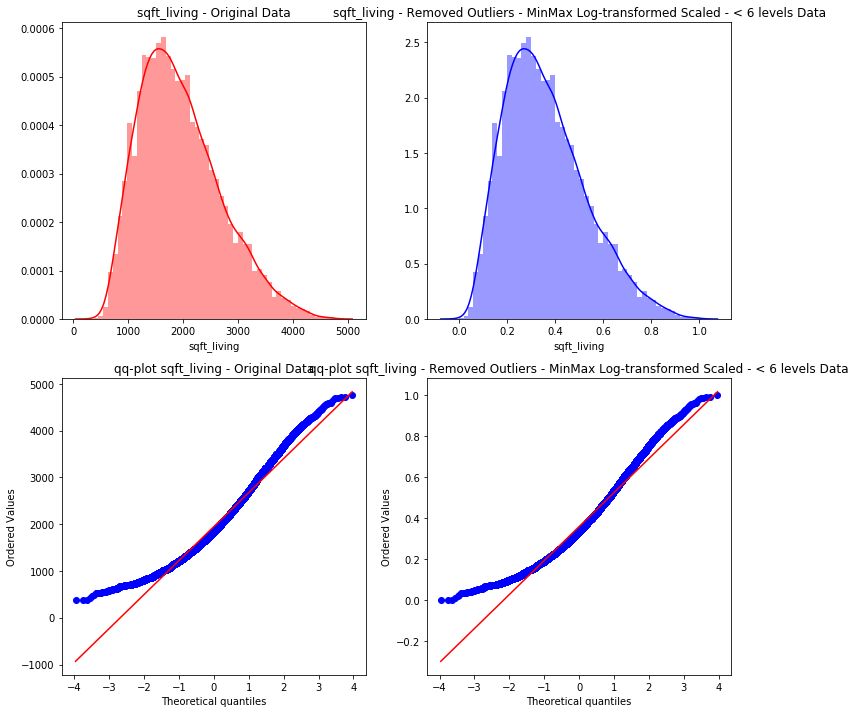

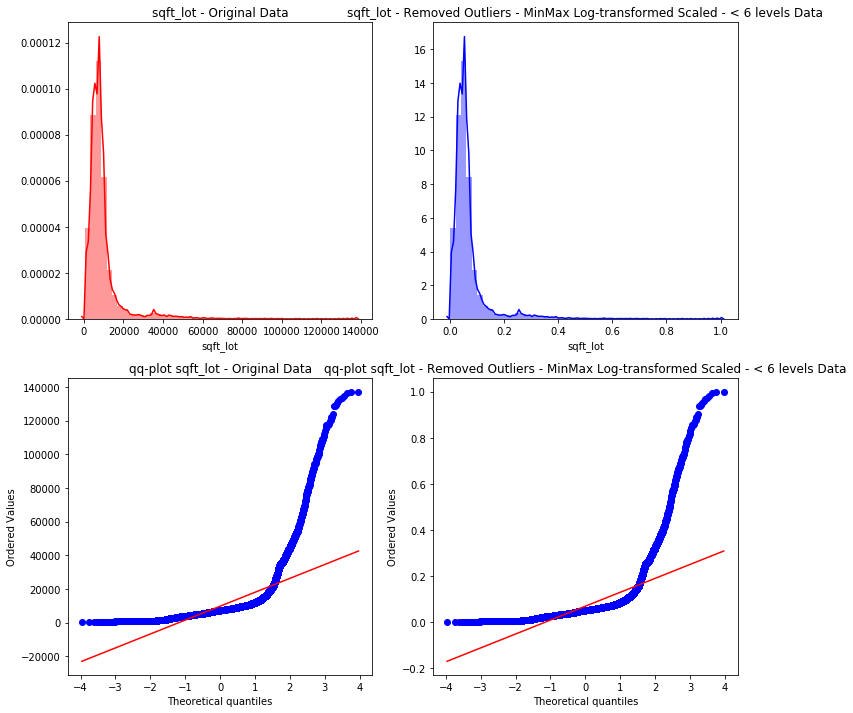

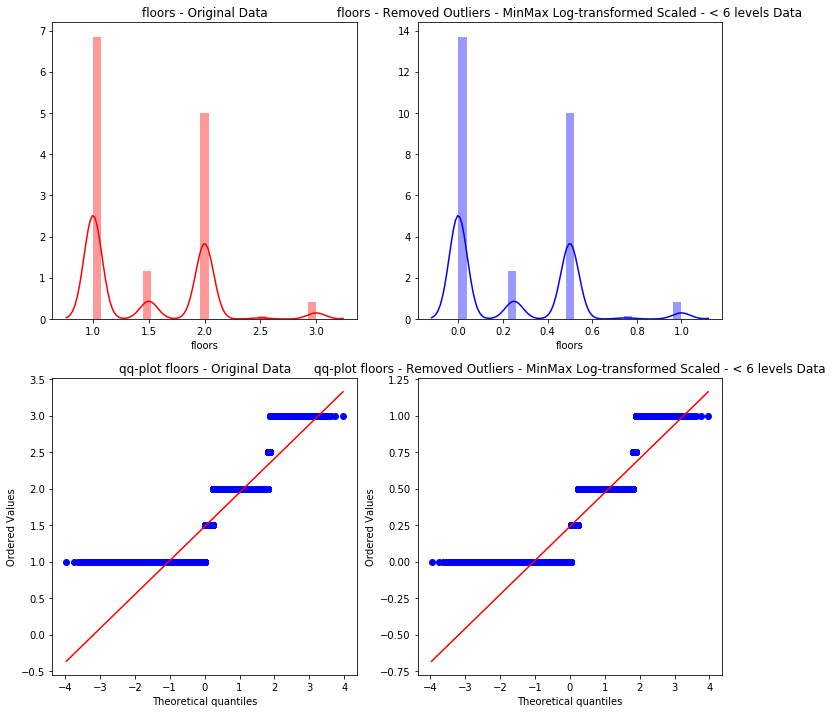

...

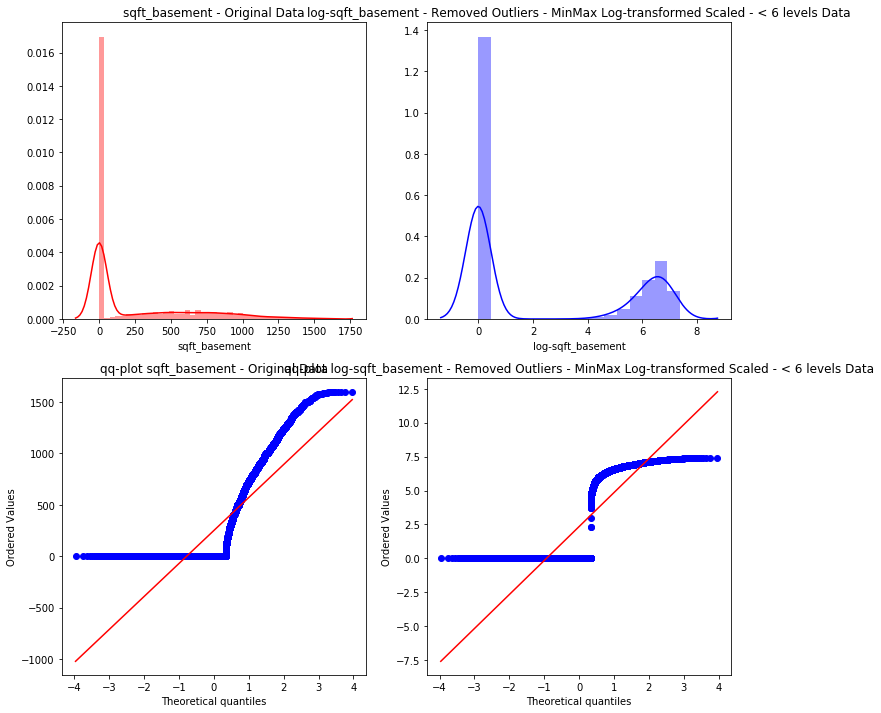

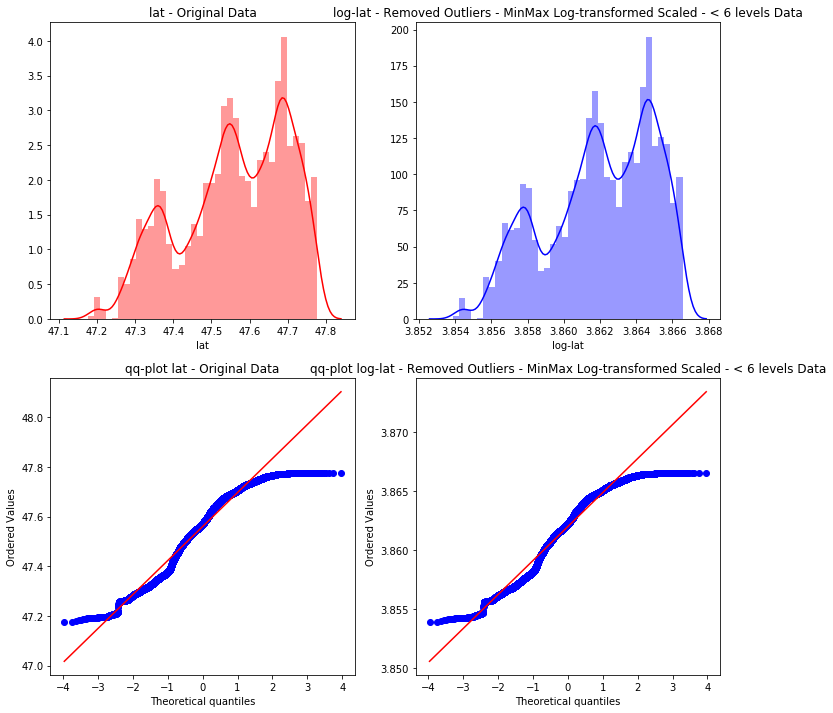

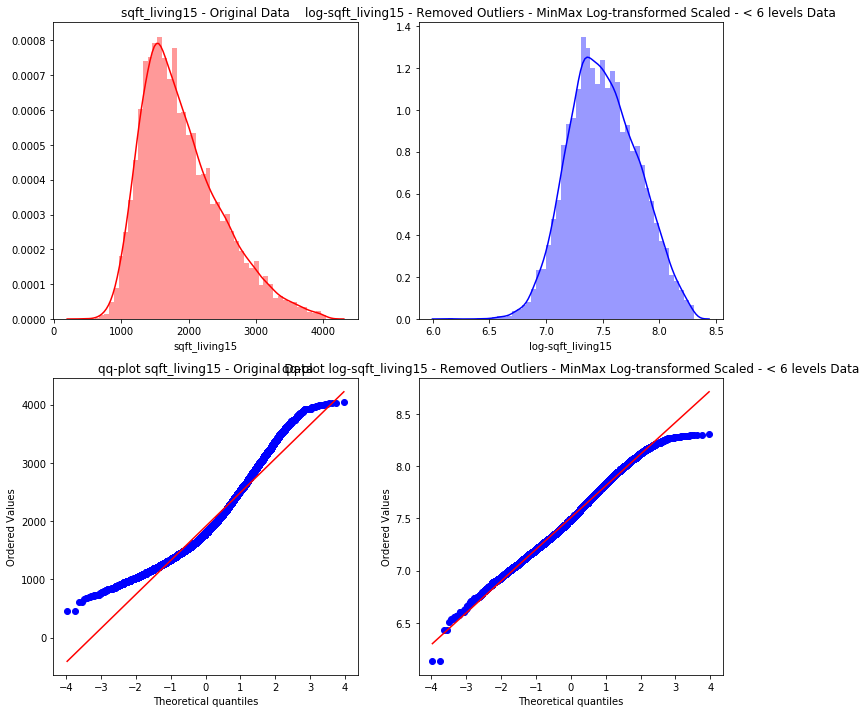

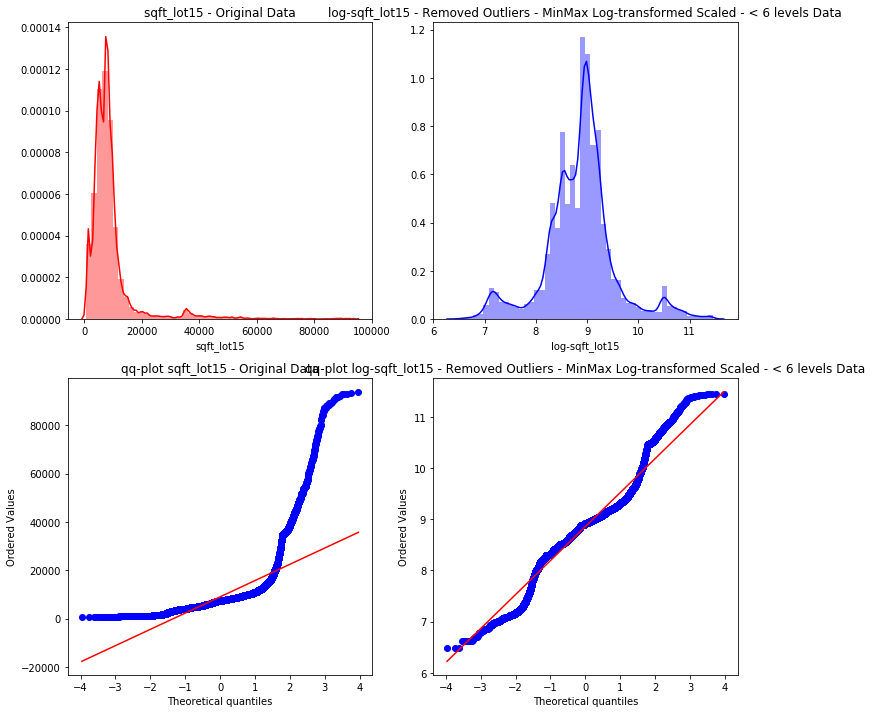

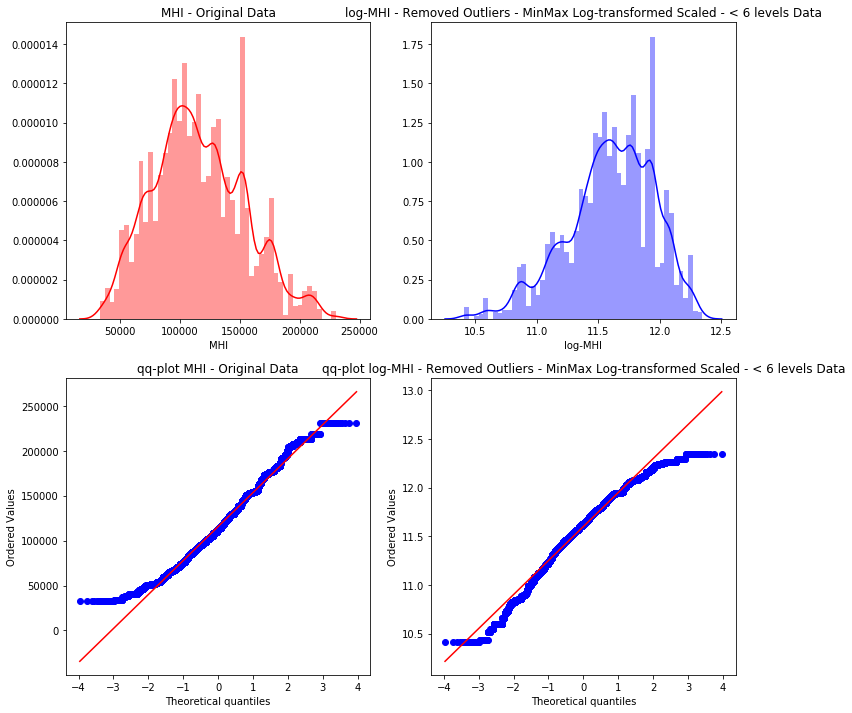

In [195]:
plot_before_after(new_df, dfMinMax6_out, cont6, 'Original',
                  'Removed Outliers - MinMax Log-transformed Scaled - < 6 levels')

##### Normalising with RobustScaler

In [196]:
dfRobScal6_out = dflog6_out.copy()

In [197]:
scaler = RobustScaler()
dfRobScal6_out[cont6] = scaler.fit_transform(dfRobScal6_out[cont6])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


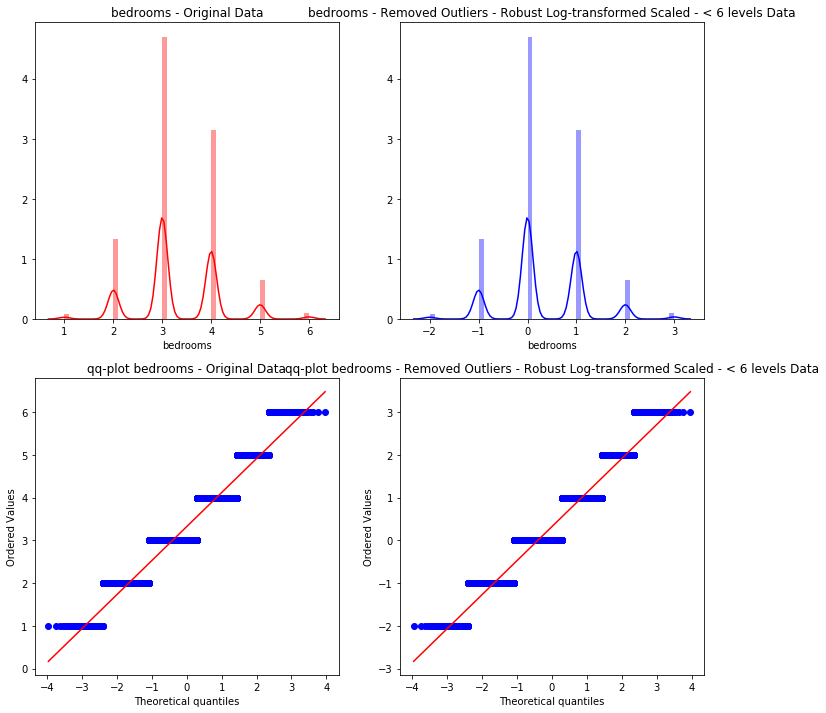

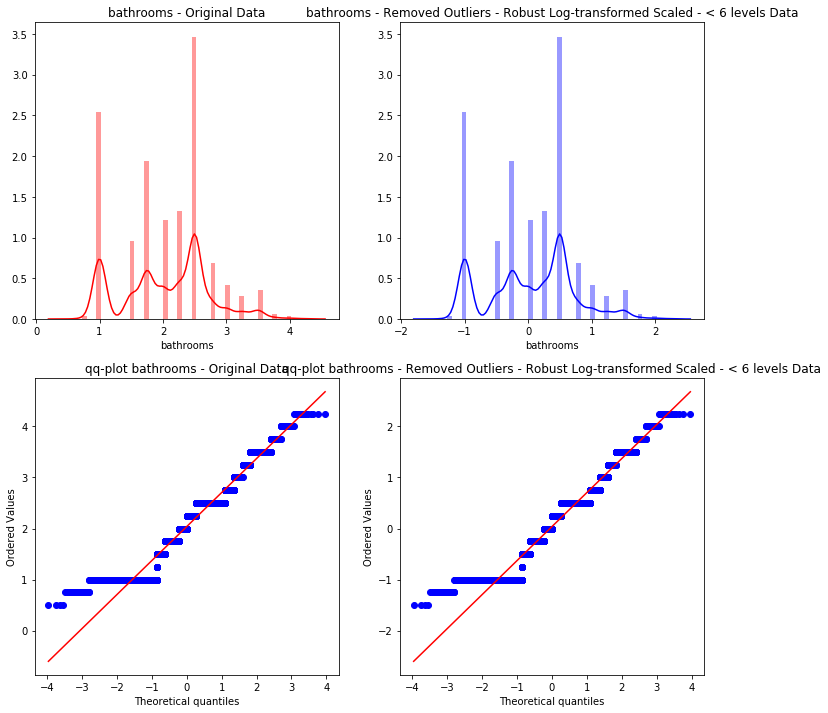

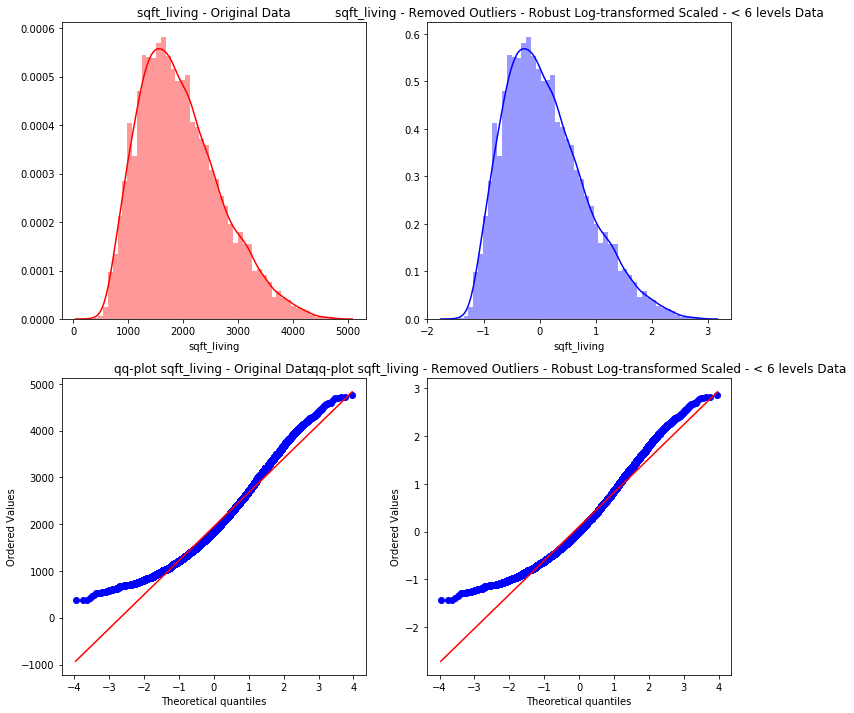

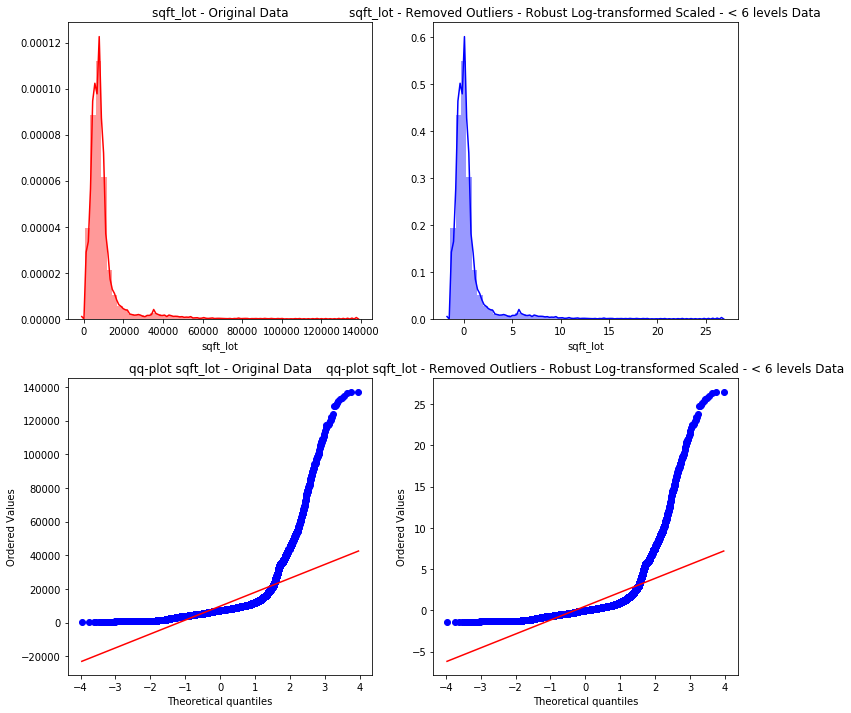

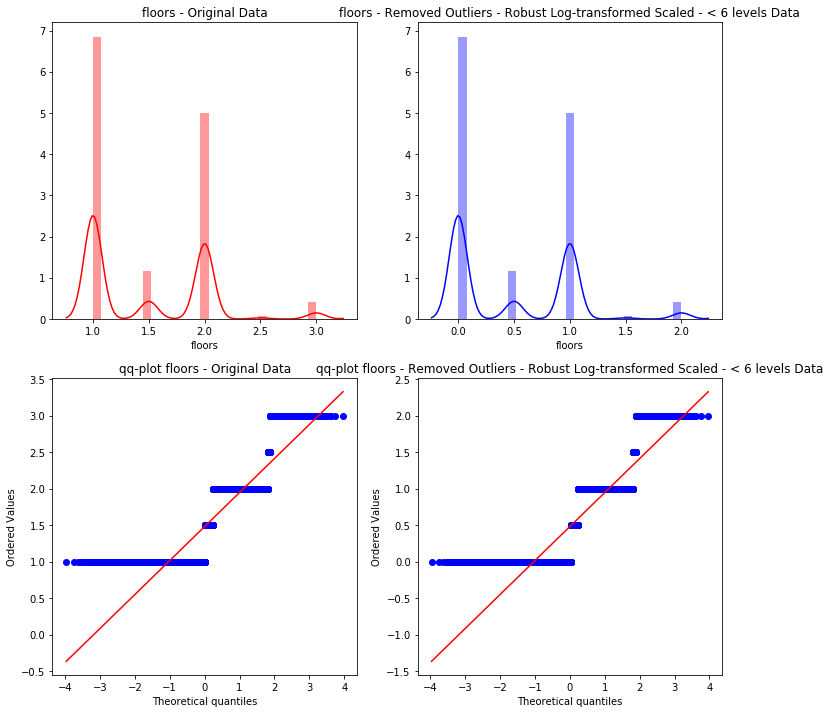

...

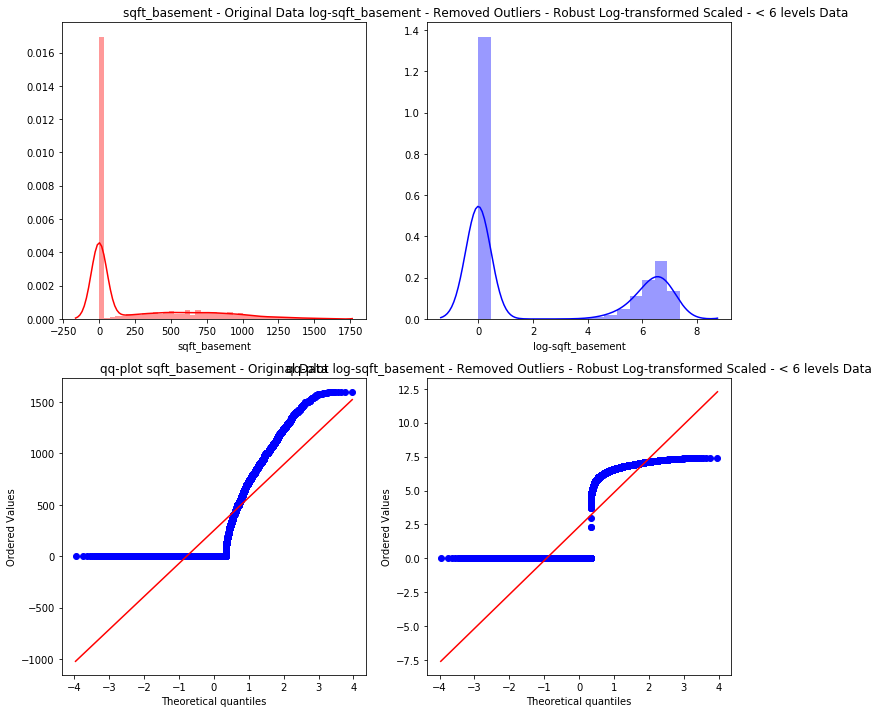

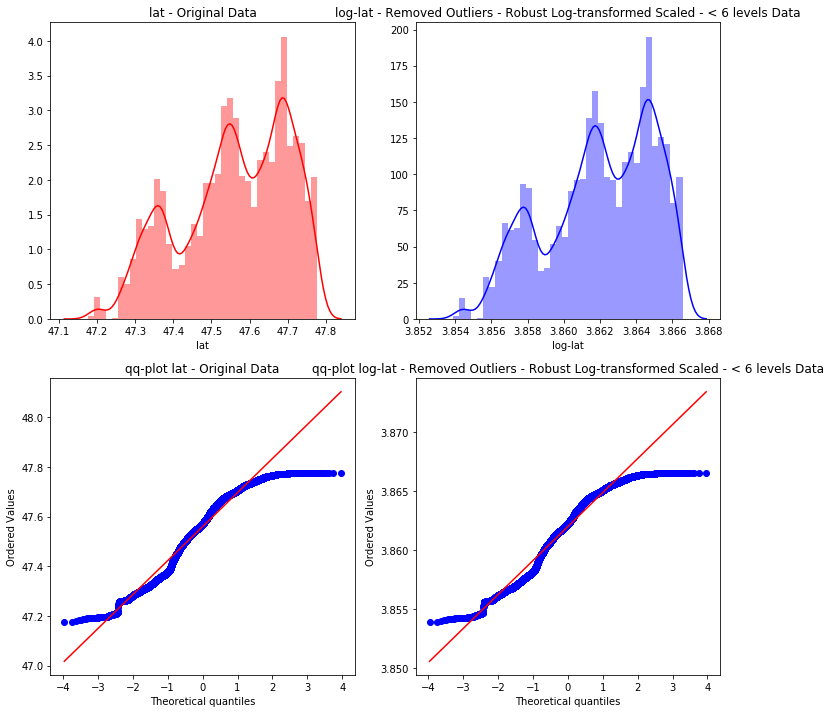

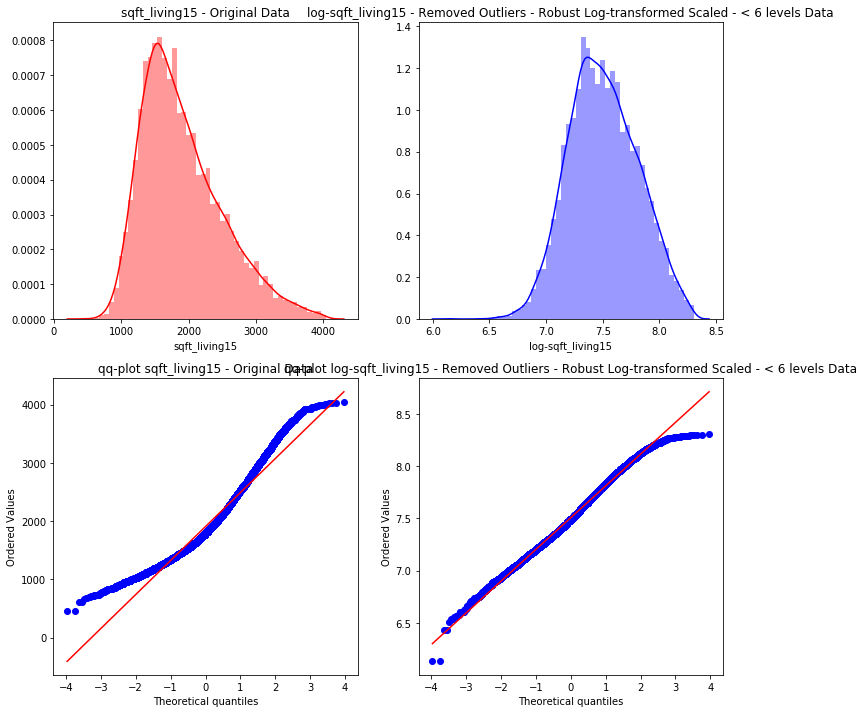

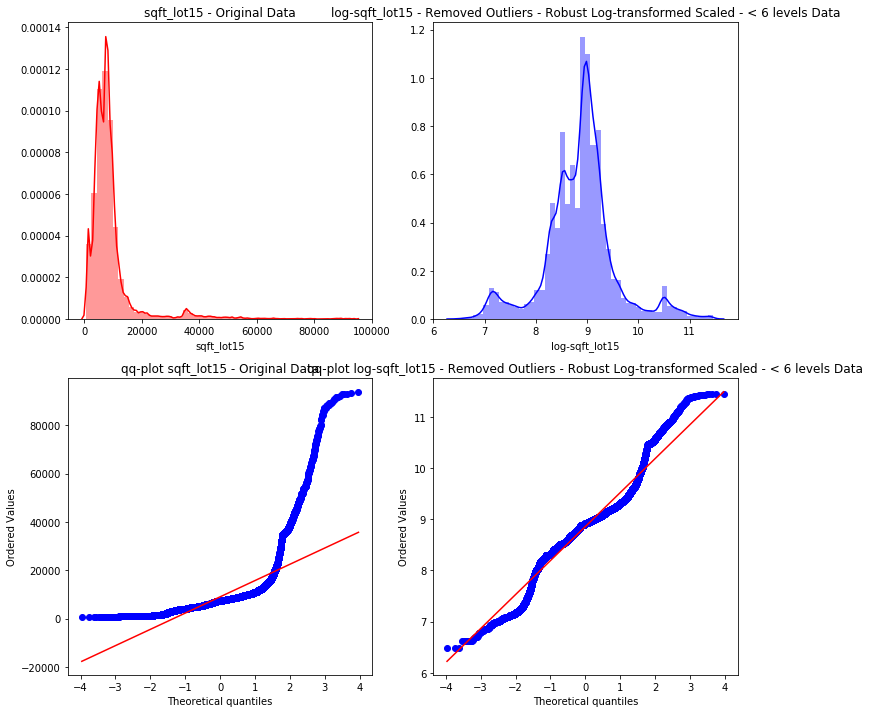

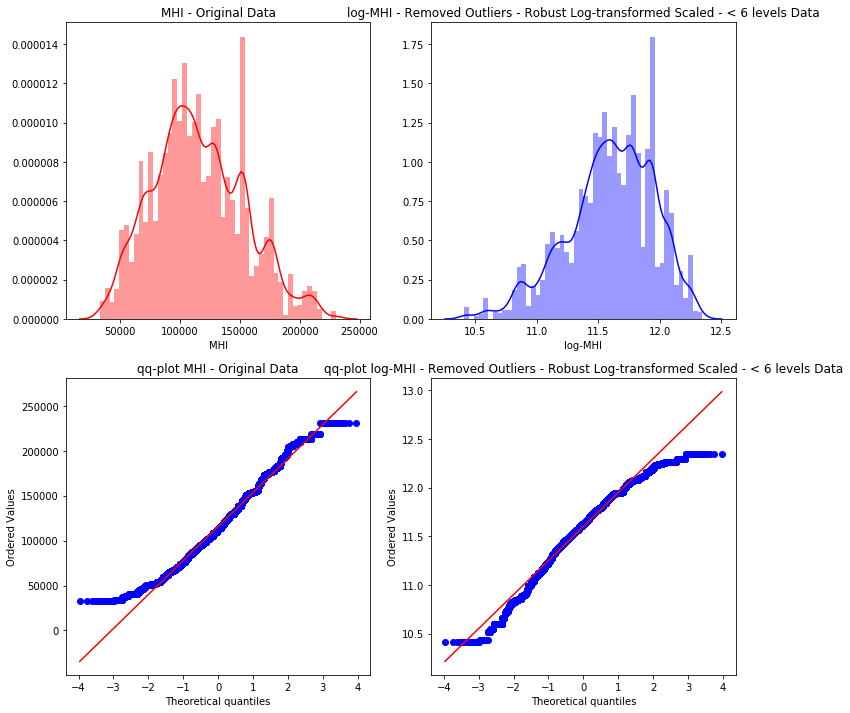

In [198]:
plot_before_after(new_df, dfRobScal6_out, cont6, 'Original',
                  'Removed Outliers - Robust Log-transformed Scaled - < 6 levels')

#### Export scaled datasets to csv

In [199]:
dfMinMax_out.to_csv(os.path.join(
    path, r'logtransformed_minmax_nooutliers.csv'), index=False)

In [200]:
dfRobScal_out.to_csv(os.path.join(
    path, r'logtransformed_robscal_nooutliers.csv'), index=False)

In [201]:
dfMinMax6_out.to_csv(os.path.join(
    path, r'logtransformed_minmax6_nooutliers.csv'), index=False)

In [202]:
dfRobScal6_out.to_csv(os.path.join(
    path, r'logtransformed_robscal6_nooutliers.csv'))

#### Standardisation

Recall that you standardise a dataset by converting each numeric value to it's corresponding z-score for the column, which is obtained by subtracting the column's mean and then dividing by the column's standard deviation for every value.

##### Standardisation dataset with category levels threshold < 29

In [203]:
dfStd_out = dflog_out.copy()

In [204]:
standardiser = StandardScaler()
dfStd_out[cont] = standardiser.fit_transform(dflog_out[cont])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


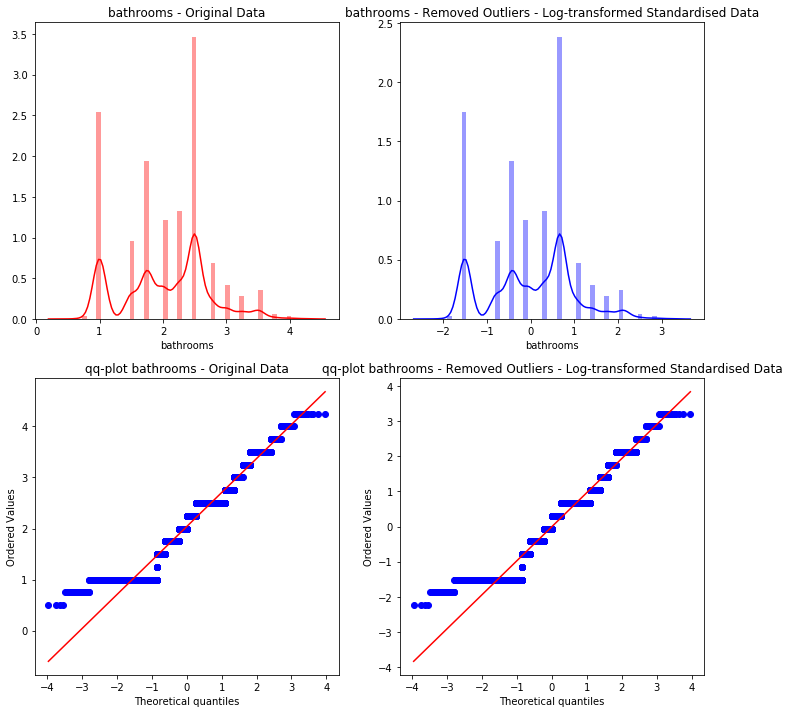

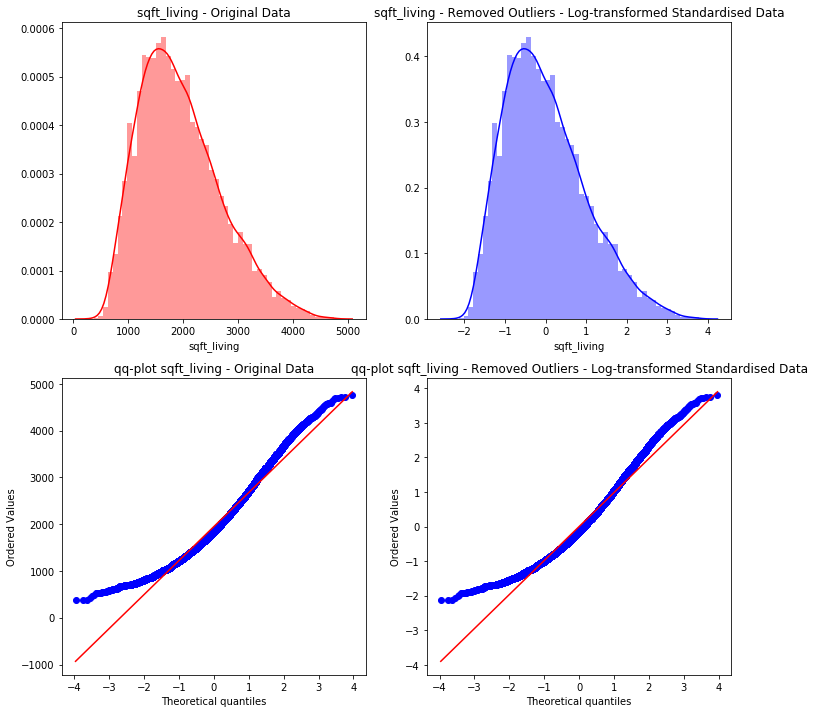

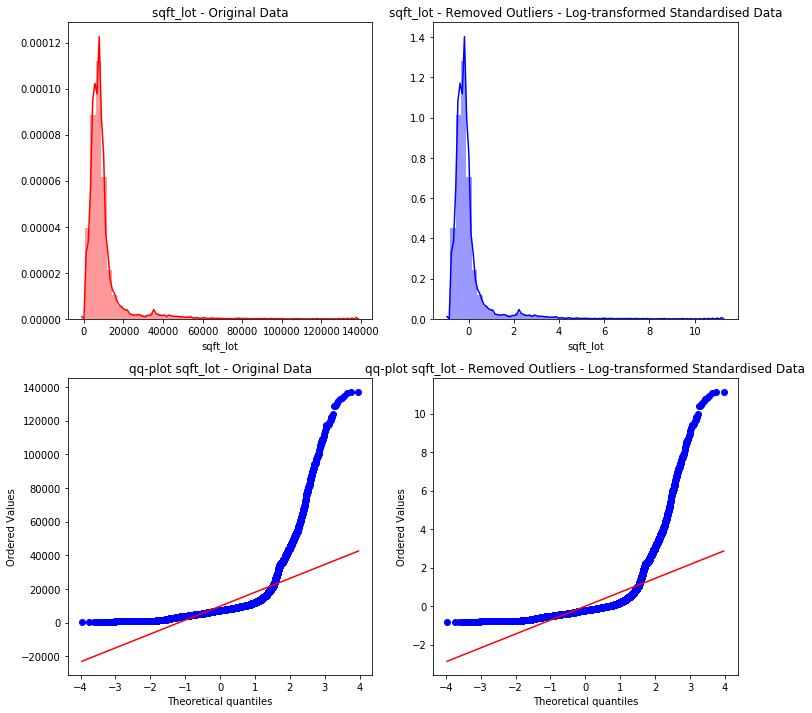

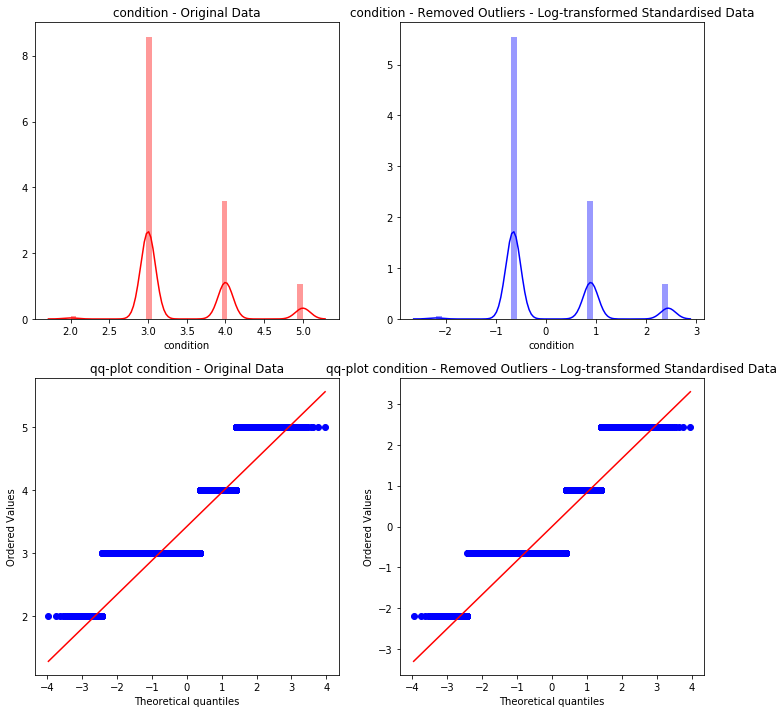

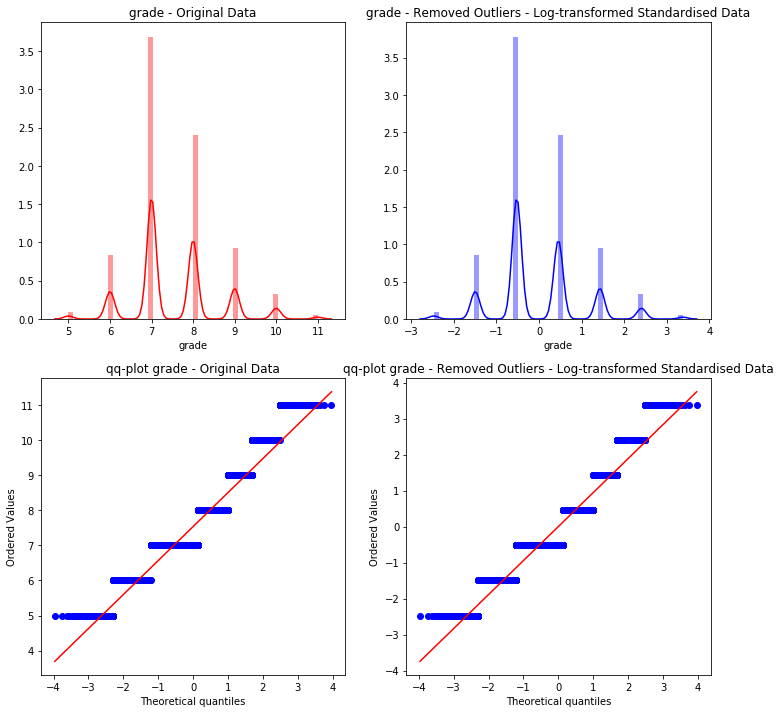

...

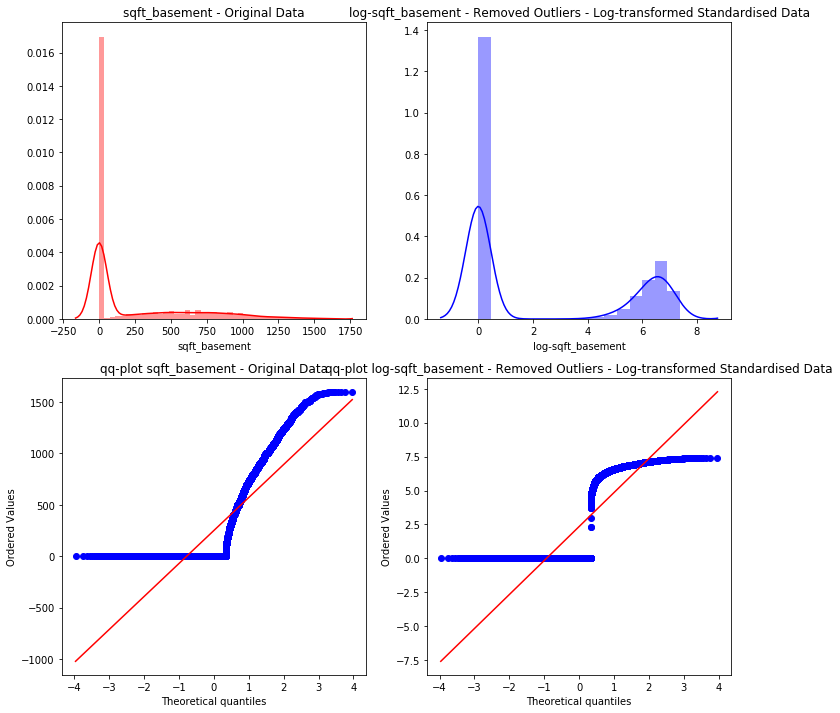

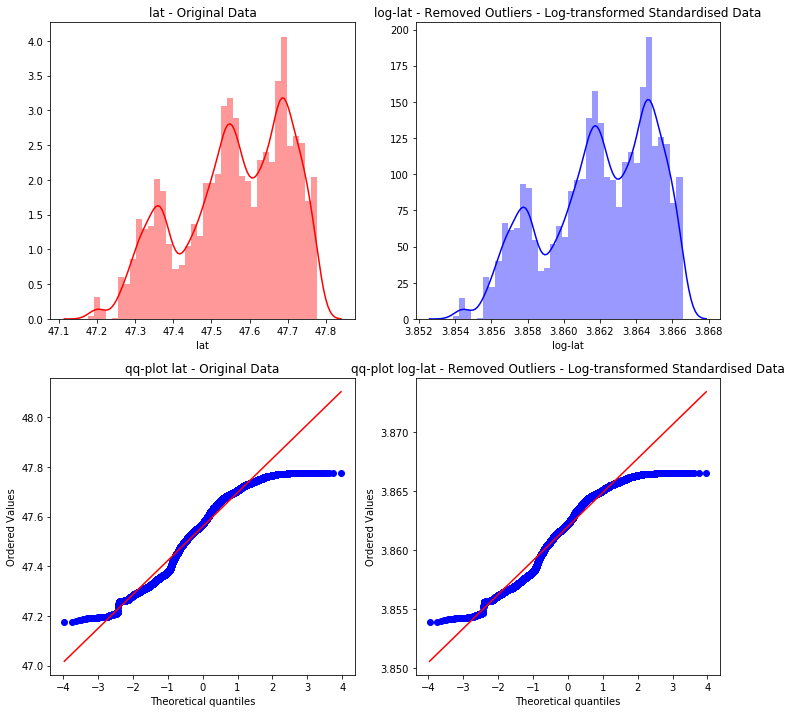

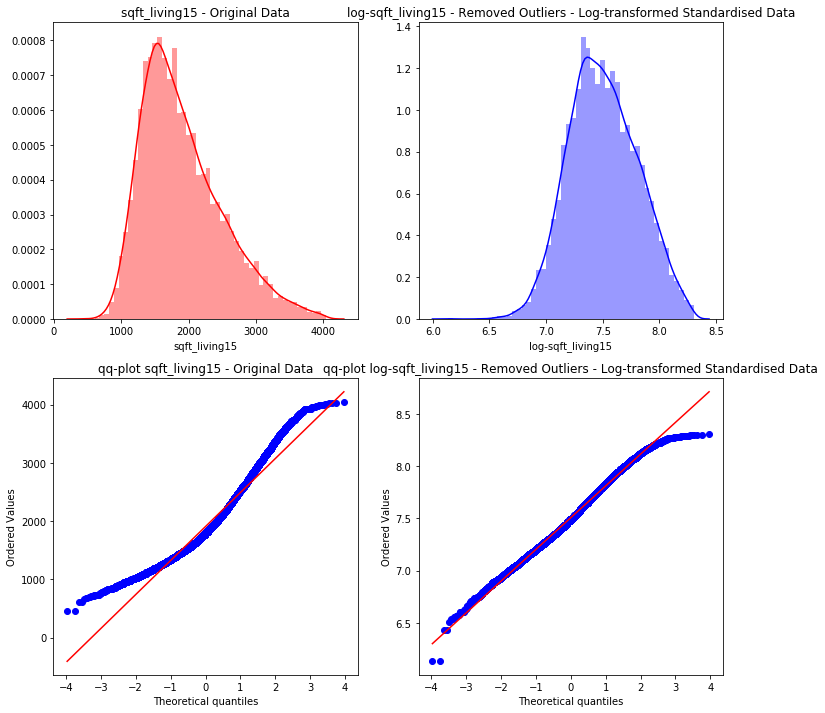

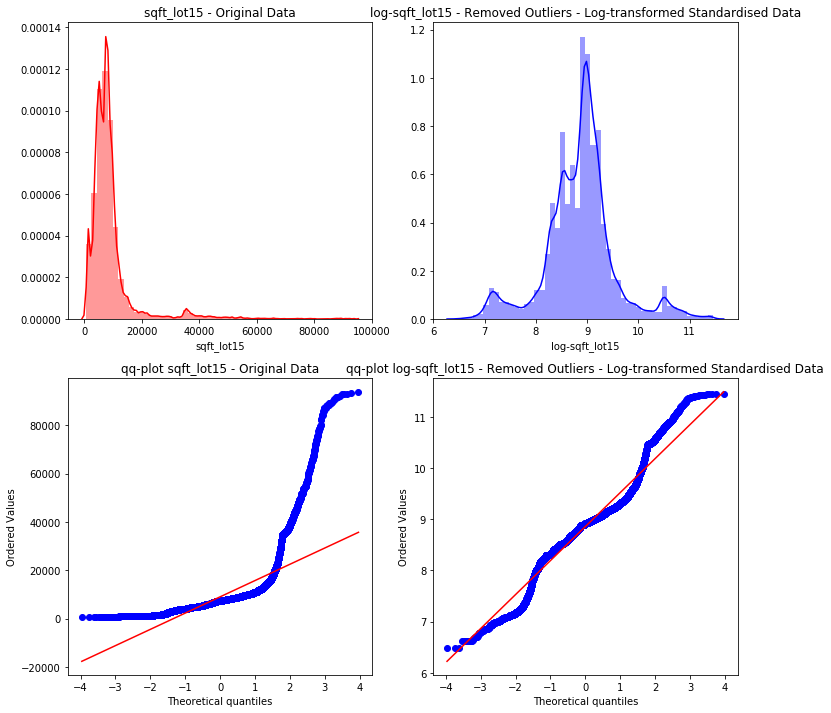

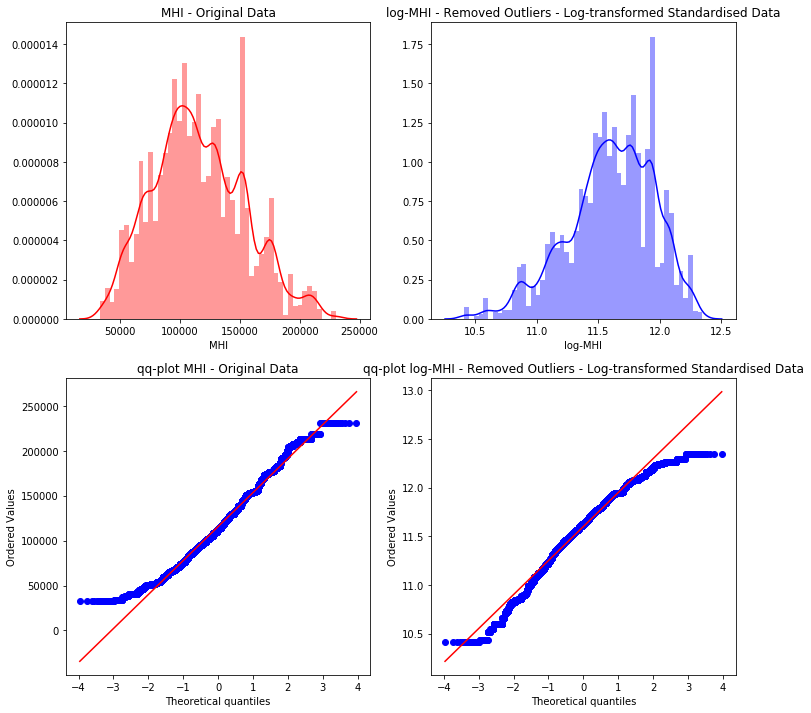

In [205]:
plot_before_after(new_df, dfStd_out, cont, 'Original',
                  'Removed Outliers - Log-transformed Standardised')

##### Standardisation dataset with category levels threshold < 6

In [206]:
dfStd6_out = dflog_out.copy()

In [207]:
standardiser = StandardScaler()
dfStd6_out[cont6] = standardiser.fit_transform(dflog_out[cont6])

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


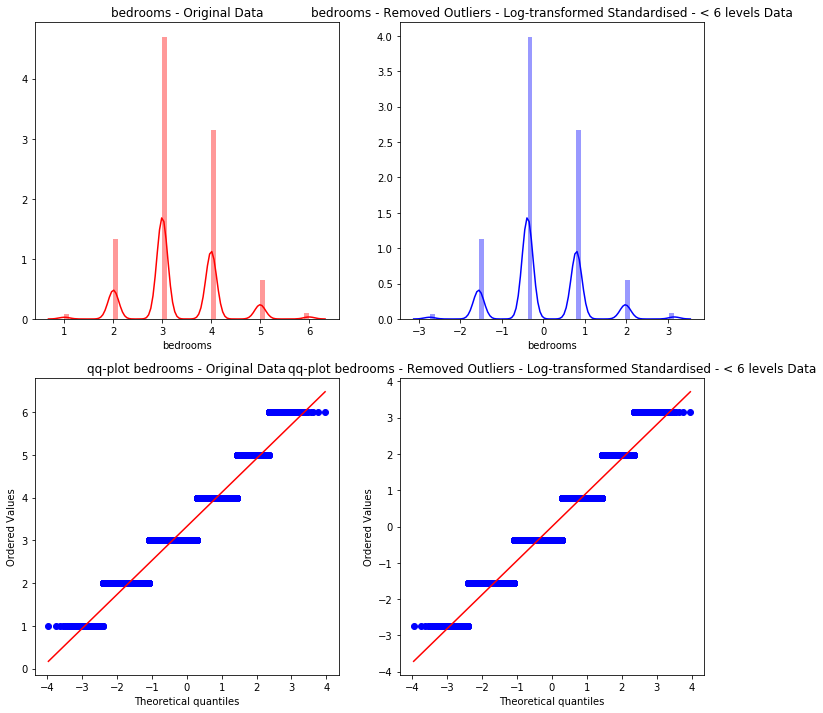

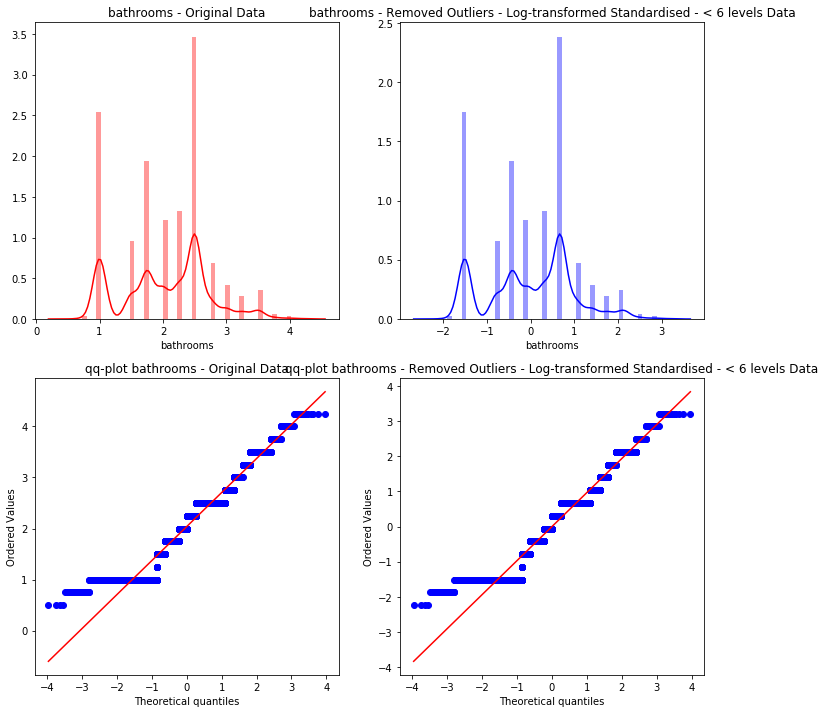

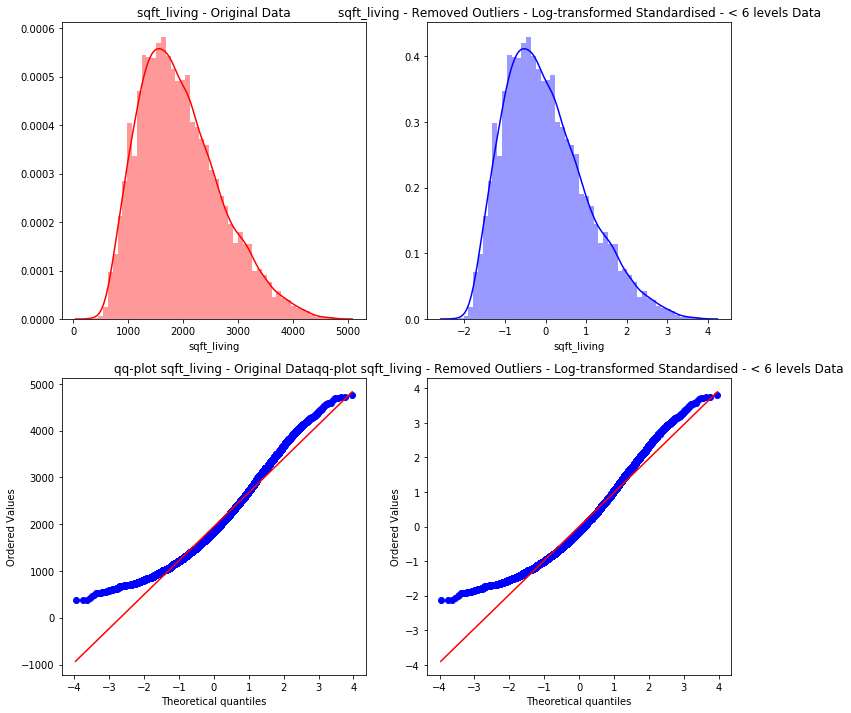

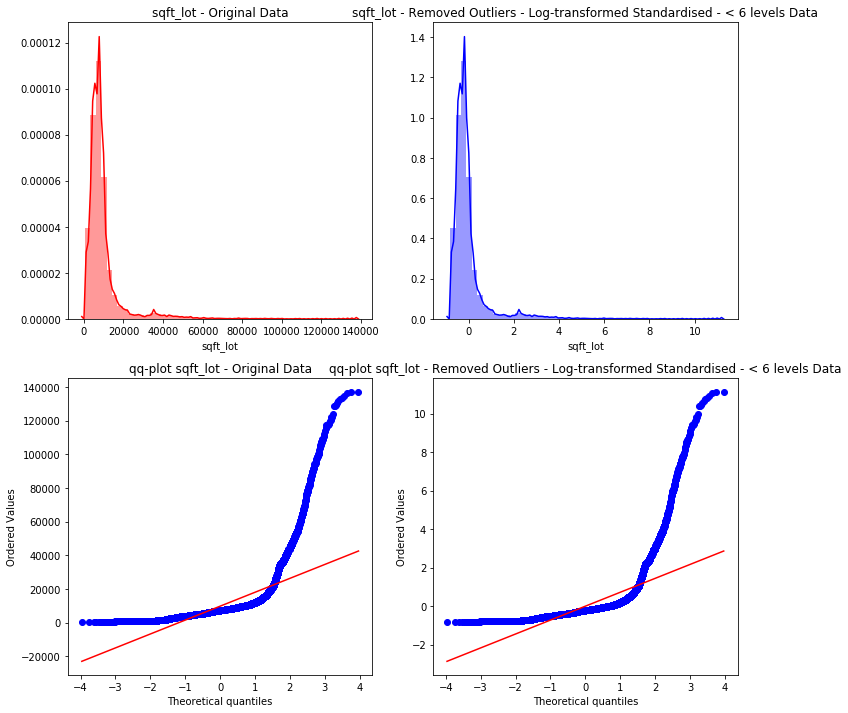

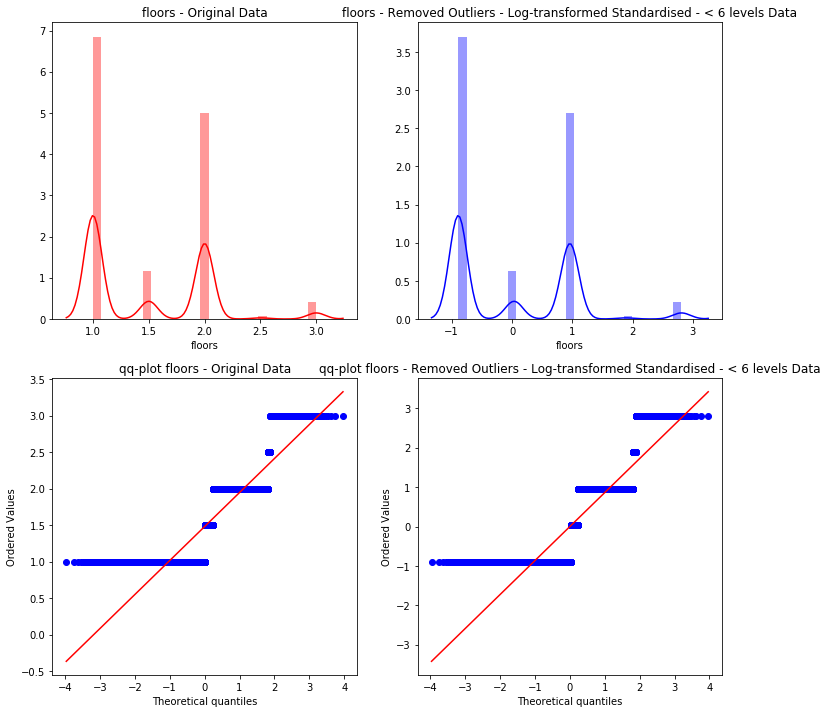

...

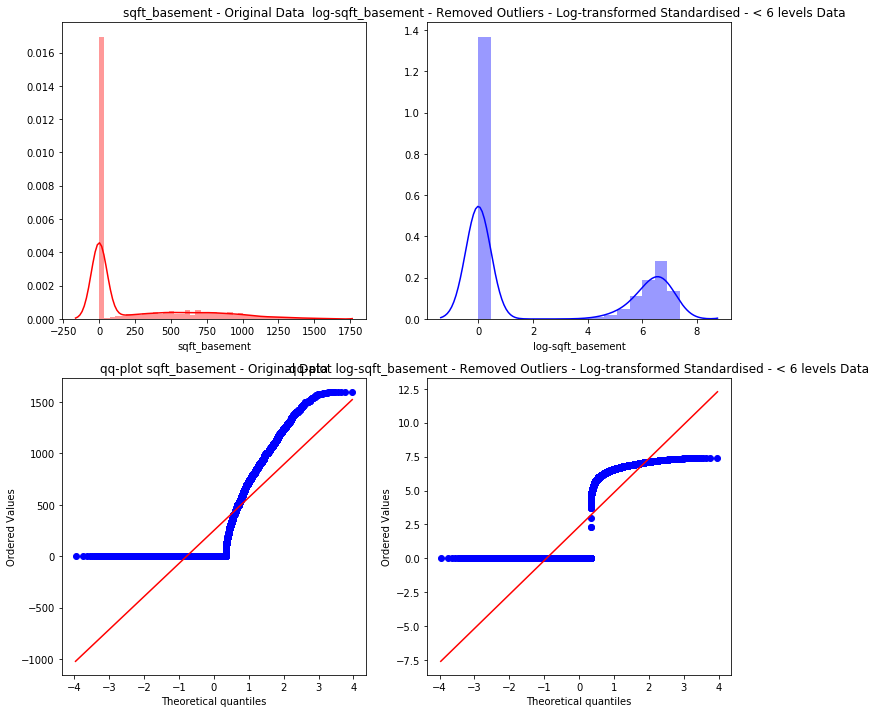

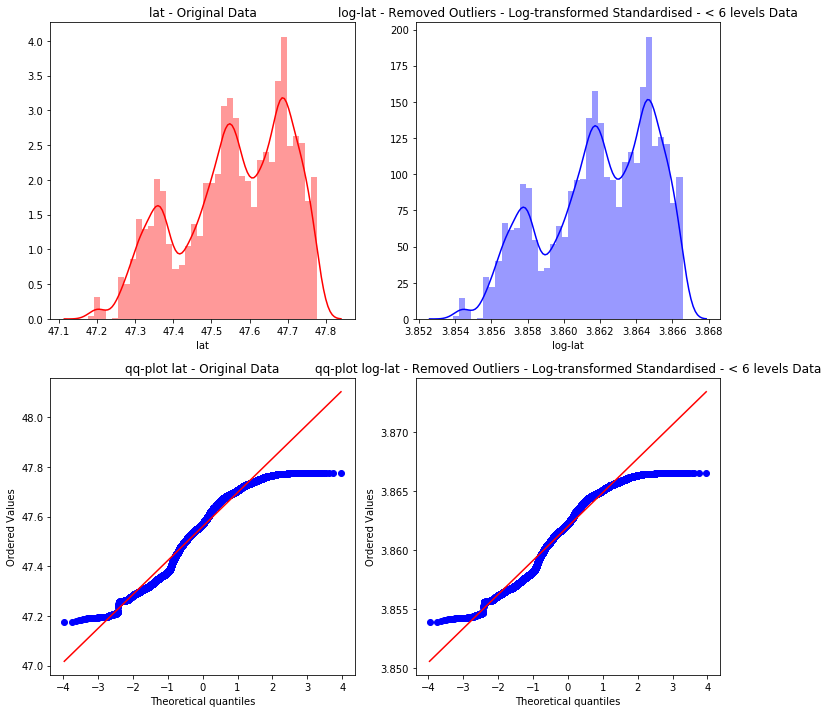

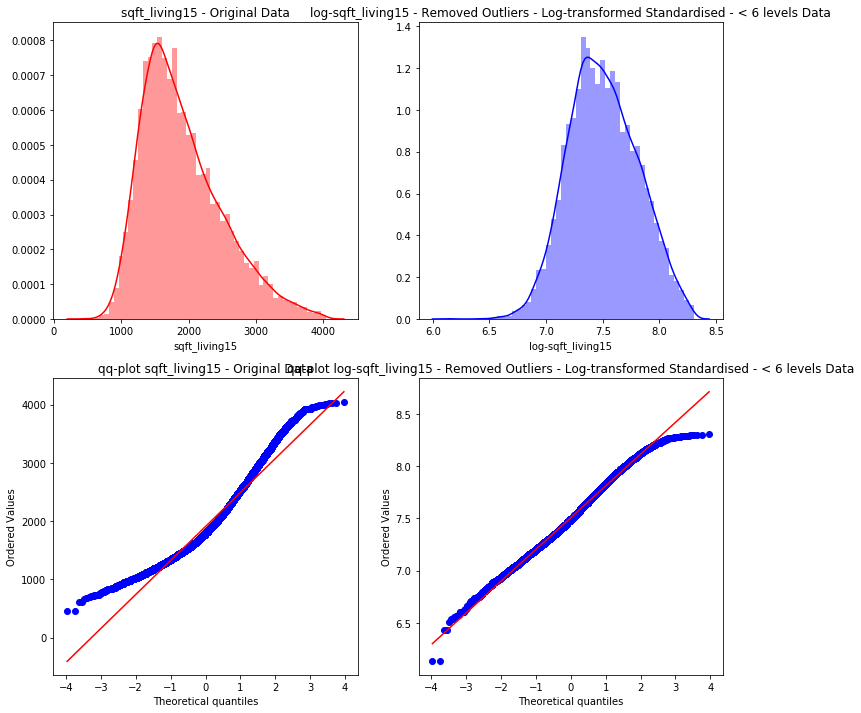

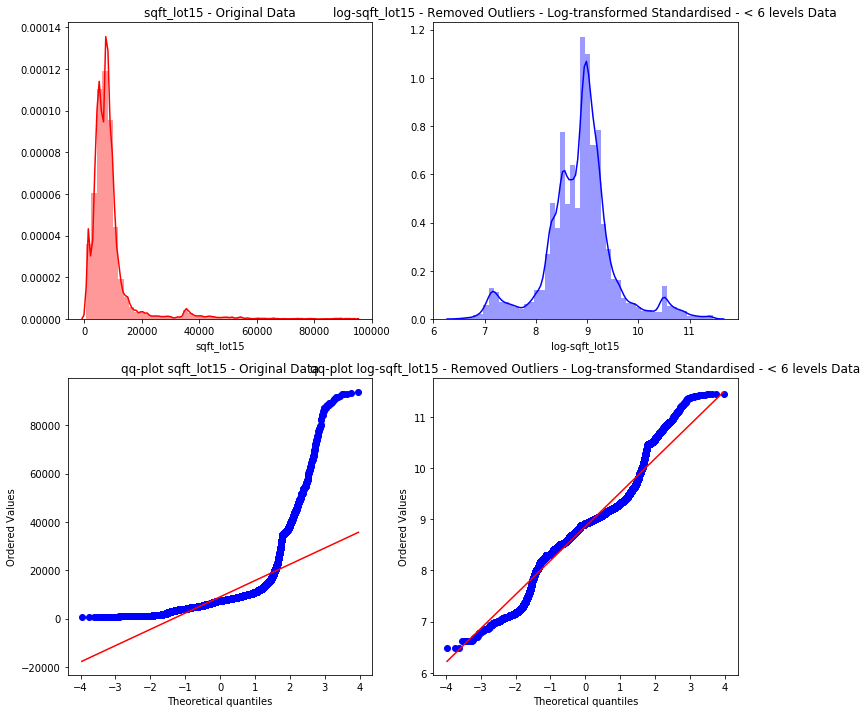

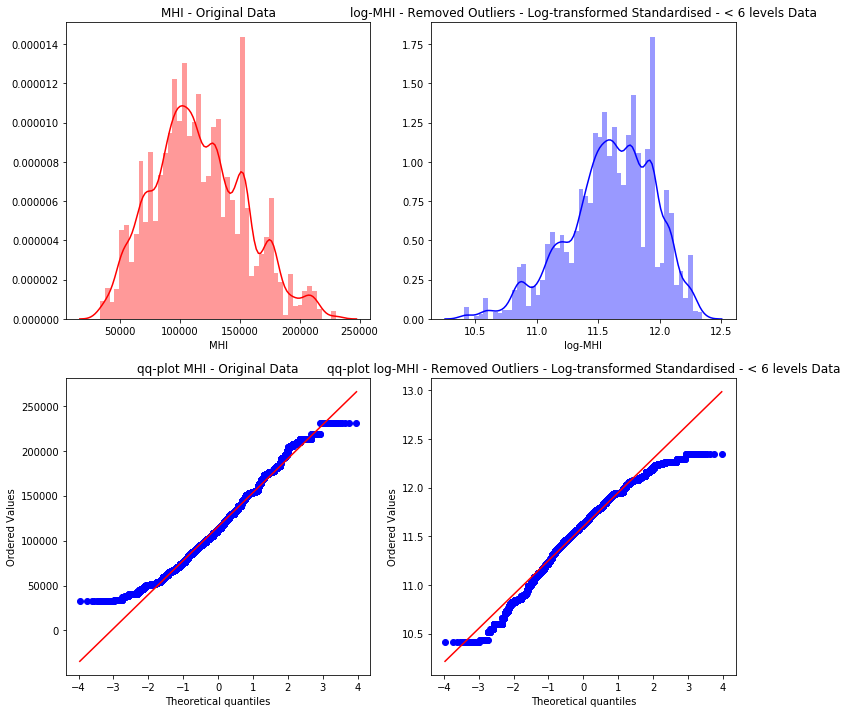

In [208]:
plot_before_after(new_df, dfStd6_out, cont6, 'Original',
                  'Removed Outliers - Log-transformed Standardised - < 6 levels')

#### Export standardised and scaled datasets to csv

In [209]:
dfStd_out.to_csv(os.path.join(
    path, r'logtransformed_std_nooutliers.csv'), index=False)

In [210]:
dfStd6_out.to_csv(os.path.join(
    path, r'logtrasnformed_std6_nooutliers.csv'), index=False)

### Make categorical

As we saw from *statistics* function, all the variables selected as categorical have no NaN values. Before making them as categorical we had to be sure that they do not contain:

- Not valid numbers
- Not valid or mispelled characters
- Not correlated variables

In [211]:
new_dfcopy = new_df.copy(deep=True)
new_dfcopy.to_csv(os.path.join(path, r'baselinebackup_nooutliers.csv'))

To **avoid** adding **multicolinearity**, we use **reference coding** for **categorical variables** (*drop_first=True*)

#### Baseline dataset

##### Category levels threshold < 29

In [212]:
dfB_out = new_df.copy()

In [213]:
dfB_out[cat] = new_df[cat].astype('category')

In [214]:
dfB_out_dum = pd.get_dummies(dfB_out, drop_first=True)

##### Category levels threshold < 6

In [215]:
dfB6_out = new_df.copy()

In [216]:
dfB6_out[cat6] = new_df[cat6].astype('category')

In [217]:
dfB6_out = pd.get_dummies(dfB6_out, drop_first=True)

#### Log-transformed dataset

##### Category levels threshold < 29

In [218]:
dflog_out[cat] = dflog_out[cat].astype('category')

In [219]:
dflog_out = pd.get_dummies(dflog_out, drop_first=True)

##### Category levels threshold < 6

In [220]:
dflog6_out[cat6] = dflog6_out[cat6].astype('category')

In [221]:
dflog6_out = pd.get_dummies(dflog6_out, drop_first=True)

#### MinMax Scaled

##### Category levels threshold < 29

In [222]:
dfMinMax_out[cat] = dfMinMax_out[cat].astype('category')

In [223]:
dfMinMax_out = pd.get_dummies(dfMinMax_out, drop_first=True)

##### Category levels threshold < 6

In [224]:
dfMinMax6_out[cat6] = dfMinMax6_out[cat6].astype('category')

In [225]:
dfMinMax6_out = pd.get_dummies(dfMinMax6_out, drop_first=True)

#### Robust Scaled

##### Category levels threshold < 29

In [226]:
dfRobScal_out[cat] = dfRobScal_out[cat].astype('category')

In [227]:
dfRobScal_out = pd.get_dummies(dfRobScal_out, drop_first=True)

##### Category levels threshold < 6

In [228]:
dfRobScal6_out[cat6] = dfRobScal6_out[cat6].astype('category')

In [229]:
dfRobScal6_out = pd.get_dummies(dfRobScal6_out, drop_first=True)

#### Standardised

##### Category levels threshold < 29

In [230]:
dfStd_out[cat] = dfStd_out[cat].astype('category')

In [231]:
dfStd_out = pd.get_dummies(dfStd_out, drop_first=True)

##### Category levels threshold < 6

In [232]:
dfStd6_out[cat6] = dfStd6_out[cat6].astype('category')

In [233]:
dfStd6_out = pd.get_dummies(dfStd6_out, drop_first=True)


### Export processed datasets to csv

In [234]:
Xb_out = dfB_out['sqft_living']
Xb_out.to_csv(os.path.join(path, r'dfModel_1_nooutliers.csv'),
              index=False, header='sqft_living')

In [235]:
Xb_log_out = dflog_out.drop(log_todrop, axis=1)['log-sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed_nooutliers.csv'), index=False, header='sqft_living')

In [236]:
Xb_logmimax_out = dfMinMax_out.drop(log_todrop, axis=1)['log-sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed_minmax_nooutliers.csv'), index=False, header='sqft_living')

In [237]:
Xb_logrobscal_out = dfRobScal_out.drop(log_todrop, axis=1)['log-sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed_robscal_nooutliers.csv'), index=False, header='sqft_living')

In [238]:
Xb_logstd_out = dfStd_out['log-sqft_living'].to_csv(os.path.join(
    path, r'sqft_living_logtransformed_std_nooutliers.csv'), index=False, header='sqft_living')

In [239]:
dfB_out_dum.to_csv(os.path.join(
    path, r'baseline_processed_nooutliers.csv'), index=False)

In [240]:
dfB6_out.to_csv(os.path.join(
    path, r'baseline6_processed_nooutliers.csv'), index=False)

In [241]:
dflog_out.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_processed_nouutliers.csv'), index=False)

In [242]:
dflog6_out.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed6_processed_nooutliers.csv'), index=False)

In [243]:
dfMinMax_out.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_minmax_processed_nooutliers.csv'), index=False)

In [244]:
dfMinMax6_out.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_minmax6_processed_nooutliers.csv'), index=False)

In [245]:
dfRobScal_out.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_robscal_processed_nooutliers.csv'), index=False)

In [246]:
dfRobScal6_out.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_robscal6_processed_nouutliers.csv'), index=False)

In [247]:
dfStd_out.drop(log_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_std_processed_nooutliers.csv'), index=False)

In [248]:
dfStd6_out.drop(nonlog6_todrop, axis=1).to_csv(os.path.join(
    path, r'logtransformed_std6_processed_nooutliers.csv'), index=False)

### Reduce multicolinearity

In [249]:
dflog_out.drop(log_todrop, inplace=True, axis=1)

In [250]:
dflog6_out.drop(nonlog6_todrop, inplace=True, axis=1)

In [251]:
dfMinMax_out.drop(log_todrop, inplace=True, axis=1)

In [252]:
dfMinMax6_out.drop(nonlog6_todrop, inplace=True, axis=1)

In [253]:
dfRobScal_out.drop(log_todrop, inplace=True, axis=1)

In [254]:
dfRobScal6_out.drop(nonlog6_todrop, inplace=True, axis=1)

In [255]:
dfStd_out.drop(log_todrop, inplace=True, axis=1)

In [256]:
dfStd6_out.drop(nonlog6_todrop, inplace=True, axis=1)

#### Multicolinearity using *.corr()*

In [257]:
models_out = [dfB_out_dum, dfB6_out, dflog_out, dflog6_out, dfMinMax_out,
              dfMinMax6_out, dfRobScal_out, dfRobScal6_out, dfStd_out, dfStd6_out]
model_names_out = ['baseline_out', 'baseline-6cat_out', 'logtransformed_out', 'logtransformed-6cat_out', 'logtransformed-MinMax_out',
                   'logtrasnformed-MinMax-6cat_out', 'logtransformed-RobScal_out', 'logtransformed-RobScal-6cat_out', 'logtransformed-std_out', 'logtransformed-std-6cat_out']

In [258]:
thresh = 0.8
for model in enumerate(models_out):
    print('{} - Columns multicolinearity {}'.format(
        model_names_out[model[0]], reduce_multicol(model[1], thresh)))
    #print('\nColumns: {}'.format(list(model[1].columns)))

baseline_out - Columns multicolinearity {'sqft_above', 'sqft_lot15'}
baseline-6cat_out - Columns multicolinearity {'sqft_above', 'sqft_lot15'}
logtransformed_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-6cat_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-MinMax_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtrasnformed-MinMax-6cat_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-RobScal_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-RobScal-6cat_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-std_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}
logtransformed-std-6cat_out - Columns multicolinearity {'log-sqft_lot15', 'log-sqft_above'}


#### Multicolinearity using Variance Inflation Factor (VIF)

**Threshold VIF < 5**

In [259]:
vif_dict = {}
for model in enumerate(models_out):
    print(model_names_out[model[0]])
    vif = [variance_inflation_factor(model[1].values, i)
           for i in range(model[1].shape[1])]
    templist = list(zip(model[1], vif))
    templistofcolumns = [x[0] for x in templist if x[1] < 5]
    vif_dict[model_names_out[model[0]]] = templistofcolumns

baseline_out


/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1638: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.uncentered_tss


baseline-6cat_out
logtransformed_out


/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1636: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


logtransformed-6cat_out
logtransformed-MinMax_out
logtrasnformed-MinMax-6cat_out
logtransformed-RobScal_out
logtransformed-RobScal-6cat_out
logtransformed-std_out
logtransformed-std-6cat_out


In [260]:
vif_dict

{'baseline_out': ['bedrooms_6.0',
  'floors_1.5',
  'floors_2.0',
  'floors_2.5',
  'floors_3.0',
  'view_1.0',
  'view_2.0',
  'zipcode_98002',
  'zipcode_98003',
  'zipcode_98005',
  'zipcode_98007',
  'zipcode_98010',
  'zipcode_98014',
  'zipcode_98022',
  'zipcode_98023',
  'zipcode_98024',
  'zipcode_98030',
  'zipcode_98031',
  'zipcode_98032',
  'zipcode_98038',
  'zipcode_98040',
  'zipcode_98042',
  'zipcode_98045',
  'zipcode_98055',
  'zipcode_98058',
  'zipcode_98070',
  'zipcode_98092',
  'zipcode_98102',
  'zipcode_98106',
  'zipcode_98108',
  'zipcode_98109',
  'zipcode_98112',
  'zipcode_98116',
  'zipcode_98119',
  'zipcode_98126',
  'zipcode_98136',
  'zipcode_98146',
  'zipcode_98148',
  'zipcode_98166',
  'zipcode_98168',
  'zipcode_98178',
  'zipcode_98188',
  'zipcode_98198'],
 'baseline-6cat_out': ['view_1.0',
  'view_2.0',
  'zipcode_98002',
  'zipcode_98003',
  'zipcode_98005',
  'zipcode_98007',
  'zipcode_98010',
  'zipcode_98014',
  'zipcode_98022',
  'zipc

### Export processed datasets to csv

We're going to remvoe the columns 'sqft_above' and 'sqft_lot15' to reduce multicolinearity and export to csv all the datasets.

In [261]:
dfB_out_dum.drop(['sqft_above', 'sqft_lot15'], axis=1).to_csv(
    os.path.join(path, r'baseline_processed_nooutliers_multicol.csv'), index=False)
dfB6_out.drop(['sqft_above', 'sqft_lot15'], axis=1).to_csv(os.path.join(
    path, r'baseline6_processed_nooutliers_multicol.csv'), index=False)
dflog_out.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                               r'logtransformed_processed_nooutliers_multicol.csv'), index=False)
dflog6_out.drop(['log-sqft_lot15', 'log-sqft_above'], axis=1).to_csv(os.path.join(
    path, r'logtransformed6_processed_nooutliers_multicol.csv'), index=False)
dfMinMax_out.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                                  r'minmax_processed_nooutliers_multicol.csv'), index=False)
dfMinMax6_out.drop(['log-sqft_lot15', 'log-sqft_above'], axis=1).to_csv(
    os.path.join(path, r'minmax6_processed_nooutliers_multicol.csv'), index=False)
dfRobScal_out.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                                   r'robscal_processed_nooutliers_multicol.csv'), index=False)
dfRobScal6_out.drop(['log-sqft_lot15', 'log-sqft_above'], axis=1).to_csv(
    os.path.join(path, r'robscal6_processed_nooutliers_multicol.csv'), index=False)
dfStd_out.drop(['log-sqft_above'], axis=1).to_csv(os.path.join(path,
                                                               r'logtransformed_std_processed_nooutliers_multicol.csv'), index=False)
dfStd6_out.drop(['log-sqft_lot15', 'log-sqft_above'], axis=1).to_csv(os.path.join(
    path, r'logtransformed_std6_processed_nooutliers_multicol.csv'), index=False)

#### Multicolinearity using VIF

In [262]:
dfB_out_dum[vif_dict['baseline_out']].to_csv(os.path.join(
    path, r'baseline_processed_nooutliers_multicol_vif.csv'), index=False)
dfB6_out[vif_dict['baseline-6cat_out']].to_csv(os.path.join(
    path, r'baseline6_processed_nooutliers_multicol_vif.csv'), index=False)
dflog_out[vif_dict['logtransformed_out']].to_csv(os.path.join(
    path, r'logtransformed_processed_nooutliers_multicol_vif.csv'), index=False)
dflog6_out[vif_dict['logtransformed-6cat_out']].to_csv(os.path.join(
    path, r'logtransformed6_processed_nooutliers_multicol_vif.csv'), index=False)
dfMinMax_out[vif_dict['logtransformed-MinMax_out']].to_csv(os.path.join(
    path, r'logtransformed_minmax_processed_nooutliers_multicol_vif.csv'), index=False)
dfMinMax6_out[vif_dict['logtrasnformed-MinMax-6cat_out']].to_csv(os.path.join(
    path, r'logtransformed_minmax6_processed_nooutliers_multicol_vif.csv'), index=False)
dfRobScal_out[vif_dict['logtransformed-RobScal_out']].to_csv(os.path.join(
    path, r'logtransformed_robscal_processed_nooutliers_multicol_vif.csv'), index=False)
dfRobScal6_out[vif_dict['logtransformed-RobScal-6cat_out']].to_csv(os.path.join(
    path, r'logtransformed_robscal6_processed_nooutliers_multicol_vif.csv'), index=False)
dfStd_out[vif_dict['logtransformed-std_out']].to_csv(os.path.join(
    path, r'logtransformed_std_processed_nooutliers_multicol_vif.csv'), index=False)
dfStd6_out[vif_dict['logtransformed-std-6cat_out']].to_csv(os.path.join(
    path, r'logtransformed_std6_processed_nooutliers_multicol_vif.csv'), index=False)

## EDA with focus on income levels

We want to address questions like:
1. Where and if it's affordable for a lower income class member (median lower income) to buy a house in King County?
2. Where and if it's affordable for a middle income class member (median middle income) to buy a house in King County?
3. Where and if it's affordable for an upper income class member (median upper income) to buy a house in King County?

### Income-class based spatial analysis

Let's take the median household income by income tier in Washington (source: Pew data). 

- Lower income: $26,436.00

- Middle income: $80,615.00

- Upper income: $188,102.00

Let's create a column where classifying each tract by income-class. For the purpose of this EDA, we will neglect the distinction between "before" and "after" removing outliers.

Our final goal is to spatial plot insights with CARTOdb.

In [ ]:
bins = [0, 26436, 80615, 188102]
names = ['Lower income', 'Middle income', 'Upper income']

In [80]:
census['income_class'] = pd.cut(census['E19113069'], bins=bins, labels=names)
census.dropna(inplace=True)
census

,OBJECTID,GEO_ID_TRT,TRACT_LBL,E19113069,M19113069,geometry,income_class
0,1,53033000100,Tract 000100,83222.0,12066.0,"POLYGON ((-122.28580 47.73368, -122.28559 47.7...",Upper income
1,2,53033000200,Tract 000200,74818.0,12715.0,"POLYGON ((-122.32359 47.73405, -122.32348 47.7...",Middle income
2,3,53033000300,Tract 000300,100263.0,7691.0,"POLYGON ((-122.32555 47.73407, -122.32532 47.7...",Upper income
3,4,53033000401,Tract 000401,44810.0,23592.0,"POLYGON ((-122.34501 47.72633, -122.34498 47.7...",Middle income
4,5,53033000402,Tract 000402,92266.0,17875.0,"POLYGON ((-122.34737 47.72322, -122.34655 47.7...",Upper income
...,...,...,...,...,...,...,...
392,393,53033032602,Tract 032602,153611.0,13818.0,"POLYGON ((-121.88718 47.56930, -121.88693 47.5...",Upper income
393,394,53033032702,Tract 032702,105469.0,6268.0,"POLYGON ((-121.53590 47.54667, -121.53565 47.5...",Upper income
394,395,53033032703,Tract 032703,103417.0,17296.0,"POLYGON ((-121.83219 47.53884, -121.83218 47.5...",Upper income
395,396,53033032704,Tract 032704,111186.0,14401.0,"POLYGON ((-121.78176 47.52230, -121.78122 47.5...",Upper income


In [63]:
income_class = pd.read_csv(
    './processed/geodataframe_cleaned_not_processed.csv')

### Categorise proprietries by income class

In [64]:
income_class['income_class'] = pd.cut(
    income_class['MHI'], bins=bins, labels=names)
income_class

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_built,zipcode,lat,long,sqft_living15,sqft_lot15,renovated,geometry,MHI,income_class
0,221900.0,3.0,1.00,1180.0,5650.0,1.0,0.0,0.0,3,7,...,1955,98178,47.5112,-122.257,1340.0,5650.0,0,POINT (-122.257 47.5112),101333.0,Upper income
1,538000.0,3.0,2.25,2570.0,7242.0,2.0,0.0,0.0,3,7,...,1951,98125,47.7210,-122.319,1690.0,7639.0,1,POINT (-122.319 47.721),74818.0,Middle income
2,180000.0,2.0,1.00,770.0,10000.0,1.0,0.0,0.0,3,6,...,1933,98028,47.7379,-122.233,2720.0,8062.0,0,POINT (-122.233 47.7379),130139.0,Upper income
3,604000.0,4.0,3.00,1960.0,5000.0,1.0,0.0,0.0,5,7,...,1965,98136,47.5208,-122.393,1360.0,5000.0,0,POINT (-122.393 47.5208),145022.0,Upper income
4,510000.0,3.0,2.00,1680.0,8080.0,1.0,0.0,0.0,3,8,...,1987,98074,47.6168,-122.045,1800.0,7503.0,0,POINT (-122.045 47.6168),176950.0,Upper income
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21591,360000.0,3.0,2.50,1530.0,1131.0,3.0,0.0,0.0,3,8,...,2009,98103,47.6993,-122.346,1530.0,1509.0,0,POINT (-122.346 47.6993),109919.0,Upper income
21592,400000.0,4.0,2.50,2310.0,5813.0,2.0,0.0,0.0,3,8,...,2014,98146,47.5107,-122.362,1830.0,7200.0,0,POINT (-122.362 47.5107),74130.0,Middle income
21593,402101.0,2.0,0.75,1020.0,1350.0,2.0,0.0,0.0,3,7,...,2009,98144,47.5944,-122.299,1020.0,2007.0,0,POINT (-122.299 47.5944),105461.0,Upper income
21594,400000.0,3.0,2.50,1600.0,2388.0,2.0,0.0,0.0,3,8,...,2004,98027,47.5345,-122.069,1410.0,1287.0,0,POINT (-122.069 47.5345),182870.0,Upper income


### Price-to-income ratio - House affordability per tract

The rule of thumb for PIR is that the housing price should not exceed three times (3.0x) to the median gross annual household income (median multiplier) (Suhaida et al., 2011;Sani and Rahim, 2015).

According to Bloomberg, it should be 2.6 years of income: https://www.bloomberg.com/news/articles/2018-05-29/how-many-years-of-income-does-a-home-in-your-city-cost

In [71]:
income_class['price-income-ratio-relative'] = income_class['price'] / \
    income_class['MHI']

In [73]:
income_class['price-income-ratio-lower-class'] = income_class['price'] / 26436
income_class['price-income-ratio-middle-class'] = income_class['price'] / 80615
income_class['price-income-ratio-upper-class'] = income_class['price'] / 188102

In [75]:
bins_affordability = [0, 2.6, 3, np.inf]
names_affordability = ['Very affordable', 'Affordable', 'Not affordable']
income_class['affordability-relative-to-MHI'] = pd.cut(
    income_class['price-income-ratio-relative'], bins=bins_affordability, labels=names_affordability)
income_class['affordability-relative-to-MHI-lower-class'] = pd.cut(
    income_class['price-income-ratio-lower-class'], bins=bins_affordability, labels=names_affordability)
income_class['affordability-relative-to-MHI-middle-class'] = pd.cut(
    income_class['price-income-ratio-middle-class'], bins=bins_affordability, labels=names_affordability)
income_class['affordability-relative-to-MHI-upper-class'] = pd.cut(
    income_class['price-income-ratio-upper-class'], bins=bins_affordability, labels=names_affordability)
income_class

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,MHI,income_class,affordability-relative-to-MHI,price-income-ratio-relative,price-income-ratio-lower-class,price-income-ratio-middle-class,price-income-ratio-upper-class,affordability-relative-to-MHI-lower-class,affordability-relative-to-MHI-middle-class,affordability-relative-to-MHI-upper-class
0,221900.0,3.0,1.00,1180.0,5650.0,1.0,0.0,0.0,3,7,...,101333.0,Upper income,Very affordable,2.189810,8.393857,2.752589,1.179679,Not affordable,Affordable,Very affordable
1,538000.0,3.0,2.25,2570.0,7242.0,2.0,0.0,0.0,3,7,...,74818.0,Middle income,Not affordable,7.190783,20.351036,6.673696,2.860150,Not affordable,Not affordable,Affordable
2,180000.0,2.0,1.00,770.0,10000.0,1.0,0.0,0.0,3,6,...,130139.0,Upper income,Very affordable,1.383136,6.808897,2.232835,0.956928,Not affordable,Very affordable,Very affordable
3,604000.0,4.0,3.00,1960.0,5000.0,1.0,0.0,0.0,5,7,...,145022.0,Upper income,Not affordable,4.164885,22.847632,7.492402,3.211024,Not affordable,Not affordable,Not affordable
4,510000.0,3.0,2.00,1680.0,8080.0,1.0,0.0,0.0,3,8,...,176950.0,Upper income,Affordable,2.882170,19.291875,6.326366,2.711295,Not affordable,Not affordable,Affordable
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21591,360000.0,3.0,2.50,1530.0,1131.0,3.0,0.0,0.0,3,8,...,109919.0,Upper income,Not affordable,3.275139,13.617794,4.465670,1.913855,Not affordable,Not affordable,Very affordable
21592,400000.0,4.0,2.50,2310.0,5813.0,2.0,0.0,0.0,3,8,...,74130.0,Middle income,Not affordable,5.395926,15.130882,4.961856,2.126506,Not affordable,Not affordable,Very affordable
21593,402101.0,2.0,0.75,1020.0,1350.0,2.0,0.0,0.0,3,7,...,105461.0,Upper income,Not affordable,3.812793,15.210357,4.987918,2.137675,Not affordable,Not affordable,Very affordable
21594,400000.0,3.0,2.50,1600.0,2388.0,2.0,0.0,0.0,3,8,...,182870.0,Upper income,Very affordable,2.187346,15.130882,4.961856,2.126506,Not affordable,Not affordable,Very affordable


### Affordability houses for lower income class

In [97]:
income_class['affordability-relative-to-MHI-lower-class'].value_counts(
    normalize=True)

Not affordable     0.999954
Affordable         0.000046
Very affordable    0.000000
Name: affordability-relative-to-MHI-lower-class, dtype: float64

In [98]:
income_class['affordability-relative-to-MHI-lower-class'].value_counts()

Not affordable     21595
Affordable             1
Very affordable        0
Name: affordability-relative-to-MHI-lower-class, dtype: int64

### Affordability houses for middle income class

In [99]:
income_class['affordability-relative-to-MHI-middle-class'].value_counts(
    normalize=True)

Not affordable     0.906603
Affordable         0.046953
Very affordable    0.046444
Name: affordability-relative-to-MHI-middle-class, dtype: float64

In [100]:
income_class['affordability-relative-to-MHI-middle-class'].value_counts()

Not affordable     19579
Affordable          1014
Very affordable     1003
Name: affordability-relative-to-MHI-middle-class, dtype: int64

### Affordability houses for upper income class

In [101]:
income_class['affordability-relative-to-MHI-upper-class'].value_counts(
    normalize=True)

Very affordable    0.558020
Not affordable     0.335108
Affordable         0.106872
Name: affordability-relative-to-MHI-upper-class, dtype: float64

In [135]:
income_class['affordability-relative-to-MHI-upper-class'].value_counts()

Very affordable    12051
Not affordable      7237
Affordable          2308
Name: affordability-relative-to-MHI-upper-class, dtype: int64

As we can see, based on the above definitions of affordability, King County is mainly a county for upper income class.

### Plot with CARTOdb

In [134]:
iframe2 = '<iframe width="100%" height="520" frameborder="0" src="https://andreanasuto.carto.com/builder/8a296e60-38d8-4fb2-b4e1-418884819758/embed" allowfullscreen webkitallowfullscreen mozallowfullscreen oallowfullscreen msallowfullscreen></iframe>'
IPython.display.HTML(iframe2)

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/IPython/core/display.py:694: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


### Export to csv


In [129]:
income_class.to_csv(os.path.join(path, r'income-class.csv'), index=False)
census.to_csv(os.path.join(path, r'census_with_classes.csv'), index=False)